<a href="https://colab.research.google.com/github/AndreiAf02/STAT561_Project/blob/main/Adult_Gender_Transductive_TL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##STAT 561 Project Extension - Adult

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



## Data taken from the UCI Machine Learning repository [here](https://doi.org/10.24432/C5XW20):

In [2]:
pip install ucimlrepo

In [52]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
adult = fetch_ucirepo(id=2)

# data (as pandas dataframes)
X = adult.data.features
y = adult.data.targets

# metadata
print(adult.metadata)

# variable information
print(adult.variables)



{'uci_id': 2, 'name': 'Adult', 'repository_url': 'https://archive.ics.uci.edu/dataset/2/adult', 'data_url': 'https://archive.ics.uci.edu/static/public/2/data.csv', 'abstract': 'Predict whether annual income of an individual exceeds $50K/yr based on census data. Also known as "Census Income" dataset. ', 'area': 'Social Science', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 48842, 'num_features': 14, 'feature_types': ['Categorical', 'Integer'], 'demographics': ['Age', 'Income', 'Education Level', 'Other', 'Race', 'Sex'], 'target_col': ['income'], 'index_col': None, 'has_missing_values': 'yes', 'missing_values_symbol': 'NaN', 'year_of_dataset_creation': 1996, 'last_updated': 'Tue Sep 24 2024', 'dataset_doi': '10.24432/C5XW20', 'creators': ['Barry Becker', 'Ronny Kohavi'], 'intro_paper': None, 'additional_info': {'summary': "Extraction was done by Barry Becker from the 1994 Census database.  A set of reasonably clean records was extracted using the fol

In [53]:
X

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,Private,215419,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States
48838,64,NaN,321403,HS-grad,9,Widowed,NaN,Other-relative,Black,Male,0,0,40,United-States
48839,38,Private,374983,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States
48840,44,Private,83891,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States


In [54]:
y['income'].unique()

array(['<=50K', '>50K', '<=50K.', '>50K.'], dtype=object)

In [55]:
for i in range(len(X.columns)):
  print(X.columns[i])
  print(X.iloc[:, i].unique())
  print('------------------')

age
[39 50 38 53 28 37 49 52 31 42 30 23 32 40 34 25 43 54 35 59 56 19 20 45
 22 48 21 24 57 44 41 29 18 47 46 36 79 27 67 33 76 17 55 61 70 64 71 68
 66 51 58 26 60 90 75 65 77 62 63 80 72 74 69 73 81 78 88 82 83 84 85 86
 87 89]
------------------
workclass
['State-gov' 'Self-emp-not-inc' 'Private' 'Federal-gov' 'Local-gov' '?'
 'Self-emp-inc' 'Without-pay' 'Never-worked' nan]
------------------
fnlwgt
[ 77516  83311 215646 ... 173449  89686 350977]
------------------
education
['Bachelors' 'HS-grad' '11th' 'Masters' '9th' 'Some-college' 'Assoc-acdm'
 'Assoc-voc' '7th-8th' 'Doctorate' 'Prof-school' '5th-6th' '10th'
 '1st-4th' 'Preschool' '12th']
------------------
education-num
[13  9  7 14  5 10 12 11  4 16 15  3  6  2  1  8]
------------------
marital-status
['Never-married' 'Married-civ-spouse' 'Divorced' 'Married-spouse-absent'
 'Separated' 'Married-AF-spouse' 'Widowed']
------------------
occupation
['Adm-clerical' 'Exec-managerial' 'Handlers-cleaners' 'Prof-specialty'
 'Other-s

In [56]:
X_numeric = pd.DataFrame()

## Age:
X_numeric['age'] = X['age']

## Working class:
X_numeric['workclass'] = X['workclass']
X_numeric['workclass'].replace(['State-gov', 'Self-emp-not-inc', 'Private', 'Federal-gov', 'Local-gov', '?',
                                'Self-emp-inc', 'Without-pay', 'Never-worked'],
                                [0, 1, 2, 3, 4, 5, 6, 7, 8], inplace=True)

## Fnlwgt:

X_numeric['fnlwgt'] = X['fnlwgt']

## Education:
X_numeric['education_num'] = X['education-num']

## Marital Status:
X_numeric['marital_status'] = X['marital-status']
X_numeric['marital_status'].replace(['Never-married', 'Married-civ-spouse', 'Divorced', 'Married-spouse-absent',
                                     'Separated', 'Married-AF-spouse', 'Widowed'],
                                    [0, 1, 2, 3, 4, 5, 6], inplace=True)

## Occupation:
X_numeric['occupation'] = X['occupation']
X_numeric['occupation'].replace(['Adm-clerical', 'Exec-managerial', 'Handlers-cleaners', 'Prof-specialty',
                                 'Other-service', 'Sales', 'Craft-repair', 'Transport-moving',
                                 'Farming-fishing', 'Machine-op-inspct', 'Tech-support', '?',
                                 'Protective-serv', 'Armed-Forces', 'Priv-house-serv'],
                                    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], inplace=True)

## Relationship:
X_numeric['relationship'] = X['relationship']
X_numeric['relationship'].replace(['Not-in-family', 'Husband', 'Wife', 'Own-child', 'Unmarried', 'Other-relative'],
                                    [0, 1, 2, 3, 4, 5], inplace=True)

## Race:
X_numeric['race'] = X['race']
X_numeric['race'].replace(['White', 'Black', 'Asian-Pac-Islander', 'Amer-Indian-Eskimo', 'Other'],
                          [0, 1, 2, 3, 4], inplace=True)

## Sex:
X_numeric['sex'] = X['sex']
X_numeric['sex'].replace(['Male', 'Female'],
                          [0, 1], inplace=True)

## Capital Gain/Loss:
X_numeric['capital_gain'] = X['capital-gain']
X_numeric['capital_loss'] = X['capital-loss']


## Hours worked:
X_numeric['hours_per_week'] = X['hours-per-week']


## Nationality:
X_numeric['native_country'] = X['native-country']
X_numeric['native_country'].replace(['United-States', 'Cuba', 'Jamaica', 'India', '?', 'Mexico', 'South',
                                     'Puerto-Rico', 'Honduras', 'England', 'Canada', 'Germany', 'Iran',
                                     'Philippines', 'Italy', 'Poland', 'Columbia', 'Cambodia', 'Thailand', 'Ecuador',
                                     'Laos', 'Taiwan', 'Haiti', 'Portugal', 'Dominican-Republic', 'El-Salvador',
                                     'France', 'Guatemala', 'China', 'Japan', 'Yugoslavia', 'Peru',
                                     'Outlying-US(Guam-USVI-etc)', 'Scotland', 'Trinadad&Tobago', 'Greece',
                                     'Nicaragua', 'Vietnam', 'Hong', 'Ireland', 'Hungary', 'Holand-Netherlands'],
                                     [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
                                      24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41], inplace=True)



## Income:
y_numeric = pd.DataFrame()
y_numeric['Y'] = y['income']
y_numeric['Y'].replace(['<=50K', '<=50K.', '>50K', '>50K.'],
                          [0, 0, 1, 1], inplace=True)

X_numeric





<ipython-input-56-0b4e5a960686>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_numeric['workclass'].replace(['State-gov', 'Self-emp-not-inc', 'Private', 'Federal-gov', 'Local-gov', '?',
<ipython-input-56-0b4e5a960686>:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_numeric['workclass'].replac

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0
48838,64,NaN,321403,9,6,NaN,5,1,0,0,0,40,0.0
48839,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0
48840,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0


In [57]:
y_numeric

,Y
0,0
1,0
2,0
3,0
4,0
...,...
48837,0
48838,0
48839,0
48840,0


In [58]:
y_numeric['Y'].value_counts()

,count
Y,
0,37155
1,11687


In [59]:
data_total = pd.concat([X_numeric, y_numeric], axis=1)

data_total = data_total.dropna().reset_index(drop=True)


data_total

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,Y
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0,0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0,0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0,0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0,0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,33,2.0,245211,13,0,3.0,3,0,0,0,0,40,0.0,0
47617,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0,0
47618,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0,0
47619,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0,0


In [60]:
X = data_total.iloc[:, :-1]
y = data_total.iloc[:,-1]
y

,Y
0,0
1,0
2,0
3,0
4,0
...,...
47616,0
47617,0
47618,0
47619,0


In [61]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)

In [62]:
data2 = pd.concat([X_scaled, y], axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.00000,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.00000,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.00000,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.00000,0
4,0.150685,0.250,0.220635,0.800000,0.166667,0.214286,0.4,0.25,1.0,0.000000,0.0,0.397959,0.02439,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.00000,0
47617,0.301370,0.250,0.137428,0.800000,0.333333,0.214286,0.0,0.00,1.0,0.000000,0.0,0.357143,0.00000,0
47618,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.00000,0
47619,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.00000,0


In [63]:
y.value_counts()

,count
Y,
0,36080
1,11541


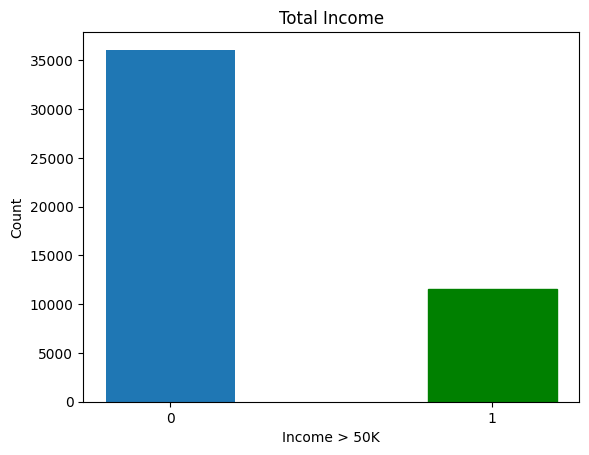

In [64]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("Income > 50K")
plt.ylabel("Count")
plt.title("Total Income")
plt.show()

In [65]:
data_total

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,Y
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0,0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0,0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0,0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0,0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,33,2.0,245211,13,0,3.0,3,0,0,0,0,40,0.0,0
47617,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0,0
47618,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0,0
47619,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0,0


In [66]:
data_total.iloc[:, 8].value_counts()

,count
sex,
0,31937
1,15684


In [67]:
data2.iloc[:, 8].value_counts()

,count
8,
0.0,31937
1.0,15684


# Splitting for Source and Target Domains:


# Full Dataset:

Grouping by 'International': domestic students are source data, international students are target data

In [68]:
data_S = data2[data2.iloc[:,8] <= 0.5].reset_index(drop=True)  ## Source domain and classification - Male
data_T = data2[data2.iloc[:,8] > 0.5].reset_index(drop=True)  ## Target domain and classification - Female

In [69]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.0,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.0,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.0,0
4,0.479452,0.125,0.133519,0.533333,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.448980,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31932,0.424658,0.500,0.227956,0.866667,0.333333,0.285714,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31933,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31934,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.0,0
31935,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.0,0


In [70]:
data_T

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.150685,0.25,0.220635,0.800000,0.166667,0.214286,0.4,0.25,1.0,0.000000,0.0,0.397959,0.02439,0
1,0.273973,0.25,0.184219,0.866667,0.166667,0.071429,0.4,0.00,1.0,0.000000,0.0,0.397959,0.00000,0
2,0.438356,0.25,0.100061,0.266667,0.500000,0.285714,0.0,0.25,1.0,0.000000,0.0,0.153061,0.04878,0
3,0.191781,0.25,0.022661,0.866667,0.000000,0.214286,0.0,0.00,1.0,0.140841,0.0,0.500000,0.00000,1
4,0.082192,0.25,0.074410,0.800000,0.000000,0.000000,0.6,0.00,1.0,0.000000,0.0,0.295918,0.00000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15679,0.136986,0.25,0.282830,0.600000,0.000000,0.357143,0.0,0.00,1.0,0.000000,0.0,0.448980,0.00000,0
15680,0.520548,0.25,0.143676,0.533333,0.666667,1.000000,0.0,0.00,1.0,0.000000,0.0,0.316327,0.00000,0
15681,0.287671,0.25,0.159164,0.666667,0.000000,0.000000,0.8,0.25,1.0,0.000000,0.0,0.397959,0.00000,0
15682,0.109589,0.25,0.229138,0.533333,0.000000,0.285714,0.6,0.00,1.0,0.000000,0.0,0.397959,0.00000,0


## Source domain and task labels:

In [71]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,0
1,0
2,0
3,0
4,1
...,...
31932,0
31933,0
31934,0
31935,0


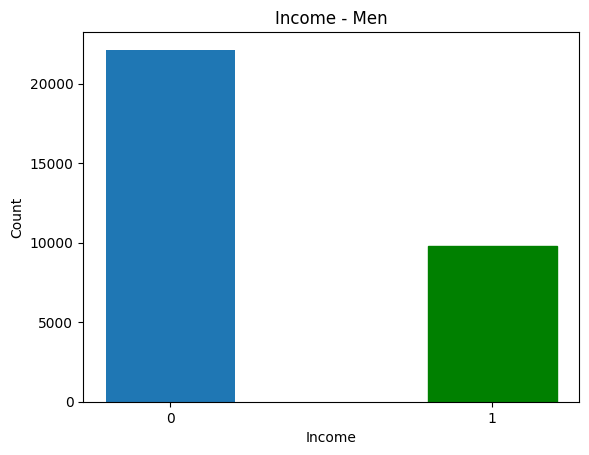

In [72]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("Income")
plt.ylabel("Count")
plt.title("Income - Men")
plt.show()

## Target domain and task labels:

In [73]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,0
2,0
3,1
4,0
...,...
15679,0
15680,0
15681,0
15682,0


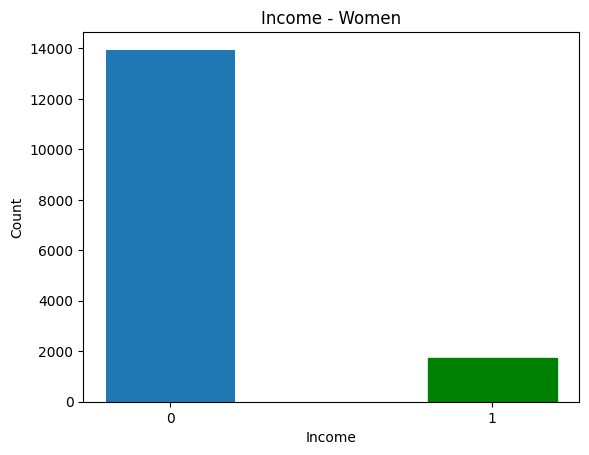

In [74]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("Income")
plt.ylabel("Count")
plt.title("Income - Women")
plt.show()

## Updated Code (Modified from Shreya's code):

In [75]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [76]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [77]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [78]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (25549, 13)
y_S_train: (25549,)
X_S_test: (6388, 13)
y_S_test: (6388,)


In [79]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7062 - loss: 0.5479 - val_AUC: 0.8716 - val_loss: 0.4127
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8685 - loss: 0.4059 - val_AUC: 0.8756 - val_loss: 0.4070
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 - loss: 0.3989 - val_AUC: 0.8773 - val_loss: 0.3984
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8659 - loss: 0.4027 - val_AUC: 0.8785 - val_loss: 0.3960
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.3941 - val_AUC: 0.8768 - val_loss: 0.4114
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8757 - loss: 0.3928 - val_AUC: 0.8783 - val_loss: 0.3975
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.3987 - val_AUC: 0.8779 - val_loss: 0.4046
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.8739 - loss: 0.3951 - val_AUC: 0.8794 - val_loss: 0.3953
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 -

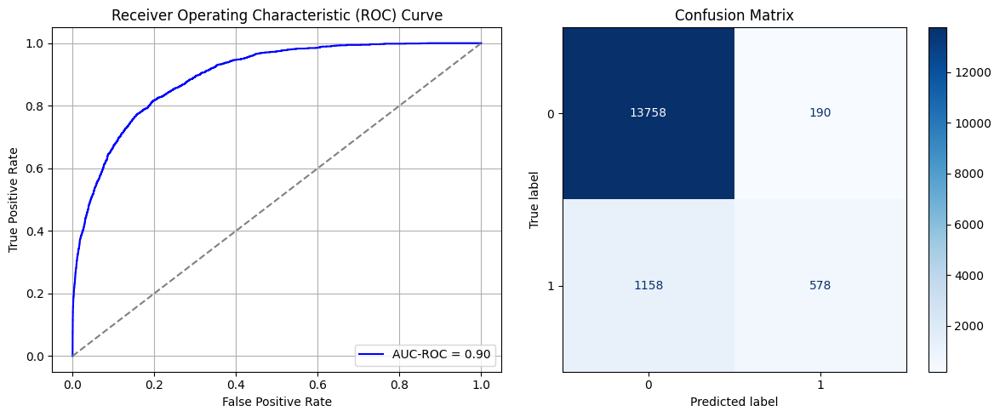

Best threshold based on F1-score: 0.2061629444360733
False Negative Rate: 0.6670506912442397
Time elapsed (performance): 1.6964894389998335
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6922 - loss: 0.5673 - val_AUC: 0.8730 - val_loss: 0.4139
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8693 - loss: 0.4025 - val_AUC: 0.8752 - val_loss: 0.4014
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8694 - loss: 0.4028 - val_AUC: 0.8772 - val_loss: 0.4013
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8685 - loss: 0.4046 - val_AUC: 0.8770 - val_loss: 0.3980
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8699 - loss: 0.4044 - val_AUC: 0.8778 - val_loss: 0.4226
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.3953 - val_AUC: 0.8770 - val_loss: 0.4052
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.3931 - val_AUC: 0.8771 - val_loss: 0.3972
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8736 - loss: 0.4003 - val_AUC: 0.8777 - val_loss: 0.4069
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8783 -

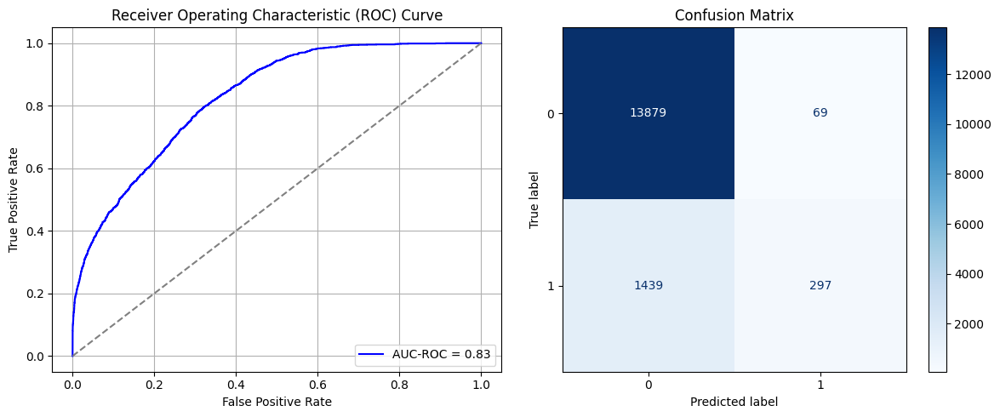

Best threshold based on F1-score: 0.1429571658372879
False Negative Rate: 0.8289170506912442
Time elapsed (performance): 1.197205748000215
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7074 - loss: 0.5541 - val_AUC: 0.8702 - val_loss: 0.4159
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8663 - loss: 0.4091 - val_AUC: 0.8762 - val_loss: 0.4004
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8743 - loss: 0.3947 - val_AUC: 0.8767 - val_loss: 0.4032
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8730 - loss: 0.3964 - val_AUC: 0.8784 - val_loss: 0.3965
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8798 - loss: 0.3908 - val_AUC: 0.8789 - val_loss: 0.3970
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8729 - loss: 0.3995 - val_AUC: 0.8792 - val_loss: 0.3952
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.3925 - val_AUC: 0.8790 - val_loss: 0.3953
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8777 - loss: 0.3867 - val_AUC: 0.8800 - val_loss: 0.3999
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8747 -

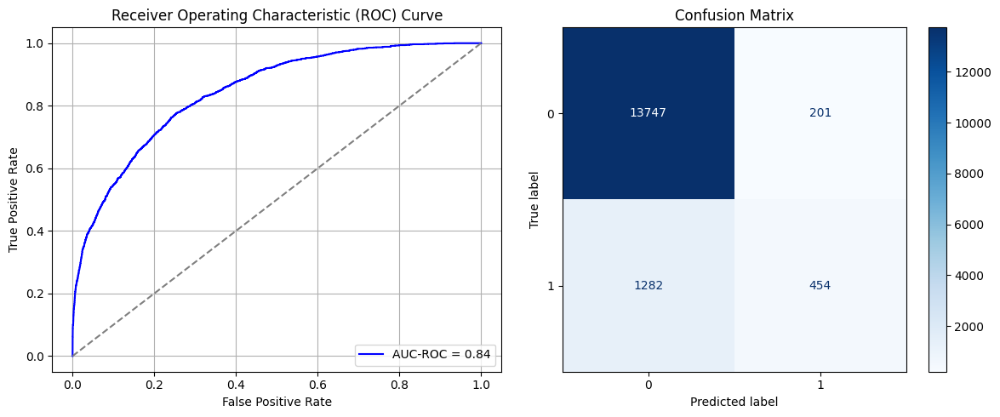

Best threshold based on F1-score: 0.2642044425010681
False Negative Rate: 0.738479262672811
Time elapsed (performance): 1.2451579769999626
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7044 - loss: 0.5469 - val_AUC: 0.8741 - val_loss: 0.4114
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8702 - loss: 0.4028 - val_AUC: 0.8780 - val_loss: 0.3980
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8725 - loss: 0.4011 - val_AUC: 0.8778 - val_loss: 0.4070
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8739 - loss: 0.3949 - val_AUC: 0.8787 - val_loss: 0.3984
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.3946 - val_AUC: 0.8792 - val_loss: 0.3958
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8751 - loss: 0.3973 - val_AUC: 0.8791 - val_loss: 0.3980
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.3946 - val_AUC: 0.8793 - val_loss: 0.4009
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8746 - loss: 0.3974 - val_AUC: 0.8797 - val_loss: 0.3983
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 -

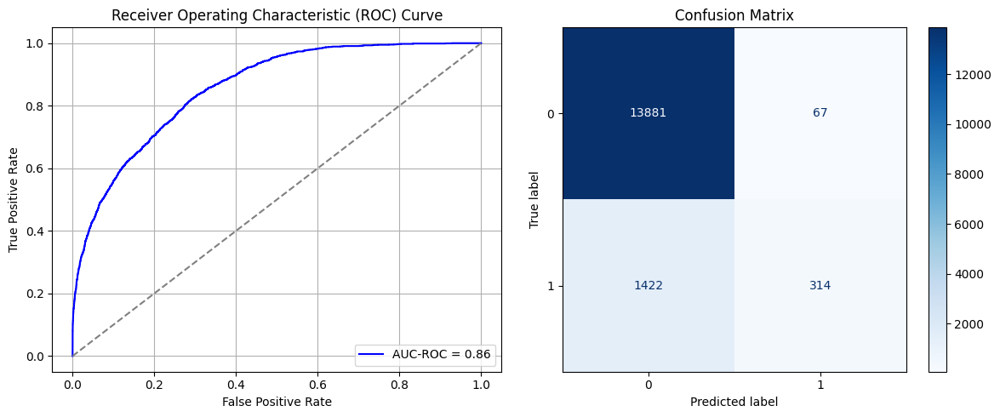

Best threshold based on F1-score: 0.144090473651886
False Negative Rate: 0.8191244239631337
Time elapsed (performance): 1.869666232000327
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7218 - loss: 0.5448 - val_AUC: 0.8709 - val_loss: 0.4637
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8667 - loss: 0.4079 - val_AUC: 0.8773 - val_loss: 0.3979
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8717 - loss: 0.3991 - val_AUC: 0.8778 - val_loss: 0.3981
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.8733 - loss: 0.3972 - val_AUC: 0.8782 - val_loss: 0.3957
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.3950 - val_AUC: 0.8792 - val_loss: 0.4030
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8783 - loss: 0.3911 - val_AUC: 0.8777 - val_loss: 0.3994
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 - loss: 0.3901 - val_AUC: 0.8795 - val_loss: 0.3937
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8786 - loss: 0.3925 - val_AUC: 0.8800 - val_loss: 0.3954
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 -

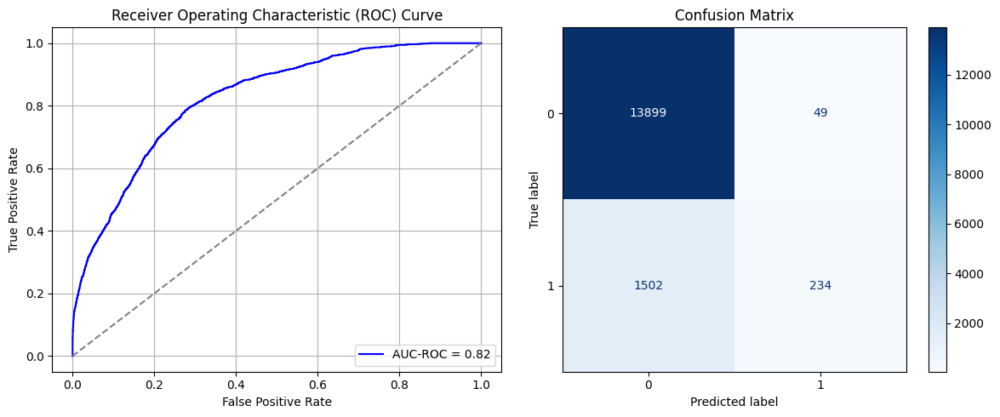

Best threshold based on F1-score: 0.06714700907468796
False Negative Rate: 0.8652073732718893
Time elapsed (performance): 1.1894526400001268
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7138 - loss: 0.5418 - val_AUC: 0.8727 - val_loss: 0.4121
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8642 - loss: 0.4110 - val_AUC: 0.8764 - val_loss: 0.4050
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8672 - loss: 0.4048 - val_AUC: 0.8778 - val_loss: 0.3981
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8699 - loss: 0.4051 - val_AUC: 0.8787 - val_loss: 0.3965
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8753 - loss: 0.3962 - val_AUC: 0.8783 - val_loss: 0.3959
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.3936 - val_AUC: 0.8796 - val_loss: 0.3946
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8753 - loss: 0.3943 - val_AUC: 0.8807 - val_loss: 0.3921
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.3932 - val_AUC: 0.8810 - val_loss: 0.3918
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8754 -

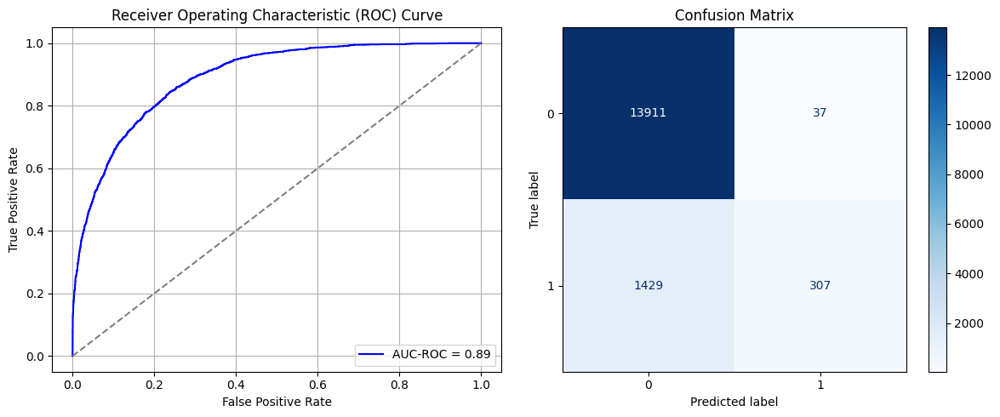

Best threshold based on F1-score: 0.09541977941989899
False Negative Rate: 0.8231566820276498
Time elapsed (performance): 1.6643132350000087
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7022 - loss: 0.5520 - val_AUC: 0.8716 - val_loss: 0.4147
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8672 - loss: 0.4063 - val_AUC: 0.8762 - val_loss: 0.4067
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8703 - loss: 0.4028 - val_AUC: 0.8768 - val_loss: 0.3997
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8767 - loss: 0.3938 - val_AUC: 0.8781 - val_loss: 0.4040
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.3959 - val_AUC: 0.8796 - val_loss: 0.3941
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8792 - loss: 0.3891 - val_AUC: 0.8788 - val_loss: 0.3950
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8738 - loss: 0.3954 - val_AUC: 0.8794 - val_loss: 0.3941
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8745 - loss: 0.3955 - val_AUC: 0.8774 - val_loss: 0.3968
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 -

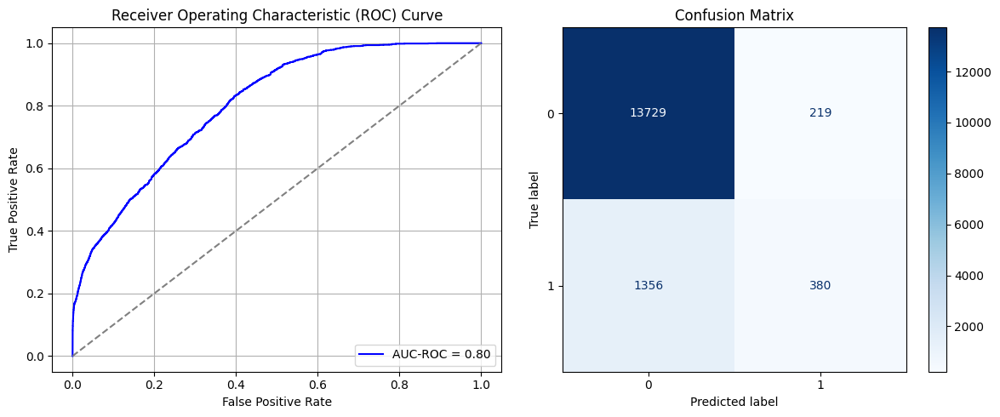

Best threshold based on F1-score: 0.3183974027633667
False Negative Rate: 0.7811059907834101
Time elapsed (performance): 1.21463218100007
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7115 - loss: 0.5408 - val_AUC: 0.8727 - val_loss: 0.4129
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8660 - loss: 0.4094 - val_AUC: 0.8759 - val_loss: 0.4046
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8731 - loss: 0.3960 - val_AUC: 0.8776 - val_loss: 0.4050
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8716 - loss: 0.4006 - val_AUC: 0.8802 - val_loss: 0.3929
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8779 - loss: 0.3926 - val_AUC: 0.8802 - val_loss: 0.3992
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.3917 - val_AUC: 0.8800 - val_loss: 0.3957
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8778 - loss: 0.3898 - val_AUC: 0.8794 - val_loss: 0.4015
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8802 - loss: 0.3887 - val_AUC: 0.8793 - val_loss: 0.3939
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 -

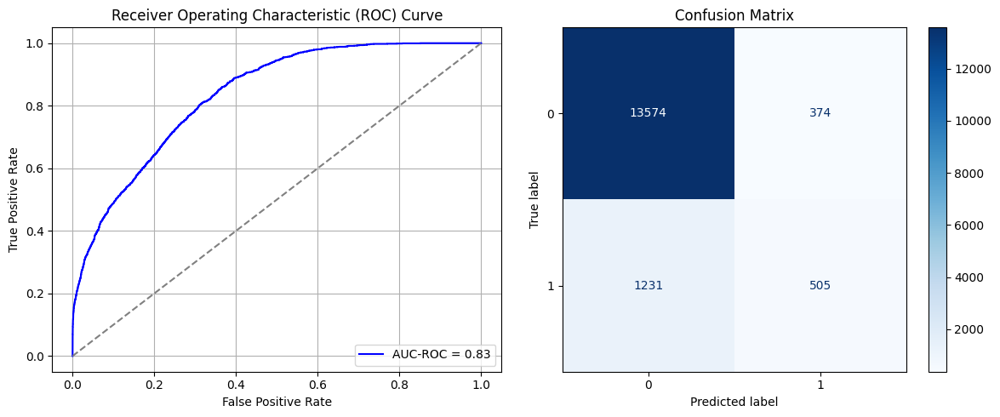

Best threshold based on F1-score: 0.3190406858921051
False Negative Rate: 0.7091013824884793
Time elapsed (performance): 1.7560490040000332
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7371 - loss: 0.5351 - val_AUC: 0.8726 - val_loss: 0.4113
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8671 - loss: 0.4076 - val_AUC: 0.8774 - val_loss: 0.3993
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 - loss: 0.4003 - val_AUC: 0.8778 - val_loss: 0.3970
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8725 - loss: 0.3956 - val_AUC: 0.8787 - val_loss: 0.3967
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8740 - loss: 0.3956 - val_AUC: 0.8775 - val_loss: 0.3975
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8773 - loss: 0.3938 - val_AUC: 0.8777 - val_loss: 0.4014
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.3955 - val_AUC: 0.8785 - val_loss: 0.3953
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.3929 - val_AUC: 0.8790 - val_loss: 0.3945
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8757 -

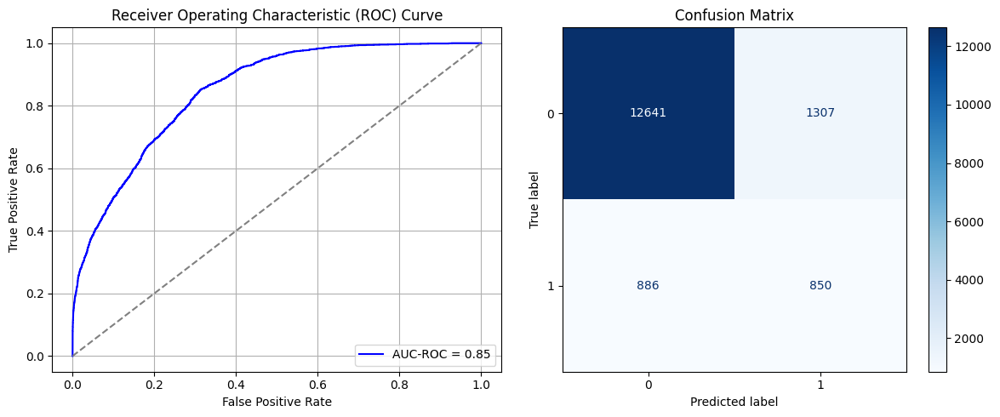

Best threshold based on F1-score: 0.5112972259521484
False Negative Rate: 0.5103686635944701
Time elapsed (performance): 1.2531718750001346
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6873 - loss: 0.5597 - val_AUC: 0.8724 - val_loss: 0.4131
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8708 - loss: 0.4034 - val_AUC: 0.8769 - val_loss: 0.3993
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8741 - loss: 0.4009 - val_AUC: 0.8780 - val_loss: 0.3967
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8736 - loss: 0.3992 - val_AUC: 0.8785 - val_loss: 0.4090
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8731 - loss: 0.3989 - val_AUC: 0.8782 - val_loss: 0.4042
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8785 - loss: 0.3889 - val_AUC: 0.8792 - val_loss: 0.3948
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8743 - loss: 0.3964 - val_AUC: 0.8783 - val_loss: 0.3969
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.3944 - val_AUC: 0.8794 - val_loss: 0.4049
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8810 -

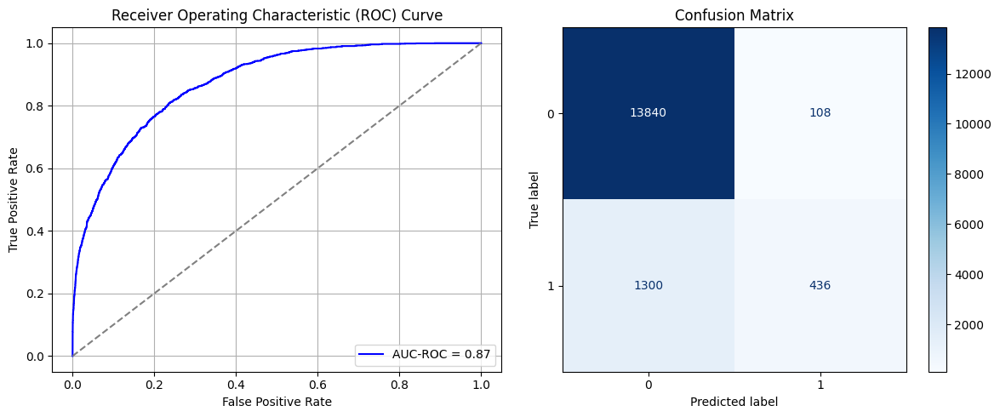

Best threshold based on F1-score: 0.16620633006095886
False Negative Rate: 0.7488479262672811
Time elapsed (performance): 1.2619711420002204
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6913 - loss: 0.5486 - val_AUC: 0.8714 - val_loss: 0.4136
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8618 - loss: 0.4139 - val_AUC: 0.8774 - val_loss: 0.4105
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8676 - loss: 0.4085 - val_AUC: 0.8778 - val_loss: 0.3971
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.3951 - val_AUC: 0.8773 - val_loss: 0.4172
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8748 - loss: 0.3939 - val_AUC: 0.8782 - val_loss: 0.3978
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8760 - loss: 0.3964 - val_AUC: 0.8794 - val_loss: 0.3982
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.3933 - val_AUC: 0.8781 - val_loss: 0.4006
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8803 - loss: 0.3875 - val_AUC: 0.8786 - val_loss: 0.3954
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8746 -

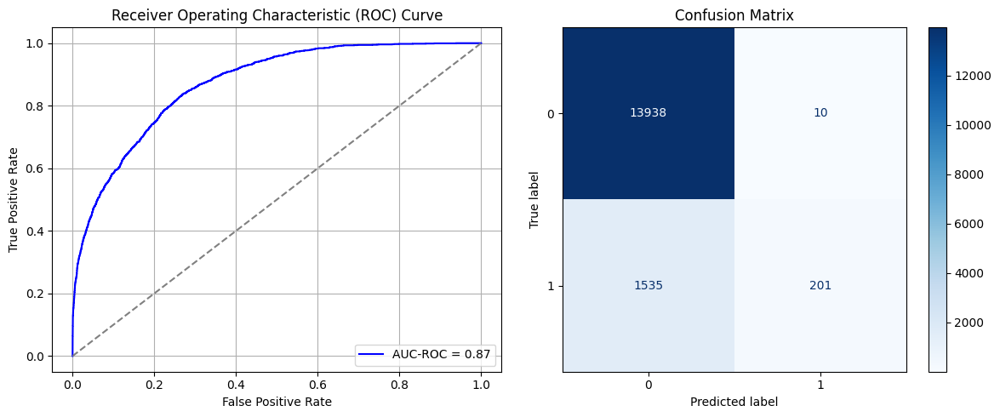

Best threshold based on F1-score: 0.043480344116687775
False Negative Rate: 0.8842165898617511
Time elapsed (performance): 1.6900705759999255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7266 - loss: 0.5380 - val_AUC: 0.8717 - val_loss: 0.4212
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8635 - loss: 0.4130 - val_AUC: 0.8772 - val_loss: 0.4000
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8695 - loss: 0.4020 - val_AUC: 0.8778 - val_loss: 0.3976
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.4017 - val_AUC: 0.8787 - val_loss: 0.3951
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8757 - loss: 0.3931 - val_AUC: 0.8779 - val_loss: 0.4001
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8714 - loss: 0.3996 - val_AUC: 0.8785 - val_loss: 0.3958
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.3974 - val_AUC: 0.8787 - val_loss: 0.4062
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8761 - loss: 0.3937 - val_AUC: 0.8788 - val_loss: 0.3951
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8830 -

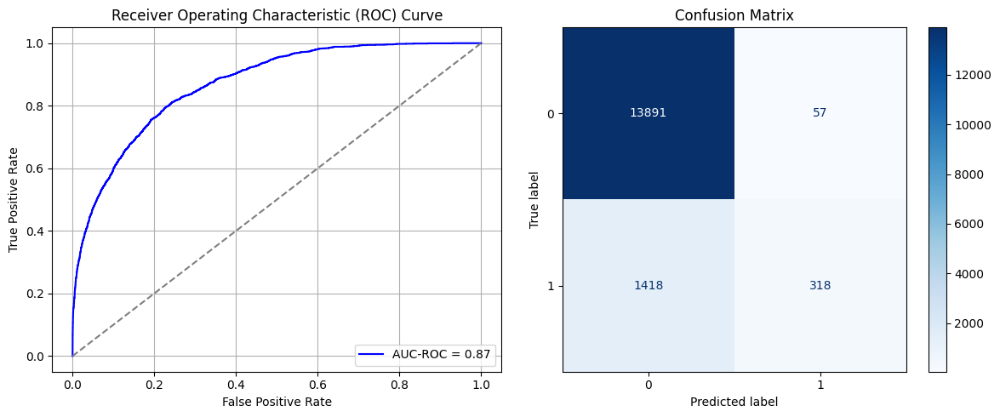

Best threshold based on F1-score: 0.11567067354917526
False Negative Rate: 0.8168202764976958
Time elapsed (performance): 1.5230886580002334
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6963 - loss: 0.5594 - val_AUC: 0.8689 - val_loss: 0.4415
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8669 - loss: 0.4084 - val_AUC: 0.8749 - val_loss: 0.4040
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8683 - loss: 0.4058 - val_AUC: 0.8771 - val_loss: 0.3990
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8785 - loss: 0.3913 - val_AUC: 0.8780 - val_loss: 0.3973
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8740 - loss: 0.3987 - val_AUC: 0.8784 - val_loss: 0.3975
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8713 - loss: 0.3980 - val_AUC: 0.8788 - val_loss: 0.4015
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8755 - loss: 0.3961 - val_AUC: 0.8793 - val_loss: 0.3943
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8727 - loss: 0.3963 - val_AUC: 0.8762 - val_loss: 0.3987
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 -

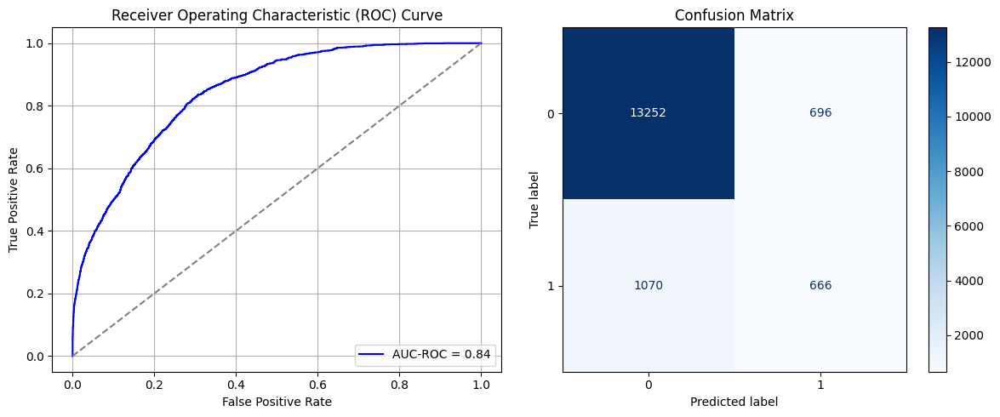

Best threshold based on F1-score: 0.38543763756752014
False Negative Rate: 0.6163594470046083
Time elapsed (performance): 1.8644716300000255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7065 - loss: 0.5503 - val_AUC: 0.8695 - val_loss: 0.4206
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8704 - loss: 0.4063 - val_AUC: 0.8755 - val_loss: 0.4012
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.3941 - val_AUC: 0.8785 - val_loss: 0.3964
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8707 - loss: 0.4030 - val_AUC: 0.8787 - val_loss: 0.3953
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8696 - loss: 0.4046 - val_AUC: 0.8792 - val_loss: 0.3957
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8742 - loss: 0.3983 - val_AUC: 0.8781 - val_loss: 0.3957
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8769 - loss: 0.3924 - val_AUC: 0.8794 - val_loss: 0.3941
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8804 - loss: 0.3891 - val_AUC: 0.8794 - val_loss: 0.3957
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 -

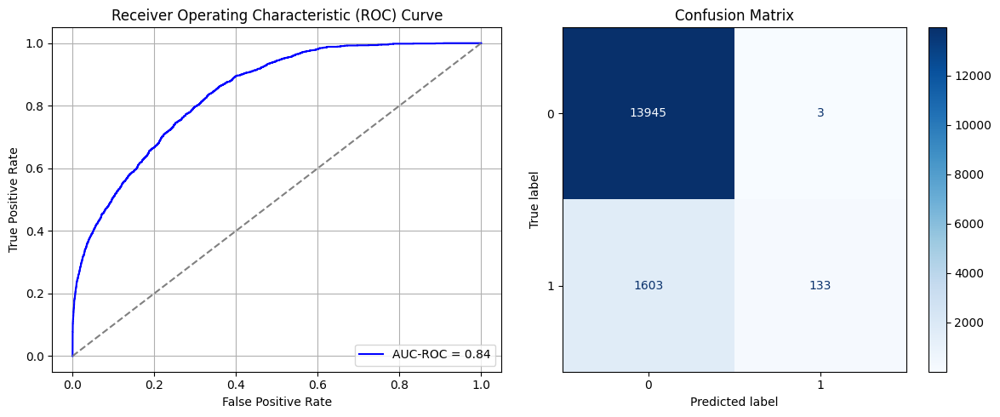

Best threshold based on F1-score: 0.008963276632130146
False Negative Rate: 0.9233870967741935
Time elapsed (performance): 1.228223760000219
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7074 - loss: 0.5438 - val_AUC: 0.8743 - val_loss: 0.4069
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 - loss: 0.3999 - val_AUC: 0.8765 - val_loss: 0.4067
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.3983 - val_AUC: 0.8777 - val_loss: 0.3970
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.3962 - val_AUC: 0.8765 - val_loss: 0.3996
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8730 - loss: 0.3948 - val_AUC: 0.8765 - val_loss: 0.4004
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8756 - loss: 0.3933 - val_AUC: 0.8784 - val_loss: 0.4044
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8707 - loss: 0.3993 - val_AUC: 0.8783 - val_loss: 0.4059
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8801 - loss: 0.3881 - val_AUC: 0.8792 - val_loss: 0.3965
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8760 -

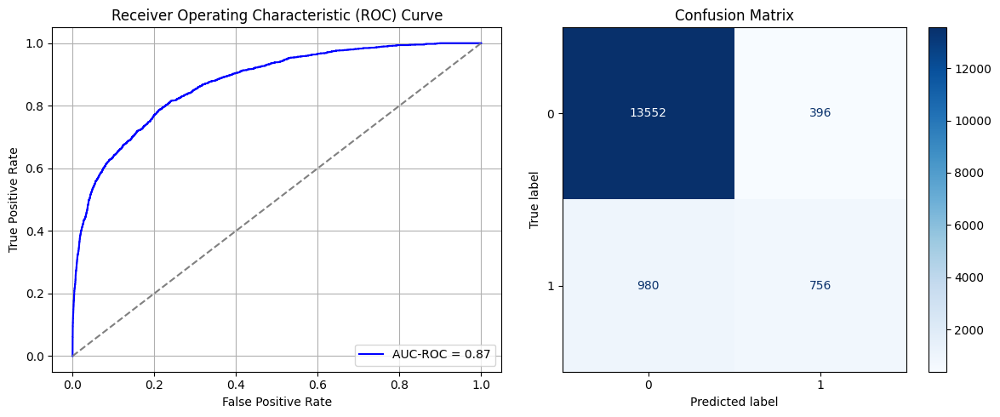

Best threshold based on F1-score: 0.3942498564720154
False Negative Rate: 0.5645161290322581
Time elapsed (performance): 1.2938263279997955
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6880 - loss: 0.5585 - val_AUC: 0.8658 - val_loss: 0.4215
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8642 - loss: 0.4127 - val_AUC: 0.8772 - val_loss: 0.4018
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.3996 - val_AUC: 0.8780 - val_loss: 0.4003
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8670 - loss: 0.4057 - val_AUC: 0.8787 - val_loss: 0.4048
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8753 - loss: 0.3957 - val_AUC: 0.8785 - val_loss: 0.3982
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.3977 - val_AUC: 0.8792 - val_loss: 0.3953
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8733 - loss: 0.3975 - val_AUC: 0.8790 - val_loss: 0.3955
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8767 - loss: 0.3922 - val_AUC: 0.8799 - val_loss: 0.3932
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8833 -

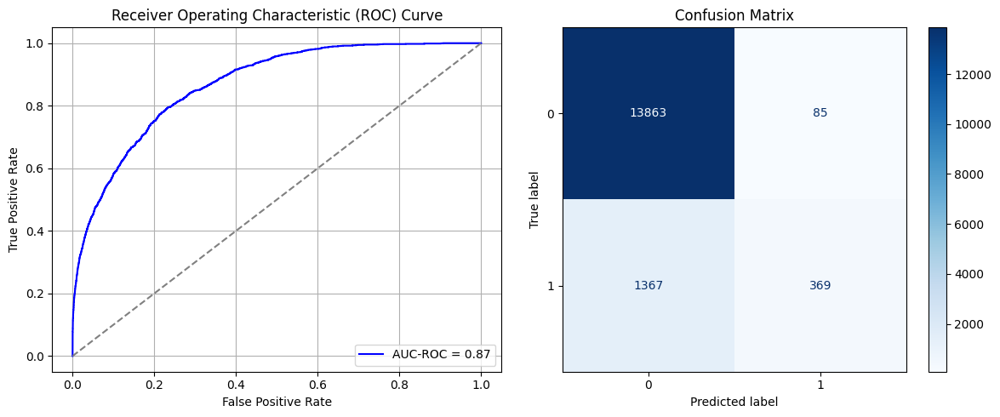

Best threshold based on F1-score: 0.17227351665496826
False Negative Rate: 0.7874423963133641
Time elapsed (performance): 1.6922930739997355
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7250 - loss: 0.5400 - val_AUC: 0.8729 - val_loss: 0.4082
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8705 - loss: 0.4038 - val_AUC: 0.8770 - val_loss: 0.4002
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8720 - loss: 0.3990 - val_AUC: 0.8776 - val_loss: 0.3973
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - AUC: 0.8700 - loss: 0.4021 - val_AUC: 0.8786 - val_loss: 0.3959
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.8755 - loss: 0.3948 - val_AUC: 0.8776 - val_loss: 0.4014
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8747 - loss: 0.3965 - val_AUC: 0.8790 - val_loss: 0.3958
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8745 - loss: 0.3983 - val_AUC: 0.8784 - val_loss: 0.3955
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8747 - loss: 0.3937 - val_AUC: 0.8784 - val_loss: 0.4059
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 -

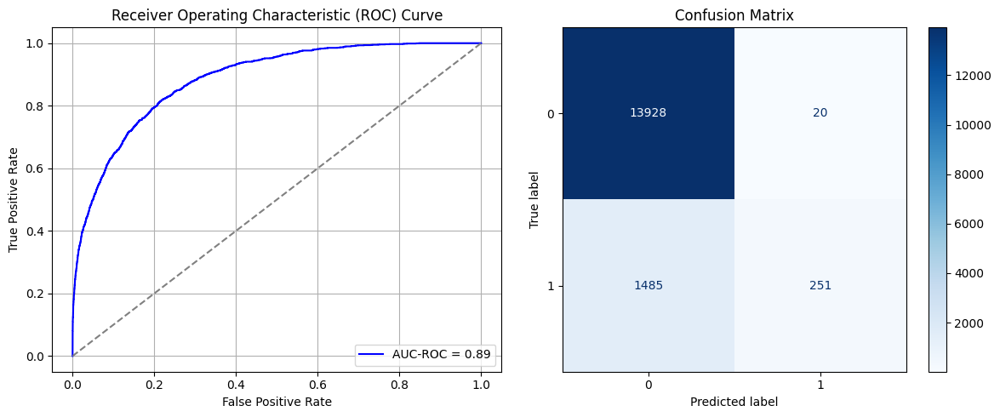

Best threshold based on F1-score: 0.07018759846687317
False Negative Rate: 0.8554147465437788
Time elapsed (performance): 1.2844273860000612
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6899 - loss: 0.5544 - val_AUC: 0.8709 - val_loss: 0.4152
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8655 - loss: 0.4101 - val_AUC: 0.8775 - val_loss: 0.4087
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8705 - loss: 0.3999 - val_AUC: 0.8781 - val_loss: 0.3968
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4006 - val_AUC: 0.8789 - val_loss: 0.4004
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8750 - loss: 0.3963 - val_AUC: 0.8785 - val_loss: 0.3988
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8742 - loss: 0.3967 - val_AUC: 0.8788 - val_loss: 0.3965
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8809 - loss: 0.3867 - val_AUC: 0.8774 - val_loss: 0.3971
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.3932 - val_AUC: 0.8794 - val_loss: 0.3939
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8851 -

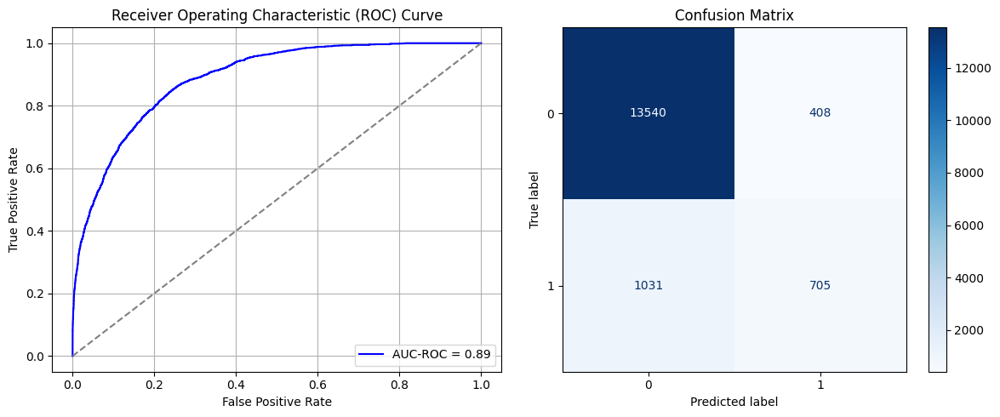

Best threshold based on F1-score: 0.31837308406829834
False Negative Rate: 0.5938940092165899
Time elapsed (performance): 1.7040733419999015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6855 - loss: 0.5502 - val_AUC: 0.8719 - val_loss: 0.4127
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8694 - loss: 0.4047 - val_AUC: 0.8776 - val_loss: 0.4071
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8705 - loss: 0.3996 - val_AUC: 0.8782 - val_loss: 0.4083
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8744 - loss: 0.3985 - val_AUC: 0.8784 - val_loss: 0.4022
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8747 - loss: 0.3949 - val_AUC: 0.8792 - val_loss: 0.3993
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8727 - loss: 0.3989 - val_AUC: 0.8791 - val_loss: 0.3970
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8735 - loss: 0.3944 - val_AUC: 0.8788 - val_loss: 0.3956
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8788 - loss: 0.3876 - val_AUC: 0.8789 - val_loss: 0.3942
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8787 -

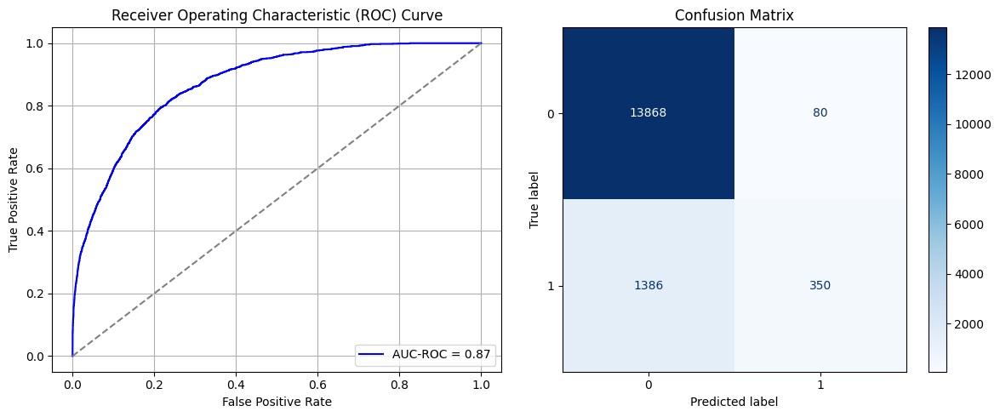

Best threshold based on F1-score: 0.09762125462293625
False Negative Rate: 0.7983870967741935
Time elapsed (performance): 1.6670275580004272
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7288 - loss: 0.5378 - val_AUC: 0.8732 - val_loss: 0.4114
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8637 - loss: 0.4122 - val_AUC: 0.8768 - val_loss: 0.4025
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8715 - loss: 0.4006 - val_AUC: 0.8776 - val_loss: 0.3978
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8712 - loss: 0.4028 - val_AUC: 0.8775 - val_loss: 0.4001
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.3970 - val_AUC: 0.8787 - val_loss: 0.3952
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8732 - loss: 0.3972 - val_AUC: 0.8781 - val_loss: 0.3955
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8733 - loss: 0.3967 - val_AUC: 0.8796 - val_loss: 0.3963
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.3896 - val_AUC: 0.8803 - val_loss: 0.3942
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 -

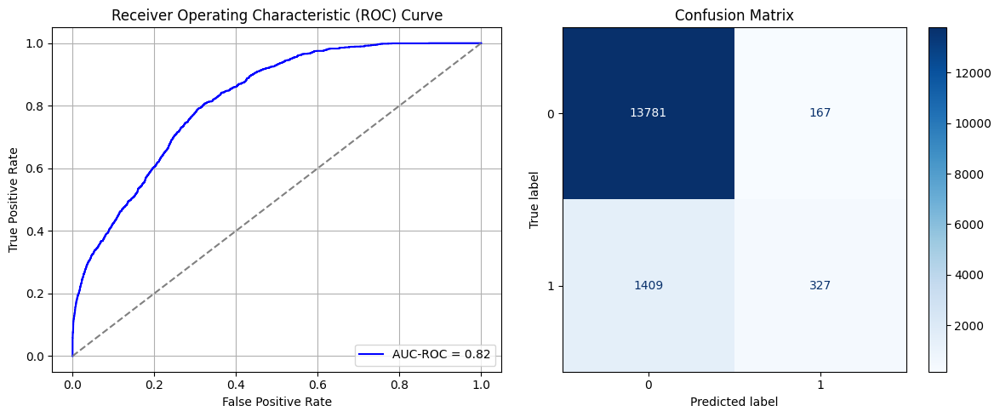

Best threshold based on F1-score: 0.1256166398525238
False Negative Rate: 0.8116359447004609
Time elapsed (performance): 1.5614623030000985
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7185 - loss: 0.5409 - val_AUC: 0.8718 - val_loss: 0.4108
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8696 - loss: 0.4037 - val_AUC: 0.8762 - val_loss: 0.3991
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8699 - loss: 0.4039 - val_AUC: 0.8770 - val_loss: 0.3999
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.3927 - val_AUC: 0.8786 - val_loss: 0.4000
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.3948 - val_AUC: 0.8788 - val_loss: 0.4006
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.3953 - val_AUC: 0.8784 - val_loss: 0.3954
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8781 - loss: 0.3915 - val_AUC: 0.8796 - val_loss: 0.4005
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8761 - loss: 0.3950 - val_AUC: 0.8796 - val_loss: 0.3942
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8769 -

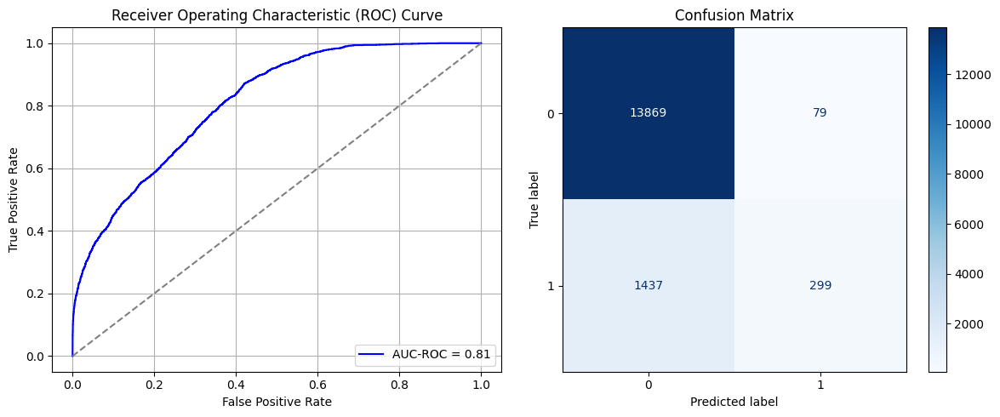

Best threshold based on F1-score: 0.19856183230876923
False Negative Rate: 0.8277649769585254
Time elapsed (performance): 1.6668766159996267
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6905 - loss: 0.5549 - val_AUC: 0.8660 - val_loss: 0.4282
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8675 - loss: 0.4054 - val_AUC: 0.8757 - val_loss: 0.4031
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8772 - loss: 0.3933 - val_AUC: 0.8763 - val_loss: 0.4083
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.3937 - val_AUC: 0.8779 - val_loss: 0.4005
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8750 - loss: 0.3952 - val_AUC: 0.8779 - val_loss: 0.3966
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8756 - loss: 0.3949 - val_AUC: 0.8778 - val_loss: 0.4015
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.8750 - loss: 0.3920 - val_AUC: 0.8786 - val_loss: 0.3947
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - AUC: 0.8806 - loss: 0.3886 - val_AUC: 0.8783 - val_loss: 0.3995
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8750 -

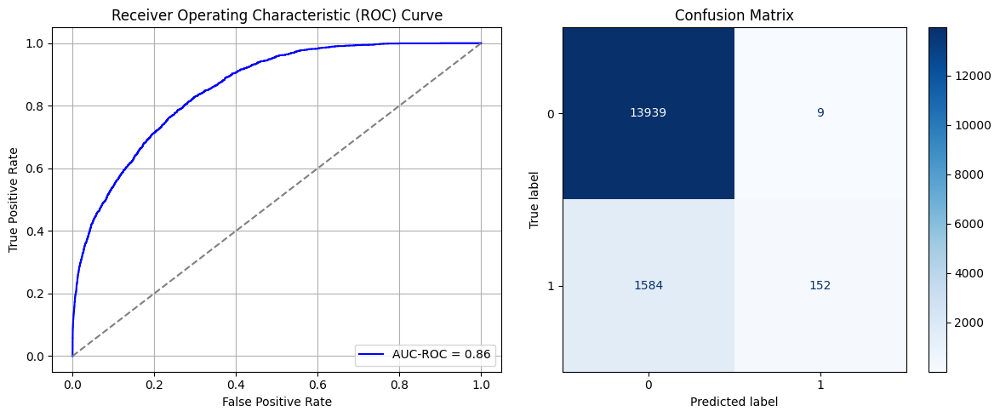

Best threshold based on F1-score: 0.04493805021047592
False Negative Rate: 0.9124423963133641
Time elapsed (performance): 2.403521175000151
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6994 - loss: 0.5481 - val_AUC: 0.8719 - val_loss: 0.4105
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8632 - loss: 0.4126 - val_AUC: 0.8752 - val_loss: 0.4275
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8689 - loss: 0.4054 - val_AUC: 0.8748 - val_loss: 0.4012
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8749 - loss: 0.3950 - val_AUC: 0.8781 - val_loss: 0.3972
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8758 - loss: 0.3960 - val_AUC: 0.8795 - val_loss: 0.3958
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8765 - loss: 0.3937 - val_AUC: 0.8787 - val_loss: 0.3962
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8804 - loss: 0.3904 - val_AUC: 0.8791 - val_loss: 0.3983
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4019 - val_AUC: 0.8793 - val_loss: 0.3936
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8786 -

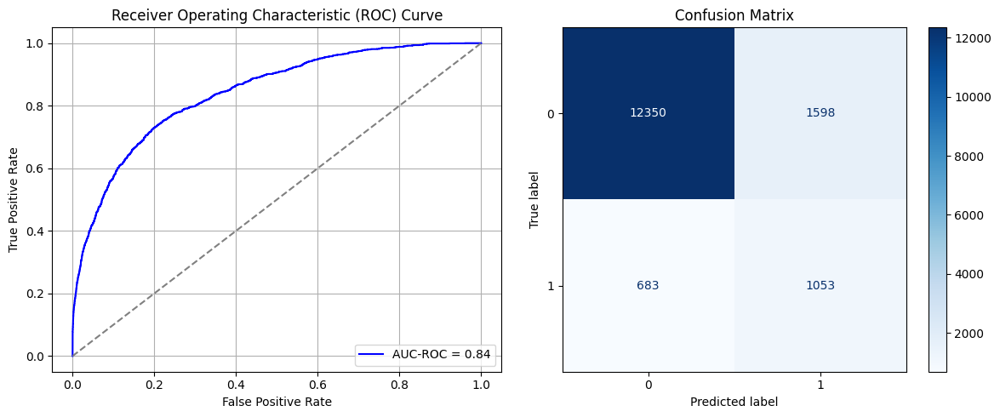

Best threshold based on F1-score: 0.5567131638526917
False Negative Rate: 0.3934331797235023
Time elapsed (performance): 1.3187170330002118
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7098 - loss: 0.5503 - val_AUC: 0.8719 - val_loss: 0.4138
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8703 - loss: 0.4035 - val_AUC: 0.8770 - val_loss: 0.4006
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8711 - loss: 0.4011 - val_AUC: 0.8776 - val_loss: 0.3975
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8708 - loss: 0.4010 - val_AUC: 0.8765 - val_loss: 0.3991
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8715 - loss: 0.3995 - val_AUC: 0.8793 - val_loss: 0.3949
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.3907 - val_AUC: 0.8793 - val_loss: 0.3968
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8776 - loss: 0.3858 - val_AUC: 0.8795 - val_loss: 0.3988
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8752 - loss: 0.3940 - val_AUC: 0.8790 - val_loss: 0.3991
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 -

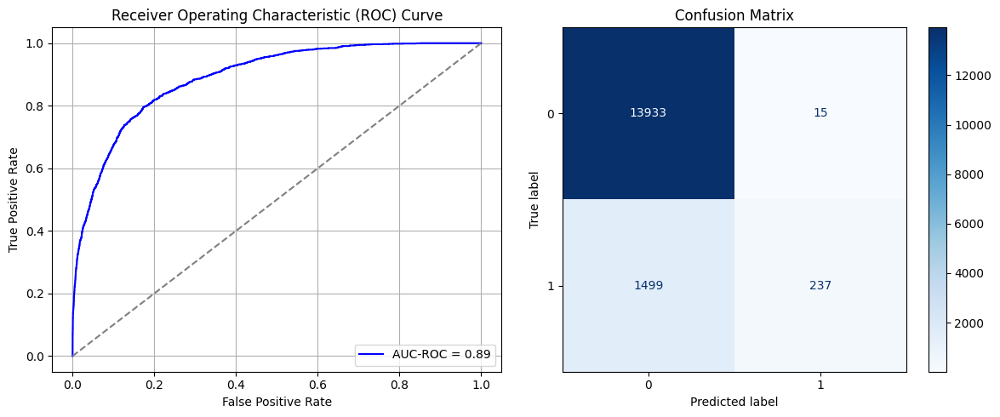

Best threshold based on F1-score: 0.050039663910865784
False Negative Rate: 0.863479262672811
Time elapsed (performance): 1.90529639100032
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7043 - loss: 0.5447 - val_AUC: 0.8730 - val_loss: 0.4078
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8672 - loss: 0.4103 - val_AUC: 0.8757 - val_loss: 0.4002
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4005 - val_AUC: 0.8769 - val_loss: 0.3984
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8716 - loss: 0.4007 - val_AUC: 0.8769 - val_loss: 0.4030
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8761 - loss: 0.3933 - val_AUC: 0.8780 - val_loss: 0.4036
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8750 - loss: 0.3965 - val_AUC: 0.8789 - val_loss: 0.3952
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.3915 - val_AUC: 0.8785 - val_loss: 0.3967
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8743 - loss: 0.3959 - val_AUC: 0.8783 - val_loss: 0.3959
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 -

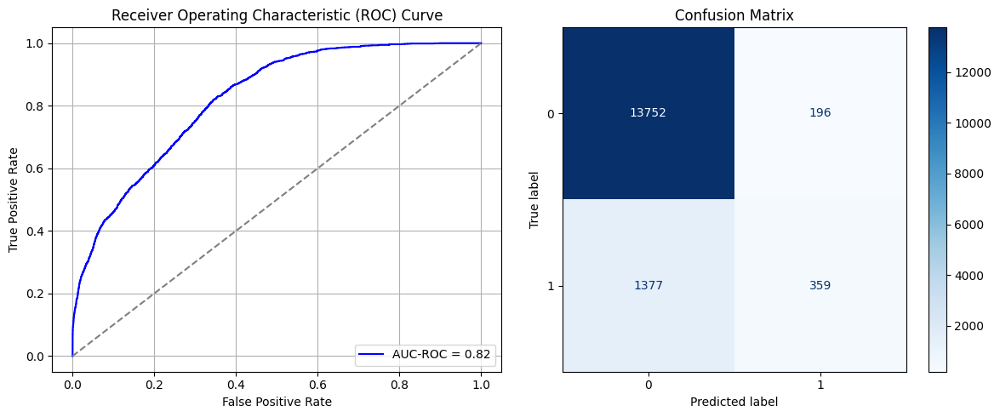

Best threshold based on F1-score: 0.21978160738945007
False Negative Rate: 0.7932027649769585
Time elapsed (performance): 1.2918086069998935
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6823 - loss: 0.5601 - val_AUC: 0.8722 - val_loss: 0.4144
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8640 - loss: 0.4133 - val_AUC: 0.8765 - val_loss: 0.4163
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 - loss: 0.4050 - val_AUC: 0.8765 - val_loss: 0.4012
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8698 - loss: 0.4037 - val_AUC: 0.8773 - val_loss: 0.3986
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8752 - loss: 0.3937 - val_AUC: 0.8778 - val_loss: 0.3994
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8734 - loss: 0.3971 - val_AUC: 0.8788 - val_loss: 0.3950
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8792 - loss: 0.3915 - val_AUC: 0.8789 - val_loss: 0.3994
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8783 - loss: 0.3922 - val_AUC: 0.8789 - val_loss: 0.3980
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8789 -

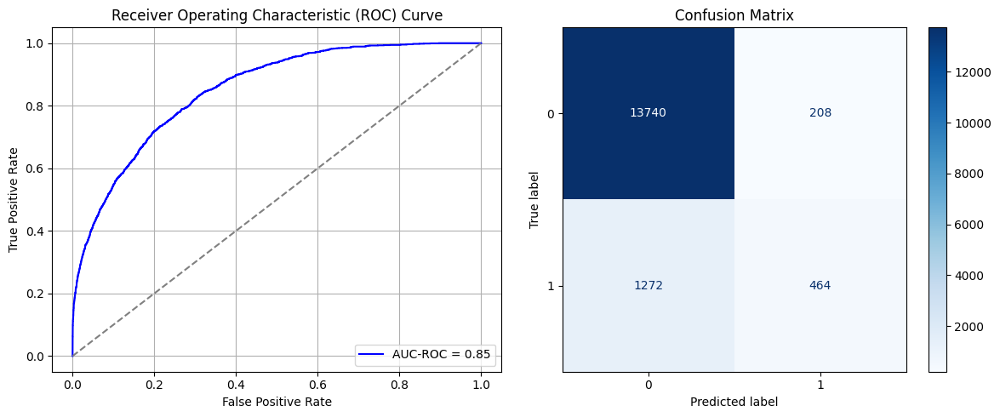

Best threshold based on F1-score: 0.3017086684703827
False Negative Rate: 0.7327188940092166
Time elapsed (performance): 1.293446080999729
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7288 - loss: 0.5354 - val_AUC: 0.8717 - val_loss: 0.4075
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8646 - loss: 0.4114 - val_AUC: 0.8777 - val_loss: 0.3986
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 - loss: 0.3914 - val_AUC: 0.8773 - val_loss: 0.3986
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8697 - loss: 0.4051 - val_AUC: 0.8787 - val_loss: 0.4118
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8694 - loss: 0.4036 - val_AUC: 0.8791 - val_loss: 0.3953
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8758 - loss: 0.3959 - val_AUC: 0.8788 - val_loss: 0.3966
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8795 - loss: 0.3884 - val_AUC: 0.8787 - val_loss: 0.3950
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8726 - loss: 0.3989 - val_AUC: 0.8802 - val_loss: 0.3982
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8739 -

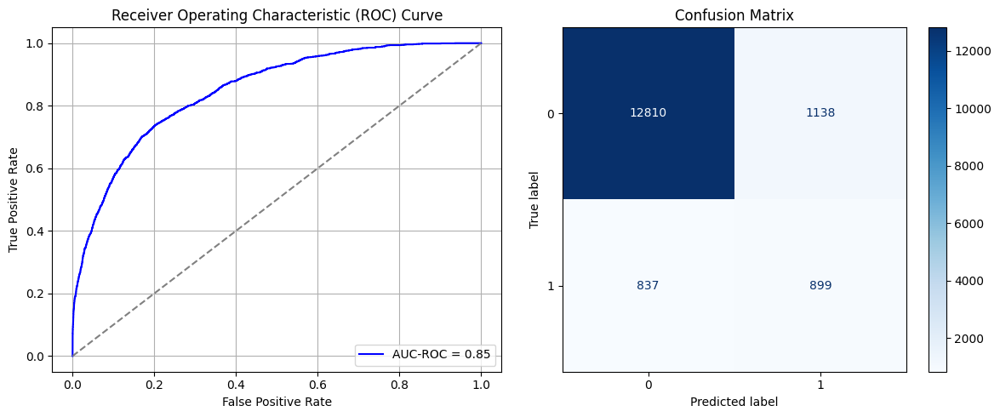

Best threshold based on F1-score: 0.46374741196632385
False Negative Rate: 0.48214285714285715
Time elapsed (performance): 1.3141216720000557
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7099 - loss: 0.5551 - val_AUC: 0.8725 - val_loss: 0.4140
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8649 - loss: 0.4085 - val_AUC: 0.8772 - val_loss: 0.3990
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8757 - loss: 0.3973 - val_AUC: 0.8785 - val_loss: 0.4026
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8726 - loss: 0.3999 - val_AUC: 0.8788 - val_loss: 0.3997
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8713 - loss: 0.3990 - val_AUC: 0.8784 - val_loss: 0.3963
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.3931 - val_AUC: 0.8787 - val_loss: 0.4055
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8748 - loss: 0.3932 - val_AUC: 0.8789 - val_loss: 0.3952
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8741 - loss: 0.3970 - val_AUC: 0.8789 - val_loss: 0.3950
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8741 -

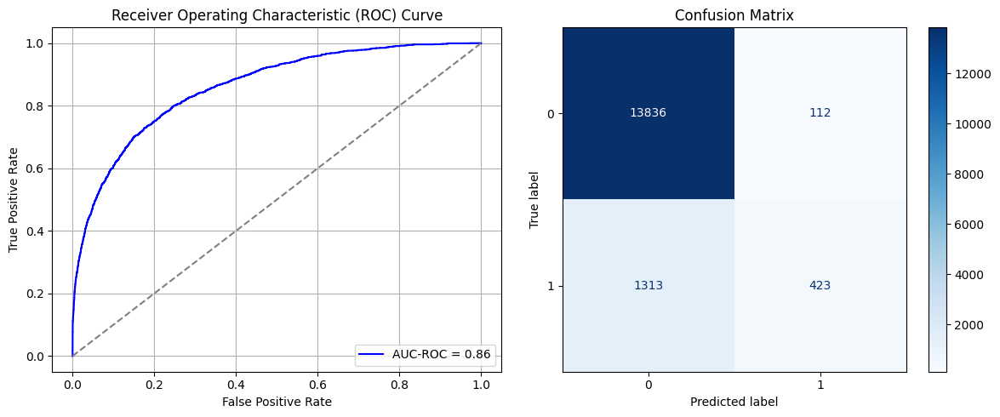

Best threshold based on F1-score: 0.16844214498996735
False Negative Rate: 0.756336405529954
Time elapsed (performance): 3.0304393309997977
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7087 - loss: 0.5472 - val_AUC: 0.8689 - val_loss: 0.4156
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8664 - loss: 0.4118 - val_AUC: 0.8755 - val_loss: 0.4055
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8695 - loss: 0.4045 - val_AUC: 0.8772 - val_loss: 0.4040
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8731 - loss: 0.4010 - val_AUC: 0.8781 - val_loss: 0.4052
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 - loss: 0.3927 - val_AUC: 0.8776 - val_loss: 0.3999
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 - loss: 0.3973 - val_AUC: 0.8790 - val_loss: 0.3964
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8814 - loss: 0.3875 - val_AUC: 0.8795 - val_loss: 0.3939
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.3907 - val_AUC: 0.8777 - val_loss: 0.4027
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8791 -

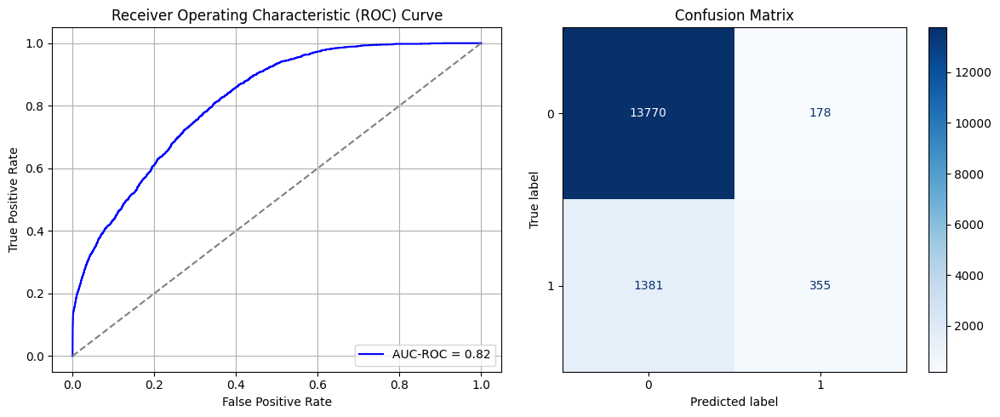

Best threshold based on F1-score: 0.21617504954338074
False Negative Rate: 0.7955069124423964
Time elapsed (performance): 1.3222387749997324
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7022 - loss: 0.5542 - val_AUC: 0.8736 - val_loss: 0.4263
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8670 - loss: 0.4085 - val_AUC: 0.8737 - val_loss: 0.4263
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8678 - loss: 0.4073 - val_AUC: 0.8759 - val_loss: 0.4021
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8767 - loss: 0.3953 - val_AUC: 0.8781 - val_loss: 0.3989
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.3988 - val_AUC: 0.8793 - val_loss: 0.3971
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8765 - loss: 0.3924 - val_AUC: 0.8773 - val_loss: 0.3988
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8767 - loss: 0.3941 - val_AUC: 0.8784 - val_loss: 0.3957
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8773 - loss: 0.3912 - val_AUC: 0.8792 - val_loss: 0.3983
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8779 -

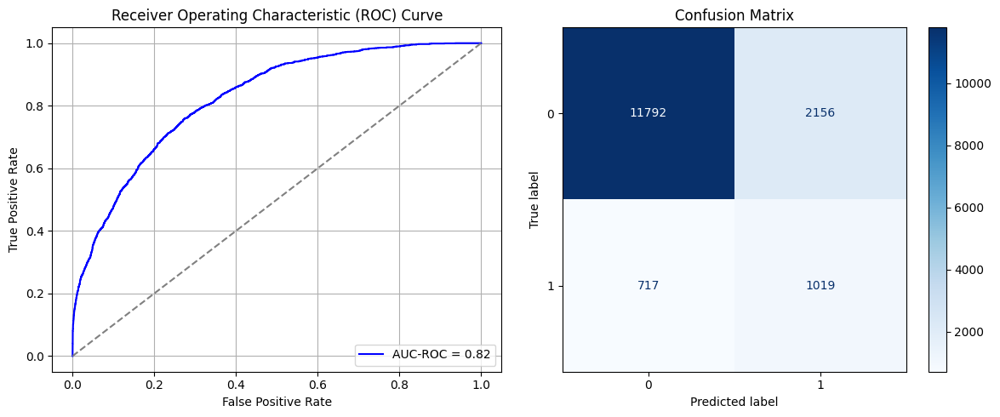

Best threshold based on F1-score: 0.5566253662109375
False Negative Rate: 0.4130184331797235
Time elapsed (performance): 1.817576050000298
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7116 - loss: 0.5457 - val_AUC: 0.8730 - val_loss: 0.4197
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8658 - loss: 0.4089 - val_AUC: 0.8760 - val_loss: 0.4000
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.3962 - val_AUC: 0.8780 - val_loss: 0.4092
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8736 - loss: 0.3993 - val_AUC: 0.8766 - val_loss: 0.3986
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.3912 - val_AUC: 0.8792 - val_loss: 0.3946
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 - loss: 0.3910 - val_AUC: 0.8783 - val_loss: 0.3970
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.3959 - val_AUC: 0.8774 - val_loss: 0.4005
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 - loss: 0.3871 - val_AUC: 0.8782 - val_loss: 0.3961
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 -

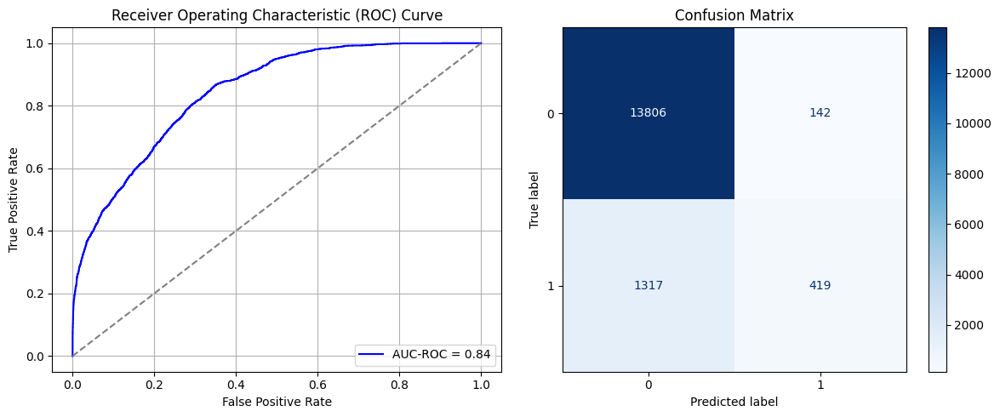

Best threshold based on F1-score: 0.2029547393321991
False Negative Rate: 0.7586405529953917
Time elapsed (performance): 1.681688461000249
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7344 - loss: 0.5350 - val_AUC: 0.8722 - val_loss: 0.4106
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8662 - loss: 0.4087 - val_AUC: 0.8766 - val_loss: 0.3994
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8727 - loss: 0.4001 - val_AUC: 0.8786 - val_loss: 0.3999
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.3945 - val_AUC: 0.8788 - val_loss: 0.3959
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.3961 - val_AUC: 0.8788 - val_loss: 0.3990
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.3959 - val_AUC: 0.8782 - val_loss: 0.4175
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8761 - loss: 0.3923 - val_AUC: 0.8796 - val_loss: 0.3967
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.3927 - val_AUC: 0.8797 - val_loss: 0.3943
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 -

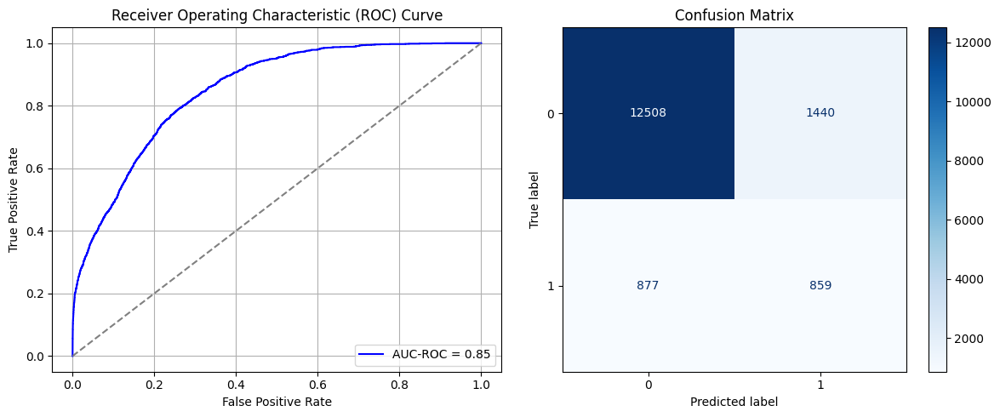

Best threshold based on F1-score: 0.41773438453674316
False Negative Rate: 0.505184331797235
Time elapsed (performance): 1.7305320929999652
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7308 - loss: 0.5378 - val_AUC: 0.8729 - val_loss: 0.4099
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8715 - loss: 0.4024 - val_AUC: 0.8768 - val_loss: 0.4135
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8733 - loss: 0.3990 - val_AUC: 0.8780 - val_loss: 0.3973
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8737 - loss: 0.3980 - val_AUC: 0.8779 - val_loss: 0.3997
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.3963 - val_AUC: 0.8782 - val_loss: 0.4033
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.3970 - val_AUC: 0.8785 - val_loss: 0.3986
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8749 - loss: 0.3952 - val_AUC: 0.8793 - val_loss: 0.3952
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8804 - loss: 0.3870 - val_AUC: 0.8787 - val_loss: 0.3960
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8794 -

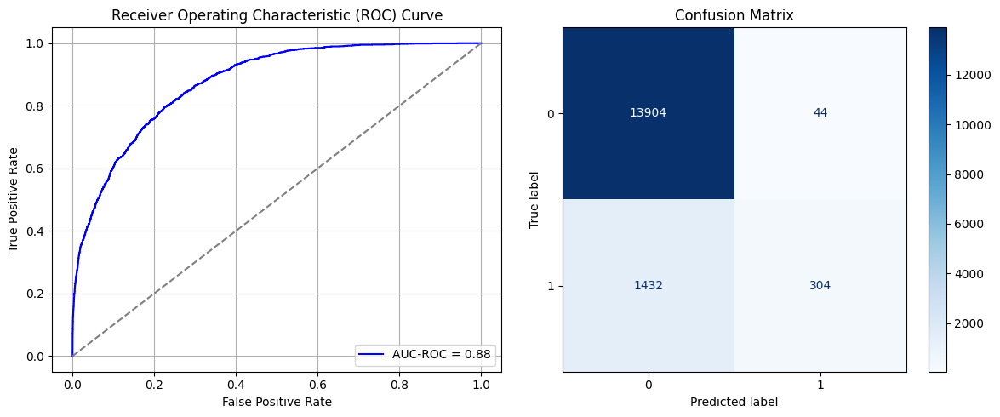

Best threshold based on F1-score: 0.06698582321405411
False Negative Rate: 0.8248847926267281
Time elapsed (performance): 1.8536137410001174
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7087 - loss: 0.5444 - val_AUC: 0.8718 - val_loss: 0.4112
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8678 - loss: 0.4054 - val_AUC: 0.8765 - val_loss: 0.3997
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8719 - loss: 0.3978 - val_AUC: 0.8759 - val_loss: 0.4116
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8742 - loss: 0.3970 - val_AUC: 0.8776 - val_loss: 0.4002
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.3965 - val_AUC: 0.8782 - val_loss: 0.3971
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8744 - loss: 0.3946 - val_AUC: 0.8783 - val_loss: 0.3955
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8774 - loss: 0.3937 - val_AUC: 0.8790 - val_loss: 0.3956
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8757 - loss: 0.3955 - val_AUC: 0.8796 - val_loss: 0.3944
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8786 -

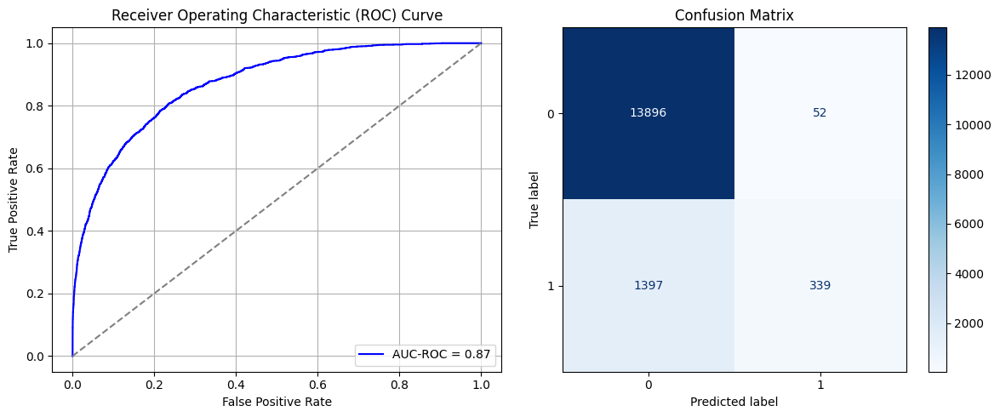

Best threshold based on F1-score: 0.13226264715194702
False Negative Rate: 0.8047235023041475
Time elapsed (performance): 1.3608675829996173
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6741 - loss: 0.5714 - val_AUC: 0.8707 - val_loss: 0.4199
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8635 - loss: 0.4121 - val_AUC: 0.8758 - val_loss: 0.4015
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8668 - loss: 0.4084 - val_AUC: 0.8768 - val_loss: 0.4021
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8680 - loss: 0.4041 - val_AUC: 0.8773 - val_loss: 0.3982
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8720 - loss: 0.3990 - val_AUC: 0.8767 - val_loss: 0.4013
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8690 - loss: 0.4054 - val_AUC: 0.8786 - val_loss: 0.3954
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.3927 - val_AUC: 0.8783 - val_loss: 0.3981
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.3960 - val_AUC: 0.8777 - val_loss: 0.4039
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 -

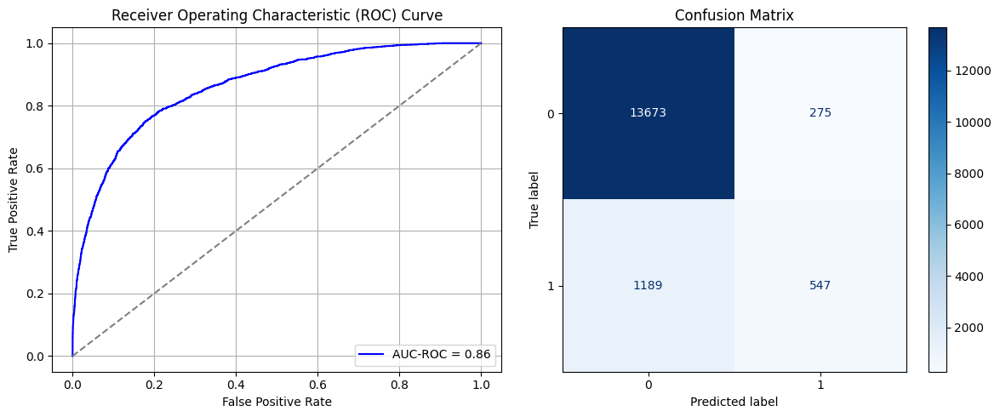

Best threshold based on F1-score: 0.25577813386917114
False Negative Rate: 0.6849078341013825
Time elapsed (performance): 1.3279903249999734
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7417 - loss: 0.5276 - val_AUC: 0.8720 - val_loss: 0.4111
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8645 - loss: 0.4098 - val_AUC: 0.8766 - val_loss: 0.4002
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8712 - loss: 0.4007 - val_AUC: 0.8772 - val_loss: 0.3996
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8710 - loss: 0.3998 - val_AUC: 0.8774 - val_loss: 0.4075
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8730 - loss: 0.3975 - val_AUC: 0.8786 - val_loss: 0.3977
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8711 - loss: 0.3968 - val_AUC: 0.8790 - val_loss: 0.3992
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.3908 - val_AUC: 0.8791 - val_loss: 0.3948
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8777 - loss: 0.3911 - val_AUC: 0.8793 - val_loss: 0.3985
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8772 -

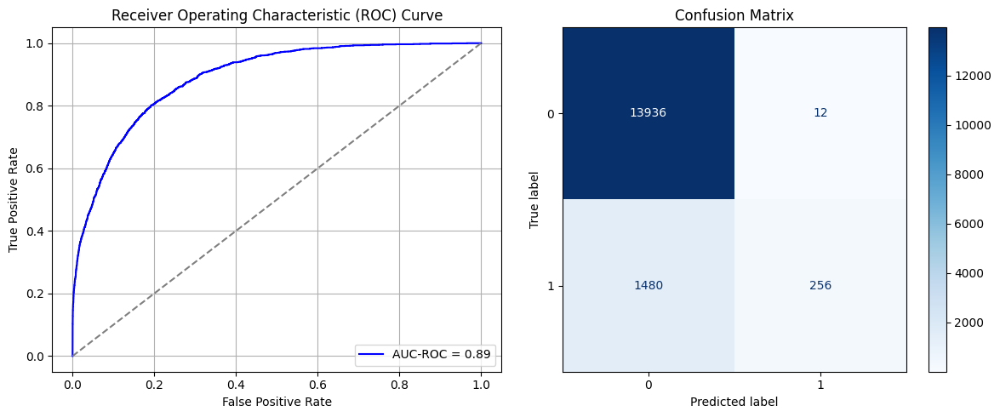

Best threshold based on F1-score: 0.09032780677080154
False Negative Rate: 0.8525345622119815
Time elapsed (performance): 1.6972554090002632
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7154 - loss: 0.5425 - val_AUC: 0.8721 - val_loss: 0.4131
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8641 - loss: 0.4125 - val_AUC: 0.8765 - val_loss: 0.4049
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8706 - loss: 0.4002 - val_AUC: 0.8777 - val_loss: 0.4026
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8766 - loss: 0.3947 - val_AUC: 0.8780 - val_loss: 0.3967
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8717 - loss: 0.3994 - val_AUC: 0.8780 - val_loss: 0.4346
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8757 - loss: 0.3947 - val_AUC: 0.8785 - val_loss: 0.3986
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8800 - loss: 0.3905 - val_AUC: 0.8776 - val_loss: 0.4045
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.3886 - val_AUC: 0.8786 - val_loss: 0.4006
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 -

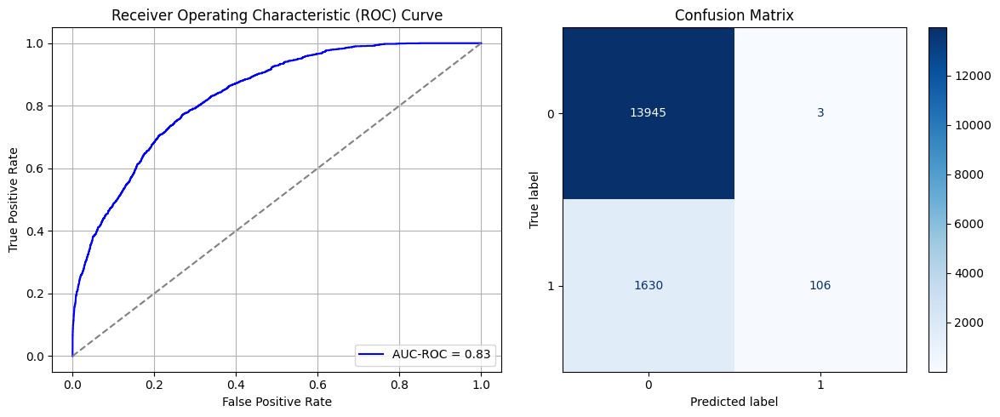

Best threshold based on F1-score: 0.020754534751176834
False Negative Rate: 0.9389400921658986
Time elapsed (performance): 1.7615900490000058
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6854 - loss: 0.5582 - val_AUC: 0.8697 - val_loss: 0.4163
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8691 - loss: 0.4056 - val_AUC: 0.8766 - val_loss: 0.4013
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.3999 - val_AUC: 0.8771 - val_loss: 0.4017
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8775 - loss: 0.3939 - val_AUC: 0.8784 - val_loss: 0.4146
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8792 - loss: 0.3882 - val_AUC: 0.8789 - val_loss: 0.4041
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8746 - loss: 0.3968 - val_AUC: 0.8796 - val_loss: 0.4181
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8743 - loss: 0.3939 - val_AUC: 0.8794 - val_loss: 0.3955
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.3944 - val_AUC: 0.8798 - val_loss: 0.3967
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 -

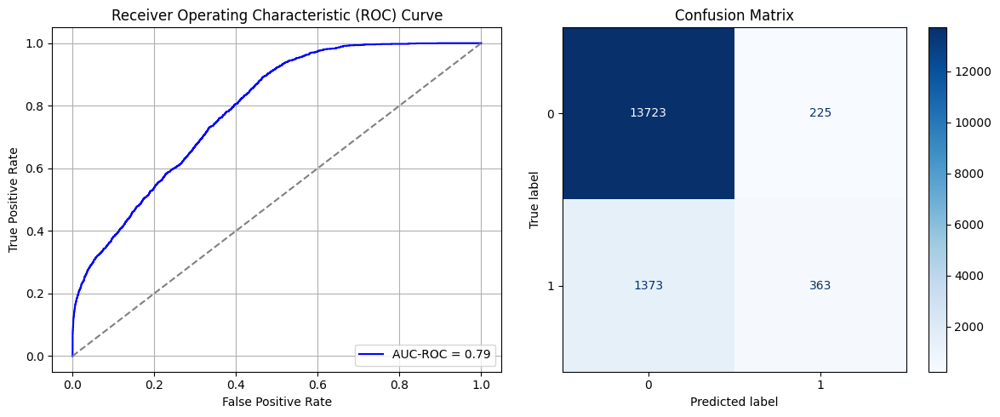

Best threshold based on F1-score: 0.3221539258956909
False Negative Rate: 0.7908986175115207
Time elapsed (performance): 1.3943380480000087
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6975 - loss: 0.5520 - val_AUC: 0.8732 - val_loss: 0.4106
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8661 - loss: 0.4107 - val_AUC: 0.8776 - val_loss: 0.4046
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4037 - val_AUC: 0.8781 - val_loss: 0.3995
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.3934 - val_AUC: 0.8796 - val_loss: 0.3960
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8717 - loss: 0.4007 - val_AUC: 0.8798 - val_loss: 0.4033
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 - loss: 0.3919 - val_AUC: 0.8801 - val_loss: 0.3977
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8760 - loss: 0.3944 - val_AUC: 0.8789 - val_loss: 0.3963
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8783 - loss: 0.3897 - val_AUC: 0.8786 - val_loss: 0.3950
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8741 -

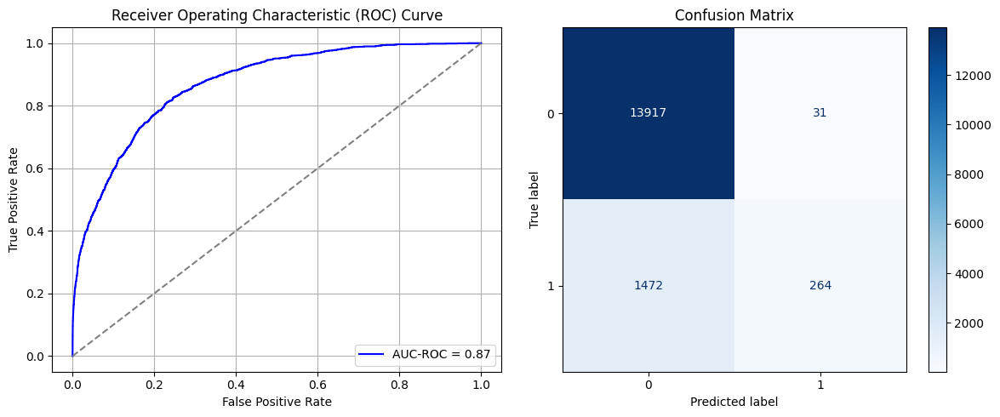

Best threshold based on F1-score: 0.06750255078077316
False Negative Rate: 0.847926267281106
Time elapsed (performance): 1.8455045389996485
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7317 - loss: 0.5364 - val_AUC: 0.8725 - val_loss: 0.4103
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8635 - loss: 0.4124 - val_AUC: 0.8775 - val_loss: 0.3991
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4013 - val_AUC: 0.8787 - val_loss: 0.3970
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8753 - loss: 0.3977 - val_AUC: 0.8796 - val_loss: 0.4050
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8736 - loss: 0.3971 - val_AUC: 0.8788 - val_loss: 0.3957
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.3962 - val_AUC: 0.8796 - val_loss: 0.3941
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8745 - loss: 0.3965 - val_AUC: 0.8805 - val_loss: 0.3924
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.3933 - val_AUC: 0.8799 - val_loss: 0.3976
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8762 -

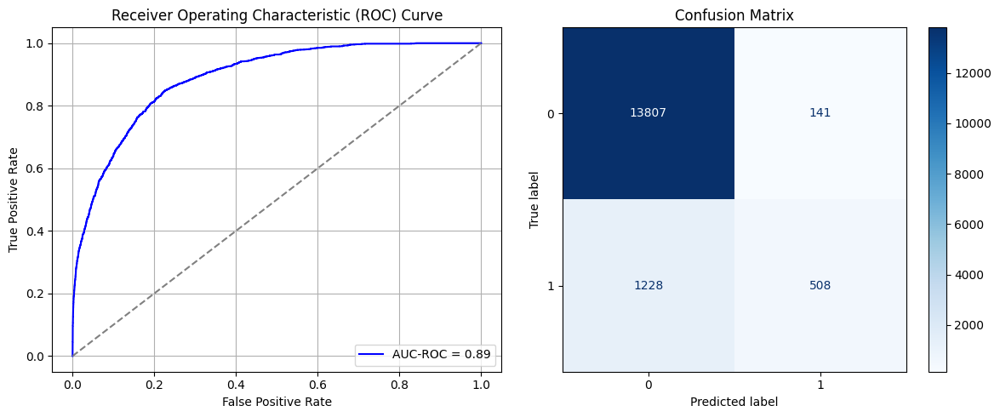

Best threshold based on F1-score: 0.24381804466247559
False Negative Rate: 0.7073732718894009
Time elapsed (performance): 1.4117364380003892
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7288 - loss: 0.5405 - val_AUC: 0.8719 - val_loss: 0.4187
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8673 - loss: 0.4088 - val_AUC: 0.8769 - val_loss: 0.4063
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8686 - loss: 0.4056 - val_AUC: 0.8762 - val_loss: 0.3996
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4026 - val_AUC: 0.8761 - val_loss: 0.4010
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.3982 - val_AUC: 0.8771 - val_loss: 0.3980
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.3923 - val_AUC: 0.8765 - val_loss: 0.4045
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.3910 - val_AUC: 0.8790 - val_loss: 0.3953
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.3924 - val_AUC: 0.8790 - val_loss: 0.3962
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8782 -

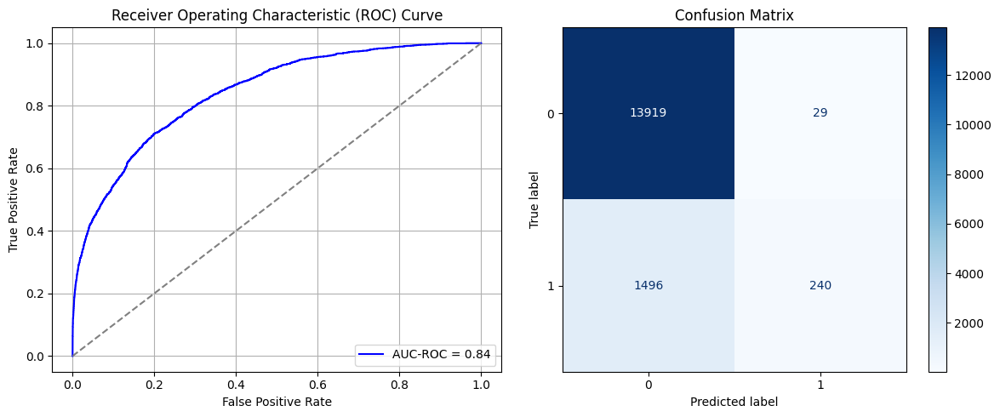

Best threshold based on F1-score: 0.10414248704910278
False Negative Rate: 0.8617511520737328
Time elapsed (performance): 1.3900114059997577
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.6985 - loss: 0.5563 - val_AUC: 0.8738 - val_loss: 0.4199
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8679 - loss: 0.4070 - val_AUC: 0.8766 - val_loss: 0.4005
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8712 - loss: 0.4021 - val_AUC: 0.8780 - val_loss: 0.3994
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8717 - loss: 0.4012 - val_AUC: 0.8782 - val_loss: 0.4072
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8717 - loss: 0.4009 - val_AUC: 0.8791 - val_loss: 0.3963
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.3952 - val_AUC: 0.8791 - val_loss: 0.3951
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.3969 - val_AUC: 0.8795 - val_loss: 0.3943
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8773 - loss: 0.3926 - val_AUC: 0.8785 - val_loss: 0.3959
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 -

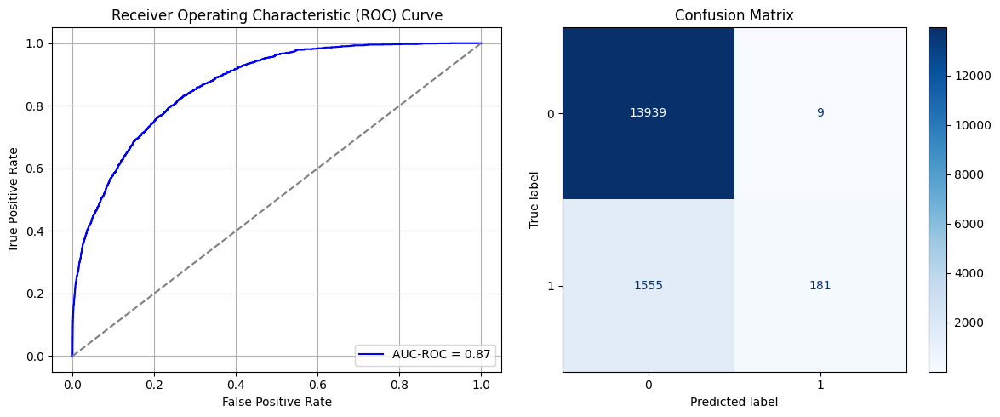

Best threshold based on F1-score: 0.05052008107304573
False Negative Rate: 0.8957373271889401
Time elapsed (performance): 1.4391925599998103
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7051 - loss: 0.5479 - val_AUC: 0.8689 - val_loss: 0.4195
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8647 - loss: 0.4133 - val_AUC: 0.8758 - val_loss: 0.4120
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8704 - loss: 0.4021 - val_AUC: 0.8774 - val_loss: 0.4004
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8778 - loss: 0.3903 - val_AUC: 0.8785 - val_loss: 0.3966
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8790 - loss: 0.3905 - val_AUC: 0.8780 - val_loss: 0.4033
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.3948 - val_AUC: 0.8776 - val_loss: 0.3978
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.3968 - val_AUC: 0.8787 - val_loss: 0.3952
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 - loss: 0.3859 - val_AUC: 0.8785 - val_loss: 0.4027
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 -

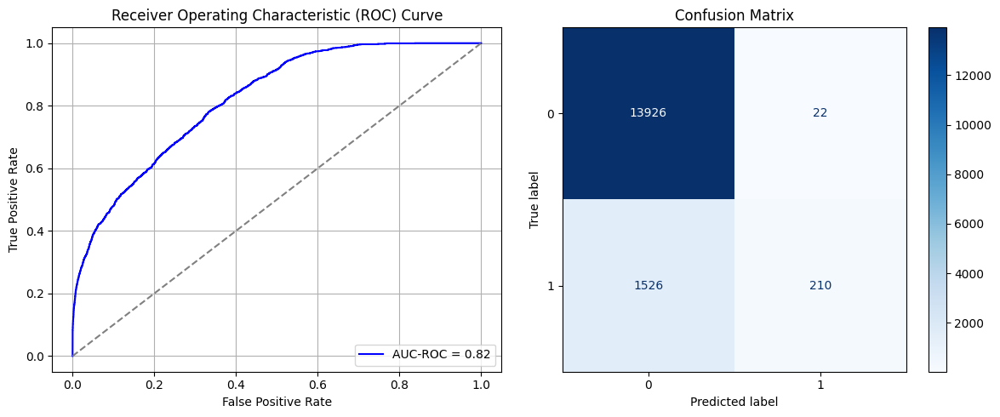

Best threshold based on F1-score: 0.07233421504497528
False Negative Rate: 0.8790322580645161
Time elapsed (performance): 1.4273105349998332
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6911 - loss: 0.5530 - val_AUC: 0.8743 - val_loss: 0.4104
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8732 - loss: 0.4000 - val_AUC: 0.8759 - val_loss: 0.4017
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 - loss: 0.3999 - val_AUC: 0.8783 - val_loss: 0.3998
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.3971 - val_AUC: 0.8770 - val_loss: 0.3992
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8739 - loss: 0.3968 - val_AUC: 0.8787 - val_loss: 0.3973
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8774 - loss: 0.3907 - val_AUC: 0.8795 - val_loss: 0.3947
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8703 - loss: 0.4036 - val_AUC: 0.8792 - val_loss: 0.3955
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.3936 - val_AUC: 0.8781 - val_loss: 0.3970
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8804 -

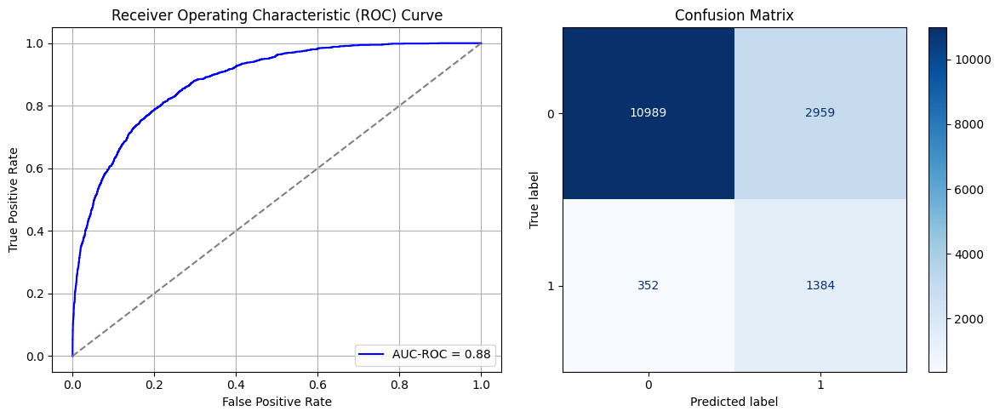

Best threshold based on F1-score: 0.716386079788208
False Negative Rate: 0.20276497695852536
Time elapsed (performance): 1.68276905599987
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7114 - loss: 0.5423 - val_AUC: 0.8733 - val_loss: 0.4270
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8668 - loss: 0.4092 - val_AUC: 0.8762 - val_loss: 0.4227
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8679 - loss: 0.4033 - val_AUC: 0.8754 - val_loss: 0.4032
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8726 - loss: 0.3980 - val_AUC: 0.8784 - val_loss: 0.3956
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8733 - loss: 0.3993 - val_AUC: 0.8787 - val_loss: 0.3999
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.3889 - val_AUC: 0.8794 - val_loss: 0.3972
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.3915 - val_AUC: 0.8790 - val_loss: 0.3956
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8819 - loss: 0.3856 - val_AUC: 0.8779 - val_loss: 0.4027
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8743 -

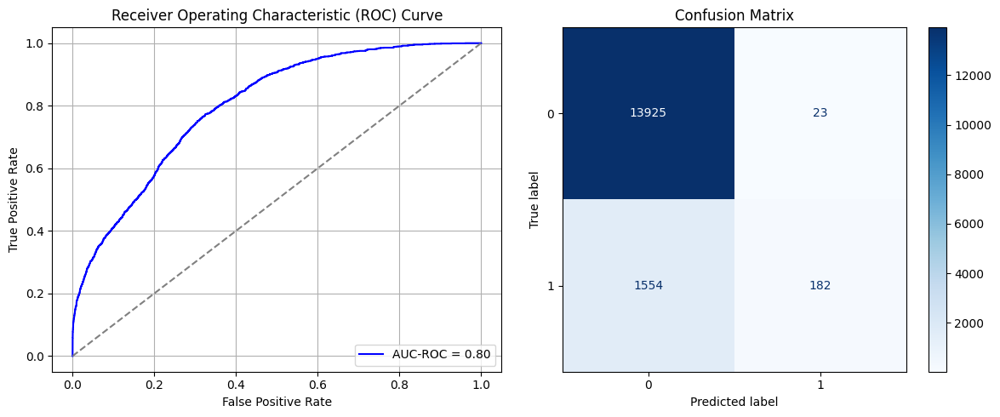

Best threshold based on F1-score: 0.06739889085292816
False Negative Rate: 0.8951612903225806
Time elapsed (performance): 1.4488803989997905
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6825 - loss: 0.5599 - val_AUC: 0.8739 - val_loss: 0.4103
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8661 - loss: 0.4103 - val_AUC: 0.8765 - val_loss: 0.4023
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8700 - loss: 0.4023 - val_AUC: 0.8767 - val_loss: 0.4008
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8680 - loss: 0.4029 - val_AUC: 0.8793 - val_loss: 0.3945
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8754 - loss: 0.3973 - val_AUC: 0.8785 - val_loss: 0.4167
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8731 - loss: 0.3986 - val_AUC: 0.8791 - val_loss: 0.4085
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.3940 - val_AUC: 0.8785 - val_loss: 0.3969
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.3943 - val_AUC: 0.8799 - val_loss: 0.3966
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 -

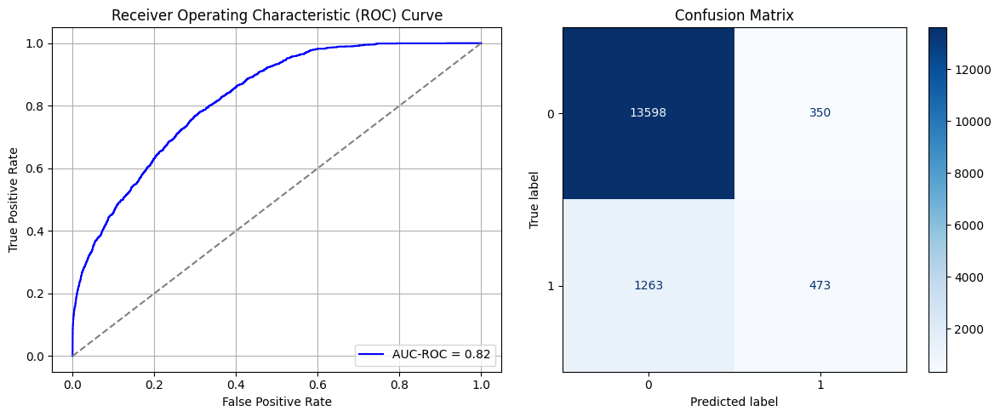

Best threshold based on F1-score: 0.32372260093688965
False Negative Rate: 0.7275345622119815
Time elapsed (performance): 1.6841023769998174
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7162 - loss: 0.5440 - val_AUC: 0.8696 - val_loss: 0.4255
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8680 - loss: 0.4063 - val_AUC: 0.8755 - val_loss: 0.4068
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8676 - loss: 0.4056 - val_AUC: 0.8770 - val_loss: 0.3998
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8724 - loss: 0.4013 - val_AUC: 0.8783 - val_loss: 0.4005
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.4023 - val_AUC: 0.8768 - val_loss: 0.4008
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8773 - loss: 0.3908 - val_AUC: 0.8785 - val_loss: 0.3954
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.3916 - val_AUC: 0.8790 - val_loss: 0.3982
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8746 - loss: 0.3979 - val_AUC: 0.8797 - val_loss: 0.3987
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 -

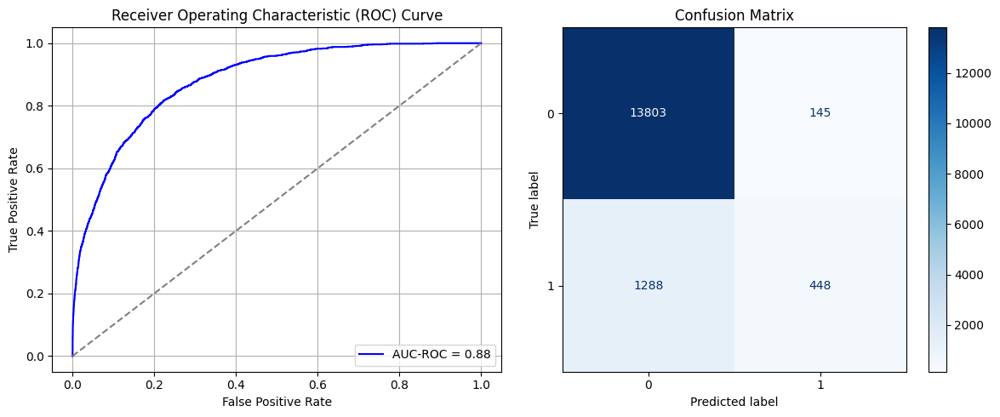

Best threshold based on F1-score: 0.17516233026981354
False Negative Rate: 0.7419354838709677
Time elapsed (performance): 3.0232460769998397
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6933 - loss: 0.5622 - val_AUC: 0.8727 - val_loss: 0.4110
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8637 - loss: 0.4141 - val_AUC: 0.8760 - val_loss: 0.4005
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4006 - val_AUC: 0.8766 - val_loss: 0.3986
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8760 - loss: 0.3949 - val_AUC: 0.8764 - val_loss: 0.3980
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8718 - loss: 0.3996 - val_AUC: 0.8778 - val_loss: 0.4022
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8765 - loss: 0.3906 - val_AUC: 0.8779 - val_loss: 0.4052
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.3894 - val_AUC: 0.8778 - val_loss: 0.3964
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.3935 - val_AUC: 0.8785 - val_loss: 0.3950
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8812 -

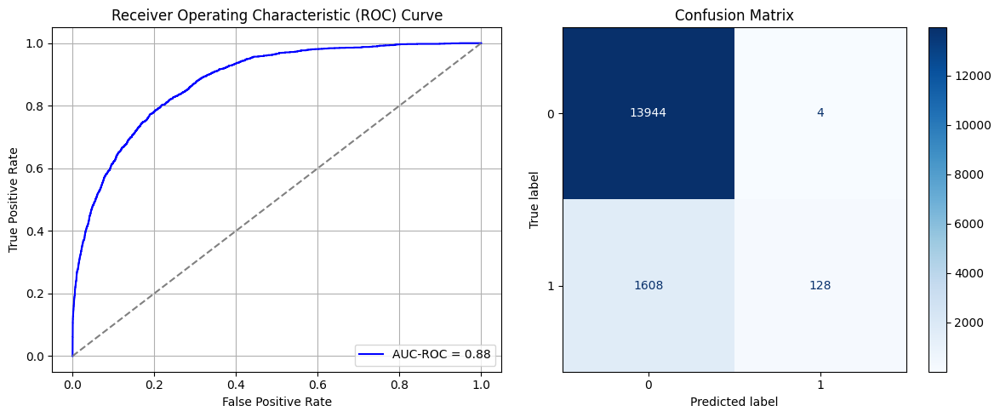

Best threshold based on F1-score: 0.014230323024094105
False Negative Rate: 0.9262672811059908
Time elapsed (performance): 1.389818448999904
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7074 - loss: 0.5469 - val_AUC: 0.8720 - val_loss: 0.4114
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8687 - loss: 0.4046 - val_AUC: 0.8764 - val_loss: 0.4040
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8726 - loss: 0.3964 - val_AUC: 0.8779 - val_loss: 0.4012
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.3977 - val_AUC: 0.8784 - val_loss: 0.3956
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8761 - loss: 0.3923 - val_AUC: 0.8772 - val_loss: 0.4129
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8765 - loss: 0.3930 - val_AUC: 0.8782 - val_loss: 0.4027
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8724 - loss: 0.3997 - val_AUC: 0.8784 - val_loss: 0.4022
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.3951 - val_AUC: 0.8784 - val_loss: 0.3957
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8768 -

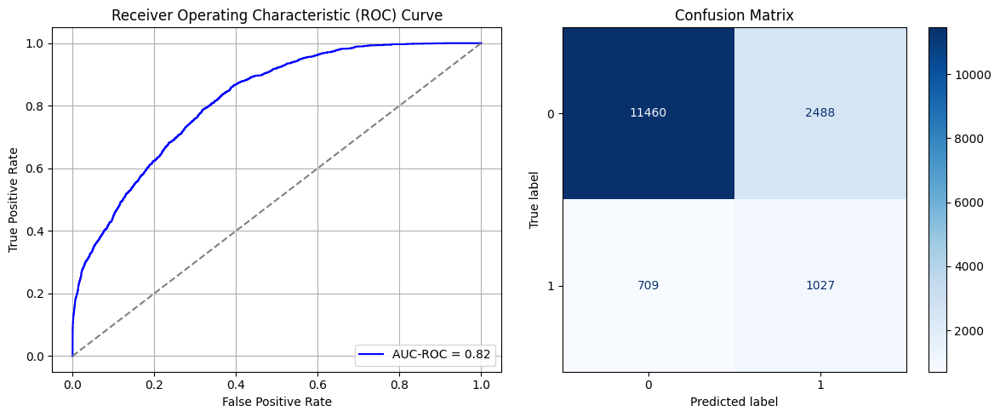

Best threshold based on F1-score: 0.60890793800354
False Negative Rate: 0.4084101382488479
Time elapsed (performance): 1.4297258180004064
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7109 - loss: 0.5445 - val_AUC: 0.8718 - val_loss: 0.4231
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8684 - loss: 0.4076 - val_AUC: 0.8773 - val_loss: 0.4048
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8694 - loss: 0.4028 - val_AUC: 0.8772 - val_loss: 0.3980
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8732 - loss: 0.3979 - val_AUC: 0.8774 - val_loss: 0.4014
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8751 - loss: 0.3957 - val_AUC: 0.8781 - val_loss: 0.3982
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.3925 - val_AUC: 0.8792 - val_loss: 0.3949
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 - loss: 0.3898 - val_AUC: 0.8797 - val_loss: 0.3982
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.3926 - val_AUC: 0.8790 - val_loss: 0.3947
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8779 -

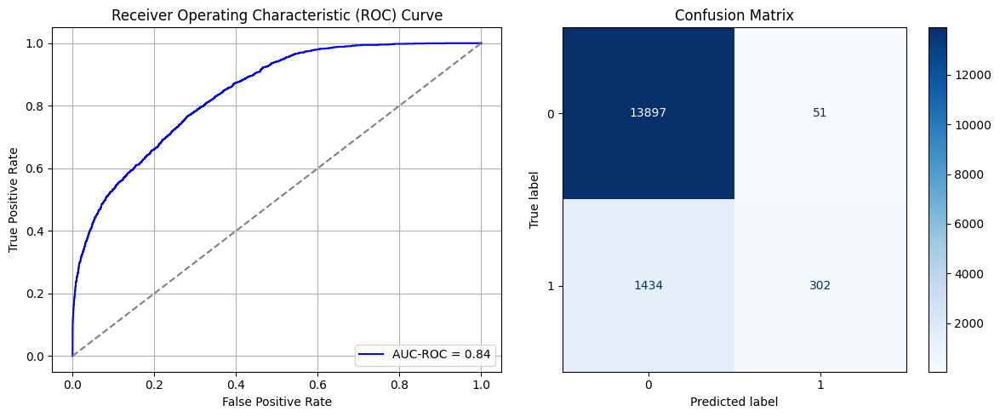

Best threshold based on F1-score: 0.10981506109237671
False Negative Rate: 0.826036866359447
Time elapsed (performance): 1.7386488610000015


In [81]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [82]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')

## Remember that TPR is actually TNR and TNR is actually TPR!!!

    Source time       FPR       TPR       FNR       TNR  Target time
0     27.933277  0.013622  0.332949  0.667051  0.986378     1.696489
1     28.712227  0.004947  0.171083  0.828917  0.995053     1.197206
2     25.479594  0.014411  0.261521  0.738479  0.985589     1.245158
3     27.635633  0.004804  0.180876  0.819124  0.995196     1.869666
4     27.254139  0.003513  0.134793  0.865207  0.996487     1.189453
5     24.033212  0.002653  0.176843  0.823157  0.997347     1.664313
6     24.163816  0.015701  0.218894  0.781106  0.984299     1.214632
7     26.968273  0.026814  0.290899  0.709101  0.973186     1.756049
8     24.041220  0.093705  0.489631  0.510369  0.906295     1.253172
9     24.706359  0.007743  0.251152  0.748848  0.992257     1.261971
10    24.857461  0.000717  0.115783  0.884217  0.999283     1.690071
11    27.871939  0.004087  0.183180  0.816820  0.995913     1.523089
12    25.614512  0.049900  0.383641  0.616359  0.950100     1.864472
13    26.418196  0.000215  0.07661

# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [83]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.0,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.0,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.0,0
4,0.479452,0.125,0.133519,0.533333,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.448980,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31932,0.424658,0.500,0.227956,0.866667,0.333333,0.285714,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31933,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31934,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.0,0
31935,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.0,0


In [84]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7278 - loss: 0.6149 - val_AUC: 0.8577 - val_loss: 0.4930
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8555 - loss: 0.4739 - val_AUC: 0.8698 - val_loss: 0.4505
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8692 - loss: 0.4470 - val_AUC: 0.8706 - val_loss: 0.4462
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8735 - loss: 0.4407 - val_AUC: 0.8721 - val_loss: 0.4420
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4333 - val_AUC: 0.8749 - val_loss: 0.4416
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8748 - val_loss: 0.4423
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4373 - val_AUC: 0.8745 - val_loss: 0.4510
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8824 - loss: 0.4247 - val_AUC: 0.8759 - val_loss: 0.4362
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8814 -

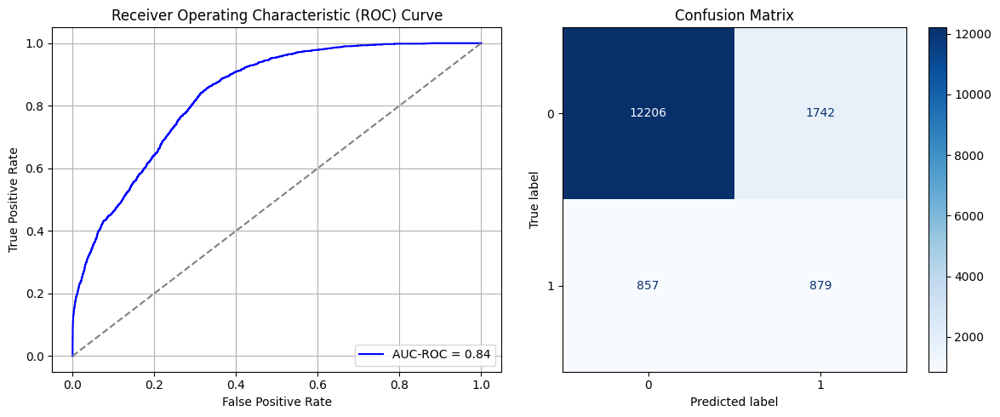

Best threshold based on F1-score: 0.5872243642807007
False Negative Rate: 0.4936635944700461
Time elapsed (performance): 1.793024935000176
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7400 - loss: 0.6169 - val_AUC: 0.8562 - val_loss: 0.4723
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8628 - loss: 0.4622 - val_AUC: 0.8718 - val_loss: 0.4460
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4413 - val_AUC: 0.8752 - val_loss: 0.4527
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8660 - loss: 0.4494 - val_AUC: 0.8743 - val_loss: 0.4413
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 - loss: 0.4306 - val_AUC: 0.8766 - val_loss: 0.4357
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4338 - val_AUC: 0.8768 - val_loss: 0.4436
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8844 - loss: 0.4209 - val_AUC: 0.8765 - val_loss: 0.4349
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 - loss: 0.4298 - val_AUC: 0.8762 - val_loss: 0.4472
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8800 -

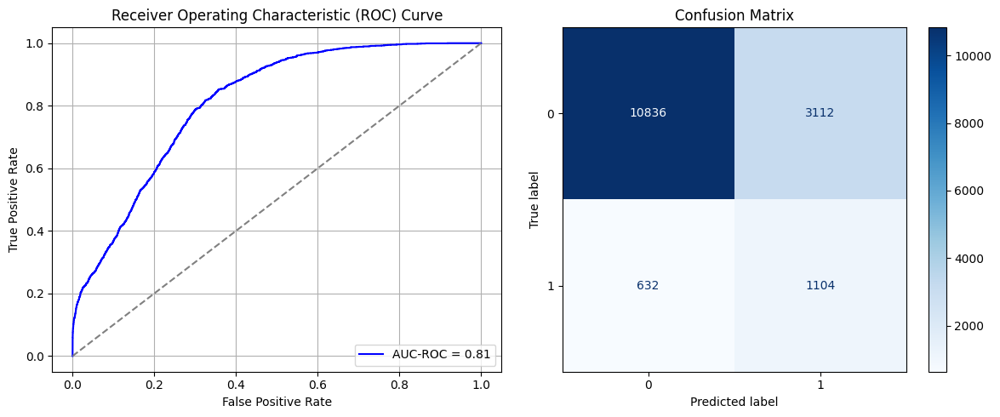

Best threshold based on F1-score: 0.41405633091926575
False Negative Rate: 0.3640552995391705
Time elapsed (performance): 1.199839575999249
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7512 - loss: 0.6092 - val_AUC: 0.8645 - val_loss: 0.4723
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8589 - loss: 0.4631 - val_AUC: 0.8781 - val_loss: 0.4350
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8749 - loss: 0.4386 - val_AUC: 0.8810 - val_loss: 0.4307
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4343 - val_AUC: 0.8818 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4307 - val_AUC: 0.8828 - val_loss: 0.4330
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4407 - val_AUC: 0.8828 - val_loss: 0.4243
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4387 - val_AUC: 0.8830 - val_loss: 0.4242
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4311 - val_AUC: 0.8835 - val_loss: 0.4246
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 -

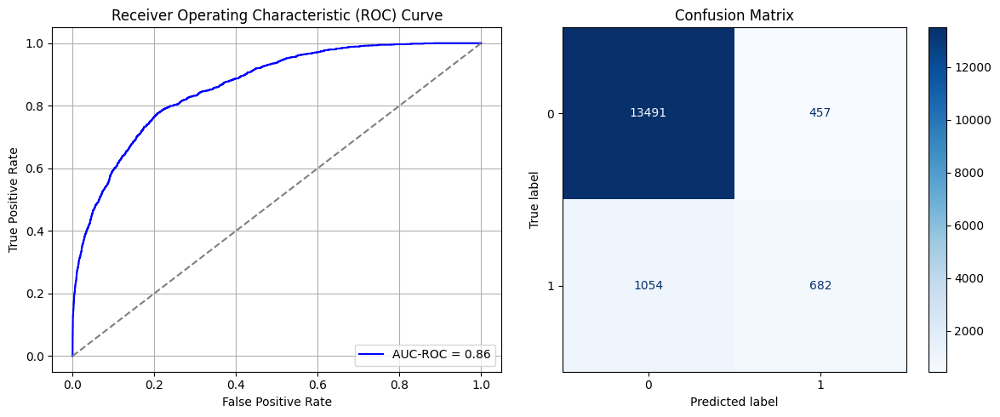

Best threshold based on F1-score: 0.41356736421585083
False Negative Rate: 0.6071428571428571
Time elapsed (performance): 1.715382026000043
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7520 - loss: 0.6134 - val_AUC: 0.8609 - val_loss: 0.4824
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8565 - loss: 0.4707 - val_AUC: 0.8807 - val_loss: 0.4333
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8597 - loss: 0.4590 - val_AUC: 0.8831 - val_loss: 0.4273
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8707 - loss: 0.4429 - val_AUC: 0.8827 - val_loss: 0.4268
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4413 - val_AUC: 0.8850 - val_loss: 0.4232
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4260 - val_AUC: 0.8852 - val_loss: 0.4292
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8768 - loss: 0.4328 - val_AUC: 0.8861 - val_loss: 0.4200
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8790 - loss: 0.4298 - val_AUC: 0.8854 - val_loss: 0.4217
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 -

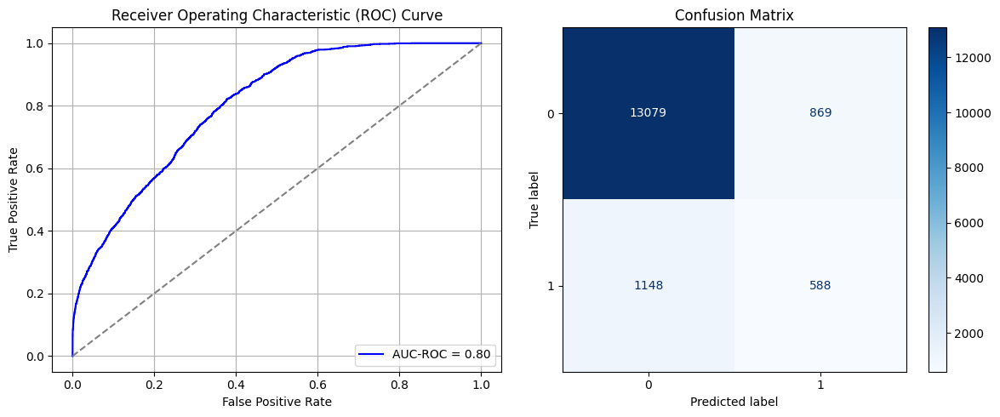

Best threshold based on F1-score: 0.4130971133708954
False Negative Rate: 0.6612903225806451
Time elapsed (performance): 1.2075193509999735
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7404 - loss: 0.6096 - val_AUC: 0.8568 - val_loss: 0.4721
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8566 - loss: 0.4712 - val_AUC: 0.8734 - val_loss: 0.4463
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8692 - loss: 0.4475 - val_AUC: 0.8766 - val_loss: 0.4377
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4383 - val_AUC: 0.8779 - val_loss: 0.4331
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4401 - val_AUC: 0.8783 - val_loss: 0.4448
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8681 - loss: 0.4482 - val_AUC: 0.8780 - val_loss: 0.4358
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4346 - val_AUC: 0.8784 - val_loss: 0.4380
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4403 - val_AUC: 0.8793 - val_loss: 0.4303
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 -

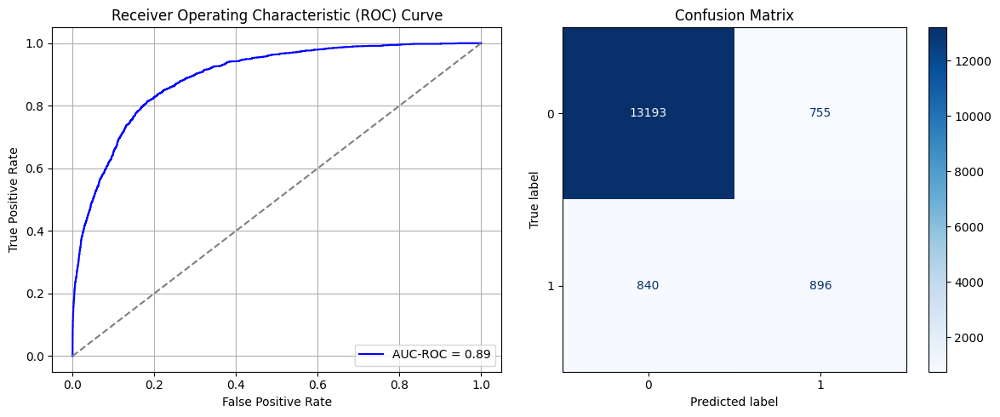

Best threshold based on F1-score: 0.4582754373550415
False Negative Rate: 0.4838709677419355
Time elapsed (performance): 1.7794790400002967
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7357 - loss: 0.6093 - val_AUC: 0.8523 - val_loss: 0.4806
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8555 - loss: 0.4697 - val_AUC: 0.8698 - val_loss: 0.4543
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4440 - val_AUC: 0.8731 - val_loss: 0.4462
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4353 - val_AUC: 0.8737 - val_loss: 0.4485
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4355 - val_AUC: 0.8740 - val_loss: 0.4409
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 - loss: 0.4356 - val_AUC: 0.8751 - val_loss: 0.4379
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4348 - val_AUC: 0.8749 - val_loss: 0.4391
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8782 - loss: 0.4313 - val_AUC: 0.8761 - val_loss: 0.4361
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 -

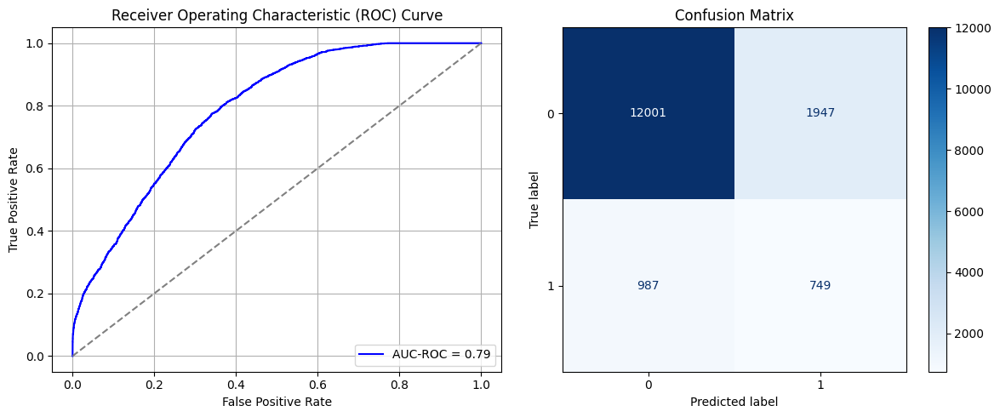

Best threshold based on F1-score: 0.22796563804149628
False Negative Rate: 0.5685483870967742
Time elapsed (performance): 1.1844867150002756
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7468 - loss: 0.6186 - val_AUC: 0.8605 - val_loss: 0.4697
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8599 - loss: 0.4641 - val_AUC: 0.8719 - val_loss: 0.4429
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8668 - loss: 0.4500 - val_AUC: 0.8733 - val_loss: 0.4403
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4405 - val_AUC: 0.8730 - val_loss: 0.4399
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4358 - val_AUC: 0.8729 - val_loss: 0.4488
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4440 - val_AUC: 0.8748 - val_loss: 0.4449
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4412 - val_AUC: 0.8739 - val_loss: 0.4408
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4324 - val_AUC: 0.8732 - val_loss: 0.4415
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 -

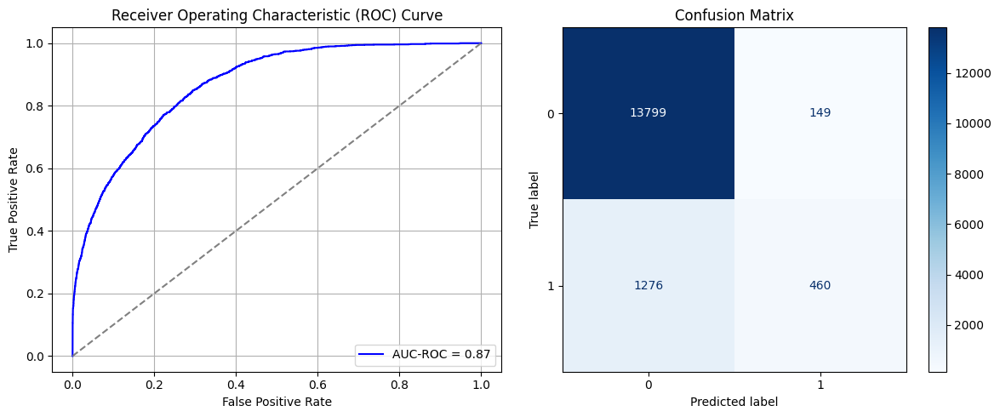

Best threshold based on F1-score: 0.2563232481479645
False Negative Rate: 0.7350230414746544
Time elapsed (performance): 1.822441495000021
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7527 - loss: 0.6034 - val_AUC: 0.8678 - val_loss: 0.4624
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8614 - loss: 0.4632 - val_AUC: 0.8751 - val_loss: 0.4414
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4398 - val_AUC: 0.8781 - val_loss: 0.4339
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4355 - val_AUC: 0.8794 - val_loss: 0.4360
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4371 - val_AUC: 0.8795 - val_loss: 0.4311
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4309 - val_AUC: 0.8795 - val_loss: 0.4312
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4335 - val_AUC: 0.8772 - val_loss: 0.4343
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8717 - loss: 0.4443 - val_AUC: 0.8803 - val_loss: 0.4376
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8733 -

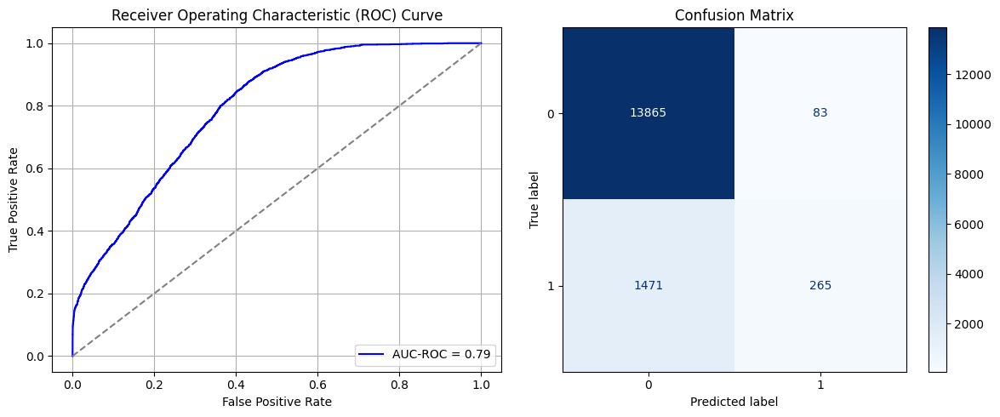

Best threshold based on F1-score: 0.04215792194008827
False Negative Rate: 0.8473502304147466
Time elapsed (performance): 1.1951928220005357
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7419 - loss: 0.6086 - val_AUC: 0.8619 - val_loss: 0.4744
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8583 - loss: 0.4697 - val_AUC: 0.8775 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4367 - val_AUC: 0.8810 - val_loss: 0.4312
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 - loss: 0.4395 - val_AUC: 0.8827 - val_loss: 0.4285
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.4362 - val_AUC: 0.8842 - val_loss: 0.4262
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4333 - val_AUC: 0.8848 - val_loss: 0.4335
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4392 - val_AUC: 0.8842 - val_loss: 0.4342
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4307 - val_AUC: 0.8846 - val_loss: 0.4216
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 -

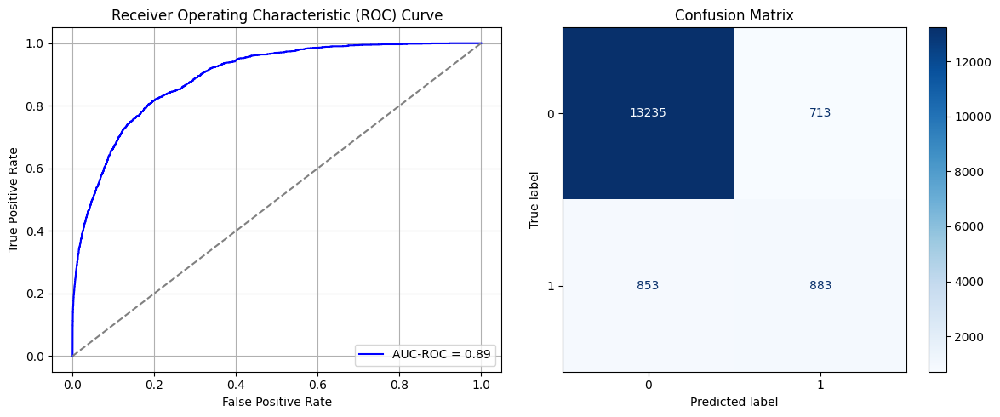

Best threshold based on F1-score: 0.392927348613739
False Negative Rate: 0.4913594470046083
Time elapsed (performance): 1.6875472020001325
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7383 - loss: 0.6118 - val_AUC: 0.8626 - val_loss: 0.4700
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8639 - loss: 0.4604 - val_AUC: 0.8772 - val_loss: 0.4381
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8698 - loss: 0.4451 - val_AUC: 0.8791 - val_loss: 0.4336
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8665 - loss: 0.4499 - val_AUC: 0.8804 - val_loss: 0.4297
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8712 - loss: 0.4427 - val_AUC: 0.8813 - val_loss: 0.4278
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4410 - val_AUC: 0.8821 - val_loss: 0.4273
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8724 - loss: 0.4404 - val_AUC: 0.8792 - val_loss: 0.4326
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8779 - loss: 0.4317 - val_AUC: 0.8795 - val_loss: 0.4301
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 -

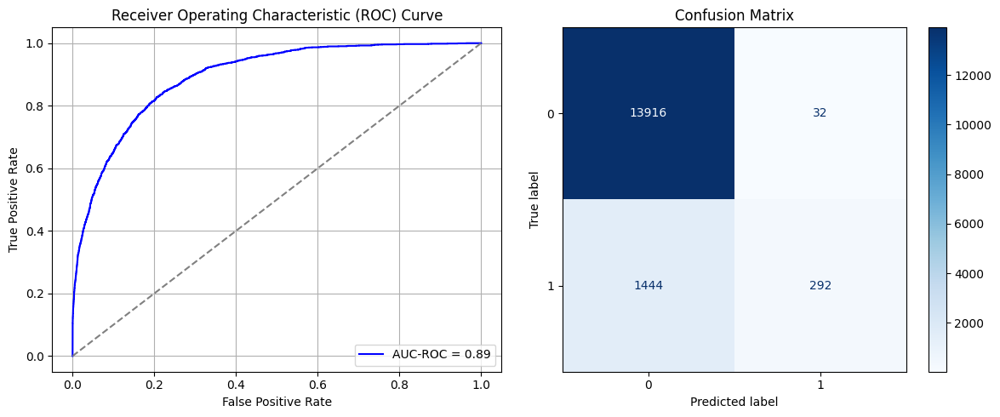

Best threshold based on F1-score: 0.11048060655593872
False Negative Rate: 0.8317972350230415
Time elapsed (performance): 1.6852368429999842
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7217 - loss: 0.6134 - val_AUC: 0.8617 - val_loss: 0.4719
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8607 - loss: 0.4629 - val_AUC: 0.8728 - val_loss: 0.4569
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8687 - loss: 0.4474 - val_AUC: 0.8728 - val_loss: 0.4423
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8752 - loss: 0.4369 - val_AUC: 0.8734 - val_loss: 0.4388
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4375 - val_AUC: 0.8756 - val_loss: 0.4361
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4427 - val_AUC: 0.8752 - val_loss: 0.4419
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4384 - val_AUC: 0.8760 - val_loss: 0.4348
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8854 - loss: 0.4204 - val_AUC: 0.8761 - val_loss: 0.4367
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 -

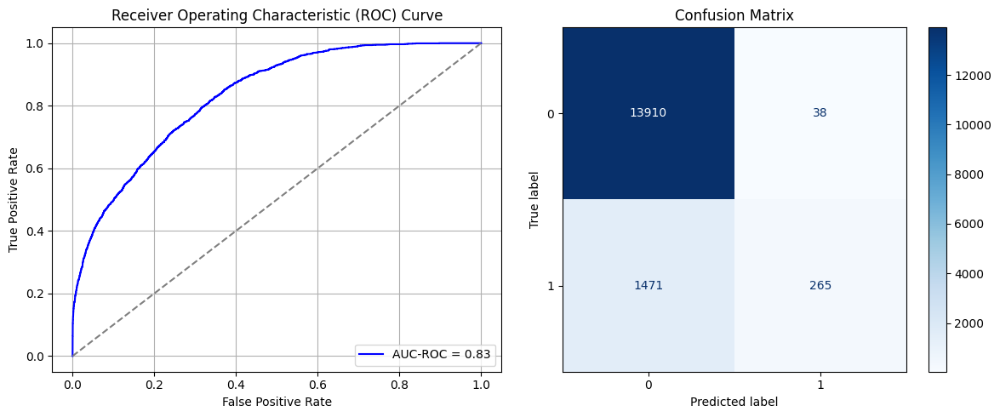

Best threshold based on F1-score: 0.11346721649169922
False Negative Rate: 0.8473502304147466
Time elapsed (performance): 1.8363568270005999
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7546 - loss: 0.5983 - val_AUC: 0.8662 - val_loss: 0.4657
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8632 - loss: 0.4588 - val_AUC: 0.8801 - val_loss: 0.4337
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4403 - val_AUC: 0.8819 - val_loss: 0.4384
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4334 - val_AUC: 0.8838 - val_loss: 0.4264
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4288 - val_AUC: 0.8835 - val_loss: 0.4270
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4291 - val_AUC: 0.8855 - val_loss: 0.4232
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4320 - val_AUC: 0.8842 - val_loss: 0.4296
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8797 - loss: 0.4293 - val_AUC: 0.8856 - val_loss: 0.4236
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8820 -

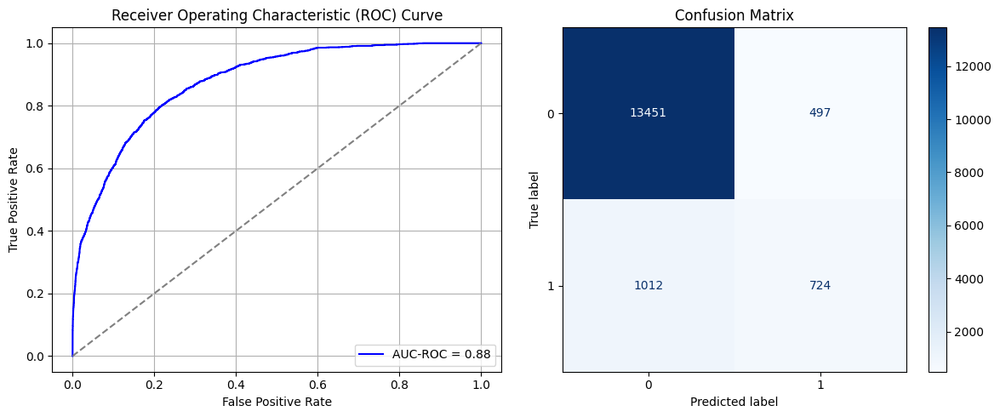

Best threshold based on F1-score: 0.309291809797287
False Negative Rate: 0.5829493087557603
Time elapsed (performance): 1.6899384700000155
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7230 - loss: 0.6228 - val_AUC: 0.8620 - val_loss: 0.4710
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8531 - loss: 0.4732 - val_AUC: 0.8753 - val_loss: 0.4582
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8678 - loss: 0.4491 - val_AUC: 0.8781 - val_loss: 0.4352
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8663 - loss: 0.4475 - val_AUC: 0.8785 - val_loss: 0.4344
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4425 - val_AUC: 0.8801 - val_loss: 0.4355
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4343 - val_AUC: 0.8791 - val_loss: 0.4370
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8684 - loss: 0.4442 - val_AUC: 0.8807 - val_loss: 0.4310
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4405 - val_AUC: 0.8800 - val_loss: 0.4348
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 -

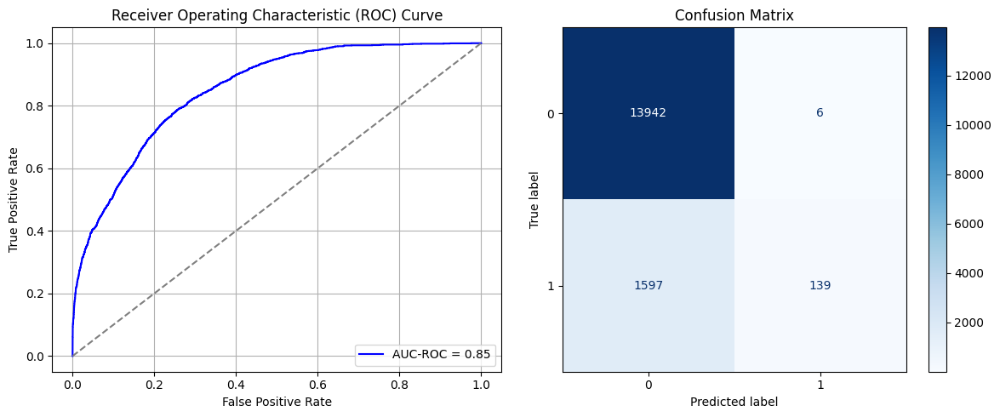

Best threshold based on F1-score: 0.04351354390382767
False Negative Rate: 0.9199308755760369
Time elapsed (performance): 1.4061593950000315
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7496 - loss: 0.6136 - val_AUC: 0.8637 - val_loss: 0.4655
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8581 - loss: 0.4676 - val_AUC: 0.8768 - val_loss: 0.4362
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4405 - val_AUC: 0.8793 - val_loss: 0.4309
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8707 - loss: 0.4429 - val_AUC: 0.8809 - val_loss: 0.4331
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4353 - val_AUC: 0.8834 - val_loss: 0.4298
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4349 - val_AUC: 0.8834 - val_loss: 0.4243
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4316 - val_AUC: 0.8838 - val_loss: 0.4267
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 - loss: 0.4334 - val_AUC: 0.8835 - val_loss: 0.4248
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8791 -

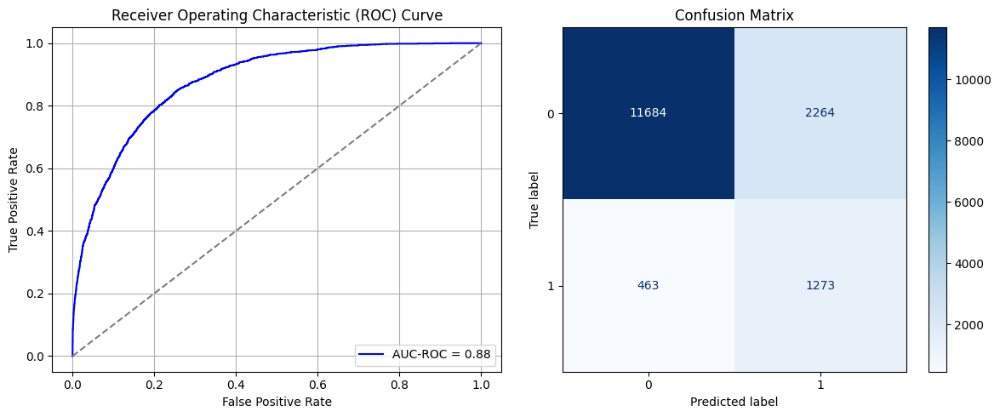

Best threshold based on F1-score: 0.7107300162315369
False Negative Rate: 0.266705069124424
Time elapsed (performance): 1.681774599000164
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7433 - loss: 0.6154 - val_AUC: 0.8484 - val_loss: 0.4867
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8530 - loss: 0.4754 - val_AUC: 0.8702 - val_loss: 0.4458
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8707 - loss: 0.4463 - val_AUC: 0.8725 - val_loss: 0.4410
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4497 - val_AUC: 0.8727 - val_loss: 0.4436
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4399 - val_AUC: 0.8708 - val_loss: 0.4606
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4360 - val_AUC: 0.8724 - val_loss: 0.4414
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4348 - val_AUC: 0.8730 - val_loss: 0.4446
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8742 - val_loss: 0.4389
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 -

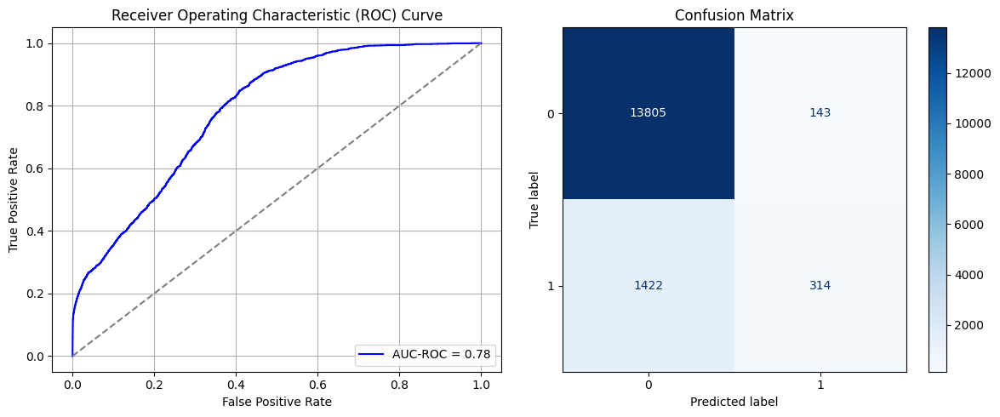

Best threshold based on F1-score: 0.053602080792188644
False Negative Rate: 0.8191244239631337
Time elapsed (performance): 1.669798537999668
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7419 - loss: 0.6120 - val_AUC: 0.8613 - val_loss: 0.4813
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8641 - loss: 0.4577 - val_AUC: 0.8738 - val_loss: 0.4413
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8838 - loss: 0.4224 - val_AUC: 0.8752 - val_loss: 0.4643
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4315 - val_AUC: 0.8761 - val_loss: 0.4382
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4321 - val_AUC: 0.8759 - val_loss: 0.4384
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8857 - loss: 0.4200 - val_AUC: 0.8763 - val_loss: 0.4380
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4313 - val_AUC: 0.8770 - val_loss: 0.4403
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8798 - loss: 0.4299 - val_AUC: 0.8771 - val_loss: 0.4370
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 -

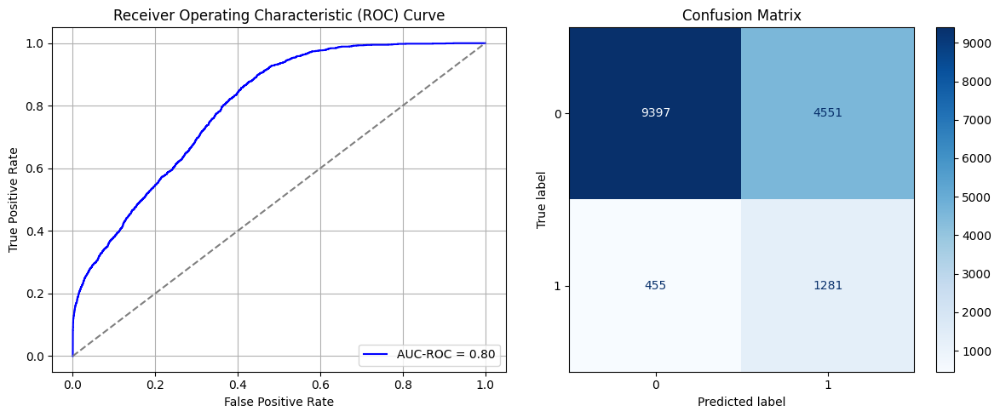

Best threshold based on F1-score: 0.816615104675293
False Negative Rate: 0.2620967741935484
Time elapsed (performance): 1.8481680489994687
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7259 - loss: 0.6224 - val_AUC: 0.8456 - val_loss: 0.4868
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8546 - loss: 0.4718 - val_AUC: 0.8636 - val_loss: 0.4588
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8715 - loss: 0.4415 - val_AUC: 0.8666 - val_loss: 0.4580
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8664 - loss: 0.4489 - val_AUC: 0.8684 - val_loss: 0.4475
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4400 - val_AUC: 0.8698 - val_loss: 0.4455
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8726 - loss: 0.4409 - val_AUC: 0.8699 - val_loss: 0.4451
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8751 - loss: 0.4350 - val_AUC: 0.8706 - val_loss: 0.4444
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8784 - loss: 0.4322 - val_AUC: 0.8707 - val_loss: 0.4437
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8759 -

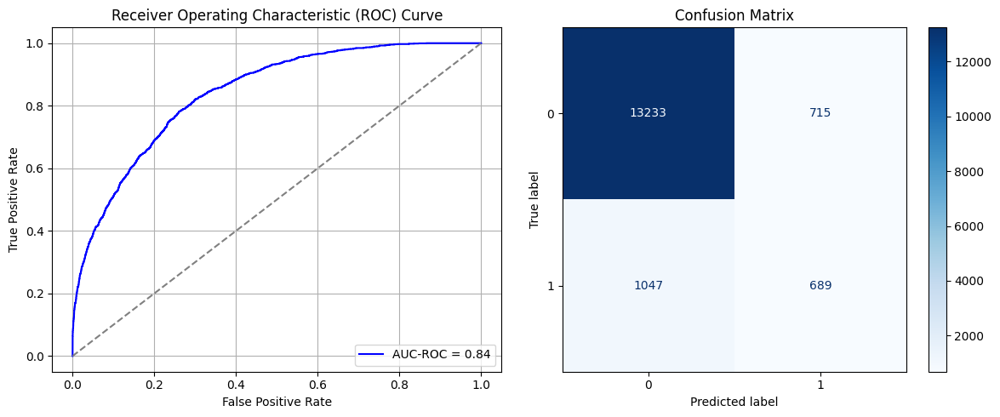

Best threshold based on F1-score: 0.4112638235092163
False Negative Rate: 0.603110599078341
Time elapsed (performance): 1.674332702999891
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7492 - loss: 0.6091 - val_AUC: 0.8493 - val_loss: 0.5001
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8594 - loss: 0.4650 - val_AUC: 0.8638 - val_loss: 0.4542
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8748 - loss: 0.4389 - val_AUC: 0.8679 - val_loss: 0.4584
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8748 - loss: 0.4381 - val_AUC: 0.8682 - val_loss: 0.4576
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4339 - val_AUC: 0.8649 - val_loss: 0.4576
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4335 - val_AUC: 0.8661 - val_loss: 0.4498
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8810 - loss: 0.4272 - val_AUC: 0.8682 - val_loss: 0.4497
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8818 - loss: 0.4255 - val_AUC: 0.8678 - val_loss: 0.4581
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 -

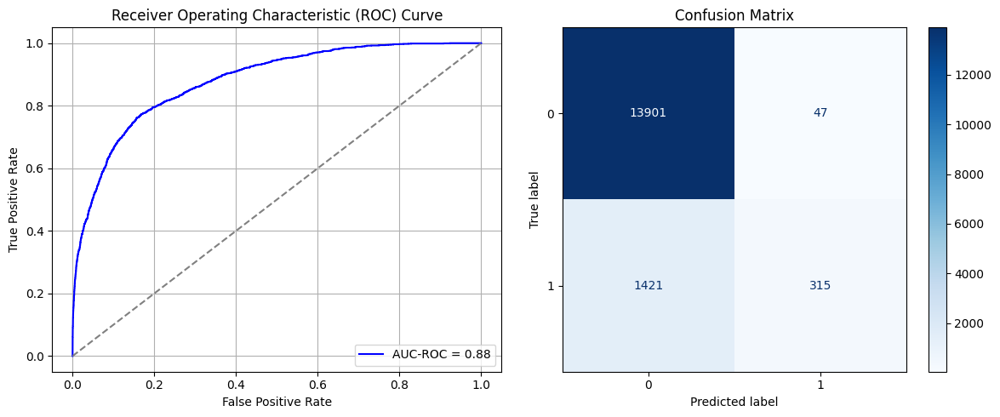

Best threshold based on F1-score: 0.11408375948667526
False Negative Rate: 0.8185483870967742
Time elapsed (performance): 1.231384290999813
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7365 - loss: 0.6112 - val_AUC: 0.8676 - val_loss: 0.4592
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8532 - loss: 0.4717 - val_AUC: 0.8786 - val_loss: 0.4632
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4457 - val_AUC: 0.8819 - val_loss: 0.4287
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4384 - val_AUC: 0.8816 - val_loss: 0.4275
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4440 - val_AUC: 0.8823 - val_loss: 0.4306
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4403 - val_AUC: 0.8833 - val_loss: 0.4249
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8788 - loss: 0.4318 - val_AUC: 0.8837 - val_loss: 0.4254
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8758 - loss: 0.4345 - val_AUC: 0.8847 - val_loss: 0.4236
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 -

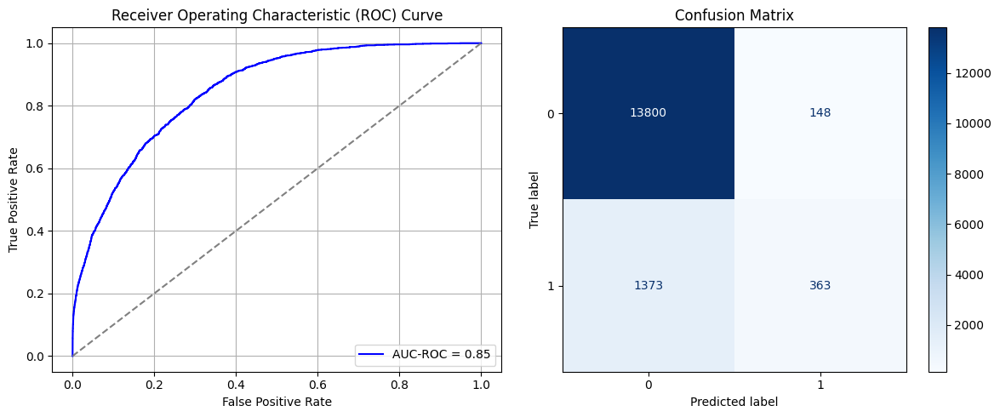

Best threshold based on F1-score: 0.1701110154390335
False Negative Rate: 0.7908986175115207
Time elapsed (performance): 1.691547582999192
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7568 - loss: 0.6080 - val_AUC: 0.8573 - val_loss: 0.4745
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8575 - loss: 0.4673 - val_AUC: 0.8724 - val_loss: 0.4511
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8690 - loss: 0.4455 - val_AUC: 0.8743 - val_loss: 0.4389
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8805 - loss: 0.4293 - val_AUC: 0.8755 - val_loss: 0.4405
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4328 - val_AUC: 0.8758 - val_loss: 0.4364
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4288 - val_AUC: 0.8771 - val_loss: 0.4416
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4291 - val_AUC: 0.8780 - val_loss: 0.4343
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4265 - val_AUC: 0.8754 - val_loss: 0.4387
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8794 -

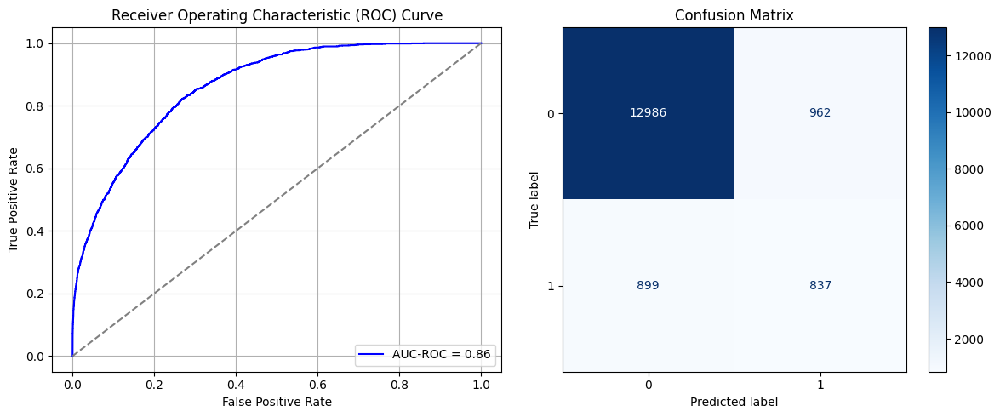

Best threshold based on F1-score: 0.4831147789955139
False Negative Rate: 0.5178571428571429
Time elapsed (performance): 1.816898057999424
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7286 - loss: 0.6146 - val_AUC: 0.8540 - val_loss: 0.4749
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8649 - loss: 0.4561 - val_AUC: 0.8724 - val_loss: 0.4467
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8668 - loss: 0.4479 - val_AUC: 0.8754 - val_loss: 0.4442
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8788 - loss: 0.4309 - val_AUC: 0.8764 - val_loss: 0.4444
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4410 - val_AUC: 0.8776 - val_loss: 0.4372
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8773 - loss: 0.4317 - val_AUC: 0.8782 - val_loss: 0.4396
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.4328 - val_AUC: 0.8774 - val_loss: 0.4361
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4377 - val_AUC: 0.8792 - val_loss: 0.4348
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8804 -

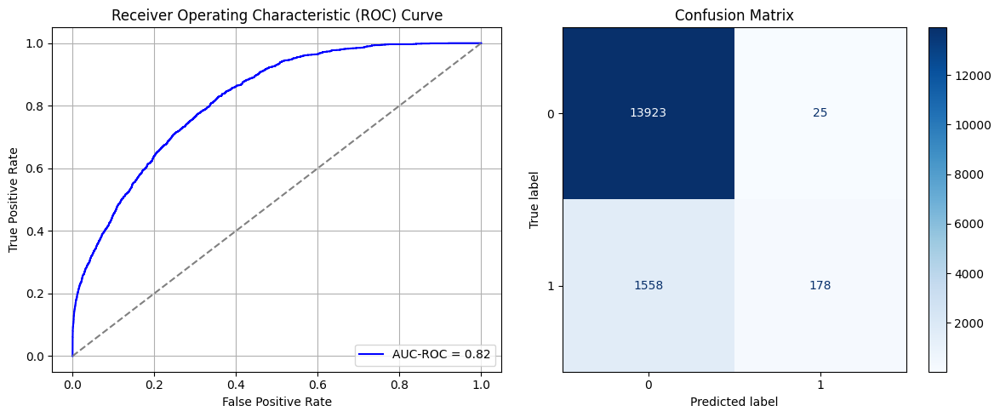

Best threshold based on F1-score: 0.03458714112639427
False Negative Rate: 0.8974654377880185
Time elapsed (performance): 1.5072744720000628
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7073 - loss: 0.6181 - val_AUC: 0.8409 - val_loss: 0.5167
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8495 - loss: 0.4770 - val_AUC: 0.8655 - val_loss: 0.4614
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8748 - loss: 0.4399 - val_AUC: 0.8675 - val_loss: 0.4536
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8702 - loss: 0.4427 - val_AUC: 0.8678 - val_loss: 0.4516
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4392 - val_AUC: 0.8700 - val_loss: 0.4543
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4283 - val_AUC: 0.8713 - val_loss: 0.4474
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4342 - val_AUC: 0.8702 - val_loss: 0.4587
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.4344 - val_AUC: 0.8713 - val_loss: 0.4453
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 -

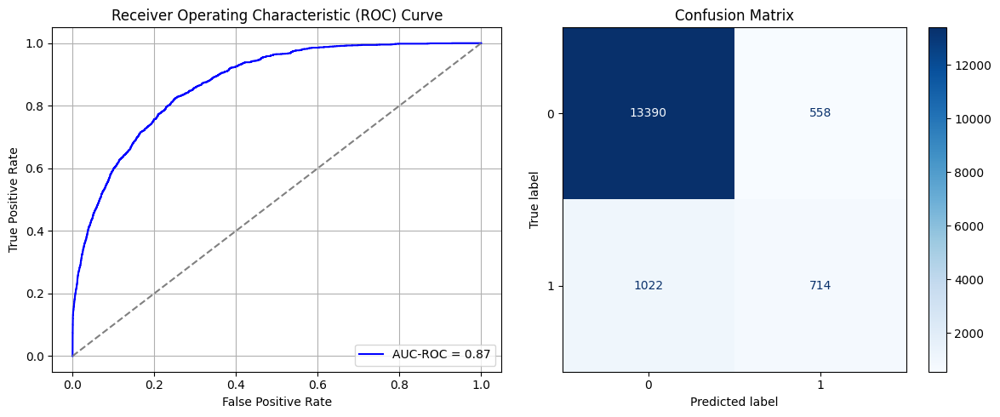

Best threshold based on F1-score: 0.34851688146591187
False Negative Rate: 0.5887096774193549
Time elapsed (performance): 3.3846259260008082
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7372 - loss: 0.6195 - val_AUC: 0.8468 - val_loss: 0.4940
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8551 - loss: 0.4740 - val_AUC: 0.8707 - val_loss: 0.4479
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8711 - loss: 0.4452 - val_AUC: 0.8742 - val_loss: 0.4466
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8701 - loss: 0.4456 - val_AUC: 0.8767 - val_loss: 0.4349
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4362 - val_AUC: 0.8772 - val_loss: 0.4334
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4313 - val_AUC: 0.8753 - val_loss: 0.4411
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8824 - loss: 0.4248 - val_AUC: 0.8782 - val_loss: 0.4321
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8752 - loss: 0.4371 - val_AUC: 0.8765 - val_loss: 0.4387
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8812 -

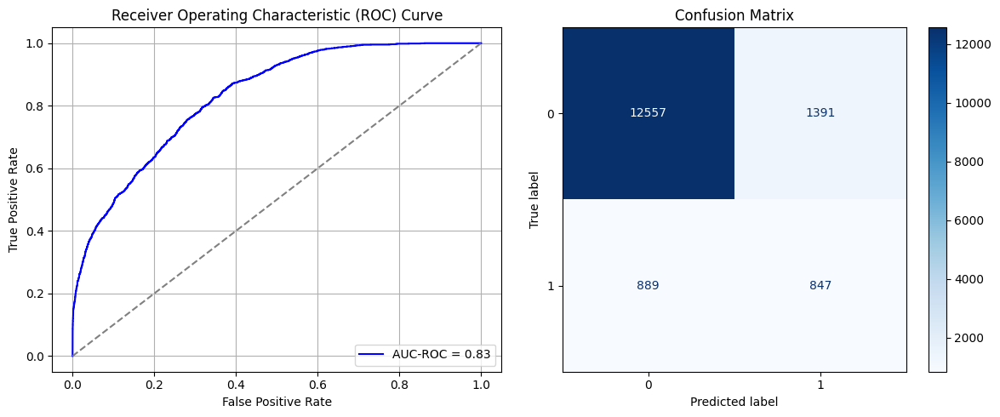

Best threshold based on F1-score: 0.5884890556335449
False Negative Rate: 0.5120967741935484
Time elapsed (performance): 1.3894125750002786
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7433 - loss: 0.6137 - val_AUC: 0.8587 - val_loss: 0.4722
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8615 - loss: 0.4629 - val_AUC: 0.8767 - val_loss: 0.4442
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4416 - val_AUC: 0.8788 - val_loss: 0.4364
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8738 - loss: 0.4387 - val_AUC: 0.8802 - val_loss: 0.4353
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4263 - val_AUC: 0.8811 - val_loss: 0.4303
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8829 - loss: 0.4237 - val_AUC: 0.8807 - val_loss: 0.4294
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8771 - loss: 0.4328 - val_AUC: 0.8804 - val_loss: 0.4299
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8817 - loss: 0.4270 - val_AUC: 0.8810 - val_loss: 0.4290
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 -

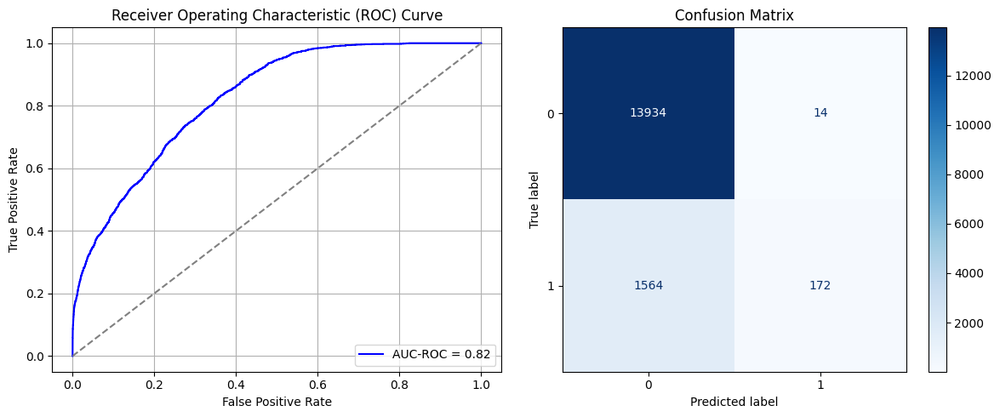

Best threshold based on F1-score: 0.037156302481889725
False Negative Rate: 0.9009216589861752
Time elapsed (performance): 1.3202291360003073
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7312 - loss: 0.6185 - val_AUC: 0.8446 - val_loss: 0.5023
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8535 - loss: 0.4737 - val_AUC: 0.8658 - val_loss: 0.4558
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8707 - loss: 0.4421 - val_AUC: 0.8676 - val_loss: 0.4517
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8775 - loss: 0.4316 - val_AUC: 0.8690 - val_loss: 0.4497
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.4400 - val_AUC: 0.8713 - val_loss: 0.4435
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8774 - loss: 0.4339 - val_AUC: 0.8710 - val_loss: 0.4447
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 - loss: 0.4342 - val_AUC: 0.8718 - val_loss: 0.4430
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4340 - val_AUC: 0.8720 - val_loss: 0.4493
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 -

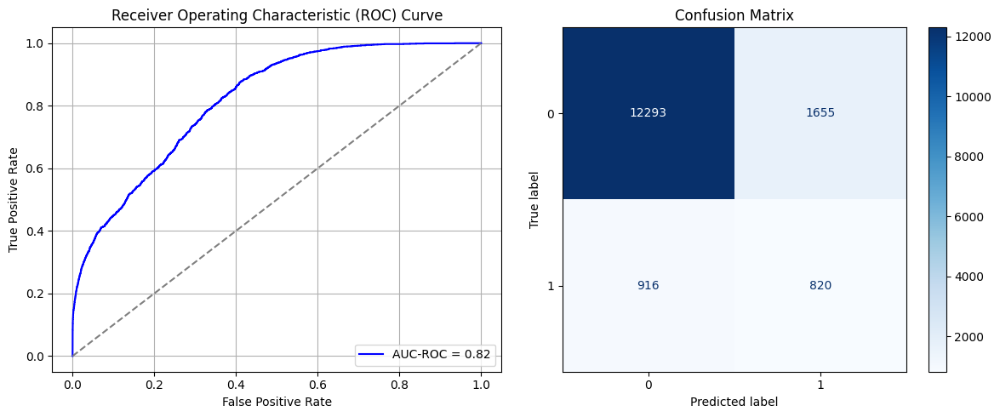

Best threshold based on F1-score: 0.5990222692489624
False Negative Rate: 0.5276497695852534
Time elapsed (performance): 1.4738991599997462
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7192 - loss: 0.6212 - val_AUC: 0.8652 - val_loss: 0.4667
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8628 - loss: 0.4616 - val_AUC: 0.8797 - val_loss: 0.4332
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4408 - val_AUC: 0.8810 - val_loss: 0.4409
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8712 - loss: 0.4436 - val_AUC: 0.8799 - val_loss: 0.4456
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4423 - val_AUC: 0.8823 - val_loss: 0.4301
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4348 - val_AUC: 0.8831 - val_loss: 0.4326
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.4357 - val_AUC: 0.8832 - val_loss: 0.4281
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8771 - loss: 0.4325 - val_AUC: 0.8837 - val_loss: 0.4363
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 -

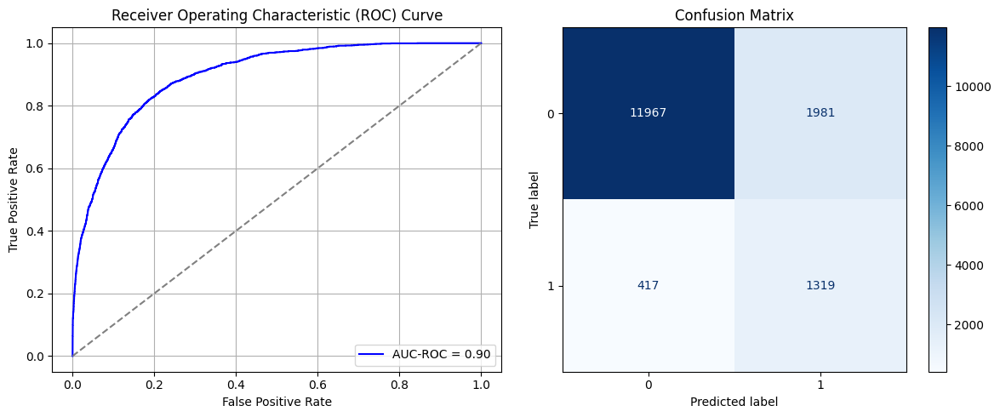

Best threshold based on F1-score: 0.6249601244926453
False Negative Rate: 0.2402073732718894
Time elapsed (performance): 1.5530119370005195
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7384 - loss: 0.6075 - val_AUC: 0.8669 - val_loss: 0.4706
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8640 - loss: 0.4597 - val_AUC: 0.8765 - val_loss: 0.4388
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8776 - loss: 0.4351 - val_AUC: 0.8795 - val_loss: 0.4331
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4379 - val_AUC: 0.8786 - val_loss: 0.4328
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4371 - val_AUC: 0.8815 - val_loss: 0.4354
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4370 - val_AUC: 0.8803 - val_loss: 0.4515
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4374 - val_AUC: 0.8802 - val_loss: 0.4691
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8760 - loss: 0.4332 - val_AUC: 0.8815 - val_loss: 0.4300
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8813 -

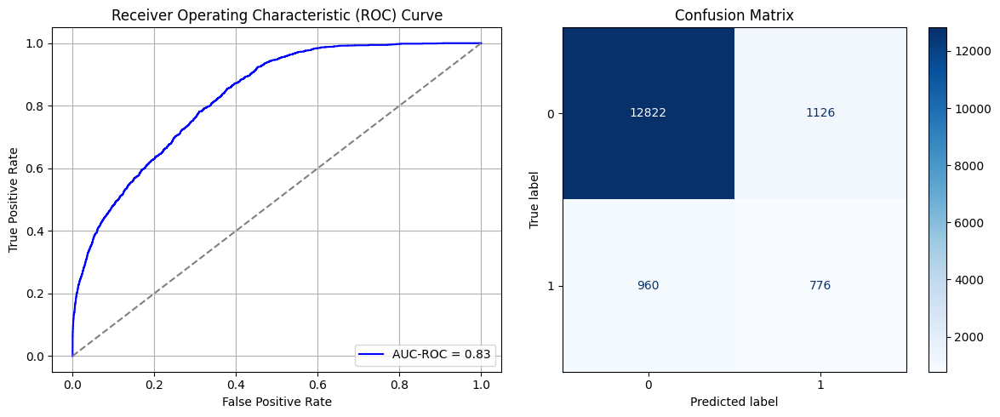

Best threshold based on F1-score: 0.5194205641746521
False Negative Rate: 0.5529953917050692
Time elapsed (performance): 1.6619789339993076
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7503 - loss: 0.6040 - val_AUC: 0.8648 - val_loss: 0.4935
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8575 - loss: 0.4680 - val_AUC: 0.8774 - val_loss: 0.4415
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4483 - val_AUC: 0.8781 - val_loss: 0.4345
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4329 - val_AUC: 0.8784 - val_loss: 0.4351
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8682 - loss: 0.4448 - val_AUC: 0.8802 - val_loss: 0.4300
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8741 - loss: 0.4373 - val_AUC: 0.8806 - val_loss: 0.4311
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8816 - loss: 0.4242 - val_AUC: 0.8811 - val_loss: 0.4380
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8719 - loss: 0.4427 - val_AUC: 0.8802 - val_loss: 0.4392
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8722 -

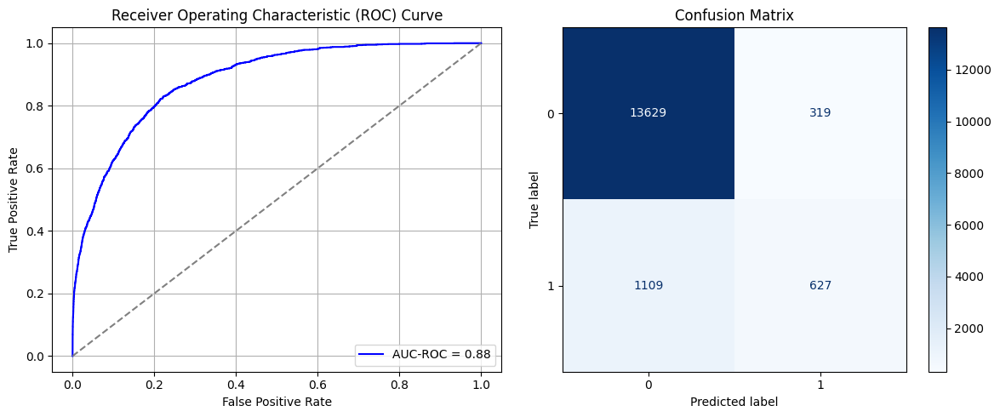

Best threshold based on F1-score: 0.2973518669605255
False Negative Rate: 0.6388248847926268
Time elapsed (performance): 1.6710825620002652
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7571 - loss: 0.6124 - val_AUC: 0.8632 - val_loss: 0.4942
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8585 - loss: 0.4669 - val_AUC: 0.8785 - val_loss: 0.4407
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4399 - val_AUC: 0.8809 - val_loss: 0.4300
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8770 - loss: 0.4328 - val_AUC: 0.8830 - val_loss: 0.4261
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4417 - val_AUC: 0.8830 - val_loss: 0.4249
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8833 - val_loss: 0.4287
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8825 - loss: 0.4234 - val_AUC: 0.8842 - val_loss: 0.4240
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8786 - loss: 0.4309 - val_AUC: 0.8829 - val_loss: 0.4338
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 -

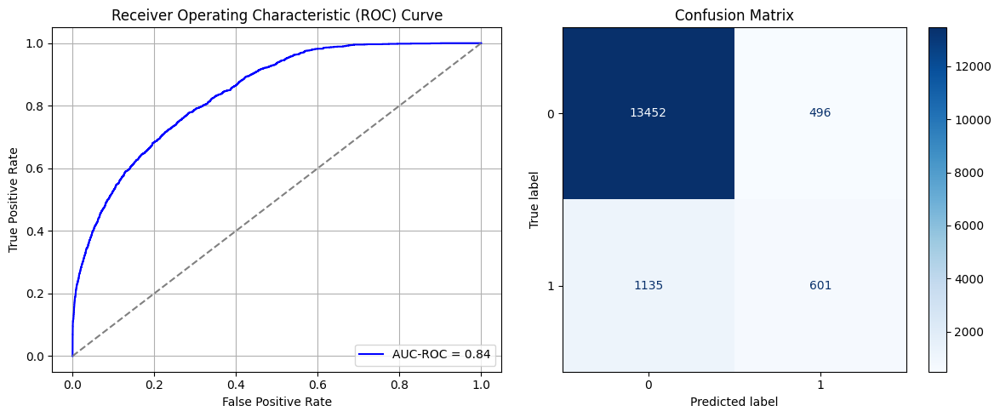

Best threshold based on F1-score: 0.35424721240997314
False Negative Rate: 0.6538018433179723
Time elapsed (performance): 1.3605978510004206
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7382 - loss: 0.6107 - val_AUC: 0.8549 - val_loss: 0.4759
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8639 - loss: 0.4587 - val_AUC: 0.8719 - val_loss: 0.4988
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8727 - loss: 0.4440 - val_AUC: 0.8719 - val_loss: 0.4490
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8730 - loss: 0.4418 - val_AUC: 0.8738 - val_loss: 0.4386
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8746 - loss: 0.4371 - val_AUC: 0.8749 - val_loss: 0.4363
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4372 - val_AUC: 0.8752 - val_loss: 0.4377
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4362 - val_AUC: 0.8753 - val_loss: 0.4355
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 - loss: 0.4285 - val_AUC: 0.8756 - val_loss: 0.4351
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 -

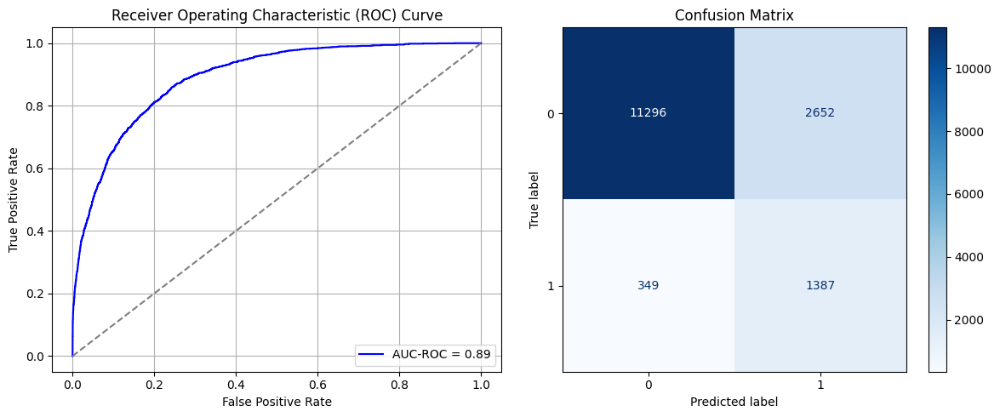

Best threshold based on F1-score: 0.626024067401886
False Negative Rate: 0.201036866359447
Time elapsed (performance): 1.3302410539999983
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7289 - loss: 0.6146 - val_AUC: 0.8607 - val_loss: 0.4818
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8608 - loss: 0.4635 - val_AUC: 0.8741 - val_loss: 0.4432
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4375 - val_AUC: 0.8753 - val_loss: 0.4397
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8653 - loss: 0.4490 - val_AUC: 0.8757 - val_loss: 0.4464
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8755 - loss: 0.4335 - val_AUC: 0.8777 - val_loss: 0.4364
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4352 - val_AUC: 0.8771 - val_loss: 0.4358
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.4304 - val_AUC: 0.8781 - val_loss: 0.4362
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8774 - loss: 0.4336 - val_AUC: 0.8786 - val_loss: 0.4441
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8772 -

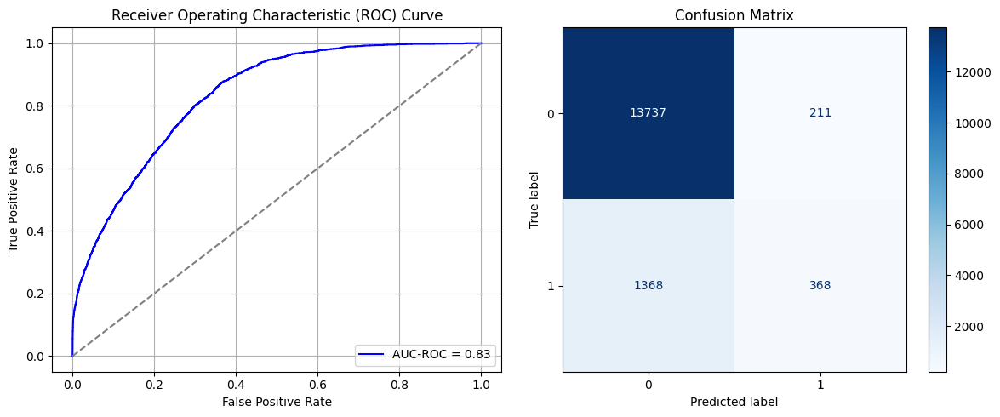

Best threshold based on F1-score: 0.1705807000398636
False Negative Rate: 0.7880184331797235
Time elapsed (performance): 1.6982132769999225
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7338 - loss: 0.6171 - val_AUC: 0.8632 - val_loss: 0.4720
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8524 - loss: 0.4753 - val_AUC: 0.8804 - val_loss: 0.4341
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8683 - loss: 0.4489 - val_AUC: 0.8830 - val_loss: 0.4283
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8628 - loss: 0.4529 - val_AUC: 0.8849 - val_loss: 0.4222
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.4359 - val_AUC: 0.8852 - val_loss: 0.4223
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8699 - loss: 0.4436 - val_AUC: 0.8859 - val_loss: 0.4206
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.4336 - val_AUC: 0.8852 - val_loss: 0.4351
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4329 - val_AUC: 0.8867 - val_loss: 0.4236
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8695 -

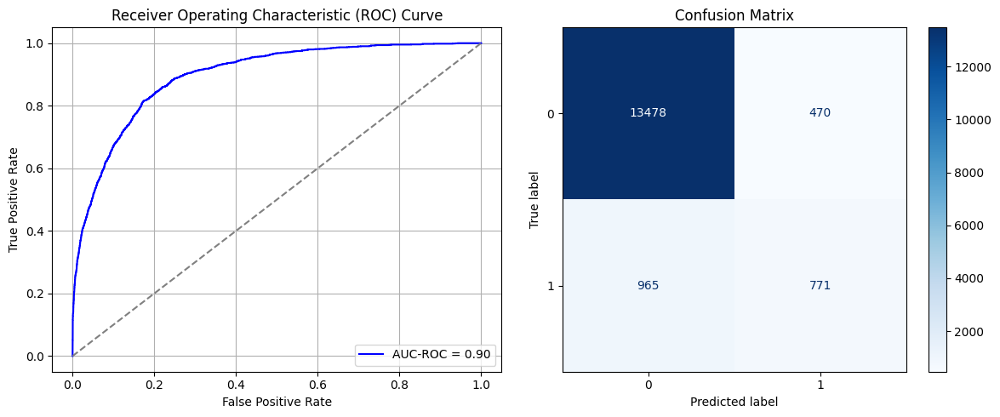

Best threshold based on F1-score: 0.3833443224430084
False Negative Rate: 0.5558755760368663
Time elapsed (performance): 1.4418879209997613
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7138 - loss: 0.6195 - val_AUC: 0.8540 - val_loss: 0.4832
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8502 - loss: 0.4795 - val_AUC: 0.8804 - val_loss: 0.4335
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8684 - loss: 0.4496 - val_AUC: 0.8825 - val_loss: 0.4293
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.4356 - val_AUC: 0.8828 - val_loss: 0.4255
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.4366 - val_AUC: 0.8824 - val_loss: 0.4434
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8711 - loss: 0.4445 - val_AUC: 0.8838 - val_loss: 0.4240
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.4395 - val_AUC: 0.8831 - val_loss: 0.4248
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4323 - val_AUC: 0.8832 - val_loss: 0.4234
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 -

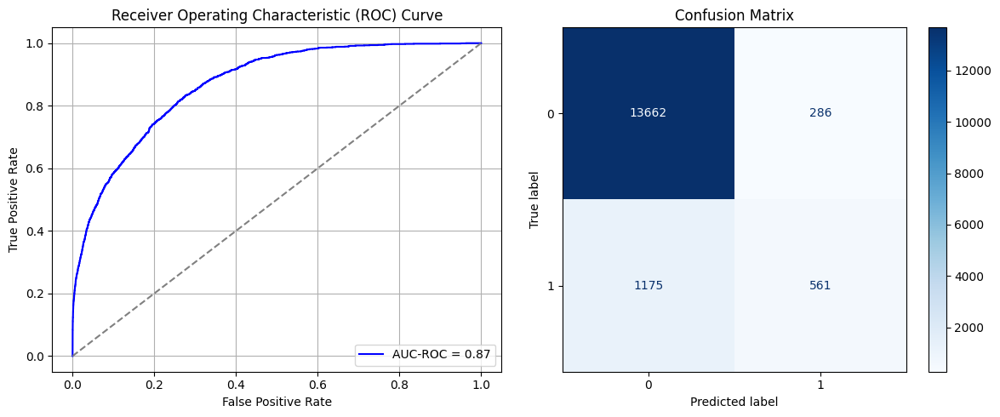

Best threshold based on F1-score: 0.3266928791999817
False Negative Rate: 0.6768433179723502
Time elapsed (performance): 1.2917817090001336
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7315 - loss: 0.6217 - val_AUC: 0.8641 - val_loss: 0.4733
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8578 - loss: 0.4697 - val_AUC: 0.8781 - val_loss: 0.4383
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8676 - loss: 0.4491 - val_AUC: 0.8800 - val_loss: 0.4380
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8746 - loss: 0.4393 - val_AUC: 0.8794 - val_loss: 0.4368
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8700 - loss: 0.4453 - val_AUC: 0.8808 - val_loss: 0.4335
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4352 - val_AUC: 0.8806 - val_loss: 0.4351
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.4352 - val_AUC: 0.8812 - val_loss: 0.4294
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8696 - loss: 0.4434 - val_AUC: 0.8812 - val_loss: 0.4289
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 -

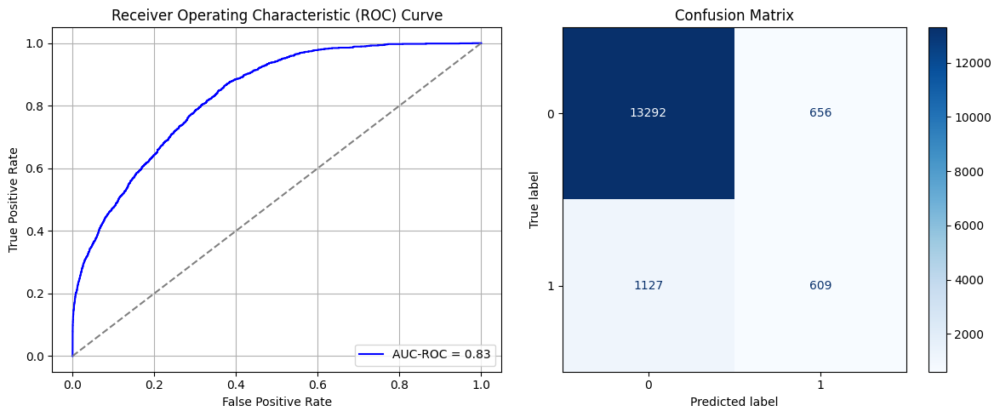

Best threshold based on F1-score: 0.40265756845474243
False Negative Rate: 0.6491935483870968
Time elapsed (performance): 1.699883528999635
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7358 - loss: 0.6132 - val_AUC: 0.8580 - val_loss: 0.4925
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8624 - loss: 0.4615 - val_AUC: 0.8707 - val_loss: 0.4462
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8664 - loss: 0.4513 - val_AUC: 0.8729 - val_loss: 0.4453
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 - loss: 0.4418 - val_AUC: 0.8743 - val_loss: 0.4419
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 - loss: 0.4388 - val_AUC: 0.8756 - val_loss: 0.4370
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8733 - loss: 0.4390 - val_AUC: 0.8752 - val_loss: 0.4384
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8738 - loss: 0.4376 - val_AUC: 0.8756 - val_loss: 0.4464
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4344 - val_AUC: 0.8765 - val_loss: 0.4364
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8766 -

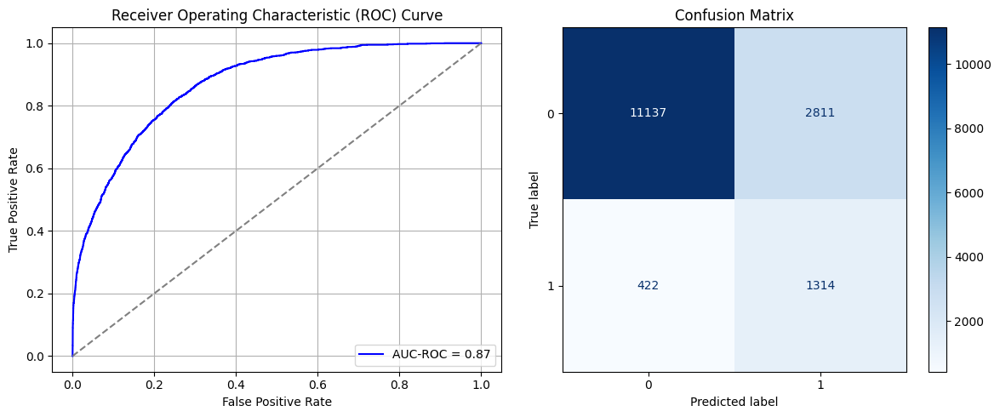

Best threshold based on F1-score: 0.6686305999755859
False Negative Rate: 0.24308755760368664
Time elapsed (performance): 1.3767901190003613
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7500 - loss: 0.6078 - val_AUC: 0.8593 - val_loss: 0.4702
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8601 - loss: 0.4624 - val_AUC: 0.8722 - val_loss: 0.4482
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 - loss: 0.4409 - val_AUC: 0.8739 - val_loss: 0.4392
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8677 - loss: 0.4497 - val_AUC: 0.8745 - val_loss: 0.4373
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4332 - val_AUC: 0.8761 - val_loss: 0.4386
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8783 - loss: 0.4316 - val_AUC: 0.8765 - val_loss: 0.4457
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4362 - val_AUC: 0.8773 - val_loss: 0.4332
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8775 - loss: 0.4318 - val_AUC: 0.8765 - val_loss: 0.4381
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8846 -

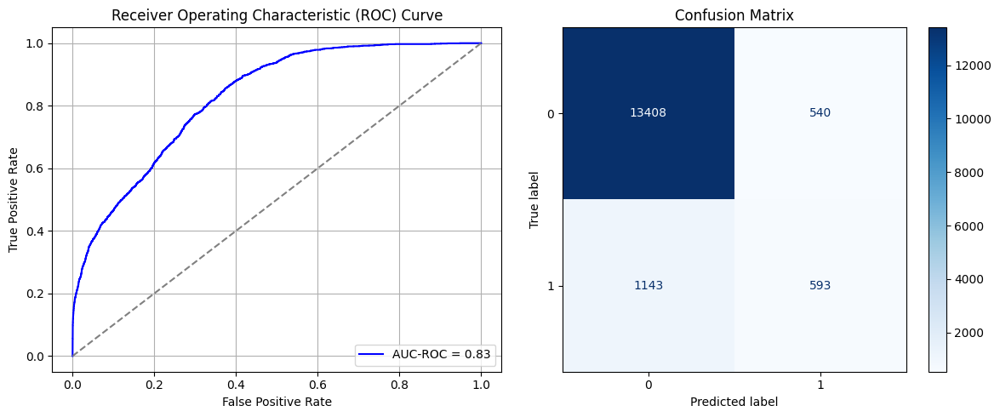

Best threshold based on F1-score: 0.3848702907562256
False Negative Rate: 0.658410138248848
Time elapsed (performance): 2.8412046410003313
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7323 - loss: 0.6197 - val_AUC: 0.8631 - val_loss: 0.4724
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8597 - loss: 0.4641 - val_AUC: 0.8776 - val_loss: 0.4374
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8756 - loss: 0.4367 - val_AUC: 0.8787 - val_loss: 0.4324
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8807 - loss: 0.4270 - val_AUC: 0.8810 - val_loss: 0.4285
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8801 - loss: 0.4292 - val_AUC: 0.8816 - val_loss: 0.4297
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4372 - val_AUC: 0.8824 - val_loss: 0.4262
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 - loss: 0.4346 - val_AUC: 0.8810 - val_loss: 0.4285
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4292 - val_AUC: 0.8809 - val_loss: 0.4286
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 -

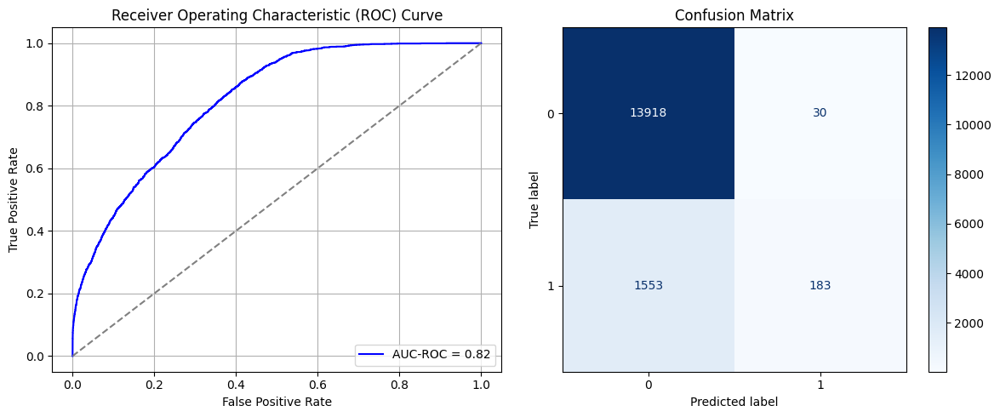

Best threshold based on F1-score: 0.03959805890917778
False Negative Rate: 0.8945852534562212
Time elapsed (performance): 1.7084823669993057
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7455 - loss: 0.6123 - val_AUC: 0.8518 - val_loss: 0.4850
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8612 - loss: 0.4654 - val_AUC: 0.8728 - val_loss: 0.4441
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8712 - loss: 0.4457 - val_AUC: 0.8770 - val_loss: 0.4366
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8835 - loss: 0.4261 - val_AUC: 0.8771 - val_loss: 0.4367
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8806 - loss: 0.4295 - val_AUC: 0.8779 - val_loss: 0.4349
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8773 - loss: 0.4357 - val_AUC: 0.8770 - val_loss: 0.4355
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8812 - loss: 0.4288 - val_AUC: 0.8791 - val_loss: 0.4320
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8839 - loss: 0.4228 - val_AUC: 0.8788 - val_loss: 0.4353
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8814 -

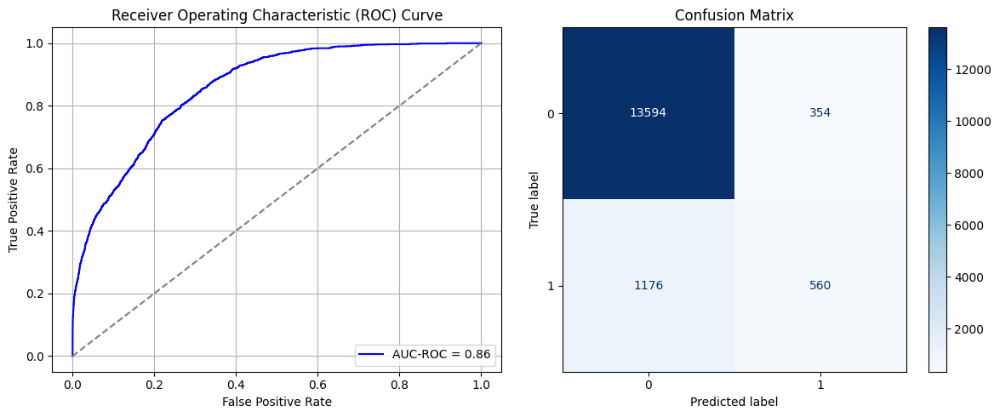

Best threshold based on F1-score: 0.34999629855155945
False Negative Rate: 0.6774193548387096
Time elapsed (performance): 1.708850662000259
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7416 - loss: 0.6024 - val_AUC: 0.8649 - val_loss: 0.4685
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8629 - loss: 0.4577 - val_AUC: 0.8781 - val_loss: 0.4510
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8738 - loss: 0.4407 - val_AUC: 0.8813 - val_loss: 0.4361
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4334 - val_AUC: 0.8812 - val_loss: 0.4322
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8806 - loss: 0.4292 - val_AUC: 0.8836 - val_loss: 0.4277
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8734 - loss: 0.4393 - val_AUC: 0.8832 - val_loss: 0.4568
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8796 - loss: 0.4301 - val_AUC: 0.8852 - val_loss: 0.4240
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8828 - loss: 0.4254 - val_AUC: 0.8848 - val_loss: 0.4270
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8831 -

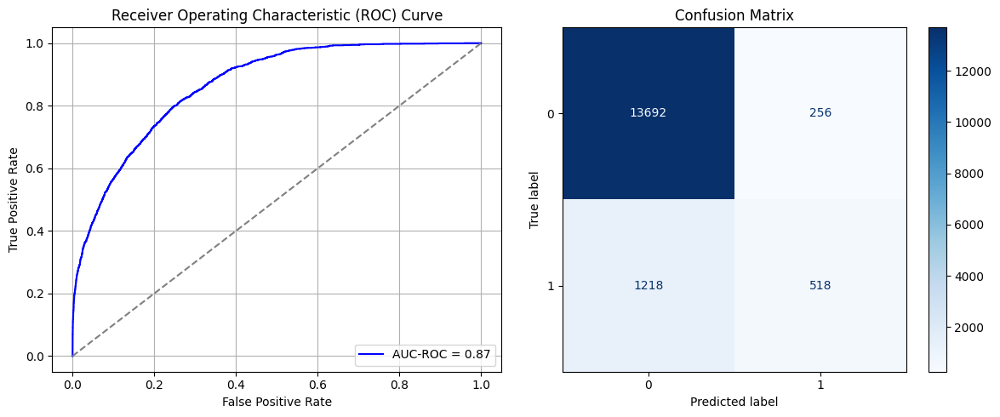

Best threshold based on F1-score: 0.2518073618412018
False Negative Rate: 0.7016129032258065
Time elapsed (performance): 1.4110271469999134
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7483 - loss: 0.6094 - val_AUC: 0.8534 - val_loss: 0.4858
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8561 - loss: 0.4710 - val_AUC: 0.8725 - val_loss: 0.4559
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8693 - loss: 0.4480 - val_AUC: 0.8758 - val_loss: 0.4382
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8759 - loss: 0.4350 - val_AUC: 0.8770 - val_loss: 0.4374
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4376 - val_AUC: 0.8779 - val_loss: 0.4607
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4364 - val_AUC: 0.8778 - val_loss: 0.4333
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4308 - val_AUC: 0.8789 - val_loss: 0.4318
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8736 - loss: 0.4379 - val_AUC: 0.8775 - val_loss: 0.4339
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8791 -

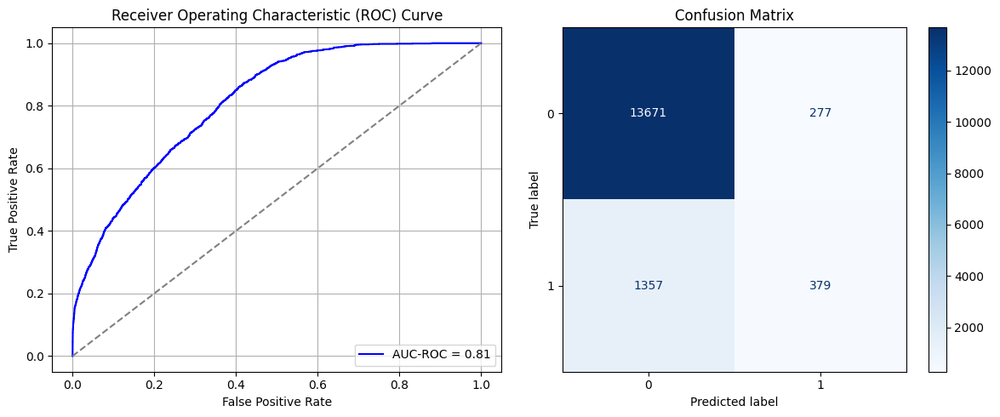

Best threshold based on F1-score: 0.2619604170322418
False Negative Rate: 0.7816820276497696
Time elapsed (performance): 1.448939750000136
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7253 - loss: 0.6129 - val_AUC: 0.8587 - val_loss: 0.4745
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8596 - loss: 0.4648 - val_AUC: 0.8742 - val_loss: 0.4398
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8654 - loss: 0.4506 - val_AUC: 0.8766 - val_loss: 0.4386
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4319 - val_AUC: 0.8777 - val_loss: 0.4345
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4340 - val_AUC: 0.8789 - val_loss: 0.4319
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8720 - loss: 0.4410 - val_AUC: 0.8788 - val_loss: 0.4317
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8817 - loss: 0.4257 - val_AUC: 0.8791 - val_loss: 0.4356
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8779 - loss: 0.4324 - val_AUC: 0.8794 - val_loss: 0.4339
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8775 -

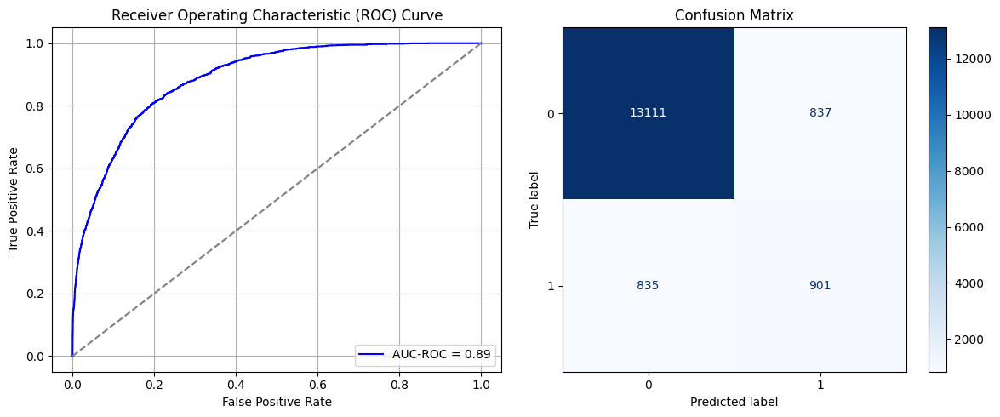

Best threshold based on F1-score: 0.43267565965652466
False Negative Rate: 0.48099078341013823
Time elapsed (performance): 2.045312436999666
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7415 - loss: 0.6086 - val_AUC: 0.8468 - val_loss: 0.4844
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8559 - loss: 0.4700 - val_AUC: 0.8674 - val_loss: 0.4526
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8695 - loss: 0.4467 - val_AUC: 0.8707 - val_loss: 0.4455
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8746 - loss: 0.4352 - val_AUC: 0.8716 - val_loss: 0.4446
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4351 - val_AUC: 0.8732 - val_loss: 0.4400
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8786 - loss: 0.4290 - val_AUC: 0.8734 - val_loss: 0.4397
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4299 - val_AUC: 0.8741 - val_loss: 0.4406
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4293 - val_AUC: 0.8749 - val_loss: 0.4380
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8809 -

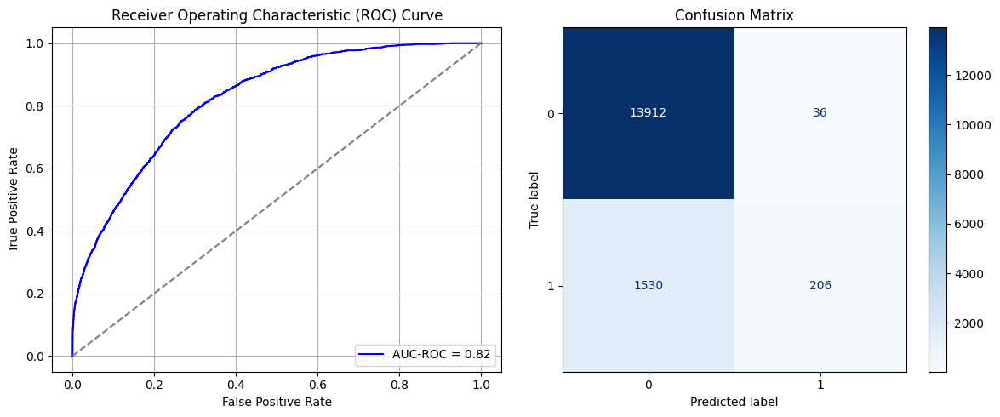

Best threshold based on F1-score: 0.1015249714255333
False Negative Rate: 0.881336405529954
Time elapsed (performance): 1.8927567990003809
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7557 - loss: 0.6095 - val_AUC: 0.8534 - val_loss: 0.4913
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8622 - loss: 0.4619 - val_AUC: 0.8690 - val_loss: 0.4497
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4430 - val_AUC: 0.8704 - val_loss: 0.4655
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8707 - loss: 0.4441 - val_AUC: 0.8718 - val_loss: 0.4474
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4405 - val_AUC: 0.8728 - val_loss: 0.4414
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4296 - val_AUC: 0.8733 - val_loss: 0.4410
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8775 - loss: 0.4315 - val_AUC: 0.8727 - val_loss: 0.4419
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 - loss: 0.4300 - val_AUC: 0.8732 - val_loss: 0.4416
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8818 -

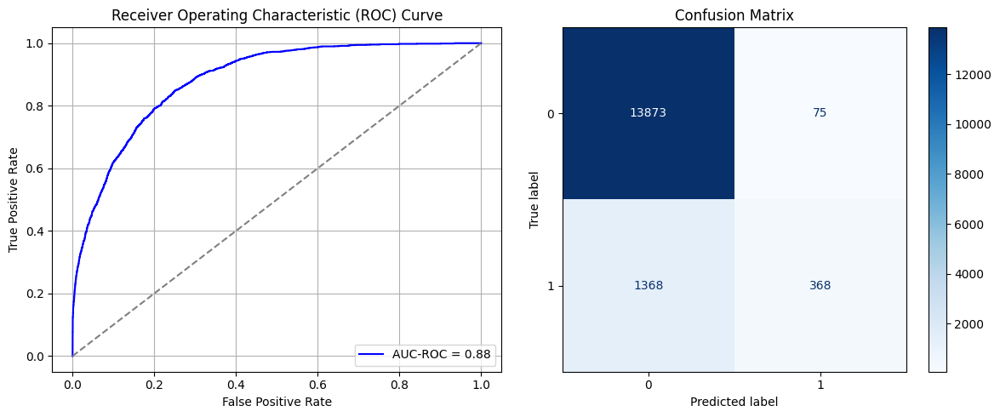

Best threshold based on F1-score: 0.11667607724666595
False Negative Rate: 0.7880184331797235
Time elapsed (performance): 1.6874057479999465
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7575 - loss: 0.6137 - val_AUC: 0.8628 - val_loss: 0.4699
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8651 - loss: 0.4572 - val_AUC: 0.8771 - val_loss: 0.4383
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8634 - loss: 0.4542 - val_AUC: 0.8783 - val_loss: 0.4355
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8738 - loss: 0.4382 - val_AUC: 0.8778 - val_loss: 0.4364
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 - loss: 0.4457 - val_AUC: 0.8796 - val_loss: 0.4316
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8741 - loss: 0.4383 - val_AUC: 0.8803 - val_loss: 0.4326
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 - loss: 0.4412 - val_AUC: 0.8791 - val_loss: 0.4353
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4300 - val_AUC: 0.8803 - val_loss: 0.4320
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 -

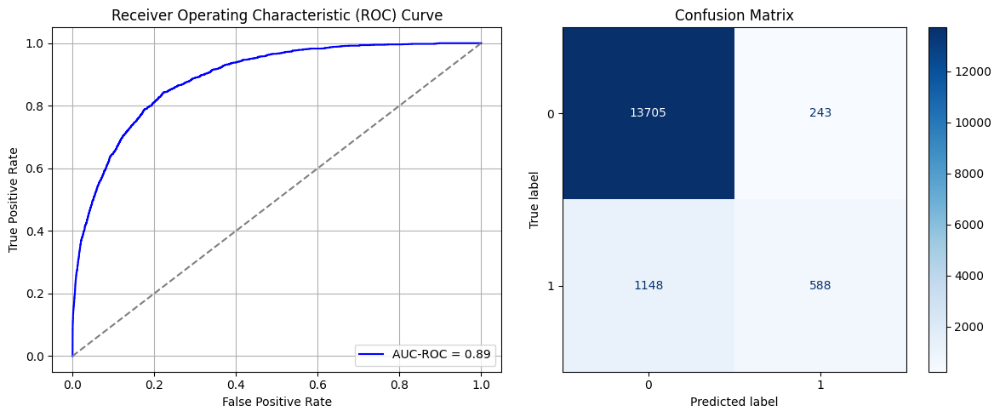

Best threshold based on F1-score: 0.2480154037475586
False Negative Rate: 0.6612903225806451
Time elapsed (performance): 1.3889127070005998
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6934 - loss: 0.6243 - val_AUC: 0.8657 - val_loss: 0.4727
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8682 - loss: 0.4539 - val_AUC: 0.8784 - val_loss: 0.4687
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4407 - val_AUC: 0.8806 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4379 - val_AUC: 0.8793 - val_loss: 0.4298
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.4346 - val_AUC: 0.8820 - val_loss: 0.4269
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8795 - loss: 0.4294 - val_AUC: 0.8791 - val_loss: 0.4351
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8781 - loss: 0.4331 - val_AUC: 0.8818 - val_loss: 0.4256
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8793 - loss: 0.4288 - val_AUC: 0.8806 - val_loss: 0.4360
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8778 -

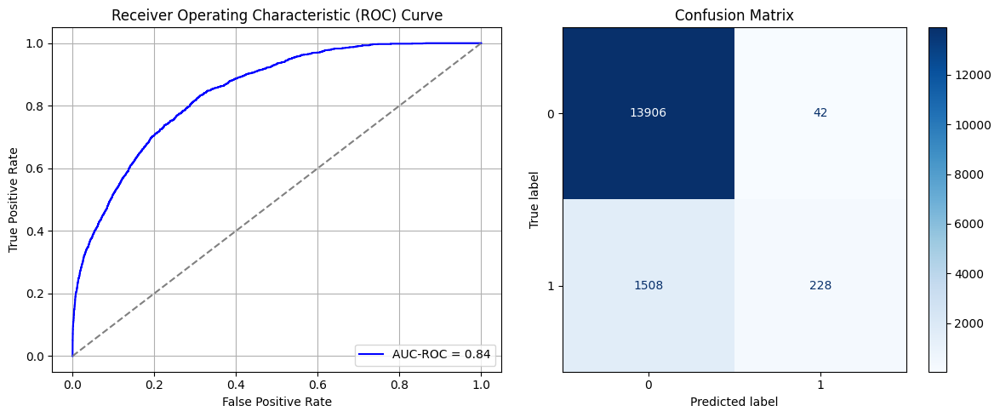

Best threshold based on F1-score: 0.07705623656511307
False Negative Rate: 0.868663594470046
Time elapsed (performance): 1.6748086289999264
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7415 - loss: 0.6104 - val_AUC: 0.8554 - val_loss: 0.4760
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8639 - loss: 0.4584 - val_AUC: 0.8708 - val_loss: 0.4458
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.8723 - loss: 0.4424 - val_AUC: 0.8744 - val_loss: 0.4416
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4370 - val_AUC: 0.8754 - val_loss: 0.4461
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4375 - val_AUC: 0.8761 - val_loss: 0.4415
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.4347 - val_AUC: 0.8773 - val_loss: 0.4353
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4315 - val_AUC: 0.8780 - val_loss: 0.4331
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8786 - loss: 0.4294 - val_AUC: 0.8775 - val_loss: 0.4336
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8811 -

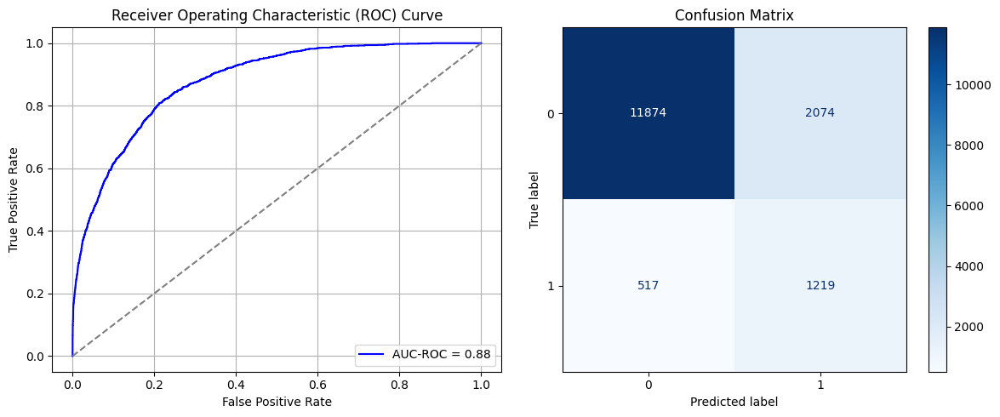

Best threshold based on F1-score: 0.6209943890571594
False Negative Rate: 0.2978110599078341
Time elapsed (performance): 1.4907608330004223
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7376 - loss: 0.6116 - val_AUC: 0.8651 - val_loss: 0.4668
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8590 - loss: 0.4666 - val_AUC: 0.8726 - val_loss: 0.4441
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8679 - loss: 0.4488 - val_AUC: 0.8750 - val_loss: 0.4382
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8688 - loss: 0.4467 - val_AUC: 0.8750 - val_loss: 0.4440
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4341 - val_AUC: 0.8745 - val_loss: 0.4391
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4389 - val_AUC: 0.8765 - val_loss: 0.4350
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4386 - val_AUC: 0.8751 - val_loss: 0.4393
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8763 - loss: 0.4351 - val_AUC: 0.8747 - val_loss: 0.4412
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8711 -

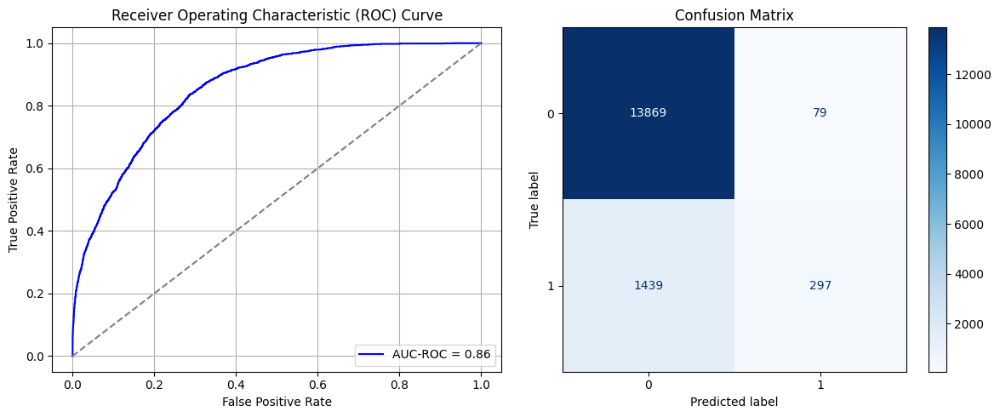

Best threshold based on F1-score: 0.11984707415103912
False Negative Rate: 0.8289170506912442
Time elapsed (performance): 1.4230908620002083
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7167 - loss: 0.6191 - val_AUC: 0.8488 - val_loss: 0.4845
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8494 - loss: 0.4813 - val_AUC: 0.8726 - val_loss: 0.4469
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4437 - val_AUC: 0.8759 - val_loss: 0.4389
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4339 - val_AUC: 0.8770 - val_loss: 0.4348
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4356 - val_AUC: 0.8770 - val_loss: 0.4345
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8746 - loss: 0.4377 - val_AUC: 0.8777 - val_loss: 0.4338
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8766 - loss: 0.4329 - val_AUC: 0.8772 - val_loss: 0.4516
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 - loss: 0.4319 - val_AUC: 0.8797 - val_loss: 0.4311
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8816 -

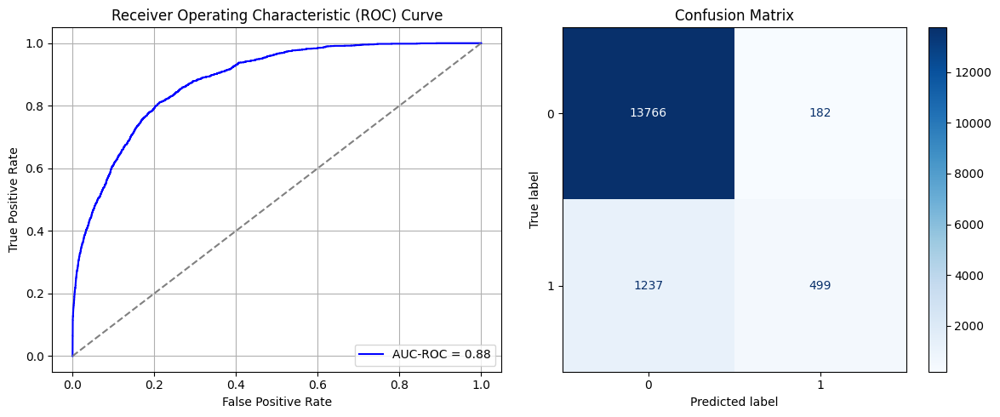

Best threshold based on F1-score: 0.18082241714000702
False Negative Rate: 0.7125576036866359
Time elapsed (performance): 1.7098898049998752
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7505 - loss: 0.6194 - val_AUC: 0.8520 - val_loss: 0.4790
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8553 - loss: 0.4702 - val_AUC: 0.8638 - val_loss: 0.4598
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8634 - loss: 0.4538 - val_AUC: 0.8679 - val_loss: 0.4583
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8667 - loss: 0.4488 - val_AUC: 0.8703 - val_loss: 0.4464
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8724 - loss: 0.4392 - val_AUC: 0.8706 - val_loss: 0.4483
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4343 - val_AUC: 0.8698 - val_loss: 0.4457
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8797 - loss: 0.4283 - val_AUC: 0.8707 - val_loss: 0.4515
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4334 - val_AUC: 0.8719 - val_loss: 0.4434
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8799 -

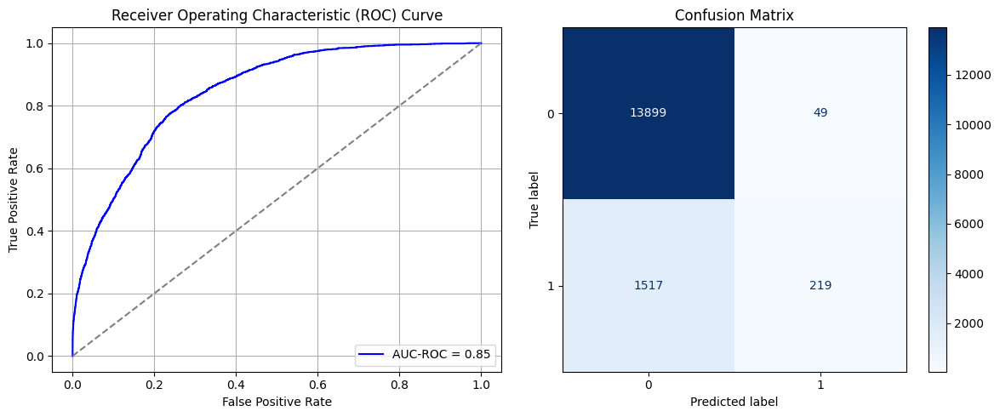

Best threshold based on F1-score: 0.07313856482505798
False Negative Rate: 0.8738479262672811
Time elapsed (performance): 1.7320431699999972
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7251 - loss: 0.6220 - val_AUC: 0.8553 - val_loss: 0.4787
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8573 - loss: 0.4706 - val_AUC: 0.8755 - val_loss: 0.4405
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8701 - loss: 0.4472 - val_AUC: 0.8767 - val_loss: 0.4385
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8778 - loss: 0.4330 - val_AUC: 0.8788 - val_loss: 0.4360
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8803 - loss: 0.4272 - val_AUC: 0.8795 - val_loss: 0.4310
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8792 - loss: 0.4299 - val_AUC: 0.8792 - val_loss: 0.4307
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8784 - loss: 0.4295 - val_AUC: 0.8797 - val_loss: 0.4341
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8818 - loss: 0.4240 - val_AUC: 0.8808 - val_loss: 0.4312
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8787 -

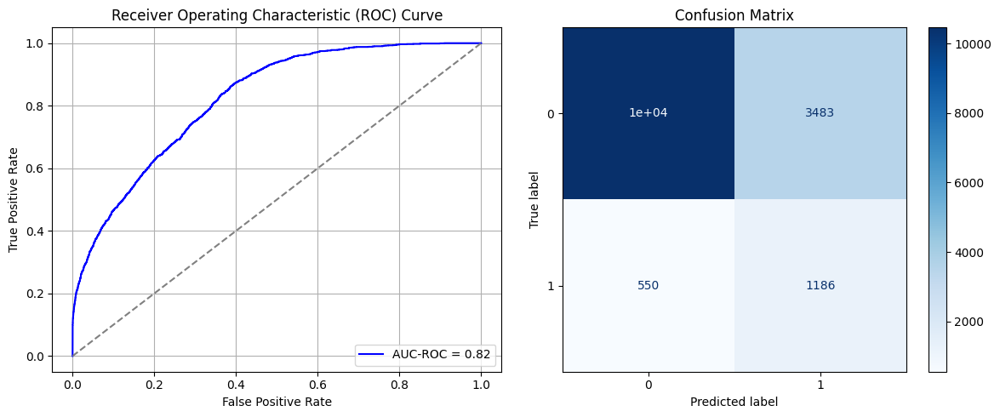

Best threshold based on F1-score: 0.7206862568855286
False Negative Rate: 0.31682027649769584
Time elapsed (performance): 1.4746612930002811


In [87]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [89]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR       FNR       TNR  Target time
0     18.303071  0.124892  0.506336  0.493664  0.875108     1.793025
1     16.633857  0.223114  0.635945  0.364055  0.776886     1.199840
2     17.355280  0.032765  0.392857  0.607143  0.967235     1.715382
3     18.062277  0.062303  0.338710  0.661290  0.937697     1.207519
4     15.994438  0.054130  0.516129  0.483871  0.945870     1.779479
5     15.906994  0.139590  0.431452  0.568548  0.860410     1.184487
6     16.553436  0.010683  0.264977  0.735023  0.989317     1.822441
7     15.896399  0.005951  0.152650  0.847350  0.994049     1.195193
8     16.689432  0.051118  0.508641  0.491359  0.948882     1.687547
9     18.979327  0.002294  0.168203  0.831797  0.997706     1.685237
10    17.425116  0.002724  0.152650  0.847350  0.997276     1.836357
11    16.961429  0.035632  0.417051  0.582949  0.964368     1.689938
12    15.865128  0.000430  0.080069  0.919931  0.999570     1.406159
13    18.801262  0.162317  0.73329

## Simple Random Sampling with Replacement:

In [90]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7331 - loss: 0.6161 - val_AUC: 0.8593 - val_loss: 0.4759
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8683 - loss: 0.4528 - val_AUC: 0.8731 - val_loss: 0.4626
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4327 - val_AUC: 0.8764 - val_loss: 0.4362
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8805 - loss: 0.4284 - val_AUC: 0.8771 - val_loss: 0.4511
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4323 - val_AUC: 0.8787 - val_loss: 0.4320
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4341 - val_AUC: 0.8790 - val_loss: 0.4315
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4280 - val_AUC: 0.8796 - val_loss: 0.4306
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4328 - val_AUC: 0.8780 - val_loss: 0.4323
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AU

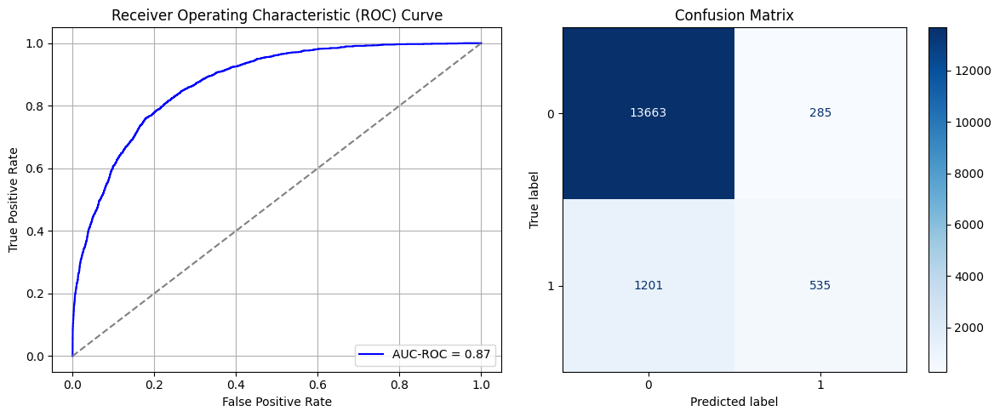

Best threshold based on F1-score: 0.23125919699668884
False Negative Rate: 0.6918202764976958
Time elapsed (performance): 1.1698157060000085
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7593 - loss: 0.6059 - val_AUC: 0.8667 - val_loss: 0.4644
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8599 - loss: 0.4618 - val_AUC: 0.8742 - val_loss: 0.4410
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8667 - loss: 0.4494 - val_AUC: 0.8761 - val_loss: 0.4386
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8722 - loss: 0.4402 - val_AUC: 0.8772 - val_loss: 0.4347
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8804 - loss: 0.4260 - val_AUC: 0.8784 - val_loss: 0.4337
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4356 - val_AUC: 0.8781 - val_loss: 0.4343
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4246 - val_AUC: 0.8792 - val_loss: 0.4338
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4238 - val_AUC: 0.8796 - val_loss: 0.4301
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 -

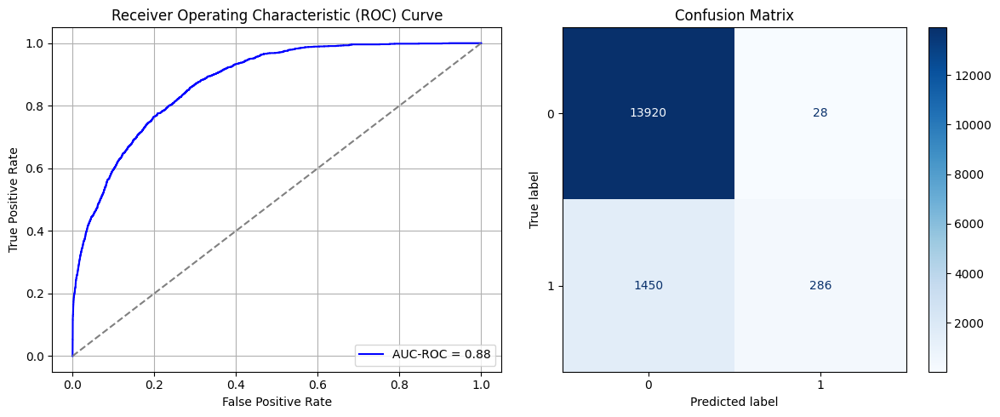

Best threshold based on F1-score: 0.07851672172546387
False Negative Rate: 0.8352534562211982
Time elapsed (performance): 1.165940738000245
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7272 - loss: 0.6177 - val_AUC: 0.8467 - val_loss: 0.4917
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8592 - loss: 0.4676 - val_AUC: 0.8686 - val_loss: 0.4525
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8749 - loss: 0.4394 - val_AUC: 0.8709 - val_loss: 0.4461
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4385 - val_AUC: 0.8722 - val_loss: 0.4609
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4270 - val_AUC: 0.8741 - val_loss: 0.4428
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4311 - val_AUC: 0.8725 - val_loss: 0.4497
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4318 - val_AUC: 0.8747 - val_loss: 0.4390
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 - loss: 0.4255 - val_AUC: 0.8749 - val_loss: 0.4385
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8793 -

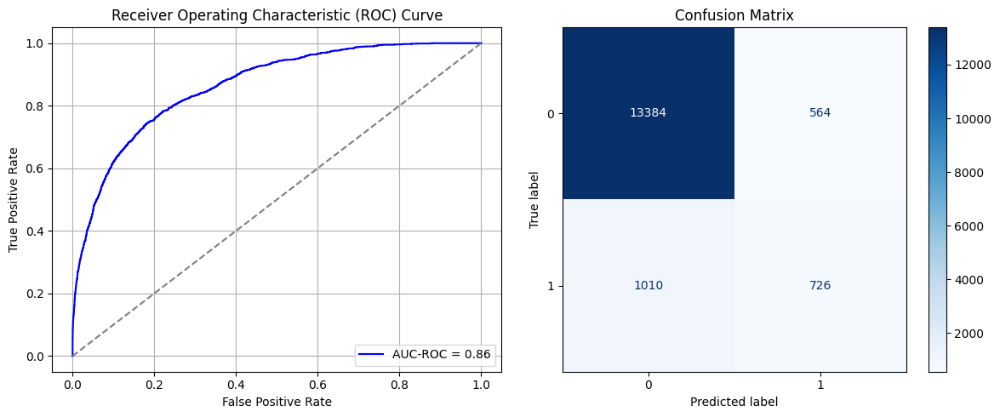

Best threshold based on F1-score: 0.37342560291290283
False Negative Rate: 0.5817972350230415
Time elapsed (performance): 1.1923751940003058
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7252 - loss: 0.6199 - val_AUC: 0.8617 - val_loss: 0.4699
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8681 - loss: 0.4547 - val_AUC: 0.8775 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4413 - val_AUC: 0.8781 - val_loss: 0.4328
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 - loss: 0.4357 - val_AUC: 0.8804 - val_loss: 0.4435
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4401 - val_AUC: 0.8778 - val_loss: 0.4541
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 - loss: 0.4255 - val_AUC: 0.8794 - val_loss: 0.4309
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4251 - val_AUC: 0.8794 - val_loss: 0.4386
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8804 - loss: 0.4282 - val_AUC: 0.8797 - val_loss: 0.4343
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8867 -

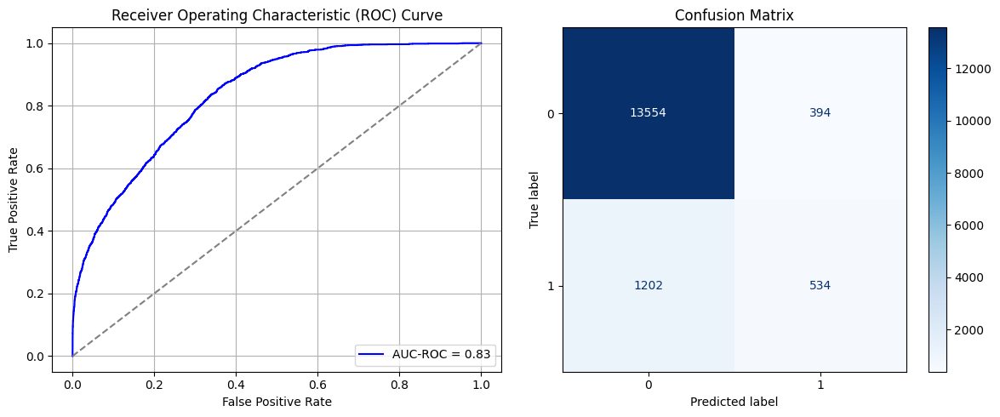

Best threshold based on F1-score: 0.30372172594070435
False Negative Rate: 0.6923963133640553
Time elapsed (performance): 1.4177146239999274
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7205 - loss: 0.6109 - val_AUC: 0.8619 - val_loss: 0.4664
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8606 - loss: 0.4627 - val_AUC: 0.8764 - val_loss: 0.4419
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8646 - loss: 0.4508 - val_AUC: 0.8780 - val_loss: 0.4326
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8673 - loss: 0.4475 - val_AUC: 0.8798 - val_loss: 0.4297
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4367 - val_AUC: 0.8788 - val_loss: 0.4314
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4350 - val_AUC: 0.8807 - val_loss: 0.4473
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8695 - loss: 0.4427 - val_AUC: 0.8808 - val_loss: 0.4311
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4327 - val_AUC: 0.8805 - val_loss: 0.4333
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 -

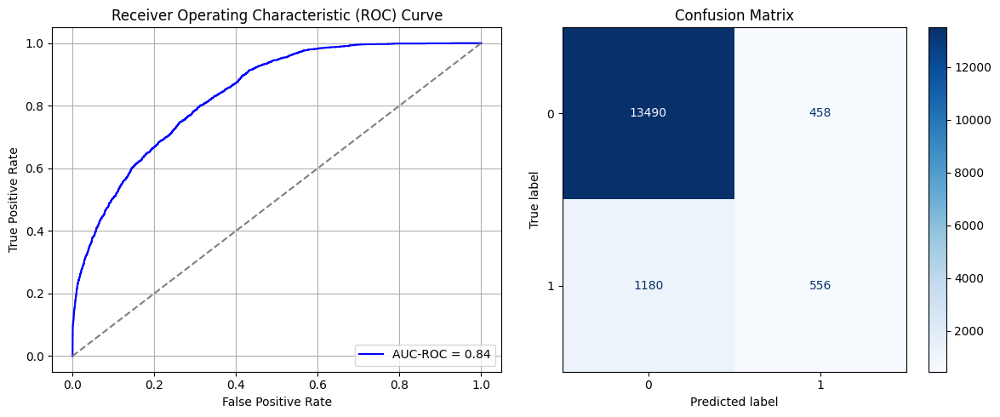

Best threshold based on F1-score: 0.31086763739585876
False Negative Rate: 0.6797235023041475
Time elapsed (performance): 1.1883148140004778
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7407 - loss: 0.6167 - val_AUC: 0.8676 - val_loss: 0.4684
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8618 - loss: 0.4608 - val_AUC: 0.8821 - val_loss: 0.4289
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8751 - loss: 0.4358 - val_AUC: 0.8833 - val_loss: 0.4240
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8699 - loss: 0.4451 - val_AUC: 0.8838 - val_loss: 0.4230
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4309 - val_AUC: 0.8841 - val_loss: 0.4237
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8781 - loss: 0.4307 - val_AUC: 0.8835 - val_loss: 0.4228
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8795 - loss: 0.4284 - val_AUC: 0.8840 - val_loss: 0.4279
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 - loss: 0.4281 - val_AUC: 0.8847 - val_loss: 0.4205
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 -

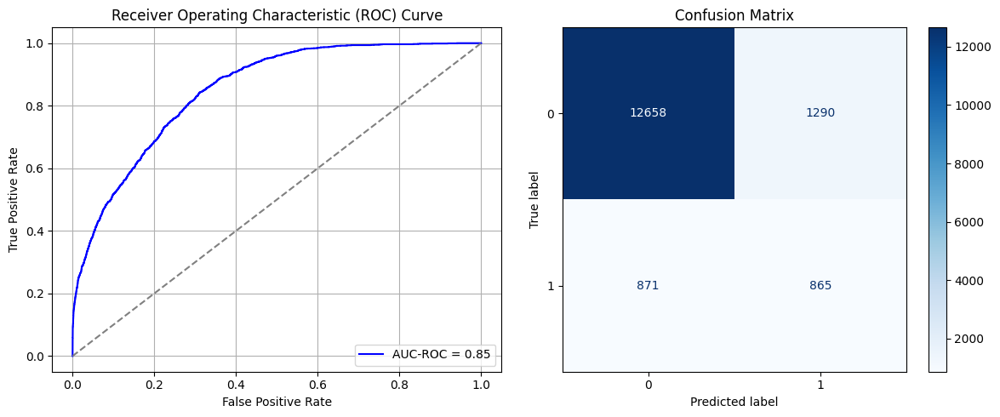

Best threshold based on F1-score: 0.5333507657051086
False Negative Rate: 0.5017281105990783
Time elapsed (performance): 1.1737268749993746
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7334 - loss: 0.6194 - val_AUC: 0.8612 - val_loss: 0.4783
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8654 - loss: 0.4567 - val_AUC: 0.8743 - val_loss: 0.4501
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8702 - loss: 0.4450 - val_AUC: 0.8775 - val_loss: 0.4362
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4336 - val_AUC: 0.8780 - val_loss: 0.4343
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4339 - val_AUC: 0.8793 - val_loss: 0.4365
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4372 - val_AUC: 0.8790 - val_loss: 0.4327
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4318 - val_AUC: 0.8786 - val_loss: 0.4337
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4332 - val_AUC: 0.8807 - val_loss: 0.4393
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8826 -

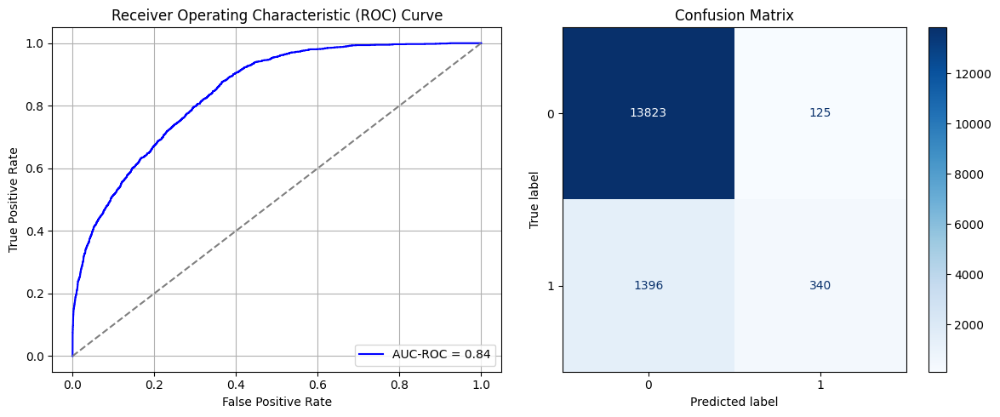

Best threshold based on F1-score: 0.2533893585205078
False Negative Rate: 0.804147465437788
Time elapsed (performance): 1.8703100470002028
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7566 - loss: 0.6117 - val_AUC: 0.8531 - val_loss: 0.4782
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8613 - loss: 0.4615 - val_AUC: 0.8701 - val_loss: 0.4465
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4365 - val_AUC: 0.8729 - val_loss: 0.4606
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4366 - val_AUC: 0.8726 - val_loss: 0.4439
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4186 - val_AUC: 0.8748 - val_loss: 0.4382
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4272 - val_AUC: 0.8744 - val_loss: 0.4560
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4345 - val_AUC: 0.8765 - val_loss: 0.4361
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8797 - loss: 0.4293 - val_AUC: 0.8729 - val_loss: 0.4410
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 -

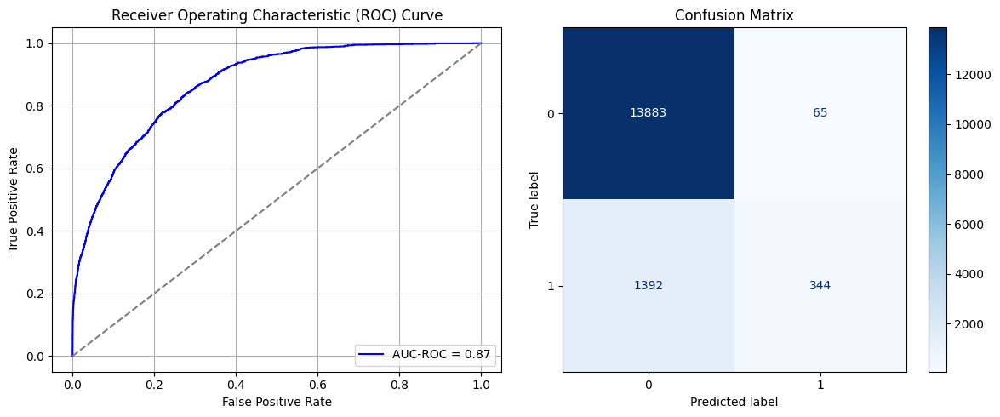

Best threshold based on F1-score: 0.14385387301445007
False Negative Rate: 0.8018433179723502
Time elapsed (performance): 1.2018755119997877
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7318 - loss: 0.6080 - val_AUC: 0.8676 - val_loss: 0.4604
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8603 - loss: 0.4631 - val_AUC: 0.8800 - val_loss: 0.4350
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8660 - loss: 0.4511 - val_AUC: 0.8830 - val_loss: 0.4267
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4492 - val_AUC: 0.8822 - val_loss: 0.4278
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4329 - val_AUC: 0.8839 - val_loss: 0.4251
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8754 - loss: 0.4355 - val_AUC: 0.8848 - val_loss: 0.4240
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4301 - val_AUC: 0.8856 - val_loss: 0.4231
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4304 - val_AUC: 0.8838 - val_loss: 0.4271
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8736 -

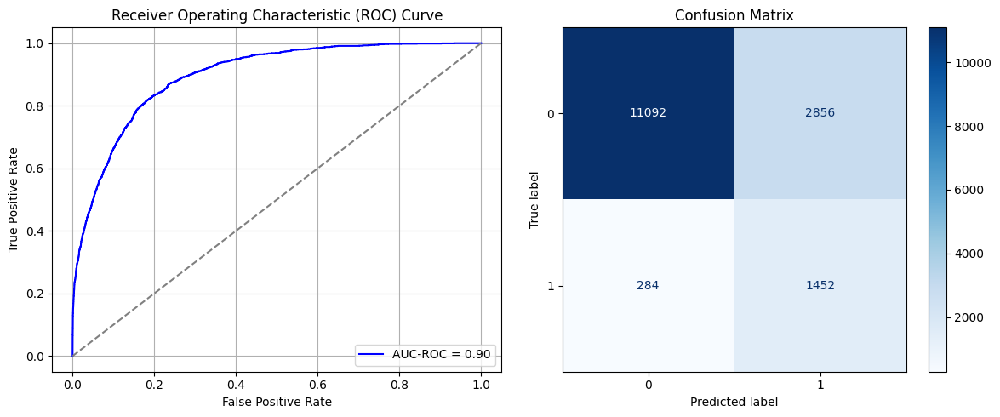

Best threshold based on F1-score: 0.6312742233276367
False Negative Rate: 0.16359447004608296
Time elapsed (performance): 1.1767475970000305
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7339 - loss: 0.6056 - val_AUC: 0.8700 - val_loss: 0.4572
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8607 - loss: 0.4626 - val_AUC: 0.8770 - val_loss: 0.4374
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.4352 - val_AUC: 0.8785 - val_loss: 0.4324
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4388 - val_AUC: 0.8799 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4328 - val_AUC: 0.8810 - val_loss: 0.4308
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4365 - val_AUC: 0.8800 - val_loss: 0.4285
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4376 - val_AUC: 0.8812 - val_loss: 0.4263
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4367 - val_AUC: 0.8815 - val_loss: 0.4260
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 -

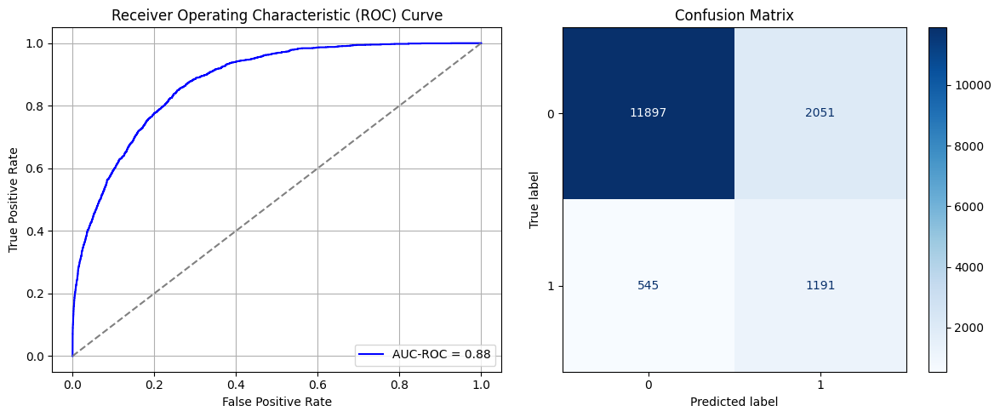

Best threshold based on F1-score: 0.5913307070732117
False Negative Rate: 0.31394009216589863
Time elapsed (performance): 1.1731181980003385
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7250 - loss: 0.6209 - val_AUC: 0.8610 - val_loss: 0.4741
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8631 - loss: 0.4605 - val_AUC: 0.8728 - val_loss: 0.4522
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8683 - loss: 0.4481 - val_AUC: 0.8735 - val_loss: 0.4426
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8717 - loss: 0.4432 - val_AUC: 0.8735 - val_loss: 0.4455
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8707 - loss: 0.4439 - val_AUC: 0.8749 - val_loss: 0.4423
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8749 - loss: 0.4365 - val_AUC: 0.8753 - val_loss: 0.4380
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4340 - val_AUC: 0.8757 - val_loss: 0.4391
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8718 - loss: 0.4407 - val_AUC: 0.8762 - val_loss: 0.4386
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 -

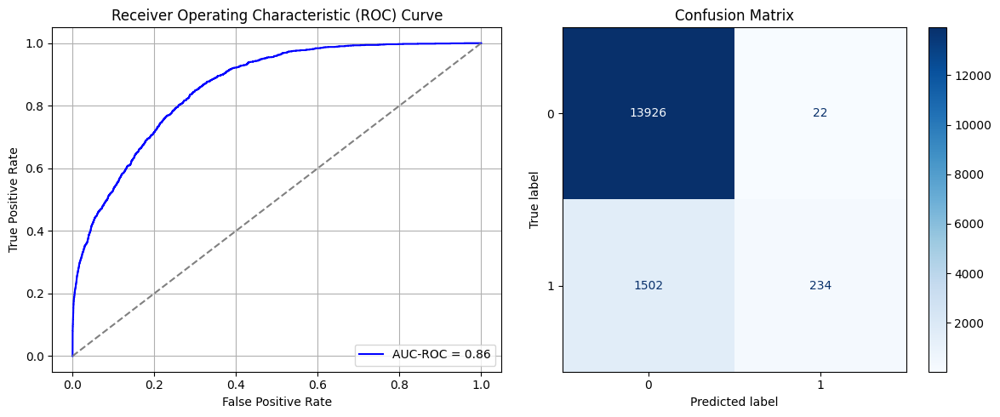

Best threshold based on F1-score: 0.1126183345913887
False Negative Rate: 0.8652073732718893
Time elapsed (performance): 1.6645147559993347
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7143 - loss: 0.6250 - val_AUC: 0.8533 - val_loss: 0.4881
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8487 - loss: 0.4784 - val_AUC: 0.8803 - val_loss: 0.4339
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8655 - loss: 0.4497 - val_AUC: 0.8831 - val_loss: 0.4274
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8682 - loss: 0.4442 - val_AUC: 0.8849 - val_loss: 0.4417
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4370 - val_AUC: 0.8853 - val_loss: 0.4246
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4367 - val_AUC: 0.8847 - val_loss: 0.4236
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8751 - loss: 0.4348 - val_AUC: 0.8863 - val_loss: 0.4288
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8767 - loss: 0.4323 - val_AUC: 0.8855 - val_loss: 0.4292
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 -

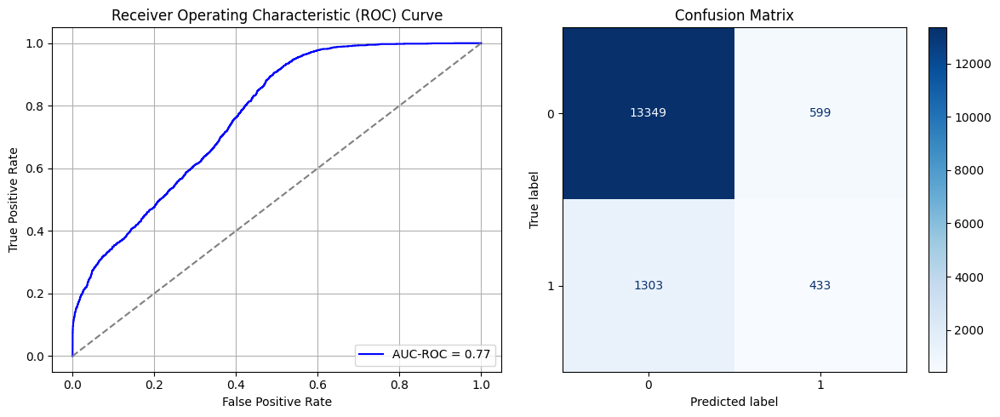

Best threshold based on F1-score: 0.4106982946395874
False Negative Rate: 0.7505760368663594
Time elapsed (performance): 1.1933797790006793
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7236 - loss: 0.6192 - val_AUC: 0.8544 - val_loss: 0.4804
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8465 - loss: 0.4828 - val_AUC: 0.8751 - val_loss: 0.4404
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4523 - val_AUC: 0.8768 - val_loss: 0.4356
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4455 - val_AUC: 0.8790 - val_loss: 0.4325
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8775 - loss: 0.4327 - val_AUC: 0.8792 - val_loss: 0.4317
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 - loss: 0.4301 - val_AUC: 0.8807 - val_loss: 0.4330
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4380 - val_AUC: 0.8802 - val_loss: 0.4305
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4408 - val_AUC: 0.8805 - val_loss: 0.4286
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 -

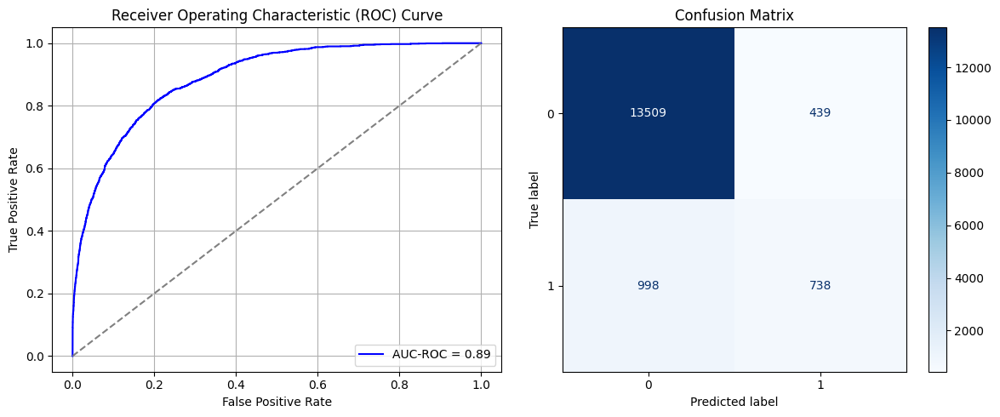

Best threshold based on F1-score: 0.3838362395763397
False Negative Rate: 0.5748847926267281
Time elapsed (performance): 1.1955719649995444
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7197 - loss: 0.6213 - val_AUC: 0.8548 - val_loss: 0.4886
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8554 - loss: 0.4723 - val_AUC: 0.8770 - val_loss: 0.4573
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8680 - loss: 0.4478 - val_AUC: 0.8817 - val_loss: 0.4294
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4435 - val_AUC: 0.8832 - val_loss: 0.4253
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4400 - val_AUC: 0.8840 - val_loss: 0.4243
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8710 - loss: 0.4423 - val_AUC: 0.8855 - val_loss: 0.4202
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8701 - loss: 0.4443 - val_AUC: 0.8855 - val_loss: 0.4201
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8744 - loss: 0.4390 - val_AUC: 0.8852 - val_loss: 0.4307
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 -

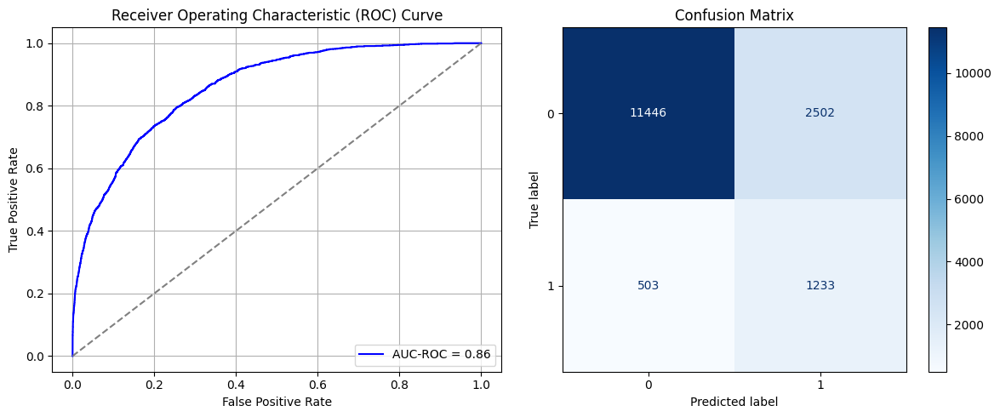

Best threshold based on F1-score: 0.7224551439285278
False Negative Rate: 0.2897465437788018
Time elapsed (performance): 1.6759572990004017
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7283 - loss: 0.6099 - val_AUC: 0.8559 - val_loss: 0.4878
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8597 - loss: 0.4667 - val_AUC: 0.8709 - val_loss: 0.4550
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8714 - loss: 0.4444 - val_AUC: 0.8743 - val_loss: 0.4411
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4382 - val_AUC: 0.8751 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4261 - val_AUC: 0.8764 - val_loss: 0.4348
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 - loss: 0.4225 - val_AUC: 0.8758 - val_loss: 0.4357
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8804 - loss: 0.4289 - val_AUC: 0.8773 - val_loss: 0.4326
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4377 - val_AUC: 0.8767 - val_loss: 0.4361
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 -

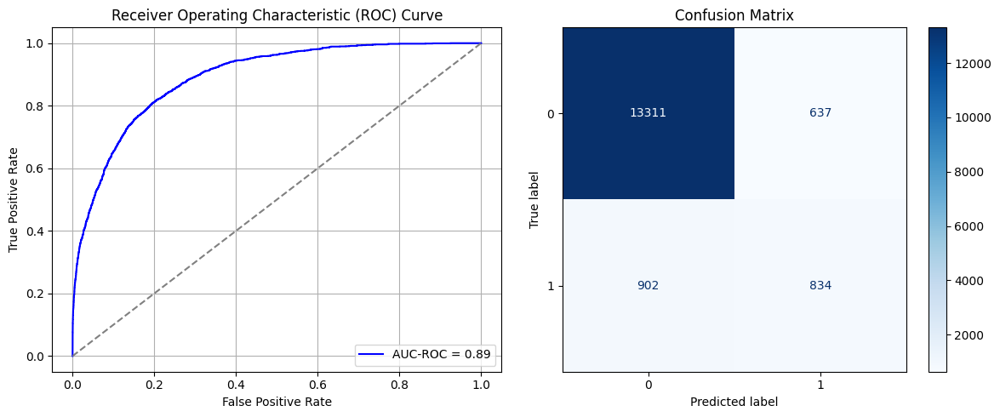

Best threshold based on F1-score: 0.3942212462425232
False Negative Rate: 0.5195852534562212
Time elapsed (performance): 1.7891014460001315
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7554 - loss: 0.6054 - val_AUC: 0.8739 - val_loss: 0.4599
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8654 - loss: 0.4582 - val_AUC: 0.8838 - val_loss: 0.4353
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8774 - loss: 0.4355 - val_AUC: 0.8844 - val_loss: 0.4283
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8773 - loss: 0.4337 - val_AUC: 0.8844 - val_loss: 0.4293
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.4411 - val_AUC: 0.8857 - val_loss: 0.4277
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8757 - loss: 0.4358 - val_AUC: 0.8854 - val_loss: 0.4541
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8782 - loss: 0.4328 - val_AUC: 0.8868 - val_loss: 0.4222
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8846 - loss: 0.4214 - val_AUC: 0.8869 - val_loss: 0.4265
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 -

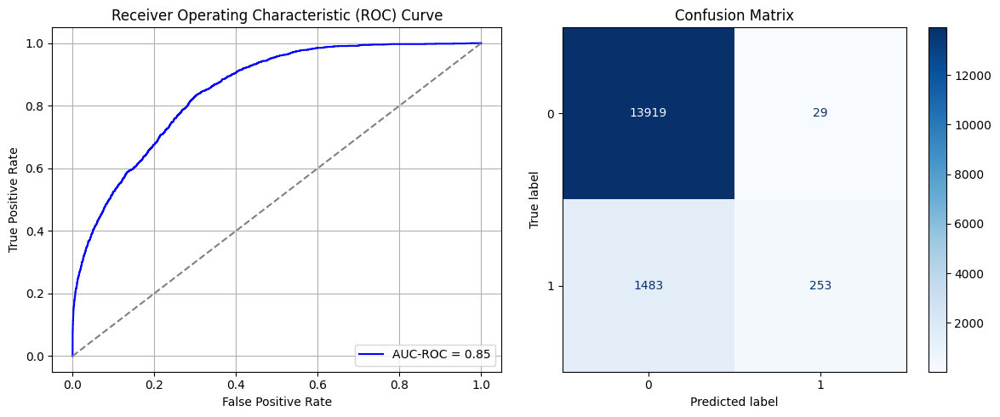

Best threshold based on F1-score: 0.053133923560380936
False Negative Rate: 0.8542626728110599
Time elapsed (performance): 1.2780950719998145
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7358 - loss: 0.6162 - val_AUC: 0.8571 - val_loss: 0.4831
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8632 - loss: 0.4602 - val_AUC: 0.8732 - val_loss: 0.4445
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4421 - val_AUC: 0.8752 - val_loss: 0.4403
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4400 - val_AUC: 0.8786 - val_loss: 0.4419
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4413 - val_AUC: 0.8795 - val_loss: 0.4312
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4273 - val_AUC: 0.8785 - val_loss: 0.4452
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8814 - loss: 0.4269 - val_AUC: 0.8802 - val_loss: 0.4276
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4349 - val_AUC: 0.8795 - val_loss: 0.4322
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8780 -

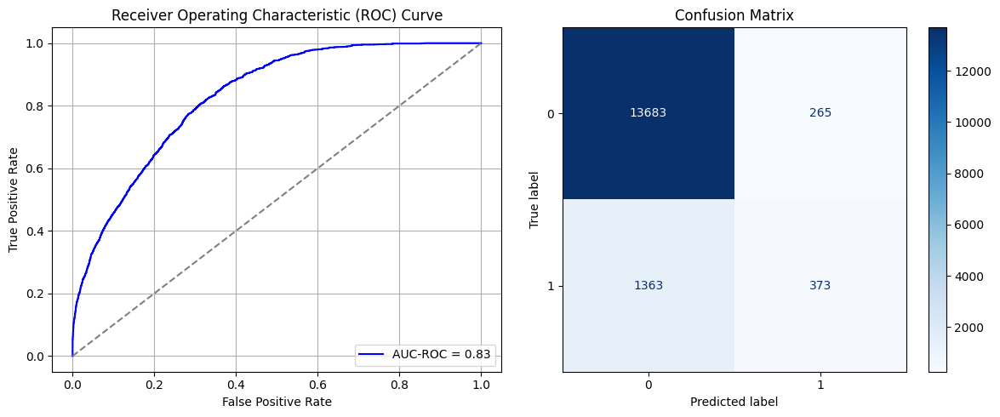

Best threshold based on F1-score: 0.22351820766925812
False Negative Rate: 0.7851382488479263
Time elapsed (performance): 1.2468401369997082
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7473 - loss: 0.6118 - val_AUC: 0.8474 - val_loss: 0.4928
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8553 - loss: 0.4708 - val_AUC: 0.8716 - val_loss: 0.4558
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8737 - loss: 0.4412 - val_AUC: 0.8720 - val_loss: 0.4525
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8679 - loss: 0.4467 - val_AUC: 0.8752 - val_loss: 0.4532
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4407 - val_AUC: 0.8766 - val_loss: 0.4365
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.4343 - val_AUC: 0.8773 - val_loss: 0.4356
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8826 - loss: 0.4258 - val_AUC: 0.8783 - val_loss: 0.4324
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4241 - val_AUC: 0.8765 - val_loss: 0.4352
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8772 -

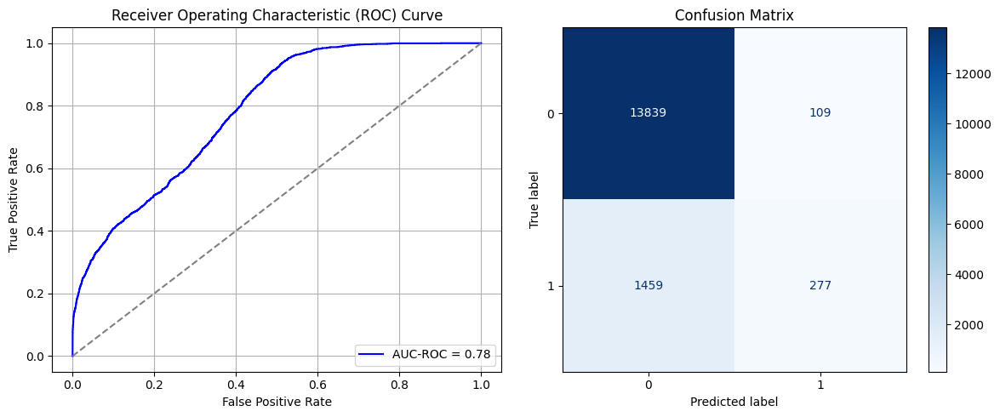

Best threshold based on F1-score: 0.2015116661787033
False Negative Rate: 0.8404377880184332
Time elapsed (performance): 1.6932853299995259
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7034 - loss: 0.6242 - val_AUC: 0.8579 - val_loss: 0.4733
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8620 - loss: 0.4638 - val_AUC: 0.8789 - val_loss: 0.4342
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4390 - val_AUC: 0.8839 - val_loss: 0.4253
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4346 - val_AUC: 0.8844 - val_loss: 0.4233
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4361 - val_AUC: 0.8844 - val_loss: 0.4233
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8805 - loss: 0.4293 - val_AUC: 0.8848 - val_loss: 0.4244
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8842 - loss: 0.4239 - val_AUC: 0.8853 - val_loss: 0.4276
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 - loss: 0.4275 - val_AUC: 0.8855 - val_loss: 0.4212
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8746 -

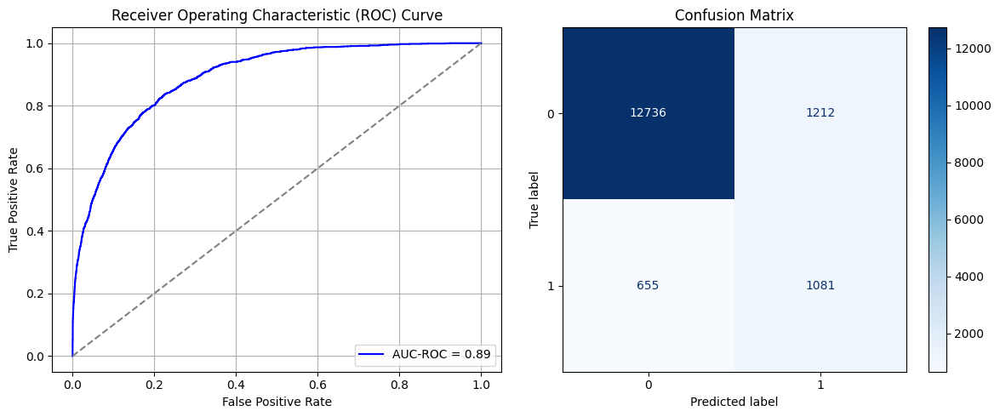

Best threshold based on F1-score: 0.4974244236946106
False Negative Rate: 0.3773041474654378
Time elapsed (performance): 1.7076914459994441
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7528 - loss: 0.6154 - val_AUC: 0.8552 - val_loss: 0.4802
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8532 - loss: 0.4769 - val_AUC: 0.8782 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8690 - loss: 0.4478 - val_AUC: 0.8802 - val_loss: 0.4369
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8689 - loss: 0.4473 - val_AUC: 0.8808 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.4332 - val_AUC: 0.8821 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4326 - val_AUC: 0.8828 - val_loss: 0.4282
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8748 - loss: 0.4367 - val_AUC: 0.8818 - val_loss: 0.4324
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4429 - val_AUC: 0.8825 - val_loss: 0.4273
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 -

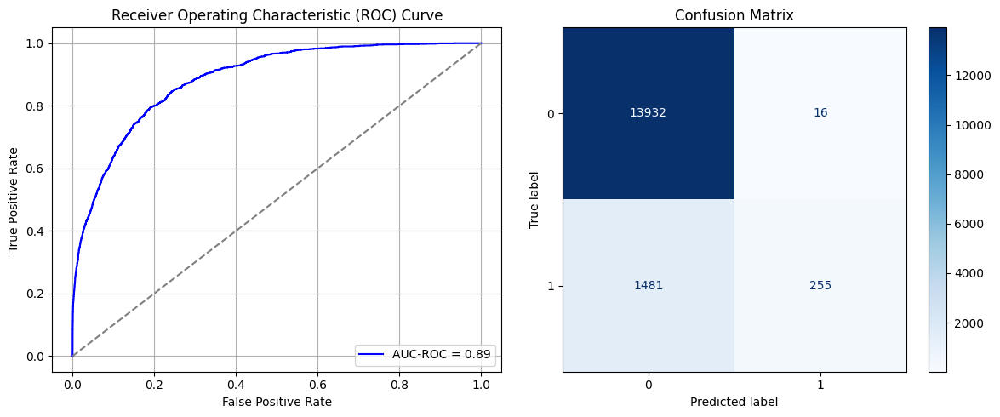

Best threshold based on F1-score: 0.054030388593673706
False Negative Rate: 0.853110599078341
Time elapsed (performance): 1.6968730919998052
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6611 - loss: 0.6394 - val_AUC: 0.8601 - val_loss: 0.4770
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8531 - loss: 0.4732 - val_AUC: 0.8787 - val_loss: 0.4353
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4415 - val_AUC: 0.8804 - val_loss: 0.4319
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8701 - loss: 0.4436 - val_AUC: 0.8796 - val_loss: 0.4385
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8686 - loss: 0.4470 - val_AUC: 0.8813 - val_loss: 0.4297
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 - loss: 0.4368 - val_AUC: 0.8816 - val_loss: 0.4276
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4318 - val_AUC: 0.8815 - val_loss: 0.4345
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4347 - val_AUC: 0.8833 - val_loss: 0.4246
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 -

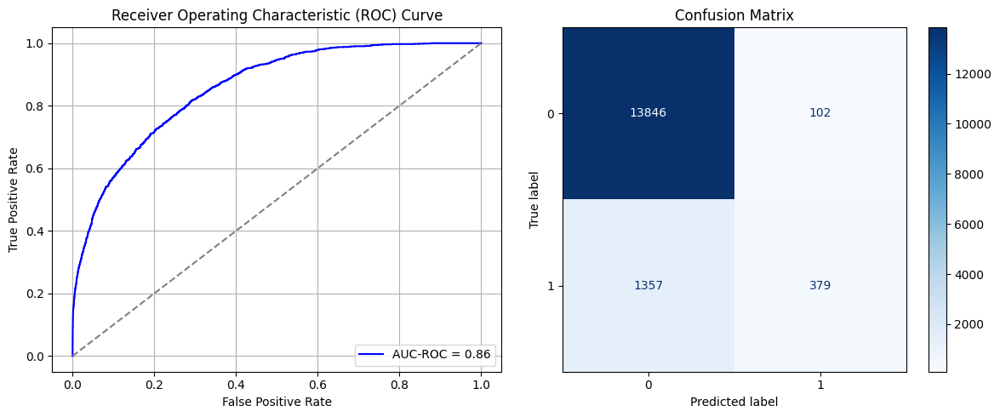

Best threshold based on F1-score: 0.21398890018463135
False Negative Rate: 0.7816820276497696
Time elapsed (performance): 1.265502722999372
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7570 - loss: 0.6096 - val_AUC: 0.8599 - val_loss: 0.4685
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8620 - loss: 0.4613 - val_AUC: 0.8730 - val_loss: 0.4483
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8707 - loss: 0.4433 - val_AUC: 0.8757 - val_loss: 0.4669
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4382 - val_AUC: 0.8762 - val_loss: 0.4377
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4326 - val_AUC: 0.8775 - val_loss: 0.4331
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 - loss: 0.4337 - val_AUC: 0.8767 - val_loss: 0.4395
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8766 - loss: 0.4334 - val_AUC: 0.8785 - val_loss: 0.4306
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4337 - val_AUC: 0.8782 - val_loss: 0.4358
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 -

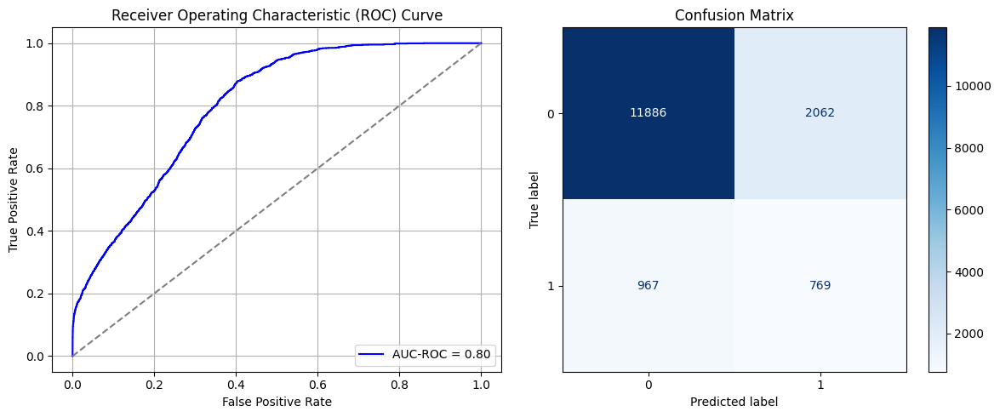

Best threshold based on F1-score: 0.23091208934783936
False Negative Rate: 0.5570276497695853
Time elapsed (performance): 1.7100260180004625
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7155 - loss: 0.6243 - val_AUC: 0.8542 - val_loss: 0.4787
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8556 - loss: 0.4698 - val_AUC: 0.8764 - val_loss: 0.4495
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4422 - val_AUC: 0.8779 - val_loss: 0.4385
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8765 - loss: 0.4353 - val_AUC: 0.8782 - val_loss: 0.4478
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8705 - loss: 0.4439 - val_AUC: 0.8797 - val_loss: 0.4309
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8693 - loss: 0.4457 - val_AUC: 0.8798 - val_loss: 0.4310
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 - loss: 0.4314 - val_AUC: 0.8799 - val_loss: 0.4322
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4358 - val_AUC: 0.8810 - val_loss: 0.4288
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8790 -

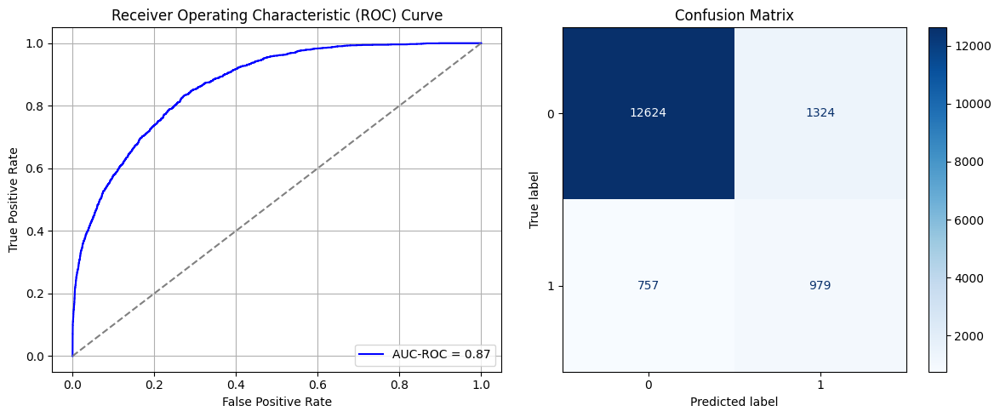

Best threshold based on F1-score: 0.5469397902488708
False Negative Rate: 0.43605990783410137
Time elapsed (performance): 1.7531595179998476
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7366 - loss: 0.6212 - val_AUC: 0.8544 - val_loss: 0.5089
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8612 - loss: 0.4640 - val_AUC: 0.8740 - val_loss: 0.4469
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8731 - loss: 0.4404 - val_AUC: 0.8794 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.4328 - val_AUC: 0.8811 - val_loss: 0.4311
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4328 - val_AUC: 0.8808 - val_loss: 0.4292
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8781 - loss: 0.4334 - val_AUC: 0.8826 - val_loss: 0.4309
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8821 - loss: 0.4262 - val_AUC: 0.8832 - val_loss: 0.4269
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4268 - val_AUC: 0.8822 - val_loss: 0.4265
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 -

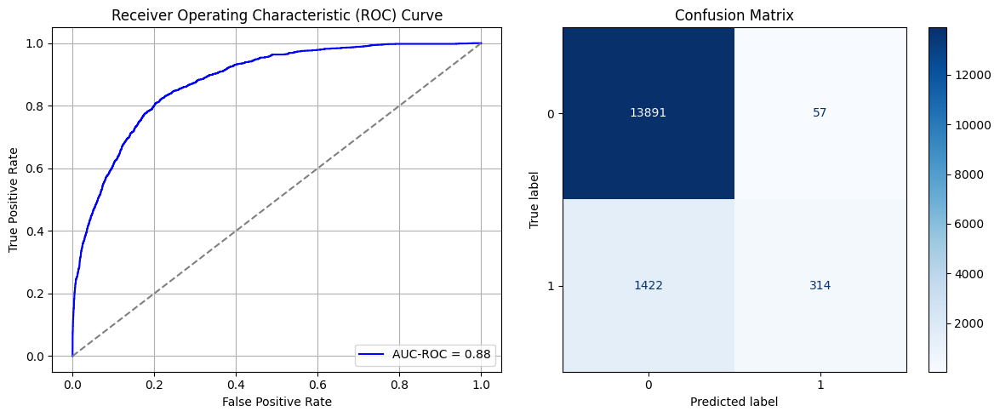

Best threshold based on F1-score: 0.11183464527130127
False Negative Rate: 0.8191244239631337
Time elapsed (performance): 1.8326766310001403
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7130 - loss: 0.6223 - val_AUC: 0.8578 - val_loss: 0.4721
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8619 - loss: 0.4623 - val_AUC: 0.8802 - val_loss: 0.4539
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8637 - loss: 0.4536 - val_AUC: 0.8818 - val_loss: 0.4271
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4360 - val_AUC: 0.8833 - val_loss: 0.4275
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4363 - val_AUC: 0.8821 - val_loss: 0.4261
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4270 - val_AUC: 0.8837 - val_loss: 0.4238
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8790 - loss: 0.4305 - val_AUC: 0.8837 - val_loss: 0.4235
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8834 - loss: 0.4228 - val_AUC: 0.8831 - val_loss: 0.4238
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 -

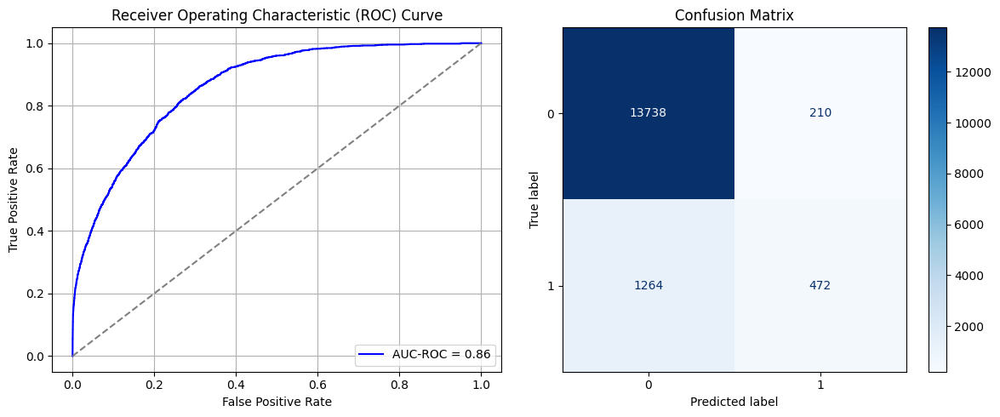

Best threshold based on F1-score: 0.26115715503692627
False Negative Rate: 0.728110599078341
Time elapsed (performance): 1.67349681900032
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7447 - loss: 0.6150 - val_AUC: 0.8609 - val_loss: 0.4679
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8563 - loss: 0.4679 - val_AUC: 0.8793 - val_loss: 0.4412
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8655 - loss: 0.4527 - val_AUC: 0.8805 - val_loss: 0.4298
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8680 - loss: 0.4458 - val_AUC: 0.8813 - val_loss: 0.4293
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8718 - loss: 0.4403 - val_AUC: 0.8821 - val_loss: 0.4279
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4342 - val_AUC: 0.8834 - val_loss: 0.4337
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8803 - loss: 0.4270 - val_AUC: 0.8857 - val_loss: 0.4216
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4315 - val_AUC: 0.8854 - val_loss: 0.4316
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 -

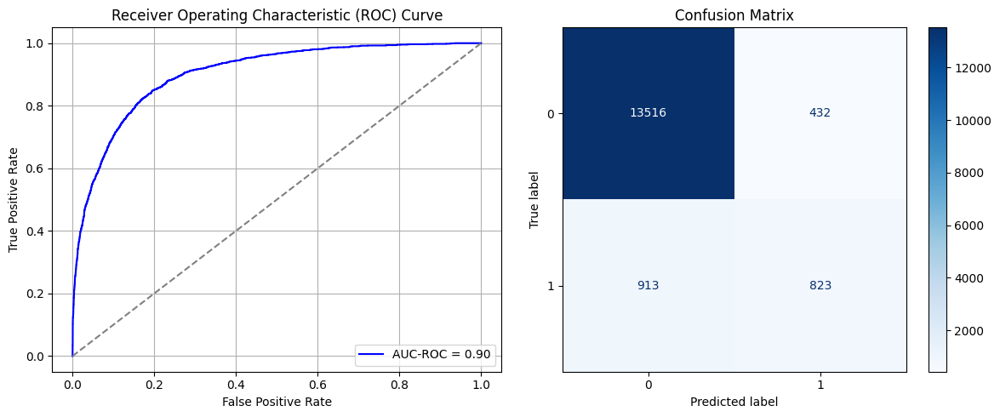

Best threshold based on F1-score: 0.4237077832221985
False Negative Rate: 0.5259216589861752
Time elapsed (performance): 1.271635795000293
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7286 - loss: 0.6215 - val_AUC: 0.8551 - val_loss: 0.4812
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8602 - loss: 0.4619 - val_AUC: 0.8710 - val_loss: 0.4479
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4433 - val_AUC: 0.8740 - val_loss: 0.4409
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8732 - loss: 0.4373 - val_AUC: 0.8737 - val_loss: 0.4409
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8803 - loss: 0.4260 - val_AUC: 0.8749 - val_loss: 0.4404
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8758 - loss: 0.4332 - val_AUC: 0.8754 - val_loss: 0.4381
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.4334 - val_AUC: 0.8750 - val_loss: 0.4395
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8766 - loss: 0.4324 - val_AUC: 0.8756 - val_loss: 0.4387
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8848 -

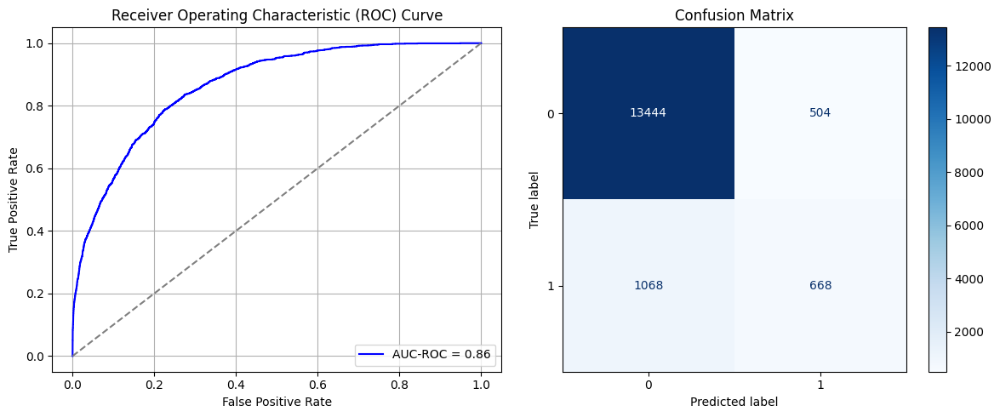

Best threshold based on F1-score: 0.3766031563282013
False Negative Rate: 0.6152073732718893
Time elapsed (performance): 1.8349576849996083
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7258 - loss: 0.6205 - val_AUC: 0.8447 - val_loss: 0.4922
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8535 - loss: 0.4748 - val_AUC: 0.8678 - val_loss: 0.4584
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8635 - loss: 0.4529 - val_AUC: 0.8698 - val_loss: 0.4472
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8688 - loss: 0.4448 - val_AUC: 0.8699 - val_loss: 0.4489
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4380 - val_AUC: 0.8692 - val_loss: 0.4453
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8707 - loss: 0.4427 - val_AUC: 0.8712 - val_loss: 0.4460
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4339 - val_AUC: 0.8715 - val_loss: 0.4425
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4324 - val_AUC: 0.8734 - val_loss: 0.4389
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8738 -

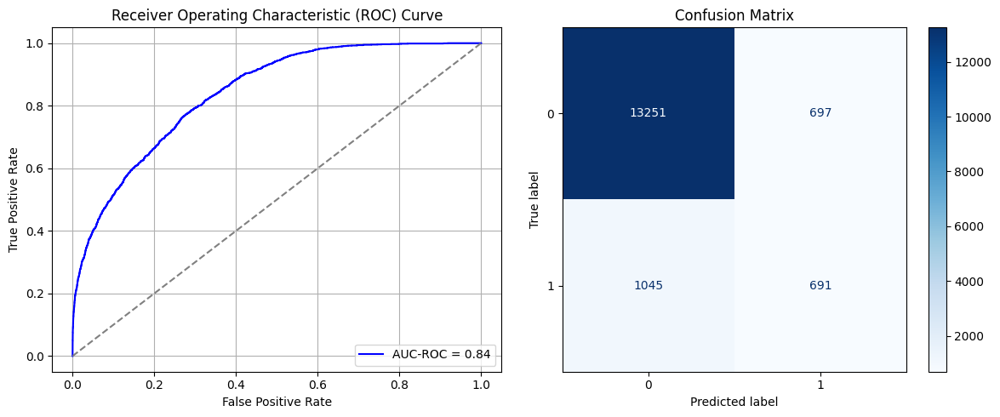

Best threshold based on F1-score: 0.42193740606307983
False Negative Rate: 0.6019585253456221
Time elapsed (performance): 1.3139950189997762
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7459 - loss: 0.6061 - val_AUC: 0.8549 - val_loss: 0.4826
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8667 - loss: 0.4535 - val_AUC: 0.8637 - val_loss: 0.4540
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8782 - loss: 0.4329 - val_AUC: 0.8684 - val_loss: 0.4542
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4373 - val_AUC: 0.8682 - val_loss: 0.4887
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8803 - loss: 0.4307 - val_AUC: 0.8689 - val_loss: 0.4478
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.4367 - val_AUC: 0.8700 - val_loss: 0.4501
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8760 - loss: 0.4336 - val_AUC: 0.8706 - val_loss: 0.4483
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4291 - val_AUC: 0.8705 - val_loss: 0.4680
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 -

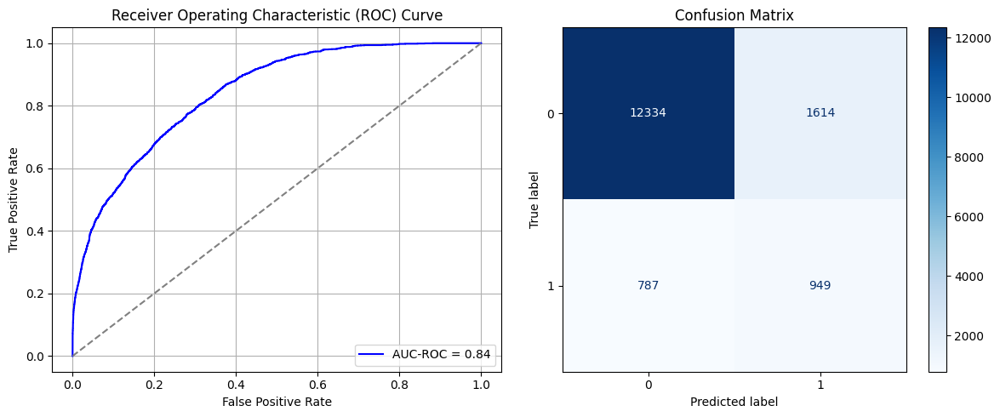

Best threshold based on F1-score: 0.5837612152099609
False Negative Rate: 0.4533410138248848
Time elapsed (performance): 1.3243018229995869
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7079 - loss: 0.6237 - val_AUC: 0.8549 - val_loss: 0.4809
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8631 - loss: 0.4616 - val_AUC: 0.8741 - val_loss: 0.4490
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8700 - loss: 0.4457 - val_AUC: 0.8772 - val_loss: 0.4391
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 - loss: 0.4308 - val_AUC: 0.8766 - val_loss: 0.4372
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4344 - val_AUC: 0.8768 - val_loss: 0.4407
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4323 - val_AUC: 0.8776 - val_loss: 0.4367
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4352 - val_AUC: 0.8759 - val_loss: 0.4426
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8771 - loss: 0.4325 - val_AUC: 0.8780 - val_loss: 0.4346
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 -

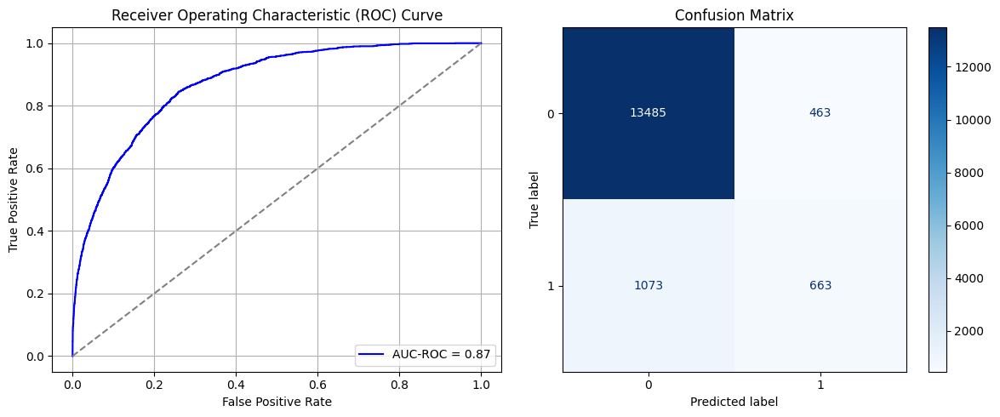

Best threshold based on F1-score: 0.2730697691440582
False Negative Rate: 0.6180875576036866
Time elapsed (performance): 1.3541921879996153
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7303 - loss: 0.6149 - val_AUC: 0.8581 - val_loss: 0.4787
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8607 - loss: 0.4628 - val_AUC: 0.8791 - val_loss: 0.4384
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4382 - val_AUC: 0.8830 - val_loss: 0.4295
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8792 - loss: 0.4314 - val_AUC: 0.8831 - val_loss: 0.4256
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8778 - loss: 0.4336 - val_AUC: 0.8839 - val_loss: 0.4275
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8820 - loss: 0.4256 - val_AUC: 0.8843 - val_loss: 0.4252
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8808 - loss: 0.4272 - val_AUC: 0.8850 - val_loss: 0.4273
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8744 - loss: 0.4389 - val_AUC: 0.8862 - val_loss: 0.4234
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8842 -

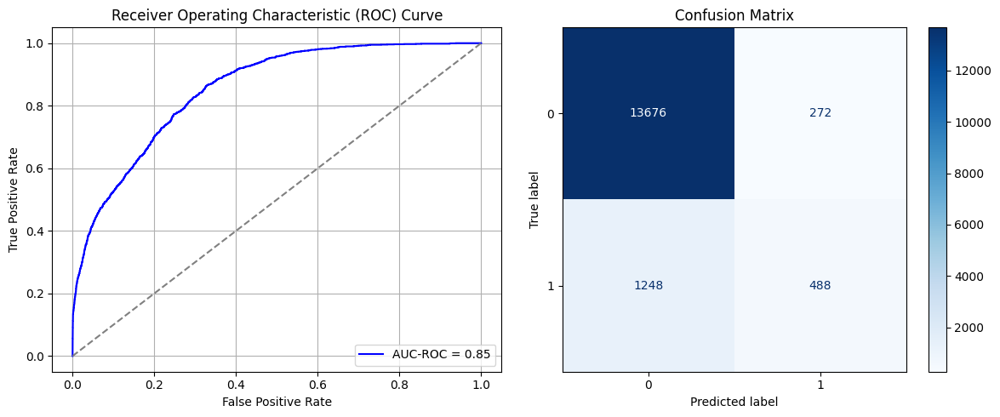

Best threshold based on F1-score: 0.34918901324272156
False Negative Rate: 0.7188940092165899
Time elapsed (performance): 1.3812287750006362
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7427 - loss: 0.6179 - val_AUC: 0.8428 - val_loss: 0.4971
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8519 - loss: 0.4784 - val_AUC: 0.8729 - val_loss: 0.4419
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8723 - loss: 0.4439 - val_AUC: 0.8777 - val_loss: 0.4341
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4330 - val_AUC: 0.8802 - val_loss: 0.4307
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4404 - val_AUC: 0.8804 - val_loss: 0.4305
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8759 - loss: 0.4343 - val_AUC: 0.8786 - val_loss: 0.4324
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 - loss: 0.4343 - val_AUC: 0.8806 - val_loss: 0.4302
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4292 - val_AUC: 0.8807 - val_loss: 0.4282
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8775 -

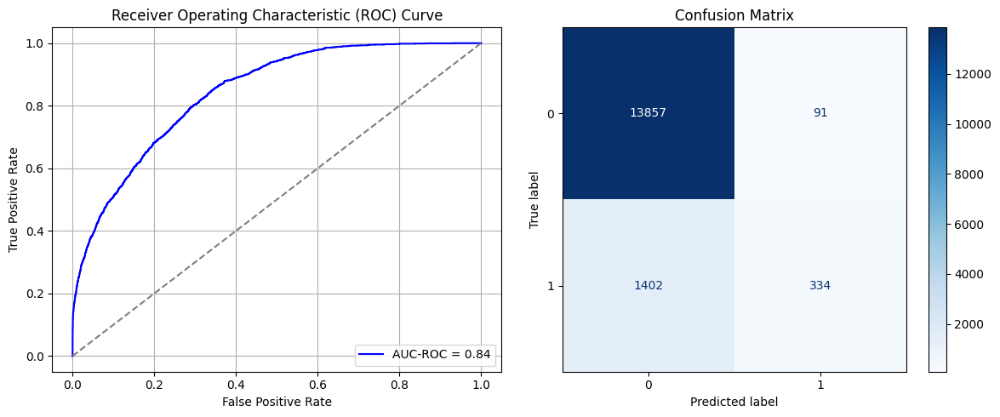

Best threshold based on F1-score: 0.14536063373088837
False Negative Rate: 0.8076036866359447
Time elapsed (performance): 1.698718321999877
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7247 - loss: 0.6124 - val_AUC: 0.8690 - val_loss: 0.4713
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8612 - loss: 0.4629 - val_AUC: 0.8811 - val_loss: 0.4341
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8735 - loss: 0.4398 - val_AUC: 0.8806 - val_loss: 0.4306
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8716 - loss: 0.4432 - val_AUC: 0.8823 - val_loss: 0.4278
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4353 - val_AUC: 0.8818 - val_loss: 0.4283
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8824 - loss: 0.4254 - val_AUC: 0.8841 - val_loss: 0.4239
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 - loss: 0.4362 - val_AUC: 0.8848 - val_loss: 0.4228
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4306 - val_AUC: 0.8842 - val_loss: 0.4320
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 -

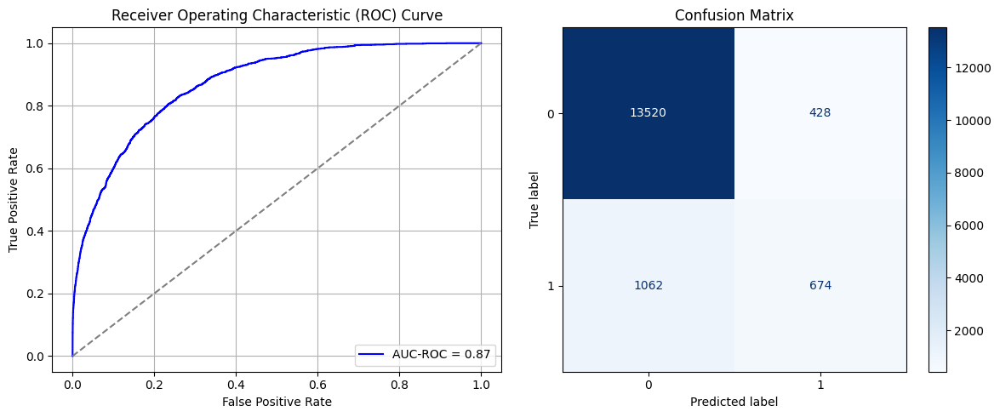

Best threshold based on F1-score: 0.36211657524108887
False Negative Rate: 0.6117511520737328
Time elapsed (performance): 1.6654649579995748
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7457 - loss: 0.6166 - val_AUC: 0.8583 - val_loss: 0.4815
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8570 - loss: 0.4694 - val_AUC: 0.8762 - val_loss: 0.4433
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8670 - loss: 0.4482 - val_AUC: 0.8785 - val_loss: 0.4452
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8716 - loss: 0.4437 - val_AUC: 0.8796 - val_loss: 0.4319
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4356 - val_AUC: 0.8806 - val_loss: 0.4326
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4301 - val_AUC: 0.8811 - val_loss: 0.4284
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8803 - loss: 0.4274 - val_AUC: 0.8807 - val_loss: 0.4285
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4358 - val_AUC: 0.8810 - val_loss: 0.4286
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 -

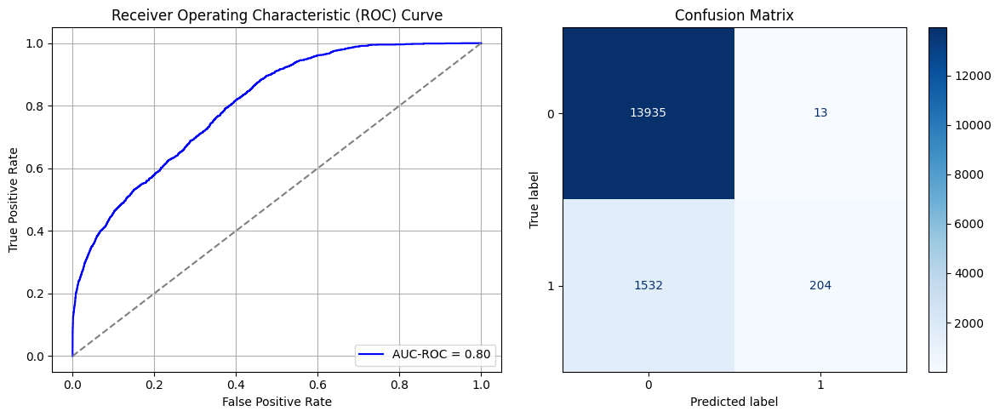

Best threshold based on F1-score: 0.040538277477025986
False Negative Rate: 0.8824884792626728
Time elapsed (performance): 1.3655609659999755
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7428 - loss: 0.6160 - val_AUC: 0.8646 - val_loss: 0.4770
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8630 - loss: 0.4598 - val_AUC: 0.8799 - val_loss: 0.4425
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8688 - loss: 0.4469 - val_AUC: 0.8825 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8728 - loss: 0.4409 - val_AUC: 0.8826 - val_loss: 0.4329
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8738 - loss: 0.4398 - val_AUC: 0.8850 - val_loss: 0.4250
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8707 - loss: 0.4434 - val_AUC: 0.8850 - val_loss: 0.4216
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4403 - val_AUC: 0.8849 - val_loss: 0.4257
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.4318 - val_AUC: 0.8856 - val_loss: 0.4217
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8745 -

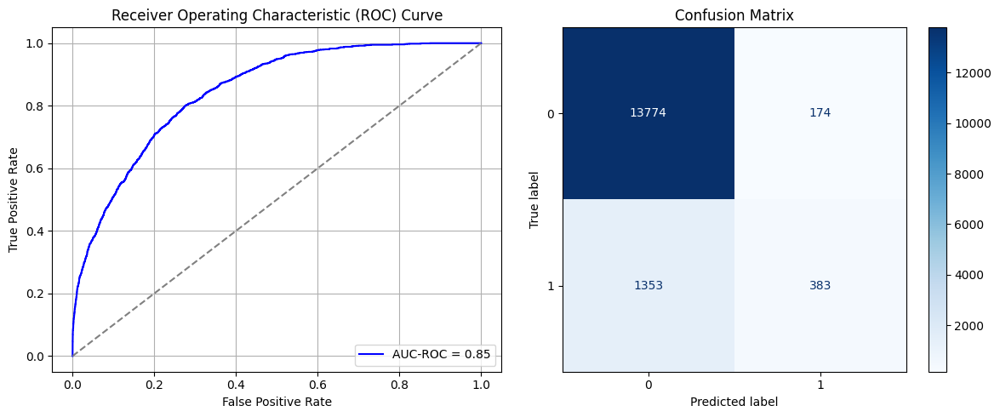

Best threshold based on F1-score: 0.1393880397081375
False Negative Rate: 0.7793778801843319
Time elapsed (performance): 1.696682552999846
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7584 - loss: 0.6035 - val_AUC: 0.8550 - val_loss: 0.4777
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8626 - loss: 0.4600 - val_AUC: 0.8682 - val_loss: 0.4497
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.4387 - val_AUC: 0.8718 - val_loss: 0.4462
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4445 - val_AUC: 0.8729 - val_loss: 0.4437
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8758 - loss: 0.4340 - val_AUC: 0.8745 - val_loss: 0.4366
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8781 - loss: 0.4301 - val_AUC: 0.8733 - val_loss: 0.4412
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8844 - loss: 0.4192 - val_AUC: 0.8747 - val_loss: 0.4417
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8854 - loss: 0.4215 - val_AUC: 0.8739 - val_loss: 0.4407
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 -

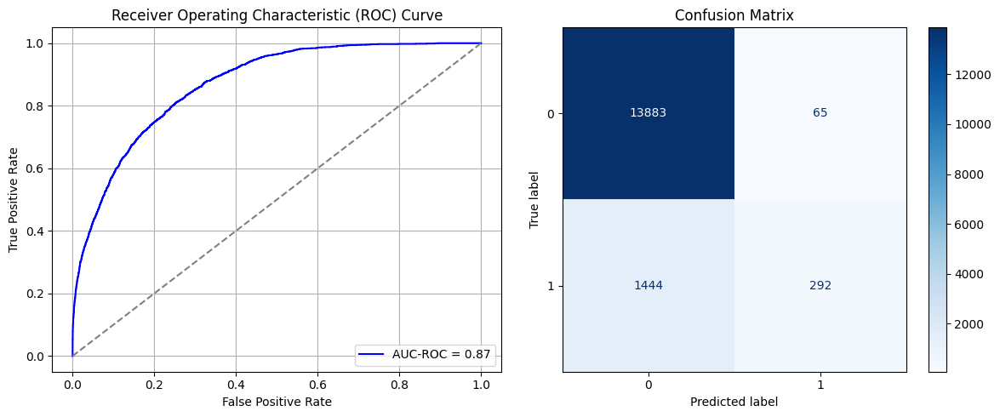

Best threshold based on F1-score: 0.09212770313024521
False Negative Rate: 0.8317972350230415
Time elapsed (performance): 2.99478679799995
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7354 - loss: 0.6160 - val_AUC: 0.8509 - val_loss: 0.4959
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8592 - loss: 0.4659 - val_AUC: 0.8756 - val_loss: 0.4397
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.4395 - val_AUC: 0.8786 - val_loss: 0.4332
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8754 - loss: 0.4365 - val_AUC: 0.8799 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8782 - loss: 0.4314 - val_AUC: 0.8797 - val_loss: 0.4308
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8768 - loss: 0.4321 - val_AUC: 0.8810 - val_loss: 0.4305
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4305 - val_AUC: 0.8815 - val_loss: 0.4334
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4248 - val_AUC: 0.8817 - val_loss: 0.4279
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8823 -

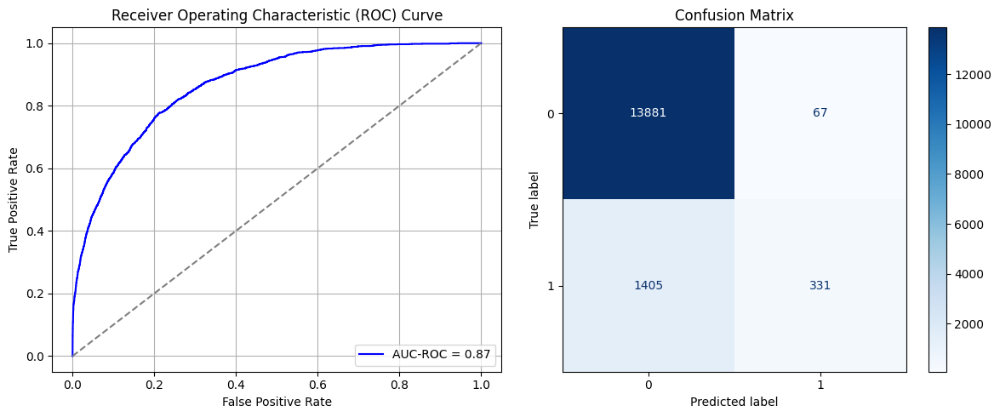

Best threshold based on F1-score: 0.13707314431667328
False Negative Rate: 0.809331797235023
Time elapsed (performance): 3.548867283000618
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7353 - loss: 0.6106 - val_AUC: 0.8539 - val_loss: 0.5087
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8594 - loss: 0.4672 - val_AUC: 0.8711 - val_loss: 0.4517
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8715 - loss: 0.4432 - val_AUC: 0.8749 - val_loss: 0.4447
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8765 - loss: 0.4332 - val_AUC: 0.8754 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8799 - loss: 0.4308 - val_AUC: 0.8762 - val_loss: 0.4669
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8711 - loss: 0.4426 - val_AUC: 0.8764 - val_loss: 0.4449
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8833 - loss: 0.4247 - val_AUC: 0.8776 - val_loss: 0.4397
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4339 - val_AUC: 0.8772 - val_loss: 0.4409
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8801 -

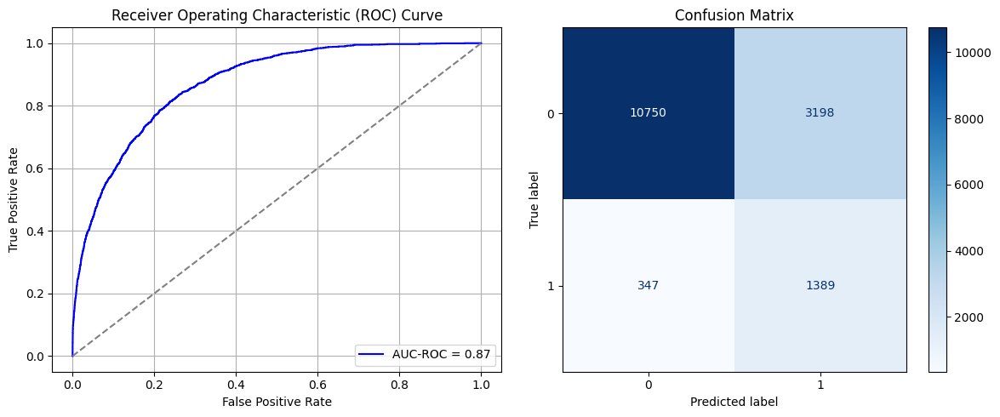

Best threshold based on F1-score: 0.6772682070732117
False Negative Rate: 0.19988479262672812
Time elapsed (performance): 1.41250668199973
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7452 - loss: 0.6104 - val_AUC: 0.8692 - val_loss: 0.4624
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8633 - loss: 0.4587 - val_AUC: 0.8808 - val_loss: 0.4319
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8670 - loss: 0.4503 - val_AUC: 0.8827 - val_loss: 0.4273
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 - loss: 0.4458 - val_AUC: 0.8832 - val_loss: 0.4265
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8770 - loss: 0.4324 - val_AUC: 0.8846 - val_loss: 0.4248
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4311 - val_AUC: 0.8835 - val_loss: 0.4297
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8792 - loss: 0.4315 - val_AUC: 0.8837 - val_loss: 0.4307
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8843 - val_loss: 0.4243
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 -

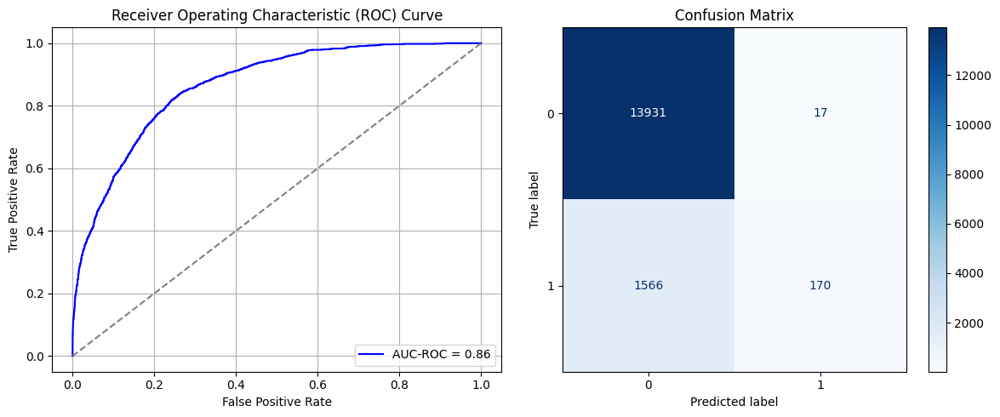

Best threshold based on F1-score: 0.033703748136758804
False Negative Rate: 0.902073732718894
Time elapsed (performance): 1.424087409999629
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7406 - loss: 0.6146 - val_AUC: 0.8553 - val_loss: 0.4788
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8519 - loss: 0.4734 - val_AUC: 0.8717 - val_loss: 0.4477
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8684 - loss: 0.4465 - val_AUC: 0.8748 - val_loss: 0.4415
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.4376 - val_AUC: 0.8769 - val_loss: 0.4370
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8712 - loss: 0.4398 - val_AUC: 0.8776 - val_loss: 0.4435
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4366 - val_AUC: 0.8780 - val_loss: 0.4518
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4414 - val_AUC: 0.8786 - val_loss: 0.4340
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8758 - loss: 0.4351 - val_AUC: 0.8797 - val_loss: 0.4378
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 -

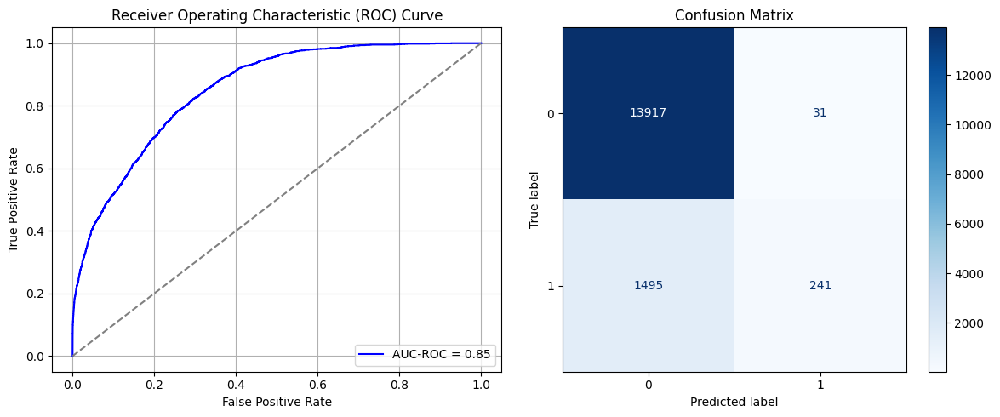

Best threshold based on F1-score: 0.122739776968956
False Negative Rate: 0.8611751152073732
Time elapsed (performance): 1.8697214409994558
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7169 - loss: 0.6158 - val_AUC: 0.8563 - val_loss: 0.4770
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8690 - loss: 0.4506 - val_AUC: 0.8676 - val_loss: 0.4542
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4354 - val_AUC: 0.8705 - val_loss: 0.4486
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4331 - val_AUC: 0.8730 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8817 - loss: 0.4269 - val_AUC: 0.8709 - val_loss: 0.4449
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8840 - loss: 0.4231 - val_AUC: 0.8725 - val_loss: 0.4439
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8838 - loss: 0.4237 - val_AUC: 0.8735 - val_loss: 0.4444
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8814 - loss: 0.4254 - val_AUC: 0.8748 - val_loss: 0.4425
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8870 -

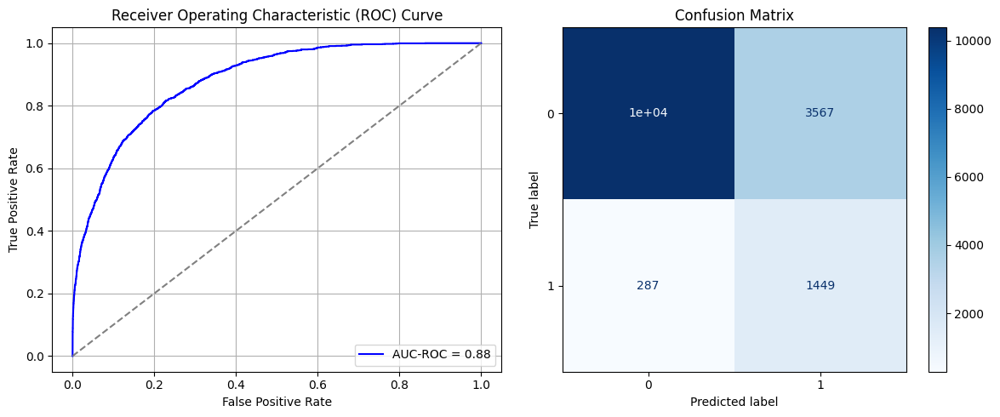

Best threshold based on F1-score: 0.727015495300293
False Negative Rate: 0.16532258064516128
Time elapsed (performance): 1.843207048000295
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7172 - loss: 0.6121 - val_AUC: 0.8602 - val_loss: 0.4768
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8510 - loss: 0.4770 - val_AUC: 0.8770 - val_loss: 0.4386
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8746 - loss: 0.4382 - val_AUC: 0.8792 - val_loss: 0.4346
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4408 - val_AUC: 0.8805 - val_loss: 0.4299
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8736 - loss: 0.4388 - val_AUC: 0.8805 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8788 - loss: 0.4296 - val_AUC: 0.8811 - val_loss: 0.4313
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4267 - val_AUC: 0.8806 - val_loss: 0.4323
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4340 - val_AUC: 0.8816 - val_loss: 0.4282
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8803 -

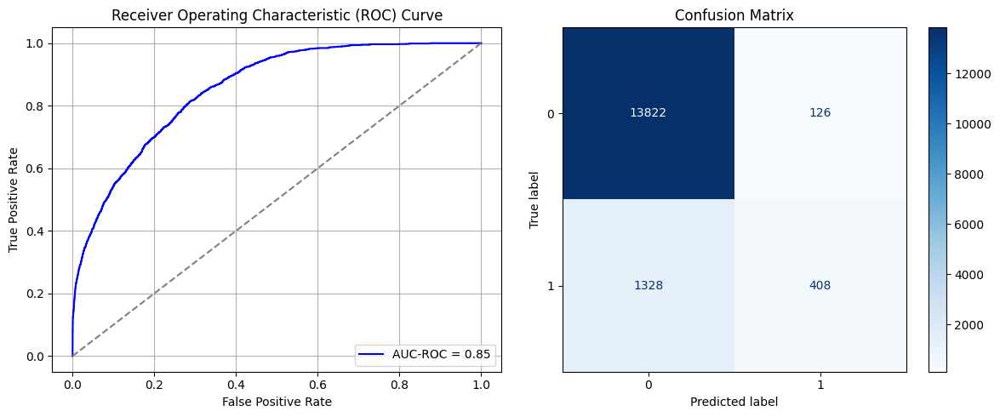

Best threshold based on F1-score: 0.20088669657707214
False Negative Rate: 0.7649769585253456
Time elapsed (performance): 1.9586184190002314
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7248 - loss: 0.6218 - val_AUC: 0.8564 - val_loss: 0.4765
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8633 - loss: 0.4604 - val_AUC: 0.8728 - val_loss: 0.4511
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4358 - val_AUC: 0.8764 - val_loss: 0.4562
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4387 - val_AUC: 0.8774 - val_loss: 0.4329
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8795 - loss: 0.4296 - val_AUC: 0.8774 - val_loss: 0.4344
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8792 - loss: 0.4286 - val_AUC: 0.8784 - val_loss: 0.4314
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4370 - val_AUC: 0.8782 - val_loss: 0.4318
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 - loss: 0.4322 - val_AUC: 0.8778 - val_loss: 0.4322
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8753 -

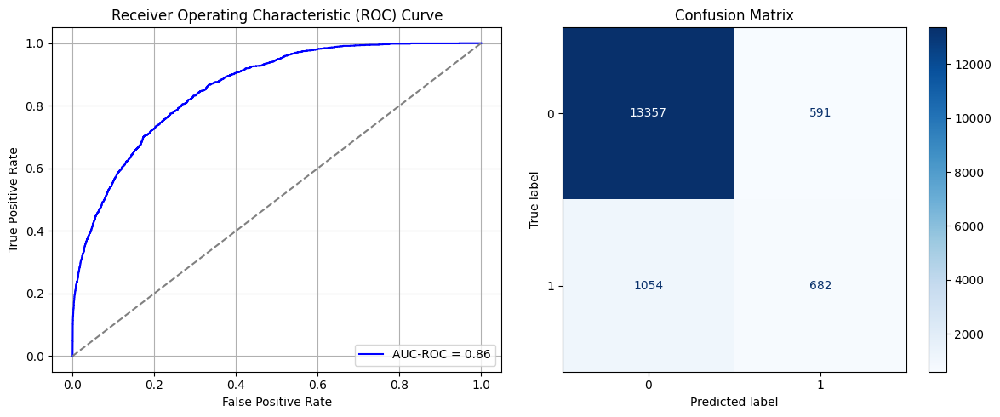

Best threshold based on F1-score: 0.38926956057548523
False Negative Rate: 0.6071428571428571
Time elapsed (performance): 1.7394542020001609
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7578 - loss: 0.6171 - val_AUC: 0.8613 - val_loss: 0.4674
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8566 - loss: 0.4696 - val_AUC: 0.8751 - val_loss: 0.4406
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8664 - loss: 0.4493 - val_AUC: 0.8791 - val_loss: 0.4338
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8725 - loss: 0.4415 - val_AUC: 0.8795 - val_loss: 0.4318
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8705 - loss: 0.4450 - val_AUC: 0.8811 - val_loss: 0.4314
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8740 - loss: 0.4400 - val_AUC: 0.8809 - val_loss: 0.4375
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4385 - val_AUC: 0.8810 - val_loss: 0.4533
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4370 - val_AUC: 0.8828 - val_loss: 0.4294
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 -

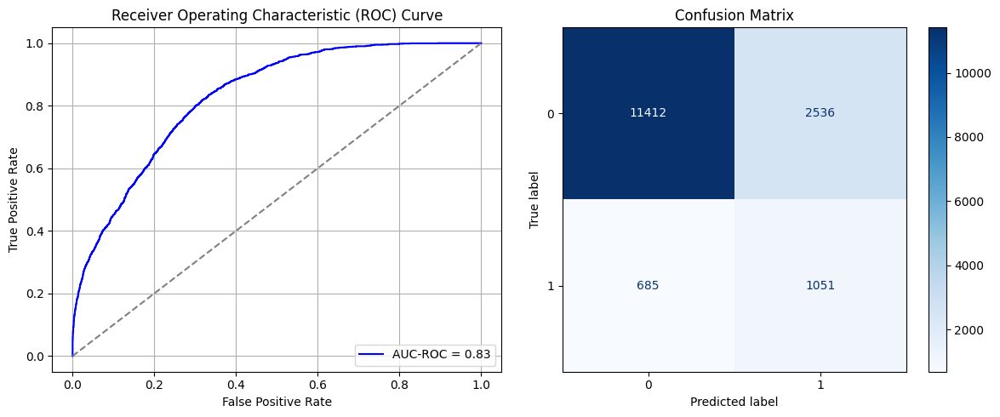

Best threshold based on F1-score: 0.5841435790061951
False Negative Rate: 0.3945852534562212
Time elapsed (performance): 1.863899224999841
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7271 - loss: 0.6229 - val_AUC: 0.8603 - val_loss: 0.4748
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8612 - loss: 0.4650 - val_AUC: 0.8734 - val_loss: 0.4535
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.4402 - val_AUC: 0.8777 - val_loss: 0.4505
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 - loss: 0.4271 - val_AUC: 0.8785 - val_loss: 0.4377
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4283 - val_AUC: 0.8782 - val_loss: 0.4321
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8807 - loss: 0.4285 - val_AUC: 0.8783 - val_loss: 0.4312
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4306 - val_AUC: 0.8779 - val_loss: 0.4326
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8760 - loss: 0.4342 - val_AUC: 0.8787 - val_loss: 0.4305
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8821 -

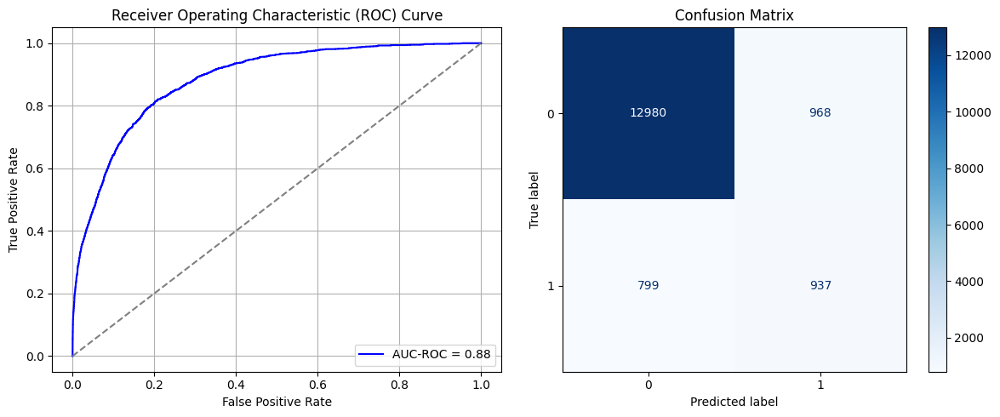

Best threshold based on F1-score: 0.4399004578590393
False Negative Rate: 0.4602534562211982
Time elapsed (performance): 3.006289088999438
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7330 - loss: 0.6209 - val_AUC: 0.8525 - val_loss: 0.4835
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8496 - loss: 0.4788 - val_AUC: 0.8770 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8654 - loss: 0.4508 - val_AUC: 0.8798 - val_loss: 0.4328
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8654 - loss: 0.4485 - val_AUC: 0.8809 - val_loss: 0.4314
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8727 - loss: 0.4406 - val_AUC: 0.8789 - val_loss: 0.4346
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8681 - loss: 0.4462 - val_AUC: 0.8819 - val_loss: 0.4283
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4358 - val_AUC: 0.8807 - val_loss: 0.4355
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4323 - val_AUC: 0.8809 - val_loss: 0.4353
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8701 -

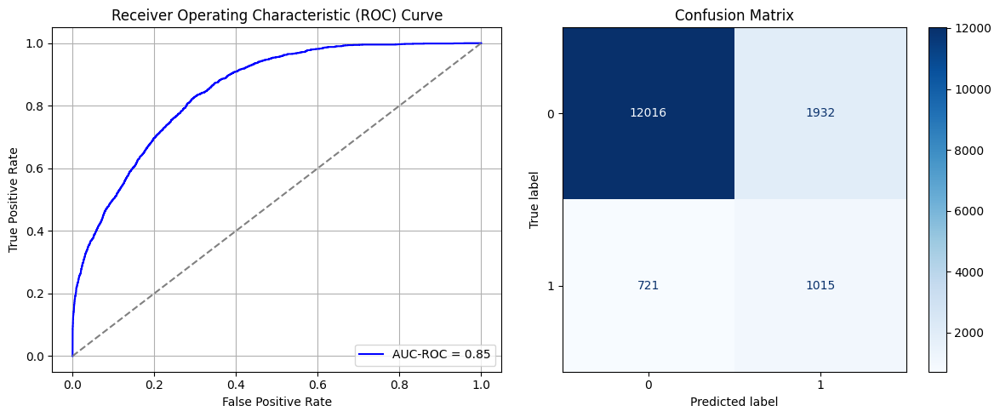

Best threshold based on F1-score: 0.6262450814247131
False Negative Rate: 0.4153225806451613
Time elapsed (performance): 1.9600084019994028
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7496 - loss: 0.6082 - val_AUC: 0.8550 - val_loss: 0.4816
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8581 - loss: 0.4651 - val_AUC: 0.8684 - val_loss: 0.4498
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8824 - loss: 0.4260 - val_AUC: 0.8725 - val_loss: 0.4415
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8774 - loss: 0.4317 - val_AUC: 0.8734 - val_loss: 0.4393
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8745 - loss: 0.4373 - val_AUC: 0.8728 - val_loss: 0.4457
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8730 - loss: 0.4385 - val_AUC: 0.8729 - val_loss: 0.4407
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4283 - val_AUC: 0.8740 - val_loss: 0.4396
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8823 - loss: 0.4243 - val_AUC: 0.8748 - val_loss: 0.4365
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8799 -

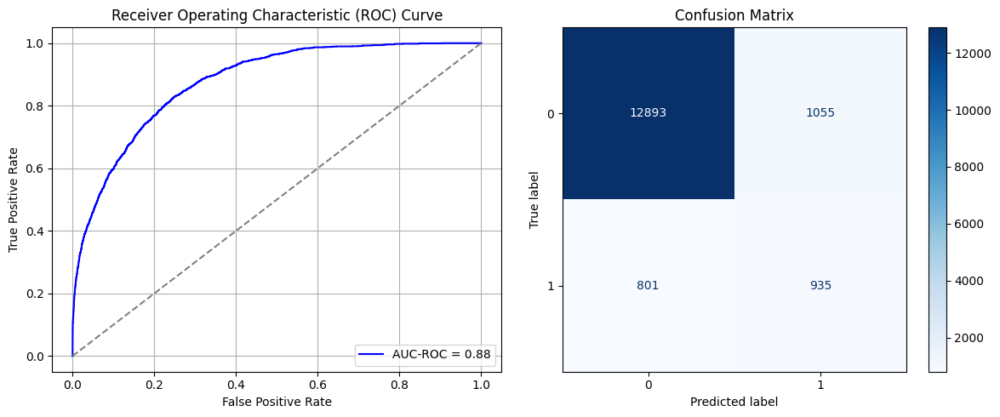

Best threshold based on F1-score: 0.4674549102783203
False Negative Rate: 0.46140552995391704
Time elapsed (performance): 2.0062425520000033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7296 - loss: 0.6079 - val_AUC: 0.8643 - val_loss: 0.4640
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8611 - loss: 0.4607 - val_AUC: 0.8760 - val_loss: 0.4380
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8688 - loss: 0.4462 - val_AUC: 0.8765 - val_loss: 0.4436
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8791 - loss: 0.4290 - val_AUC: 0.8768 - val_loss: 0.4335
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8783 - loss: 0.4300 - val_AUC: 0.8770 - val_loss: 0.4335
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8732 - loss: 0.4359 - val_AUC: 0.8793 - val_loss: 0.4298
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8819 - loss: 0.4233 - val_AUC: 0.8805 - val_loss: 0.4276
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8818 - loss: 0.4249 - val_AUC: 0.8806 - val_loss: 0.4336
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8821 -

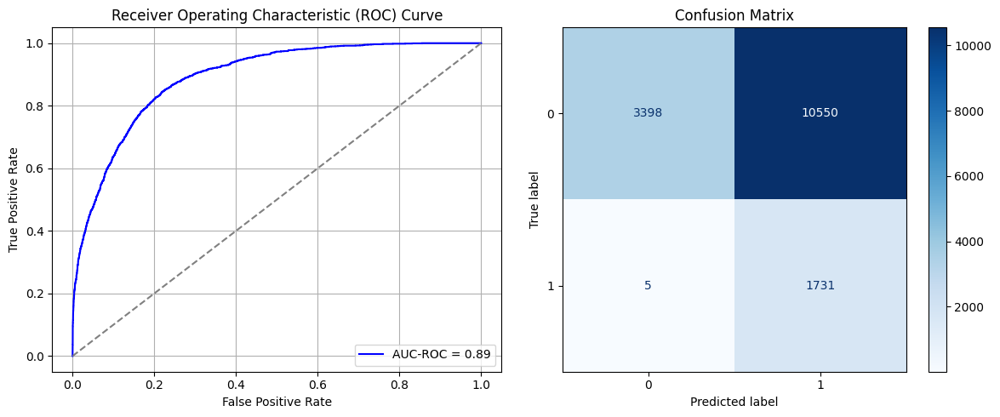

Best threshold based on F1-score: 0.919681191444397
False Negative Rate: 0.002880184331797235
Time elapsed (performance): 1.9105199710002125
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7395 - loss: 0.6189 - val_AUC: 0.8539 - val_loss: 0.4780
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8575 - loss: 0.4686 - val_AUC: 0.8716 - val_loss: 0.4499
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8732 - loss: 0.4408 - val_AUC: 0.8732 - val_loss: 0.4409
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8717 - loss: 0.4436 - val_AUC: 0.8735 - val_loss: 0.4454
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4399 - val_AUC: 0.8751 - val_loss: 0.4384
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8782 - loss: 0.4336 - val_AUC: 0.8739 - val_loss: 0.4428
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8838 - loss: 0.4220 - val_AUC: 0.8745 - val_loss: 0.4401
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 - loss: 0.4274 - val_AUC: 0.8753 - val_loss: 0.4380
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8810 -

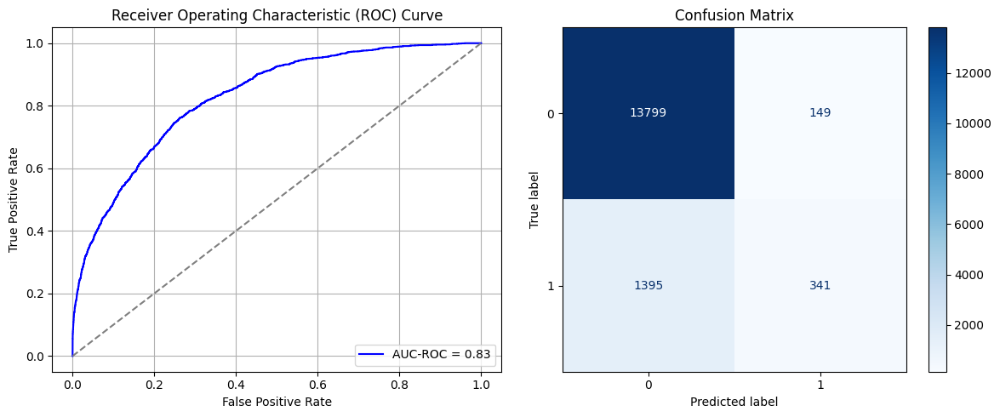

Best threshold based on F1-score: 0.21049024164676666
False Negative Rate: 0.8035714285714286
Time elapsed (performance): 2.087348658999872
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7542 - loss: 0.6101 - val_AUC: 0.8744 - val_loss: 0.4608
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8621 - loss: 0.4614 - val_AUC: 0.8834 - val_loss: 0.4290
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8655 - loss: 0.4527 - val_AUC: 0.8856 - val_loss: 0.4311
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8694 - loss: 0.4432 - val_AUC: 0.8860 - val_loss: 0.4204
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8725 - loss: 0.4406 - val_AUC: 0.8864 - val_loss: 0.4273
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4412 - val_AUC: 0.8878 - val_loss: 0.4184
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8808 - loss: 0.4267 - val_AUC: 0.8867 - val_loss: 0.4213
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8793 - loss: 0.4302 - val_AUC: 0.8880 - val_loss: 0.4195
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 -

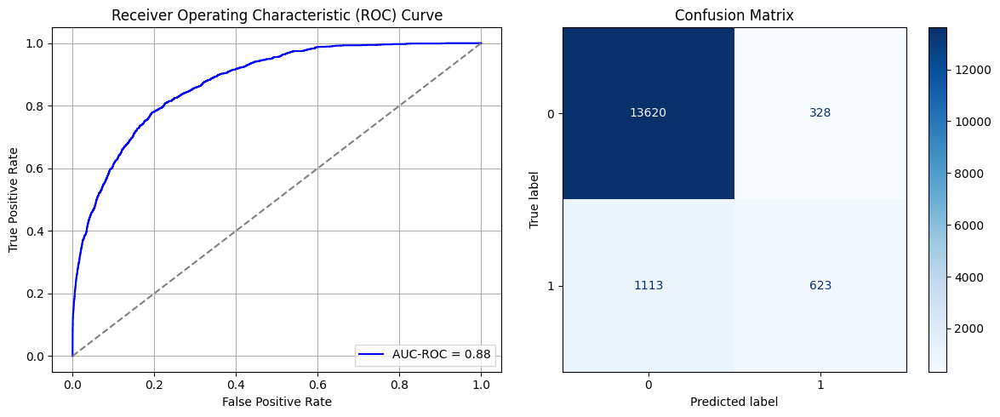

Best threshold based on F1-score: 0.2826182246208191
False Negative Rate: 0.6411290322580645
Time elapsed (performance): 1.45682700999987


In [92]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [93]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     18.703268  0.020433  0.979567  0.691820  0.308180     1.169816
1     15.576718  0.002007  0.997993  0.835253  0.164747     1.165941
2     18.464155  0.040436  0.959564  0.581797  0.418203     1.192375
3     17.129171  0.028248  0.971752  0.692396  0.307604     1.417715
4     15.696891  0.032836  0.967164  0.679724  0.320276     1.188315
5     15.237391  0.092486  0.907514  0.501728  0.498272     1.173727
6     15.731156  0.008962  0.991038  0.804147  0.195853     1.870310
7     14.908195  0.004660  0.995340  0.801843  0.198157     1.201876
8     16.532285  0.204761  0.795239  0.163594  0.836406     1.176748
9     17.436076  0.147046  0.852954  0.313940  0.686060     1.173118
10    16.752856  0.001577  0.998423  0.865207  0.134793     1.664515
11    18.075099  0.042945  0.957055  0.750576  0.249424     1.193380
12    16.903717  0.031474  0.968526  0.574885  0.425115     1.195572
13    20.634403  0.179381  0.82061

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

2.25721570627231
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7425 - loss: 0.6089 - val_AUC: 0.8531 - val_loss: 0.4738
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8685 - loss: 0.4540 - val_AUC: 0.8684 - val_loss: 0.4471
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4448 - val_AUC: 0.8692 - val_loss: 0.4475
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 - loss: 0.4386 - val_AUC: 0.8702 - val_loss: 0.4500
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8767 - loss: 0.4347 - val_AUC: 0.8674 - val_loss: 0.4482
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4355 - val_AUC: 0.8692 - val_loss: 0.4528
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8824 - loss: 0.4235 - val_AUC: 0.8713 - val_loss: 0.4458
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8790 - loss: 0.4309 - val_AUC: 0.8708 - val_loss: 0.4420
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 -

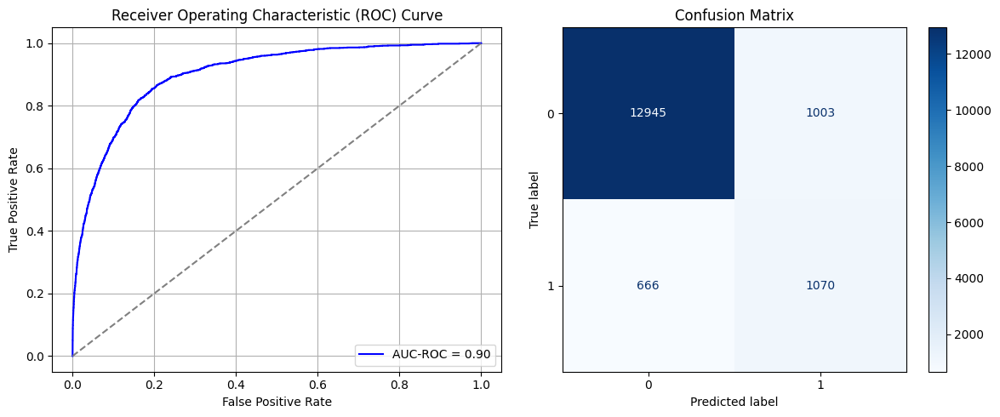

Best threshold based on F1-score: 0.5009704232215881
False Negative Rate: 0.3836405529953917
Time elapsed (performance): 1.132477733000087
(np.float64(0.07190995124749068), np.float64(0.9280900487525093))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7316 - loss: 0.6159 - val_AUC: 0.8467 - val_loss: 0.4801
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8630 - loss: 0.4610 - val_AUC: 0.8677 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4515 - val_AUC: 0.8678 - val_loss: 0.4509
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4396 - val_AUC: 0.8701 - val_loss: 0.4439
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8841 - loss: 0.4229 - val_AUC: 0.8715 - val_loss: 0.4468
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8742 - loss: 0.4377 - val_AUC: 0.8710 - val_loss: 0.4508
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8753 - loss: 0.4370 - val_AUC: 0.8723 - val_loss: 0.4445
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4351 - val_AUC: 0.8715 - val_loss: 0.4424
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 -

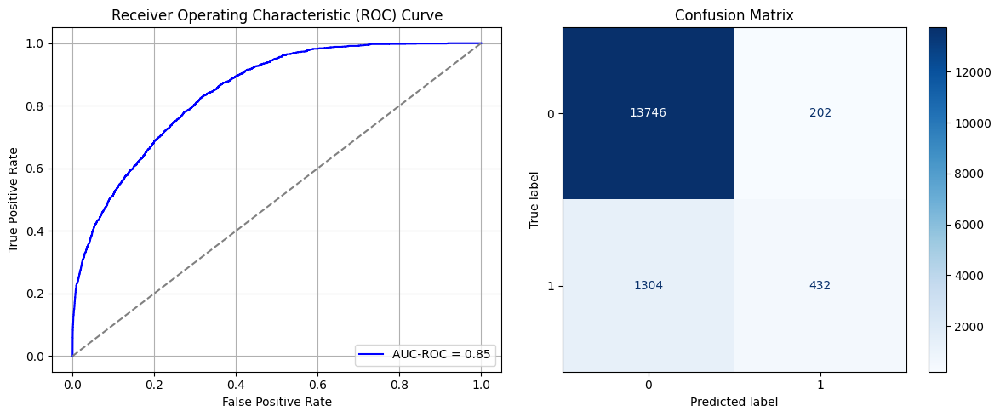

Best threshold based on F1-score: 0.2570670247077942
False Negative Rate: 0.7511520737327189
Time elapsed (performance): 1.1700544459999946
(np.float64(0.014482363062804704), np.float64(0.9855176369371953))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7200 - loss: 0.6197 - val_AUC: 0.8629 - val_loss: 0.4728
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8553 - loss: 0.4710 - val_AUC: 0.8770 - val_loss: 0.4420
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4378 - val_AUC: 0.8785 - val_loss: 0.4461
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8754 - loss: 0.4372 - val_AUC: 0.8798 - val_loss: 0.4305
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8712 - loss: 0.4425 - val_AUC: 0.8792 - val_loss: 0.4337
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4340 - val_AUC: 0.8792 - val_loss: 0.4301
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4400 - val_AUC: 0.8783 - val_loss: 0.4466
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4350 - val_AUC: 0.8794 - val_loss: 0.4304
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 -

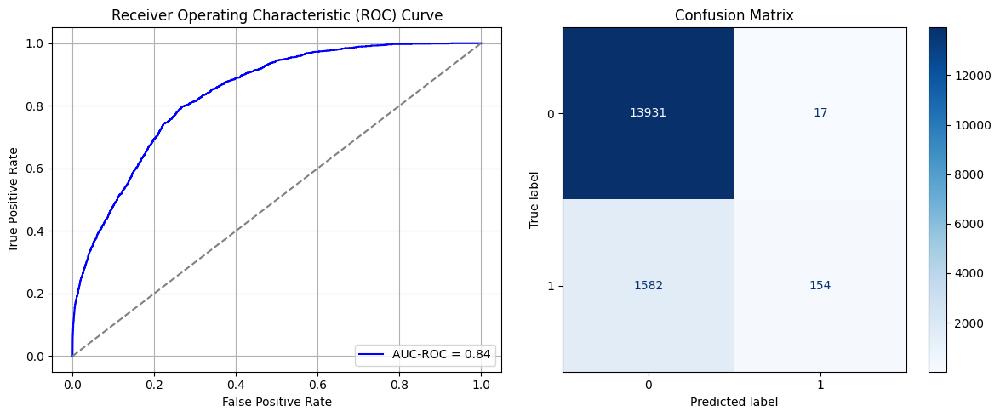

Best threshold based on F1-score: 0.025491729378700256
False Negative Rate: 0.9112903225806451
Time elapsed (performance): 1.826109658999485
(np.float64(0.0012188127330083167), np.float64(0.9987811872669917))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7426 - loss: 0.6213 - val_AUC: 0.8493 - val_loss: 0.4854
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8625 - loss: 0.4619 - val_AUC: 0.8685 - val_loss: 0.4483
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8715 - loss: 0.4434 - val_AUC: 0.8683 - val_loss: 0.4519
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8742 - loss: 0.4398 - val_AUC: 0.8696 - val_loss: 0.4467
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4325 - val_AUC: 0.8707 - val_loss: 0.4503
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8755 - loss: 0.4380 - val_AUC: 0.8710 - val_loss: 0.4423
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8796 - loss: 0.4272 - val_AUC: 0.8719 - val_loss: 0.4411
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4352 - val_AUC: 0.8716 - val_loss: 0.4415
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8822 -

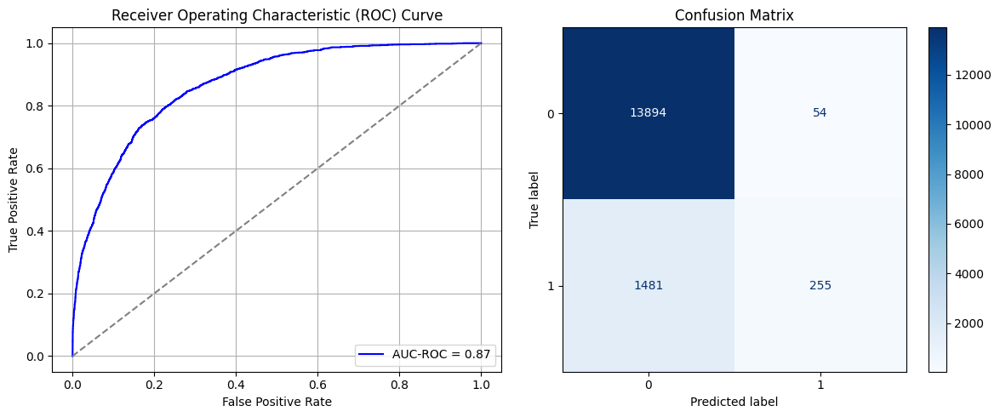

Best threshold based on F1-score: 0.11935900151729584
False Negative Rate: 0.853110599078341
Time elapsed (performance): 1.180530894000185
(np.float64(0.003871522798967594), np.float64(0.9961284772010324))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7377 - loss: 0.6168 - val_AUC: 0.8424 - val_loss: 0.5029
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8600 - loss: 0.4660 - val_AUC: 0.8654 - val_loss: 0.4692
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8720 - loss: 0.4441 - val_AUC: 0.8702 - val_loss: 0.4449
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4406 - val_AUC: 0.8688 - val_loss: 0.4465
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8711 - loss: 0.4416 - val_AUC: 0.8707 - val_loss: 0.4444
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8835 - loss: 0.4233 - val_AUC: 0.8707 - val_loss: 0.4439
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8701 - loss: 0.4452 - val_AUC: 0.8718 - val_loss: 0.4422
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4330 - val_AUC: 0.8723 - val_loss: 0.4406
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 -

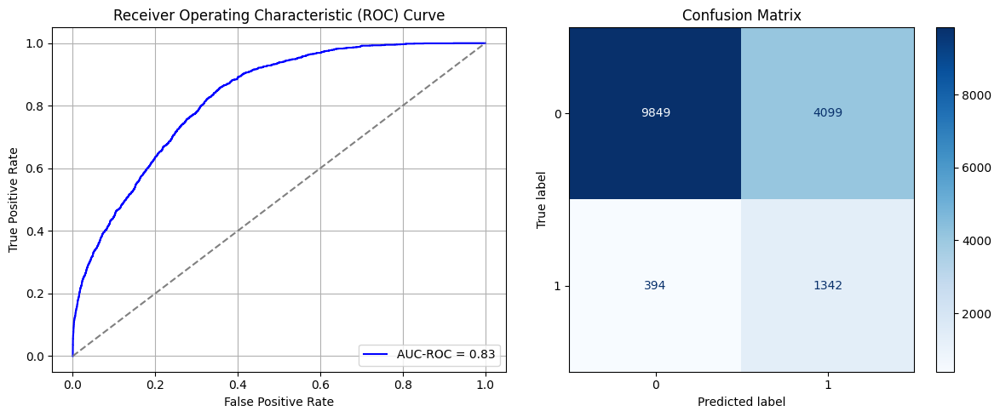

Best threshold based on F1-score: 0.7506974935531616
False Negative Rate: 0.2269585253456221
Time elapsed (performance): 1.6684094980000737
(np.float64(0.2938772583882994), np.float64(0.7061227416117006))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7460 - loss: 0.6150 - val_AUC: 0.8467 - val_loss: 0.4934
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8636 - loss: 0.4600 - val_AUC: 0.8663 - val_loss: 0.4519
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4372 - val_AUC: 0.8670 - val_loss: 0.4492
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4298 - val_AUC: 0.8723 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8806 - loss: 0.4283 - val_AUC: 0.8715 - val_loss: 0.4409
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8788 - loss: 0.4298 - val_AUC: 0.8720 - val_loss: 0.4407
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4335 - val_AUC: 0.8721 - val_loss: 0.4454
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8809 - loss: 0.4280 - val_AUC: 0.8734 - val_loss: 0.4425
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8808 -

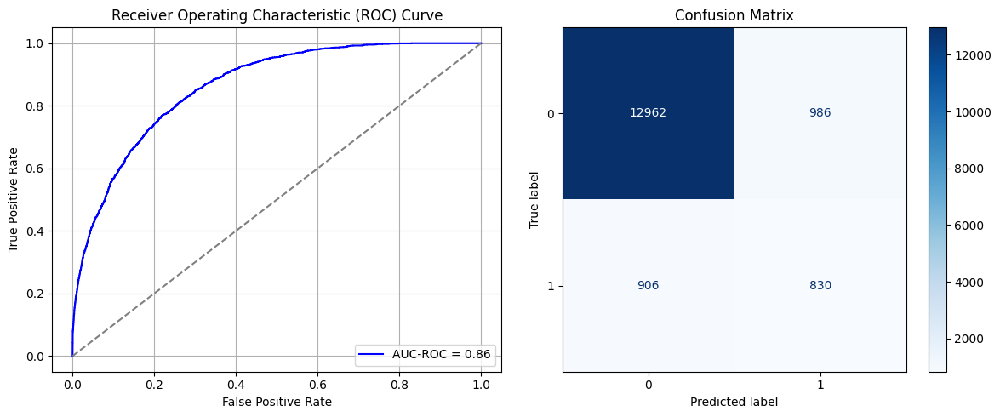

Best threshold based on F1-score: 0.4230969250202179
False Negative Rate: 0.521889400921659
Time elapsed (performance): 1.2137798869998733
(np.float64(0.07069113851448236), np.float64(0.9293088614855176))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7310 - loss: 0.6194 - val_AUC: 0.8490 - val_loss: 0.5076
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8606 - loss: 0.4662 - val_AUC: 0.8676 - val_loss: 0.4502
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8693 - loss: 0.4479 - val_AUC: 0.8678 - val_loss: 0.4495
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8741 - loss: 0.4405 - val_AUC: 0.8705 - val_loss: 0.4527
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8800 - loss: 0.4287 - val_AUC: 0.8705 - val_loss: 0.4590
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4318 - val_AUC: 0.8704 - val_loss: 0.4410
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4288 - val_AUC: 0.8713 - val_loss: 0.4413
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4265 - val_AUC: 0.8712 - val_loss: 0.4403
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 -

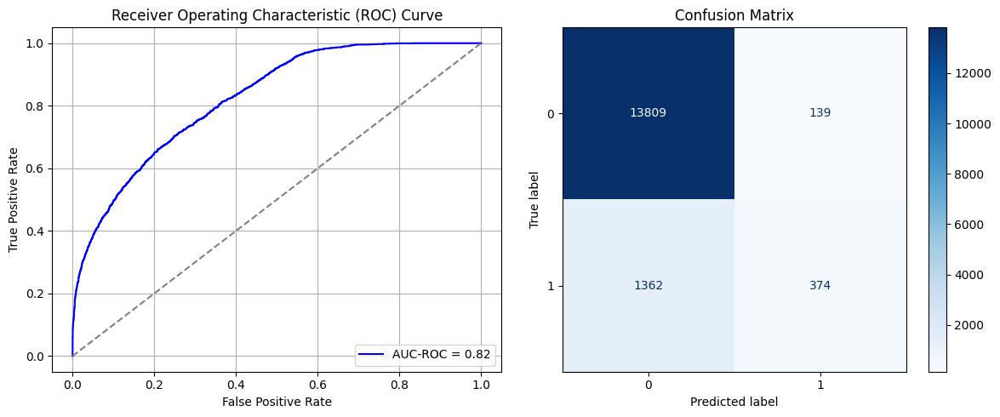

Best threshold based on F1-score: 0.18125958740711212
False Negative Rate: 0.7845622119815668
Time elapsed (performance): 1.211381777000497
(np.float64(0.009965586464009177), np.float64(0.9900344135359909))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7005 - loss: 0.6225 - val_AUC: 0.8537 - val_loss: 0.4779
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8654 - loss: 0.4585 - val_AUC: 0.8701 - val_loss: 0.4524
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8709 - loss: 0.4445 - val_AUC: 0.8707 - val_loss: 0.4433
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4356 - val_AUC: 0.8713 - val_loss: 0.4432
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4308 - val_AUC: 0.8711 - val_loss: 0.4419
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4318 - val_AUC: 0.8730 - val_loss: 0.4396
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4303 - val_AUC: 0.8715 - val_loss: 0.4439
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4319 - val_AUC: 0.8723 - val_loss: 0.4472
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 -

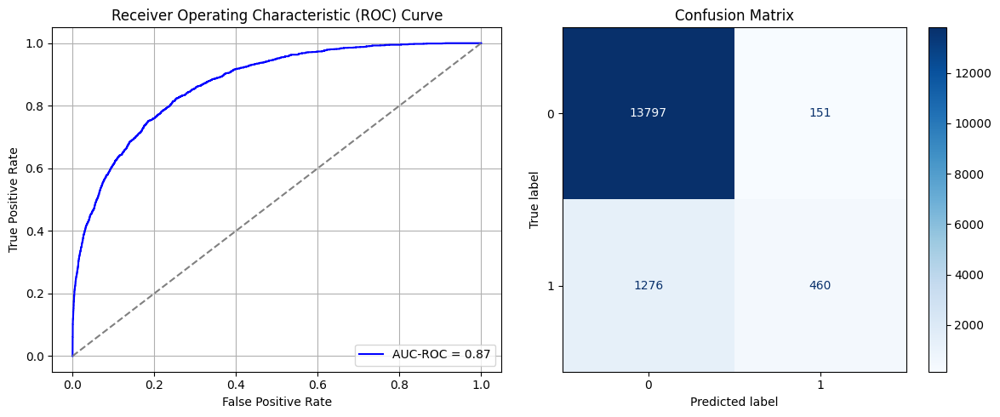

Best threshold based on F1-score: 0.2190943956375122
False Negative Rate: 0.7350230414746544
Time elapsed (performance): 1.230208319000667
(np.float64(0.010825924863779753), np.float64(0.9891740751362202))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7402 - loss: 0.6082 - val_AUC: 0.8638 - val_loss: 0.4689
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8614 - loss: 0.4627 - val_AUC: 0.8765 - val_loss: 0.4371
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4404 - val_AUC: 0.8796 - val_loss: 0.4302
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4409 - val_AUC: 0.8808 - val_loss: 0.4418
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4370 - val_AUC: 0.8792 - val_loss: 0.4303
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.4366 - val_AUC: 0.8785 - val_loss: 0.4347
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.4405 - val_AUC: 0.8798 - val_loss: 0.4291
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4309 - val_AUC: 0.8804 - val_loss: 0.4282
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 -

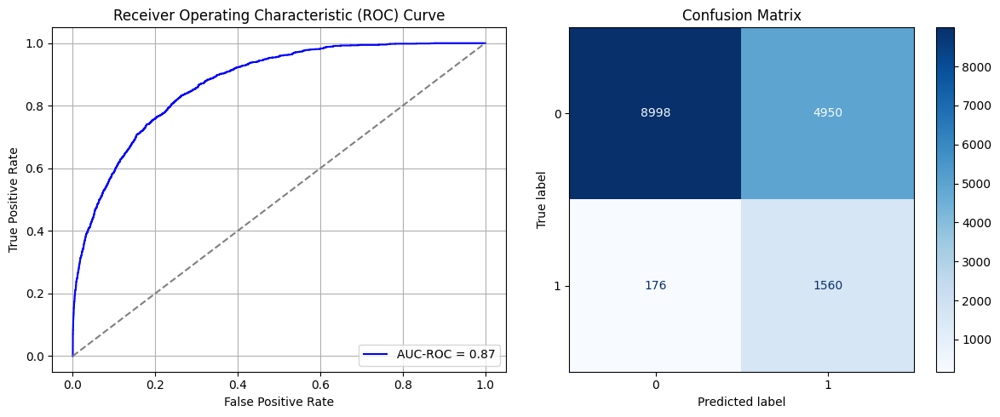

Best threshold based on F1-score: 0.8261926770210266
False Negative Rate: 0.10138248847926268
Time elapsed (performance): 1.408766524999919
(np.float64(0.3548895899053628), np.float64(0.6451104100946372))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7493 - loss: 0.6098 - val_AUC: 0.8455 - val_loss: 0.4904
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8582 - loss: 0.4662 - val_AUC: 0.8672 - val_loss: 0.4515
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8698 - loss: 0.4463 - val_AUC: 0.8700 - val_loss: 0.4511
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4341 - val_AUC: 0.8712 - val_loss: 0.4443
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4406 - val_AUC: 0.8722 - val_loss: 0.4622
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8858 - loss: 0.4187 - val_AUC: 0.8733 - val_loss: 0.4486
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8802 - loss: 0.4286 - val_AUC: 0.8739 - val_loss: 0.4380
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8854 - loss: 0.4189 - val_AUC: 0.8739 - val_loss: 0.4365
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8808 -

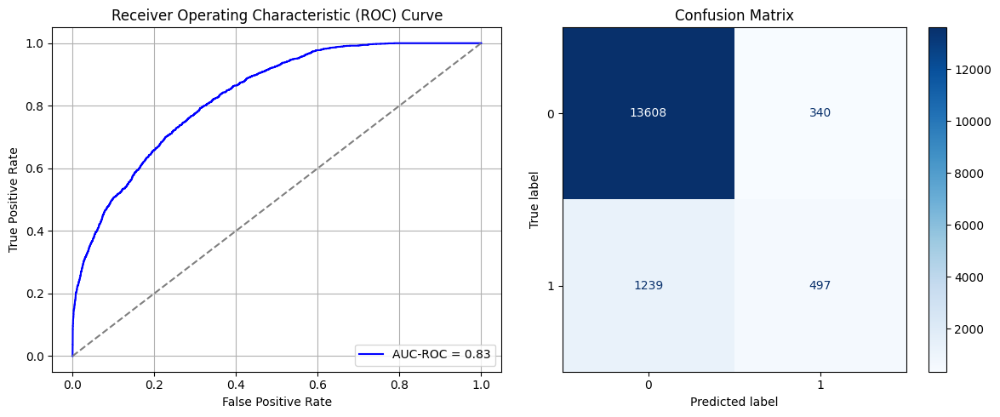

Best threshold based on F1-score: 0.29516565799713135
False Negative Rate: 0.7137096774193549
Time elapsed (performance): 1.6731292650001706
(np.float64(0.02437625466016633), np.float64(0.9756237453398336))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7426 - loss: 0.6120 - val_AUC: 0.8553 - val_loss: 0.4824
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8626 - loss: 0.4620 - val_AUC: 0.8673 - val_loss: 0.4490
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4347 - val_AUC: 0.8690 - val_loss: 0.4490
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4358 - val_AUC: 0.8717 - val_loss: 0.4420
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4398 - val_AUC: 0.8727 - val_loss: 0.4575
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 - loss: 0.4320 - val_AUC: 0.8721 - val_loss: 0.4412
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4296 - val_AUC: 0.8724 - val_loss: 0.4456
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 - loss: 0.4313 - val_AUC: 0.8730 - val_loss: 0.4539
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 -

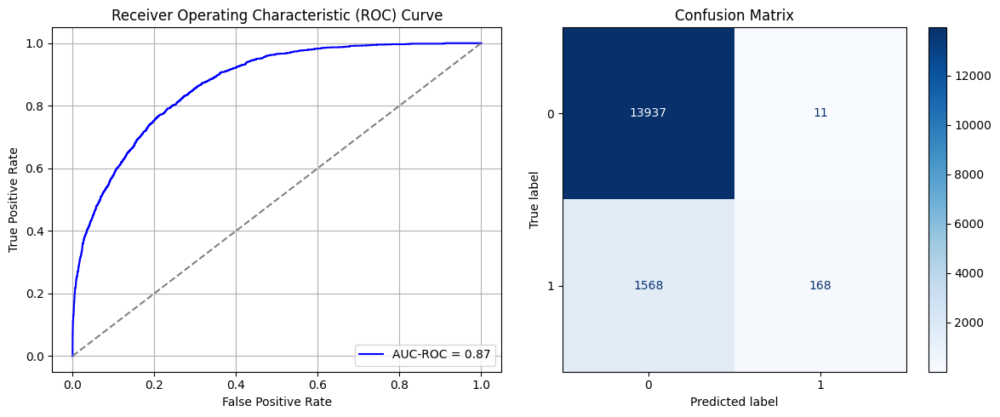

Best threshold based on F1-score: 0.031120961531996727
False Negative Rate: 0.9032258064516129
Time elapsed (performance): 1.9097513879996768
(np.float64(0.0007886435331230284), np.float64(0.999211356466877))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7259 - loss: 0.6116 - val_AUC: 0.8624 - val_loss: 0.4693
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8563 - loss: 0.4701 - val_AUC: 0.8759 - val_loss: 0.4382
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8727 - loss: 0.4419 - val_AUC: 0.8762 - val_loss: 0.4392
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4412 - val_AUC: 0.8771 - val_loss: 0.4346
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 - loss: 0.4373 - val_AUC: 0.8780 - val_loss: 0.4337
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4344 - val_AUC: 0.8777 - val_loss: 0.4417
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4434 - val_AUC: 0.8771 - val_loss: 0.4413
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8741 - loss: 0.4386 - val_AUC: 0.8773 - val_loss: 0.4357
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8788 -

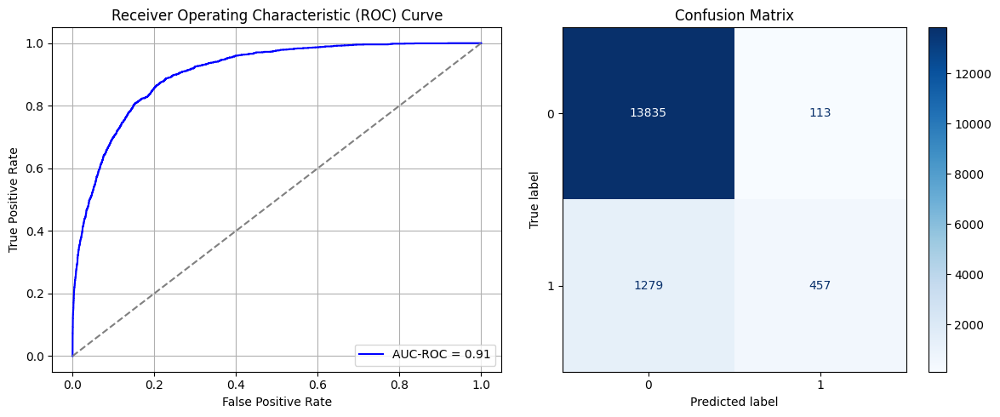

Best threshold based on F1-score: 0.1565864086151123
False Negative Rate: 0.7367511520737328
Time elapsed (performance): 1.2178745060000438
(np.float64(0.008101519931172928), np.float64(0.9918984800688271))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7465 - loss: 0.6121 - val_AUC: 0.8547 - val_loss: 0.4794
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8638 - loss: 0.4607 - val_AUC: 0.8672 - val_loss: 0.4476
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4331 - val_AUC: 0.8690 - val_loss: 0.4672
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8716 - loss: 0.4403 - val_AUC: 0.8706 - val_loss: 0.4474
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4341 - val_AUC: 0.8708 - val_loss: 0.4431
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4389 - val_AUC: 0.8716 - val_loss: 0.4461
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4343 - val_AUC: 0.8717 - val_loss: 0.4445
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8807 - loss: 0.4259 - val_AUC: 0.8720 - val_loss: 0.4511
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 -

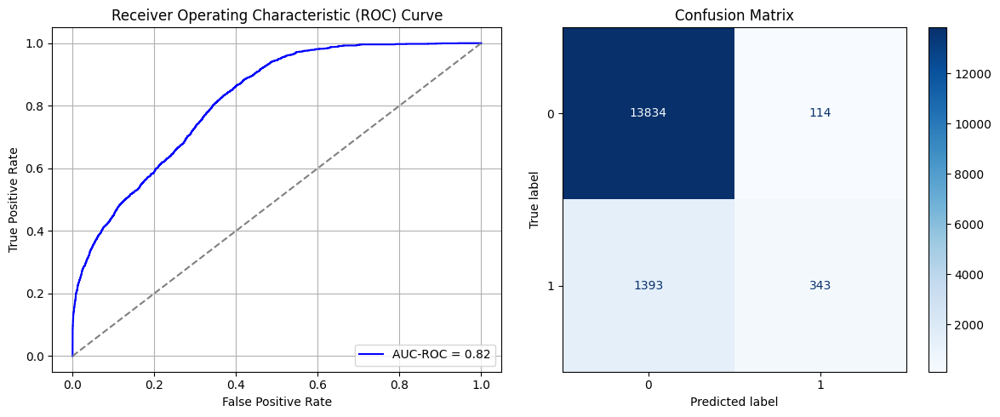

Best threshold based on F1-score: 0.18624530732631683
False Negative Rate: 0.8024193548387096
Time elapsed (performance): 1.8468710830002237
(np.float64(0.008173214797820476), np.float64(0.9918267852021795))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7204 - loss: 0.6163 - val_AUC: 0.8638 - val_loss: 0.4706
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8637 - loss: 0.4594 - val_AUC: 0.8779 - val_loss: 0.4343
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8705 - loss: 0.4457 - val_AUC: 0.8774 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4419 - val_AUC: 0.8804 - val_loss: 0.4373
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4423 - val_AUC: 0.8808 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 - loss: 0.4385 - val_AUC: 0.8810 - val_loss: 0.4388
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8723 - loss: 0.4421 - val_AUC: 0.8798 - val_loss: 0.4295
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4332 - val_AUC: 0.8807 - val_loss: 0.4283
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 -

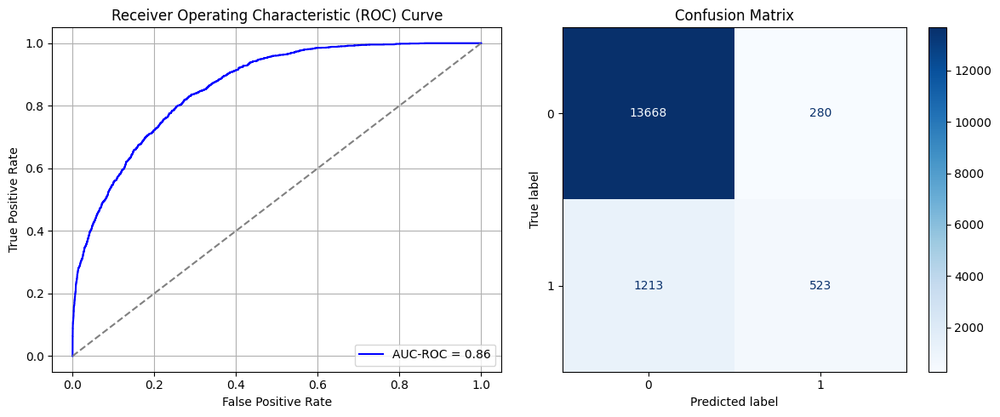

Best threshold based on F1-score: 0.29956626892089844
False Negative Rate: 0.6987327188940092
Time elapsed (performance): 1.8396703500002332
(np.float64(0.02007456266131345), np.float64(0.9799254373386865))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7467 - loss: 0.6056 - val_AUC: 0.8651 - val_loss: 0.4679
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8584 - loss: 0.4660 - val_AUC: 0.8768 - val_loss: 0.4417
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 - loss: 0.4440 - val_AUC: 0.8796 - val_loss: 0.4313
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4381 - val_AUC: 0.8801 - val_loss: 0.4317
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4338 - val_AUC: 0.8789 - val_loss: 0.4308
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4337 - val_AUC: 0.8800 - val_loss: 0.4396
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8727 - loss: 0.4417 - val_AUC: 0.8803 - val_loss: 0.4343
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4377 - val_AUC: 0.8785 - val_loss: 0.4448
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8788 -

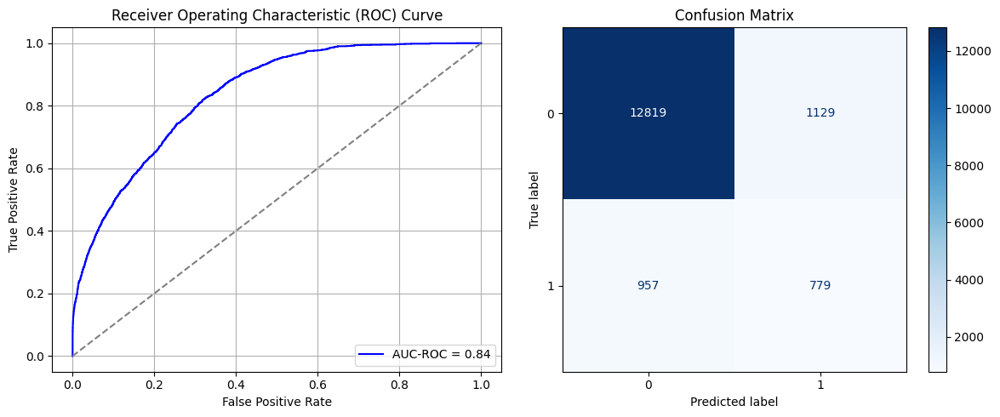

Best threshold based on F1-score: 0.4846627116203308
False Negative Rate: 0.5512672811059908
Time elapsed (performance): 1.6730517019996114
(np.float64(0.08094350444508173), np.float64(0.9190564955549183))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7277 - loss: 0.6142 - val_AUC: 0.8566 - val_loss: 0.4793
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8685 - loss: 0.4522 - val_AUC: 0.8688 - val_loss: 0.4478
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.4352 - val_AUC: 0.8711 - val_loss: 0.4441
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4372 - val_AUC: 0.8721 - val_loss: 0.4410
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4284 - val_AUC: 0.8713 - val_loss: 0.4441
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4376 - val_AUC: 0.8723 - val_loss: 0.4402
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8845 - loss: 0.4214 - val_AUC: 0.8708 - val_loss: 0.4430
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8827 - loss: 0.4253 - val_AUC: 0.8737 - val_loss: 0.4379
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8838 -

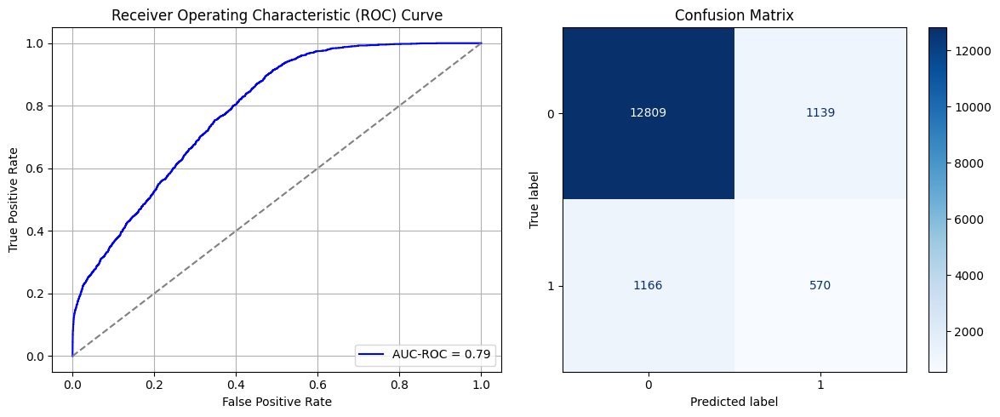

Best threshold based on F1-score: 0.3921436369419098
False Negative Rate: 0.6716589861751152
Time elapsed (performance): 1.673703631000535
(np.float64(0.08166045311155722), np.float64(0.9183395468884428))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7444 - loss: 0.6197 - val_AUC: 0.8604 - val_loss: 0.4739
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8578 - loss: 0.4701 - val_AUC: 0.8752 - val_loss: 0.4408
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.4417 - val_AUC: 0.8774 - val_loss: 0.4345
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8757 - loss: 0.4362 - val_AUC: 0.8787 - val_loss: 0.4309
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4340 - val_AUC: 0.8782 - val_loss: 0.4326
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8744 - loss: 0.4371 - val_AUC: 0.8784 - val_loss: 0.4397
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4353 - val_AUC: 0.8792 - val_loss: 0.4307
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8794 - loss: 0.4310 - val_AUC: 0.8792 - val_loss: 0.4300
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8755 -

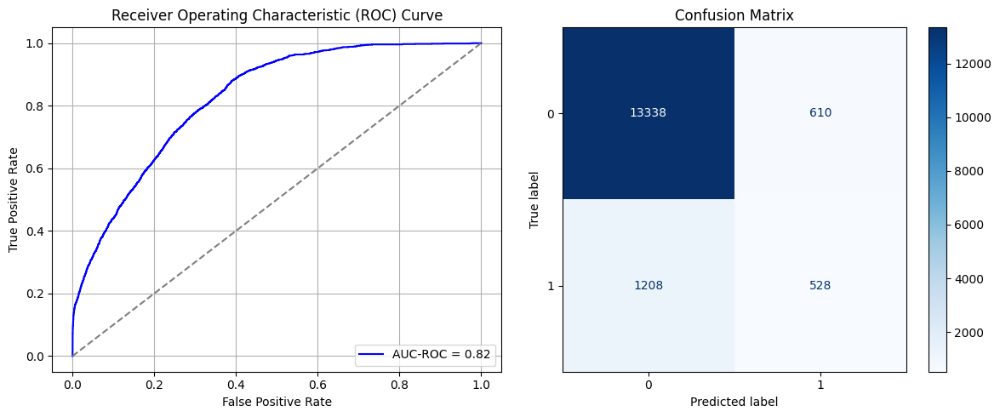

Best threshold based on F1-score: 0.2927042841911316
False Negative Rate: 0.695852534562212
Time elapsed (performance): 1.6680293399995207
(np.float64(0.0437338686550043), np.float64(0.9562661313449957))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7561 - loss: 0.6044 - val_AUC: 0.8484 - val_loss: 0.4879
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8579 - loss: 0.4678 - val_AUC: 0.8670 - val_loss: 0.4554
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4425 - val_AUC: 0.8687 - val_loss: 0.4589
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.4351 - val_AUC: 0.8709 - val_loss: 0.4426
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8744 - loss: 0.4395 - val_AUC: 0.8713 - val_loss: 0.4468
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.4327 - val_AUC: 0.8698 - val_loss: 0.4430
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8791 - loss: 0.4305 - val_AUC: 0.8696 - val_loss: 0.4463
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8801 - loss: 0.4299 - val_AUC: 0.8710 - val_loss: 0.4462
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 -

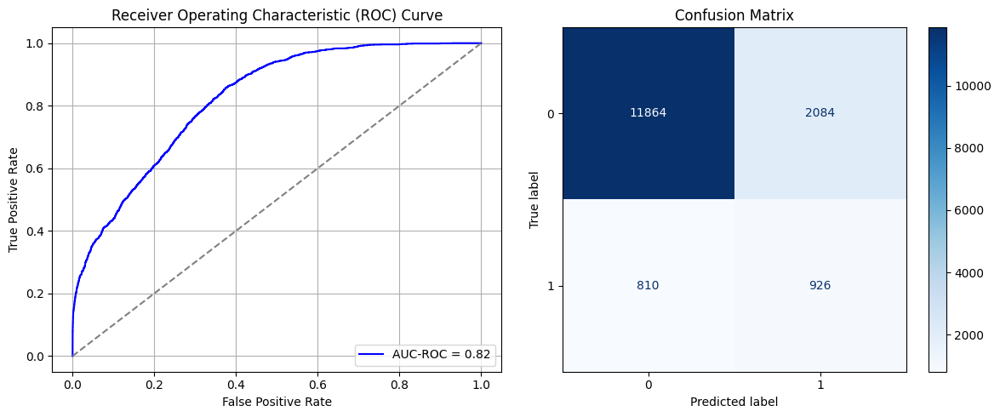

Best threshold based on F1-score: 0.6988552212715149
False Negative Rate: 0.4665898617511521
Time elapsed (performance): 1.6811574309995194
(np.float64(0.1494121020934901), np.float64(0.8505878979065099))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7082 - loss: 0.6259 - val_AUC: 0.8678 - val_loss: 0.4621
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8571 - loss: 0.4676 - val_AUC: 0.8770 - val_loss: 0.4358
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.4367 - val_AUC: 0.8784 - val_loss: 0.4318
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8709 - loss: 0.4427 - val_AUC: 0.8785 - val_loss: 0.4374
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4339 - val_AUC: 0.8777 - val_loss: 0.4324
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4403 - val_AUC: 0.8793 - val_loss: 0.4322
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4281 - val_AUC: 0.8788 - val_loss: 0.4353
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8744 - loss: 0.4368 - val_AUC: 0.8791 - val_loss: 0.4338
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8733 -

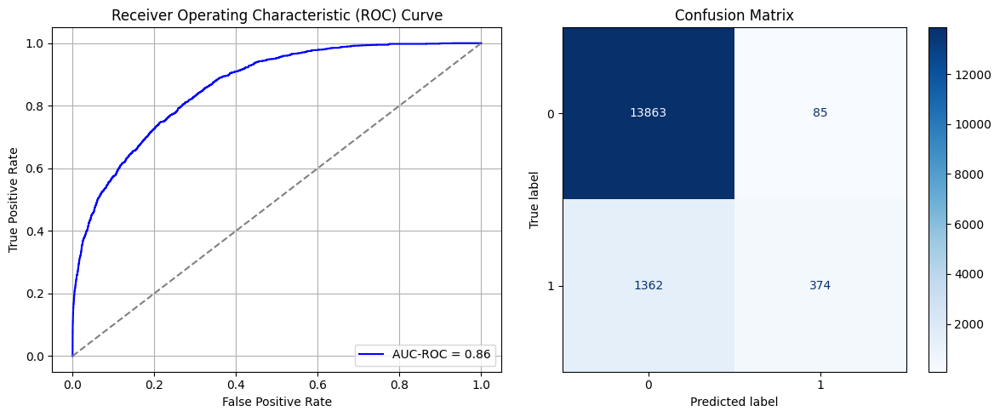

Best threshold based on F1-score: 0.20309825241565704
False Negative Rate: 0.7845622119815668
Time elapsed (performance): 1.2943654040000183
(np.float64(0.006094063665041583), np.float64(0.9939059363349584))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7644 - loss: 0.6034 - val_AUC: 0.8673 - val_loss: 0.4641
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8581 - loss: 0.4651 - val_AUC: 0.8779 - val_loss: 0.4340
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8710 - loss: 0.4436 - val_AUC: 0.8787 - val_loss: 0.4314
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8746 - loss: 0.4372 - val_AUC: 0.8788 - val_loss: 0.4305
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8710 - loss: 0.4417 - val_AUC: 0.8788 - val_loss: 0.4451
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4380 - val_AUC: 0.8791 - val_loss: 0.4302
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8763 - loss: 0.4332 - val_AUC: 0.8783 - val_loss: 0.4321
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4325 - val_AUC: 0.8776 - val_loss: 0.4321
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8751 -

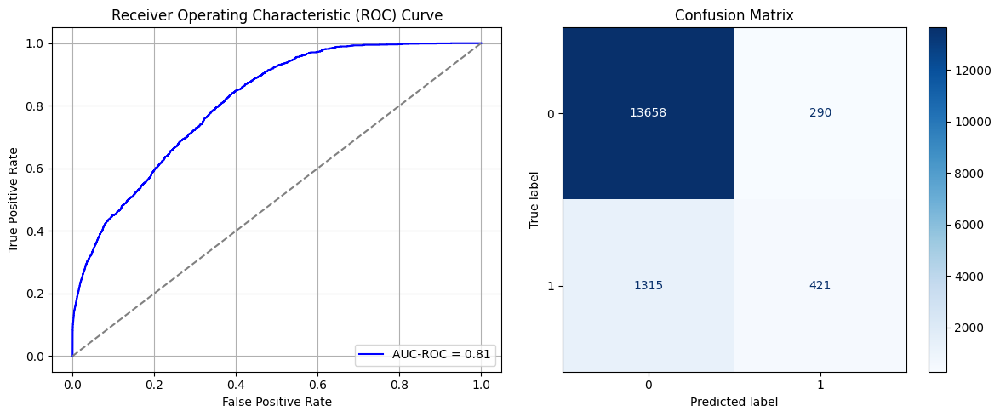

Best threshold based on F1-score: 0.2780750095844269
False Negative Rate: 0.7574884792626728
Time elapsed (performance): 1.7279857489993447
(np.float64(0.02079151132778893), np.float64(0.9792084886722111))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7400 - loss: 0.6129 - val_AUC: 0.8661 - val_loss: 0.4666
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8557 - loss: 0.4699 - val_AUC: 0.8768 - val_loss: 0.4400
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8718 - loss: 0.4434 - val_AUC: 0.8754 - val_loss: 0.4454
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4409 - val_AUC: 0.8801 - val_loss: 0.4288
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 - loss: 0.4393 - val_AUC: 0.8781 - val_loss: 0.4362
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4372 - val_AUC: 0.8801 - val_loss: 0.4289
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4285 - val_AUC: 0.8802 - val_loss: 0.4290
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 - loss: 0.4348 - val_AUC: 0.8807 - val_loss: 0.4300
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 -

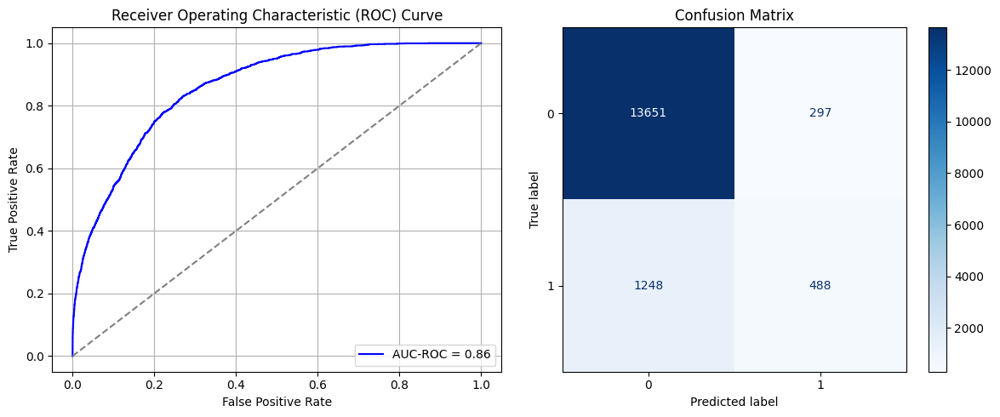

Best threshold based on F1-score: 0.22187010943889618
False Negative Rate: 0.7188940092165899
Time elapsed (performance): 1.5575618579996444
(np.float64(0.021293375394321766), np.float64(0.9787066246056783))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7221 - loss: 0.6221 - val_AUC: 0.8664 - val_loss: 0.4615
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8627 - loss: 0.4612 - val_AUC: 0.8742 - val_loss: 0.4396
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 - loss: 0.4422 - val_AUC: 0.8770 - val_loss: 0.4347
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4395 - val_AUC: 0.8783 - val_loss: 0.4321
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8694 - loss: 0.4483 - val_AUC: 0.8787 - val_loss: 0.4308
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8734 - loss: 0.4386 - val_AUC: 0.8786 - val_loss: 0.4329
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8786 - loss: 0.4310 - val_AUC: 0.8777 - val_loss: 0.4331
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.4389 - val_AUC: 0.8783 - val_loss: 0.4320
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 -

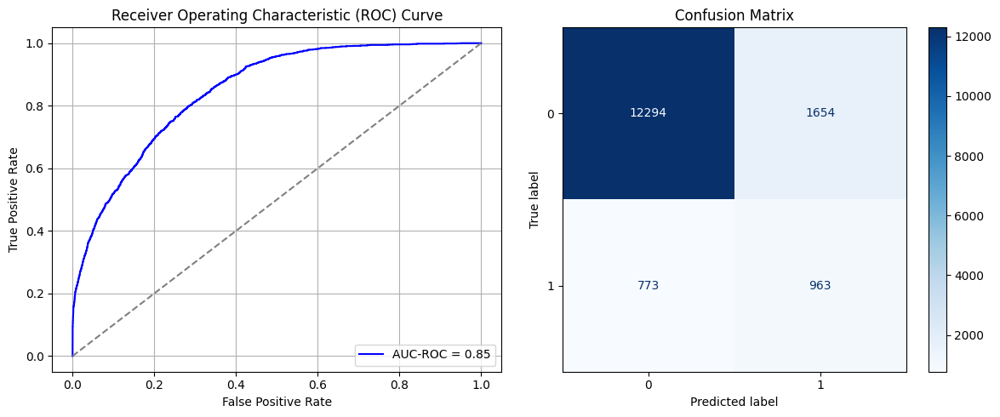

Best threshold based on F1-score: 0.5643535852432251
False Negative Rate: 0.44527649769585254
Time elapsed (performance): 1.8838499250005043
(np.float64(0.11858330943504446), np.float64(0.8814166905649555))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7119 - loss: 0.6204 - val_AUC: 0.8621 - val_loss: 0.4747
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8580 - loss: 0.4691 - val_AUC: 0.8745 - val_loss: 0.4493
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4429 - val_AUC: 0.8784 - val_loss: 0.4365
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8692 - loss: 0.4447 - val_AUC: 0.8773 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8708 - loss: 0.4432 - val_AUC: 0.8791 - val_loss: 0.4326
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4379 - val_AUC: 0.8784 - val_loss: 0.4491
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8777 - loss: 0.4348 - val_AUC: 0.8791 - val_loss: 0.4339
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4326 - val_AUC: 0.8799 - val_loss: 0.4295
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 -

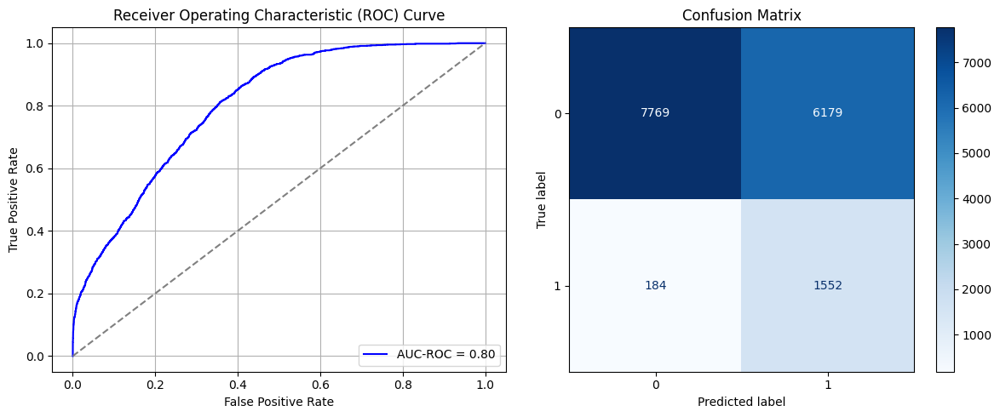

Best threshold based on F1-score: 0.832240104675293
False Negative Rate: 0.10599078341013825
Time elapsed (performance): 1.839730364999923
(np.float64(0.4430025810151993), np.float64(0.5569974189848007))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7135 - loss: 0.6209 - val_AUC: 0.8625 - val_loss: 0.4668
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8617 - loss: 0.4628 - val_AUC: 0.8769 - val_loss: 0.4541
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8684 - loss: 0.4500 - val_AUC: 0.8778 - val_loss: 0.4338
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4414 - val_AUC: 0.8794 - val_loss: 0.4432
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8748 - loss: 0.4381 - val_AUC: 0.8775 - val_loss: 0.4363
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8704 - loss: 0.4435 - val_AUC: 0.8794 - val_loss: 0.4321
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.4355 - val_AUC: 0.8798 - val_loss: 0.4332
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8756 - loss: 0.4356 - val_AUC: 0.8802 - val_loss: 0.4298
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 -

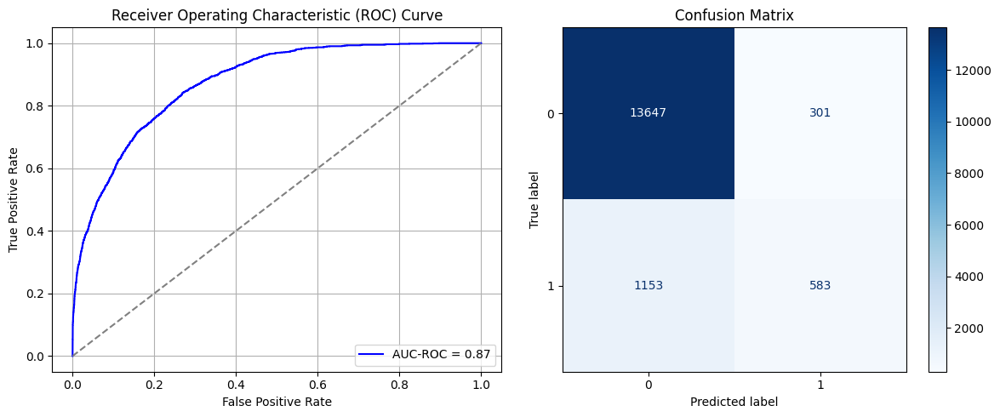

Best threshold based on F1-score: 0.3203492760658264
False Negative Rate: 0.6641705069124424
Time elapsed (performance): 1.27464300200063
(np.float64(0.021580154860911957), np.float64(0.9784198451390881))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7510 - loss: 0.6064 - val_AUC: 0.8539 - val_loss: 0.4840
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8702 - loss: 0.4505 - val_AUC: 0.8665 - val_loss: 0.4489
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4506 - val_AUC: 0.8701 - val_loss: 0.4453
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.4364 - val_AUC: 0.8713 - val_loss: 0.4407
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8812 - loss: 0.4278 - val_AUC: 0.8711 - val_loss: 0.4432
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.4393 - val_AUC: 0.8707 - val_loss: 0.4433
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8802 - loss: 0.4310 - val_AUC: 0.8720 - val_loss: 0.4495
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.4354 - val_AUC: 0.8724 - val_loss: 0.4397
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 -

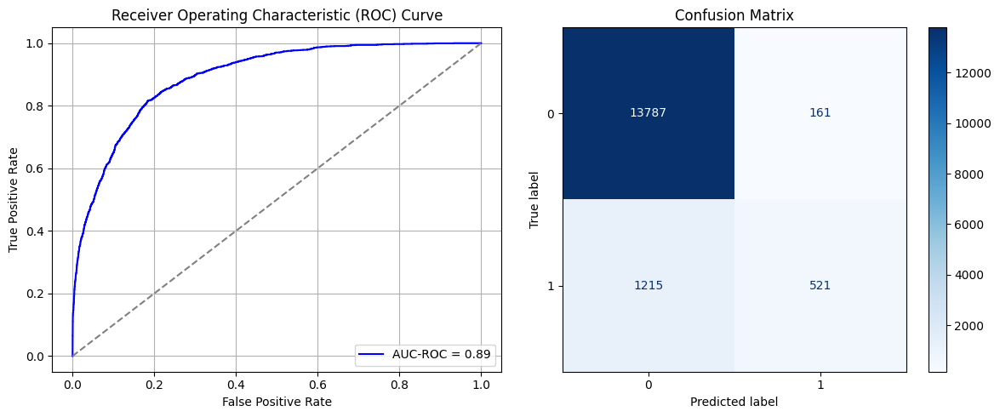

Best threshold based on F1-score: 0.22646348178386688
False Negative Rate: 0.6998847926267281
Time elapsed (performance): 1.2849448329998268
(np.float64(0.011542873530255234), np.float64(0.9884571264697448))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7367 - loss: 0.6198 - val_AUC: 0.8548 - val_loss: 0.4825
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8501 - loss: 0.4812 - val_AUC: 0.8768 - val_loss: 0.4399
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8668 - loss: 0.4483 - val_AUC: 0.8790 - val_loss: 0.4332
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4367 - val_AUC: 0.8794 - val_loss: 0.4319
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.4412 - val_AUC: 0.8785 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8783 - loss: 0.4318 - val_AUC: 0.8795 - val_loss: 0.4327
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8752 - loss: 0.4364 - val_AUC: 0.8802 - val_loss: 0.4296
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4350 - val_AUC: 0.8789 - val_loss: 0.4360
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 -

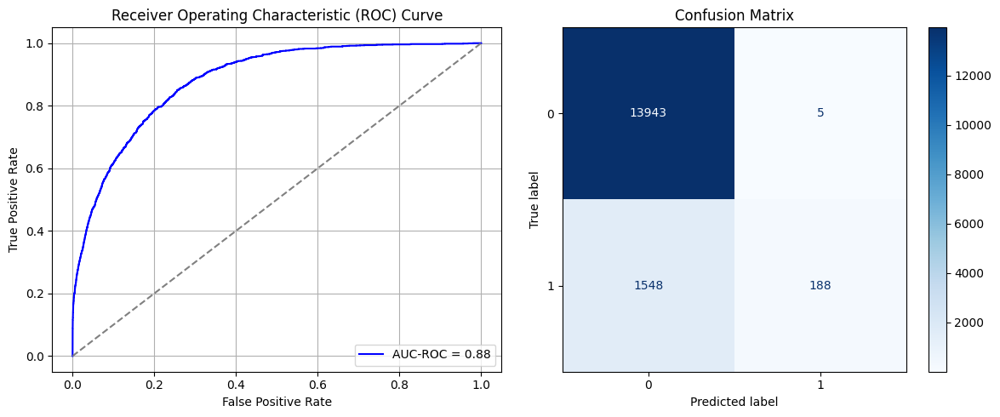

Best threshold based on F1-score: 0.02220037579536438
False Negative Rate: 0.8917050691244239
Time elapsed (performance): 1.6800049059993398
(np.float64(0.0003584743332377402), np.float64(0.9996415256667622))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7450 - loss: 0.6125 - val_AUC: 0.8610 - val_loss: 0.4873
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8576 - loss: 0.4703 - val_AUC: 0.8743 - val_loss: 0.4521
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8670 - loss: 0.4508 - val_AUC: 0.8767 - val_loss: 0.4396
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8700 - loss: 0.4448 - val_AUC: 0.8779 - val_loss: 0.4319
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8718 - loss: 0.4421 - val_AUC: 0.8765 - val_loss: 0.4381
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4316 - val_AUC: 0.8789 - val_loss: 0.4353
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4330 - val_AUC: 0.8783 - val_loss: 0.4457
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 - loss: 0.4291 - val_AUC: 0.8784 - val_loss: 0.4312
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 -

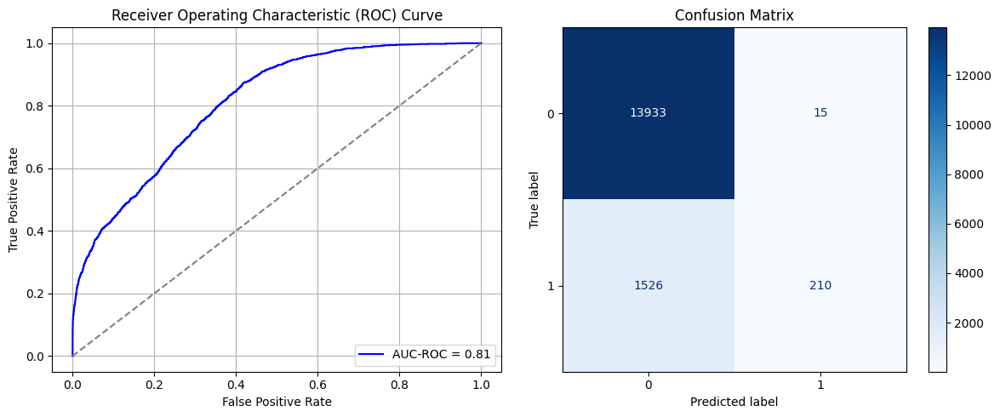

Best threshold based on F1-score: 0.11037734150886536
False Negative Rate: 0.8790322580645161
Time elapsed (performance): 1.3098744799999622
(np.float64(0.0010754229997132205), np.float64(0.9989245770002868))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7466 - loss: 0.6097 - val_AUC: 0.8733 - val_loss: 0.4547
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8638 - loss: 0.4578 - val_AUC: 0.8774 - val_loss: 0.4371
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8727 - loss: 0.4434 - val_AUC: 0.8780 - val_loss: 0.4379
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8708 - loss: 0.4421 - val_AUC: 0.8796 - val_loss: 0.4303
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4386 - val_AUC: 0.8799 - val_loss: 0.4304
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.4331 - val_AUC: 0.8797 - val_loss: 0.4296
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4414 - val_AUC: 0.8804 - val_loss: 0.4494
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 - loss: 0.4397 - val_AUC: 0.8808 - val_loss: 0.4272
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 -

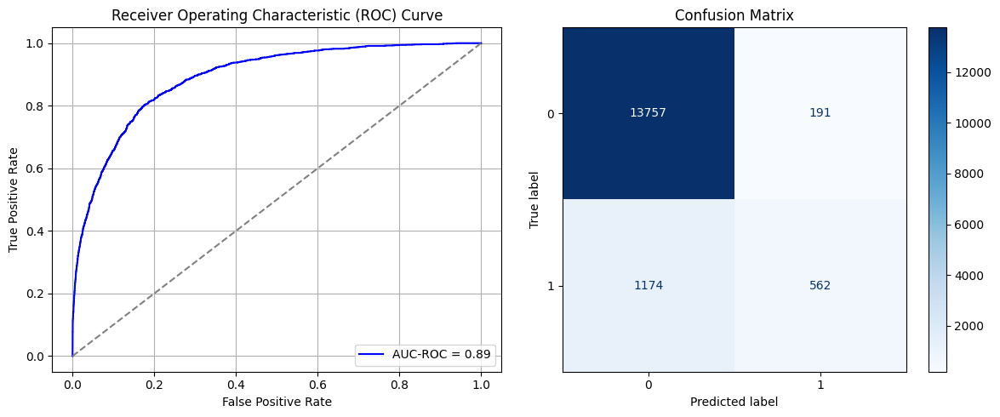

Best threshold based on F1-score: 0.2432822287082672
False Negative Rate: 0.6762672811059908
Time elapsed (performance): 1.2983235849987977
(np.float64(0.013693719529681675), np.float64(0.9863062804703183))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7584 - loss: 0.6026 - val_AUC: 0.8558 - val_loss: 0.4750
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8632 - loss: 0.4621 - val_AUC: 0.8677 - val_loss: 0.4677
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8646 - loss: 0.4536 - val_AUC: 0.8704 - val_loss: 0.4470
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4301 - val_AUC: 0.8715 - val_loss: 0.4482
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8761 - loss: 0.4375 - val_AUC: 0.8718 - val_loss: 0.4443
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8804 - loss: 0.4273 - val_AUC: 0.8695 - val_loss: 0.4510
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8706 - loss: 0.4437 - val_AUC: 0.8716 - val_loss: 0.4511
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4330 - val_AUC: 0.8740 - val_loss: 0.4384
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 -

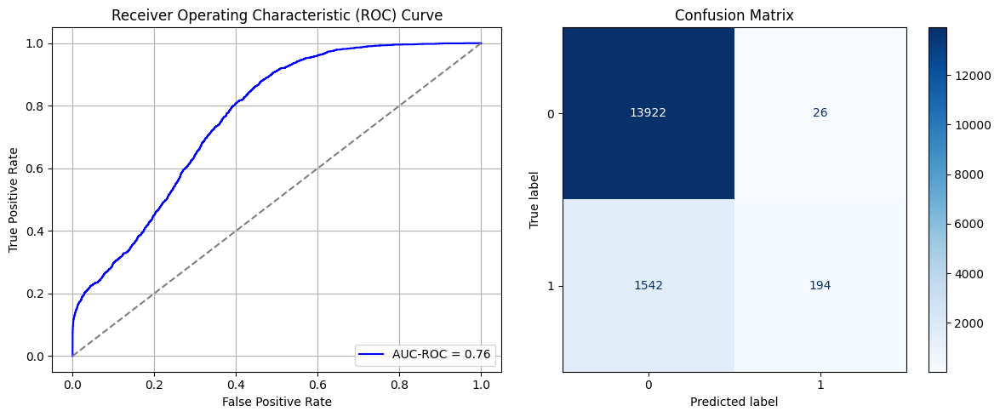

Best threshold based on F1-score: 0.004115094896405935
False Negative Rate: 0.8882488479262672
Time elapsed (performance): 1.668582743001025
(np.float64(0.001864066532836249), np.float64(0.9981359334671638))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7365 - loss: 0.6118 - val_AUC: 0.8495 - val_loss: 0.4857
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8684 - loss: 0.4586 - val_AUC: 0.8660 - val_loss: 0.4521
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4362 - val_AUC: 0.8698 - val_loss: 0.4457
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.4353 - val_AUC: 0.8697 - val_loss: 0.4484
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8721 - loss: 0.4422 - val_AUC: 0.8711 - val_loss: 0.4422
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4382 - val_AUC: 0.8712 - val_loss: 0.4414
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8836 - loss: 0.4249 - val_AUC: 0.8709 - val_loss: 0.4569
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4378 - val_AUC: 0.8729 - val_loss: 0.4389
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 -

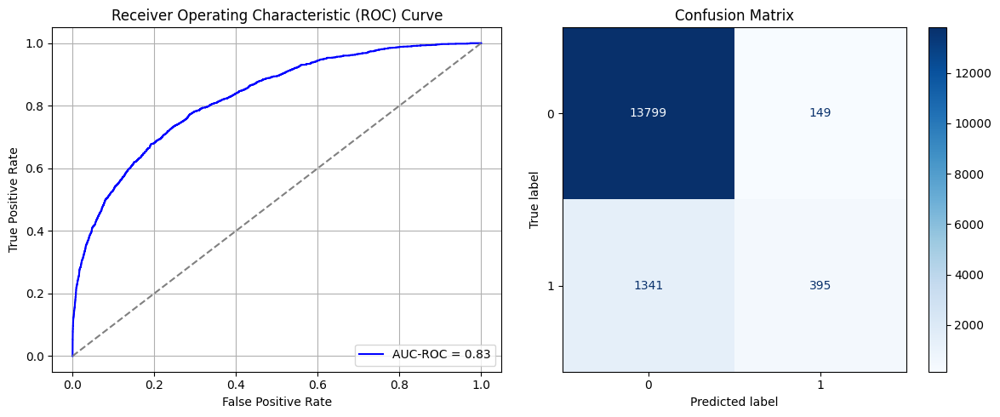

Best threshold based on F1-score: 0.21763962507247925
False Negative Rate: 0.7724654377880185
Time elapsed (performance): 1.669411372000468
(np.float64(0.010682535130484658), np.float64(0.9893174648695153))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7576 - loss: 0.6088 - val_AUC: 0.8534 - val_loss: 0.4775
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8612 - loss: 0.4626 - val_AUC: 0.8682 - val_loss: 0.4470
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.4386 - val_AUC: 0.8706 - val_loss: 0.4475
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8748 - loss: 0.4394 - val_AUC: 0.8685 - val_loss: 0.4464
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8781 - loss: 0.4317 - val_AUC: 0.8723 - val_loss: 0.4492
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8774 - loss: 0.4327 - val_AUC: 0.8715 - val_loss: 0.4437
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4392 - val_AUC: 0.8720 - val_loss: 0.4408
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8820 - loss: 0.4257 - val_AUC: 0.8723 - val_loss: 0.4465
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8823 -

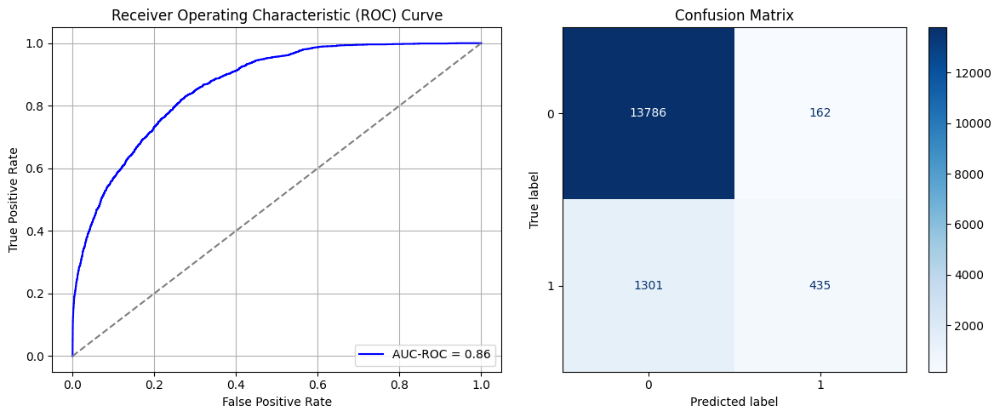

Best threshold based on F1-score: 0.21004346013069153
False Negative Rate: 0.7494239631336406
Time elapsed (performance): 1.8631400069989468
(np.float64(0.011614568396902782), np.float64(0.9883854316030972))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7339 - loss: 0.6148 - val_AUC: 0.8636 - val_loss: 0.4664
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8563 - loss: 0.4693 - val_AUC: 0.8769 - val_loss: 0.4391
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8673 - loss: 0.4507 - val_AUC: 0.8781 - val_loss: 0.4328
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8736 - loss: 0.4388 - val_AUC: 0.8789 - val_loss: 0.4301
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.4352 - val_AUC: 0.8780 - val_loss: 0.4406
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8755 - loss: 0.4367 - val_AUC: 0.8794 - val_loss: 0.4288
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4361 - val_AUC: 0.8800 - val_loss: 0.4284
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8807 - loss: 0.4282 - val_AUC: 0.8794 - val_loss: 0.4292
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 -

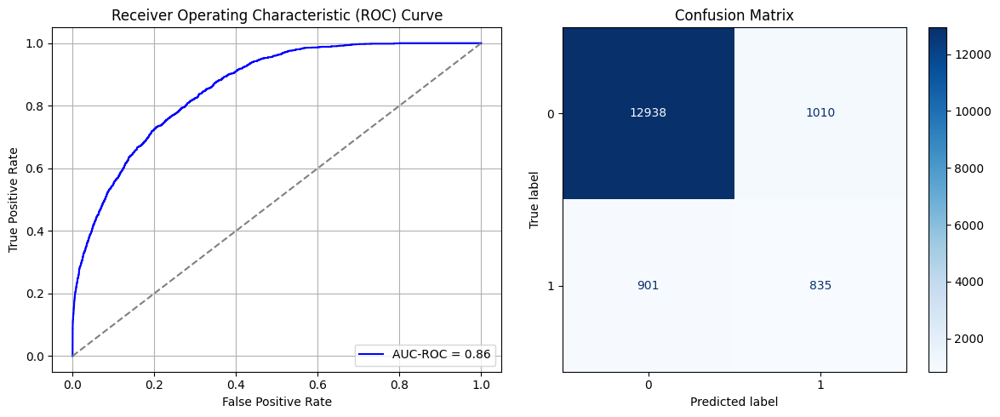

Best threshold based on F1-score: 0.46320971846580505
False Negative Rate: 0.5190092165898618
Time elapsed (performance): 1.8900975870001275
(np.float64(0.07241181531402352), np.float64(0.9275881846859765))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7306 - loss: 0.6240 - val_AUC: 0.8587 - val_loss: 0.4712
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8542 - loss: 0.4729 - val_AUC: 0.8760 - val_loss: 0.4704
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4436 - val_AUC: 0.8768 - val_loss: 0.4371
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8739 - loss: 0.4387 - val_AUC: 0.8781 - val_loss: 0.4325
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8737 - loss: 0.4388 - val_AUC: 0.8790 - val_loss: 0.4368
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8719 - loss: 0.4421 - val_AUC: 0.8794 - val_loss: 0.4300
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8660 - loss: 0.4507 - val_AUC: 0.8797 - val_loss: 0.4313
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8708 - loss: 0.4443 - val_AUC: 0.8800 - val_loss: 0.4294
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8783 -

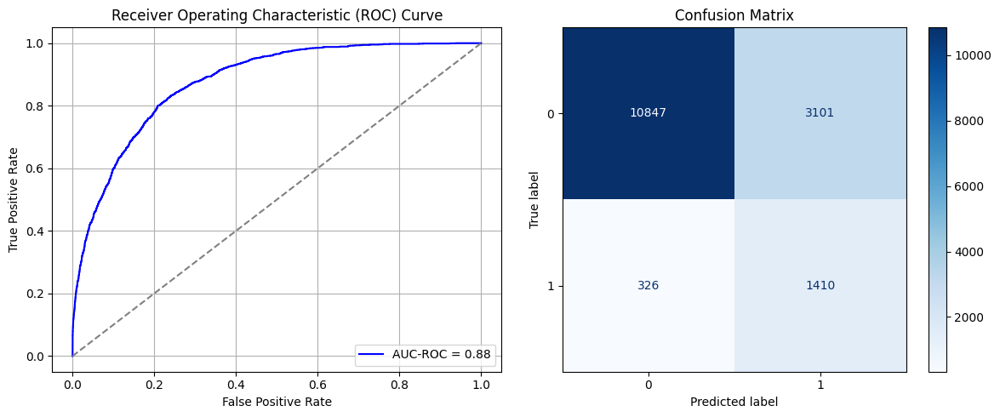

Best threshold based on F1-score: 0.678765594959259
False Negative Rate: 0.18778801843317972
Time elapsed (performance): 1.337158645999807
(np.float64(0.22232578147404647), np.float64(0.7776742185259535))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7293 - loss: 0.6138 - val_AUC: 0.8568 - val_loss: 0.4769
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8672 - loss: 0.4535 - val_AUC: 0.8675 - val_loss: 0.4500
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8682 - loss: 0.4496 - val_AUC: 0.8694 - val_loss: 0.4522
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4361 - val_AUC: 0.8703 - val_loss: 0.4467
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4395 - val_AUC: 0.8701 - val_loss: 0.4469
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8774 - loss: 0.4343 - val_AUC: 0.8720 - val_loss: 0.4493
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8797 - loss: 0.4281 - val_AUC: 0.8717 - val_loss: 0.4455
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8841 - loss: 0.4233 - val_AUC: 0.8710 - val_loss: 0.4430
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 -

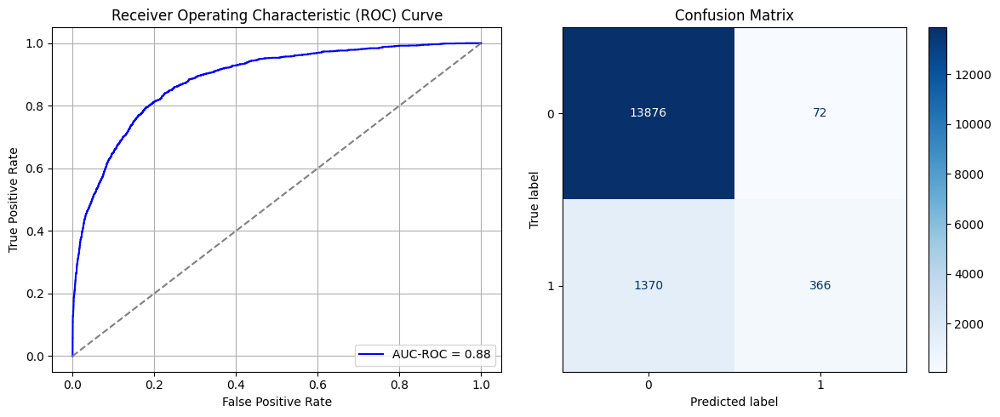

Best threshold based on F1-score: 0.15685135126113892
False Negative Rate: 0.7891705069124424
Time elapsed (performance): 1.5847158769993257
(np.float64(0.005162030398623459), np.float64(0.9948379696013765))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7636 - loss: 0.6002 - val_AUC: 0.8474 - val_loss: 0.4874
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8533 - loss: 0.4746 - val_AUC: 0.8656 - val_loss: 0.4515
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8674 - loss: 0.4508 - val_AUC: 0.8676 - val_loss: 0.4478
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4365 - val_AUC: 0.8696 - val_loss: 0.4450
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8747 - loss: 0.4358 - val_AUC: 0.8691 - val_loss: 0.4748
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8776 - loss: 0.4321 - val_AUC: 0.8709 - val_loss: 0.4441
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 - loss: 0.4300 - val_AUC: 0.8707 - val_loss: 0.4508
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8803 - loss: 0.4291 - val_AUC: 0.8708 - val_loss: 0.4511
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 -

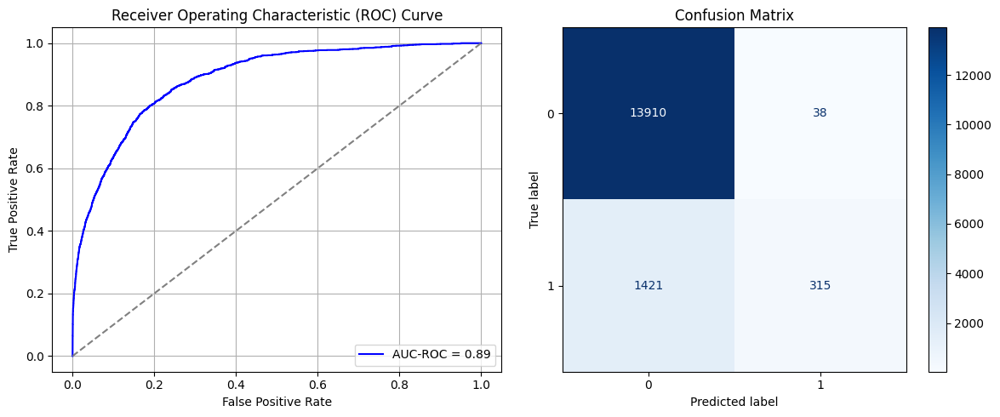

Best threshold based on F1-score: 0.11358166486024857
False Negative Rate: 0.8185483870967742
Time elapsed (performance): 1.8086575620000076
(np.float64(0.0027244049326068252), np.float64(0.9972755950673932))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7466 - loss: 0.6099 - val_AUC: 0.8503 - val_loss: 0.4826
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8618 - loss: 0.4627 - val_AUC: 0.8674 - val_loss: 0.4477
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4389 - val_AUC: 0.8685 - val_loss: 0.4466
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8693 - loss: 0.4446 - val_AUC: 0.8710 - val_loss: 0.4484
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8707 - loss: 0.4413 - val_AUC: 0.8721 - val_loss: 0.4407
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4318 - val_AUC: 0.8710 - val_loss: 0.4553
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4258 - val_AUC: 0.8709 - val_loss: 0.4439
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8791 - loss: 0.4293 - val_AUC: 0.8724 - val_loss: 0.4396
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 -

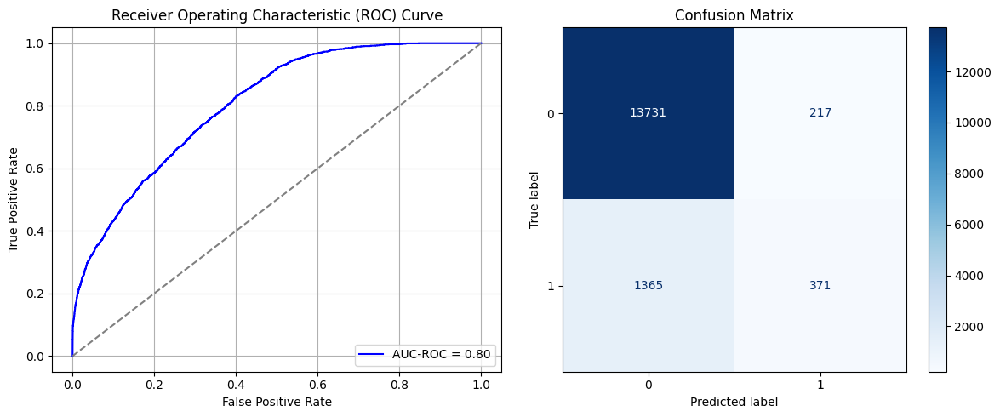

Best threshold based on F1-score: 0.2020966112613678
False Negative Rate: 0.7862903225806451
Time elapsed (performance): 1.6970063649987424
(np.float64(0.015557786062517924), np.float64(0.9844422139374821))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7329 - loss: 0.6190 - val_AUC: 0.8640 - val_loss: 0.4812
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8557 - loss: 0.4703 - val_AUC: 0.8777 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8708 - loss: 0.4447 - val_AUC: 0.8782 - val_loss: 0.4436
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8771 - loss: 0.4328 - val_AUC: 0.8788 - val_loss: 0.4313
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8689 - loss: 0.4478 - val_AUC: 0.8787 - val_loss: 0.4312
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8731 - loss: 0.4406 - val_AUC: 0.8792 - val_loss: 0.4339
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8753 - loss: 0.4360 - val_AUC: 0.8789 - val_loss: 0.4420
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4412 - val_AUC: 0.8777 - val_loss: 0.4326
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8744 -

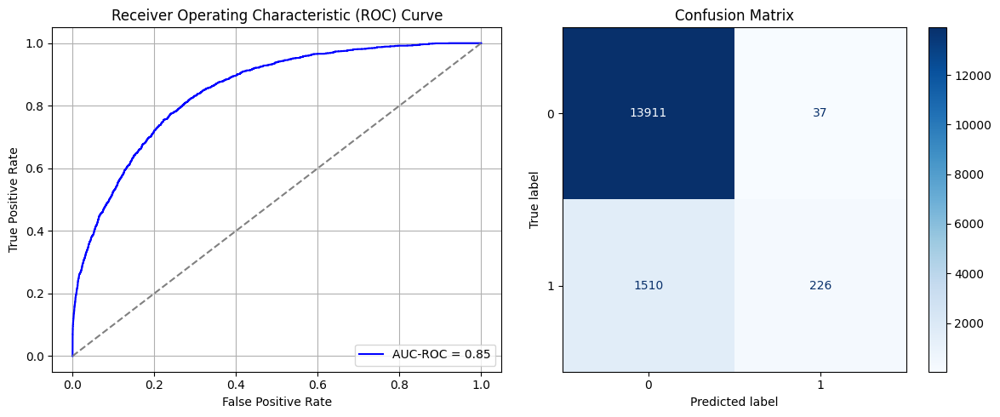

Best threshold based on F1-score: 0.11183572560548782
False Negative Rate: 0.869815668202765
Time elapsed (performance): 1.3539916230001836
(np.float64(0.0026527100659592775), np.float64(0.9973472899340408))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7317 - loss: 0.6128 - val_AUC: 0.8665 - val_loss: 0.4604
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8572 - loss: 0.4682 - val_AUC: 0.8775 - val_loss: 0.4344
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8746 - loss: 0.4385 - val_AUC: 0.8789 - val_loss: 0.4334
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8722 - loss: 0.4402 - val_AUC: 0.8785 - val_loss: 0.4347
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8765 - loss: 0.4355 - val_AUC: 0.8787 - val_loss: 0.4363
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8700 - loss: 0.4459 - val_AUC: 0.8780 - val_loss: 0.4318
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8770 - loss: 0.4332 - val_AUC: 0.8801 - val_loss: 0.4284
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8739 - loss: 0.4385 - val_AUC: 0.8790 - val_loss: 0.4403
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8792 -

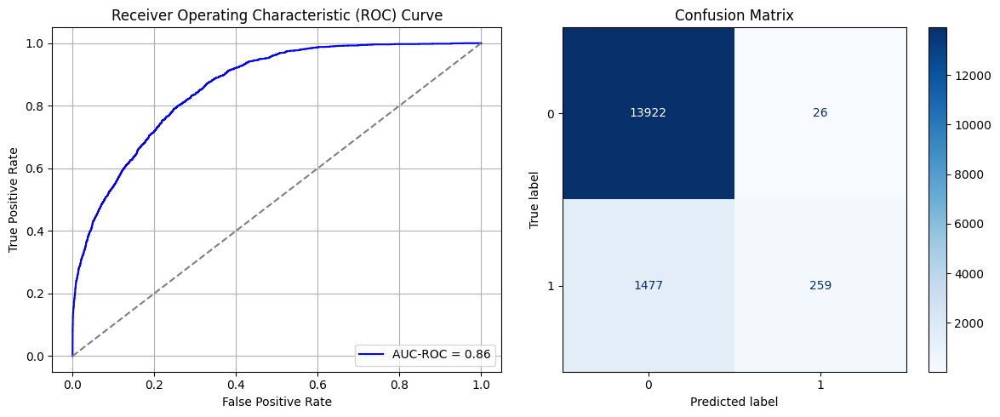

Best threshold based on F1-score: 0.0941852405667305
False Negative Rate: 0.8508064516129032
Time elapsed (performance): 1.7214577020004072
(np.float64(0.001864066532836249), np.float64(0.9981359334671638))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7634 - loss: 0.6107 - val_AUC: 0.8497 - val_loss: 0.4766
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8564 - loss: 0.4690 - val_AUC: 0.8666 - val_loss: 0.4709
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.4392 - val_AUC: 0.8688 - val_loss: 0.4515
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 - loss: 0.4379 - val_AUC: 0.8700 - val_loss: 0.4457
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8857 - loss: 0.4200 - val_AUC: 0.8707 - val_loss: 0.4461
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8796 - loss: 0.4285 - val_AUC: 0.8721 - val_loss: 0.4404
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4362 - val_AUC: 0.8726 - val_loss: 0.4394
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8814 - loss: 0.4260 - val_AUC: 0.8723 - val_loss: 0.4468
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8824 -

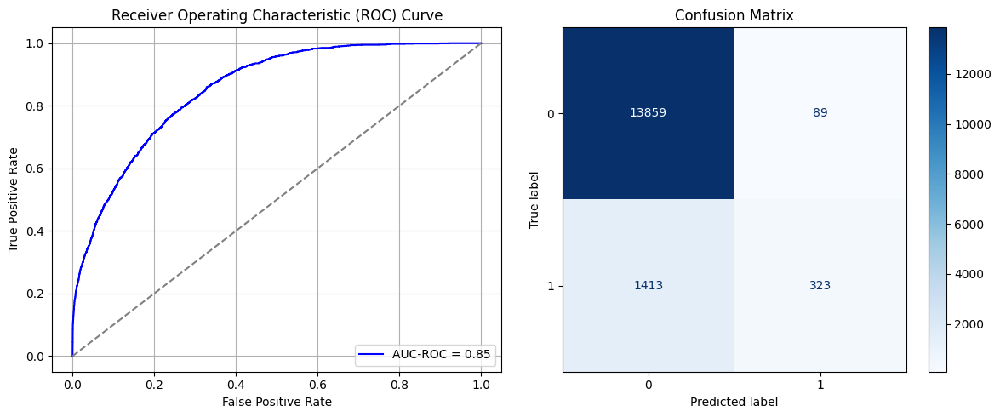

Best threshold based on F1-score: 0.14688929915428162
False Negative Rate: 0.8139400921658986
Time elapsed (performance): 1.7019730960000743
(np.float64(0.0063808431316317755), np.float64(0.9936191568683682))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7272 - loss: 0.6142 - val_AUC: 0.8584 - val_loss: 0.4764
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8492 - loss: 0.4797 - val_AUC: 0.8740 - val_loss: 0.4399
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8637 - loss: 0.4555 - val_AUC: 0.8769 - val_loss: 0.4383
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4418 - val_AUC: 0.8784 - val_loss: 0.4344
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8735 - loss: 0.4404 - val_AUC: 0.8784 - val_loss: 0.4318
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 - loss: 0.4451 - val_AUC: 0.8795 - val_loss: 0.4299
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4324 - val_AUC: 0.8793 - val_loss: 0.4302
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4318 - val_AUC: 0.8797 - val_loss: 0.4289
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8834 -

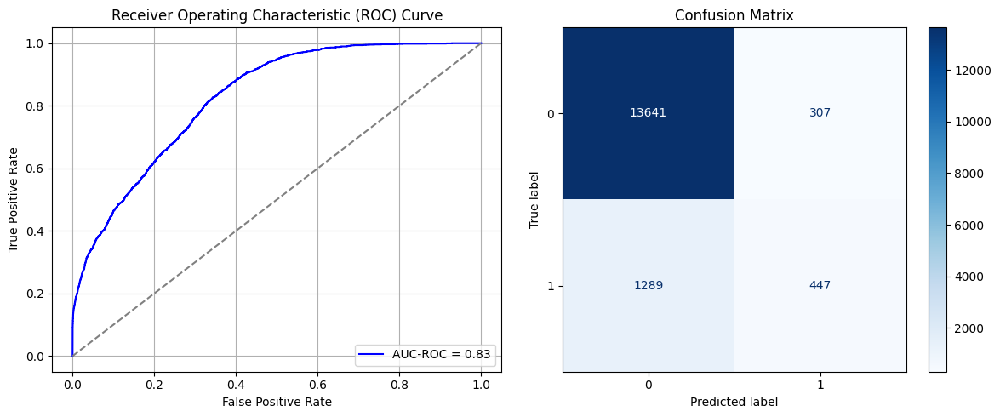

Best threshold based on F1-score: 0.23653626441955566
False Negative Rate: 0.7425115207373272
Time elapsed (performance): 2.0058242680006515
(np.float64(0.022010324060797247), np.float64(0.9779896759392027))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7521 - loss: 0.6112 - val_AUC: 0.8527 - val_loss: 0.4760
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8693 - loss: 0.4524 - val_AUC: 0.8694 - val_loss: 0.4449
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8680 - loss: 0.4484 - val_AUC: 0.8702 - val_loss: 0.4429
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 - loss: 0.4359 - val_AUC: 0.8698 - val_loss: 0.4445
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4323 - val_AUC: 0.8733 - val_loss: 0.4450
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8810 - loss: 0.4279 - val_AUC: 0.8733 - val_loss: 0.4394
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4329 - val_AUC: 0.8737 - val_loss: 0.4752
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8784 - loss: 0.4316 - val_AUC: 0.8732 - val_loss: 0.4412
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8808 -

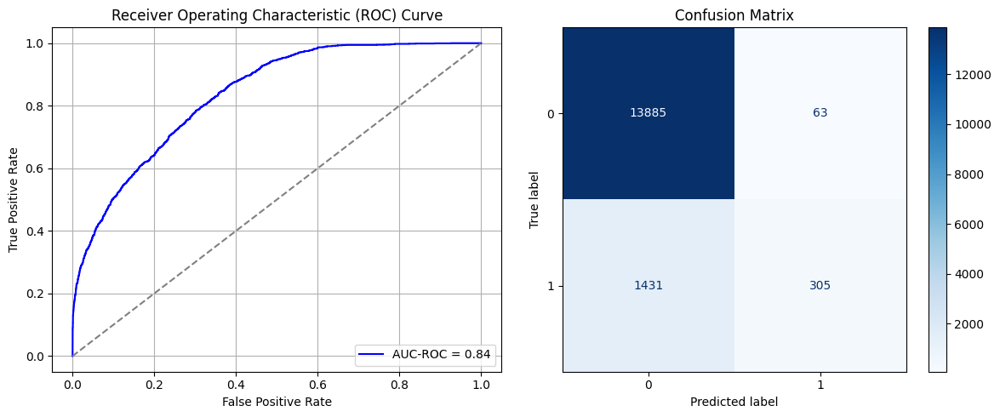

Best threshold based on F1-score: 0.09901159256696701
False Negative Rate: 0.8243087557603687
Time elapsed (performance): 1.9355965310005558
(np.float64(0.004516776598795526), np.float64(0.9954832234012044))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7112 - loss: 0.6189 - val_AUC: 0.8513 - val_loss: 0.4765
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8594 - loss: 0.4662 - val_AUC: 0.8666 - val_loss: 0.4578
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8702 - loss: 0.4441 - val_AUC: 0.8685 - val_loss: 0.4464
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8700 - loss: 0.4462 - val_AUC: 0.8709 - val_loss: 0.4471
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8791 - loss: 0.4301 - val_AUC: 0.8703 - val_loss: 0.4441
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8731 - loss: 0.4396 - val_AUC: 0.8693 - val_loss: 0.4453
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4358 - val_AUC: 0.8718 - val_loss: 0.4474
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8820 - loss: 0.4253 - val_AUC: 0.8732 - val_loss: 0.4403
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8767 -

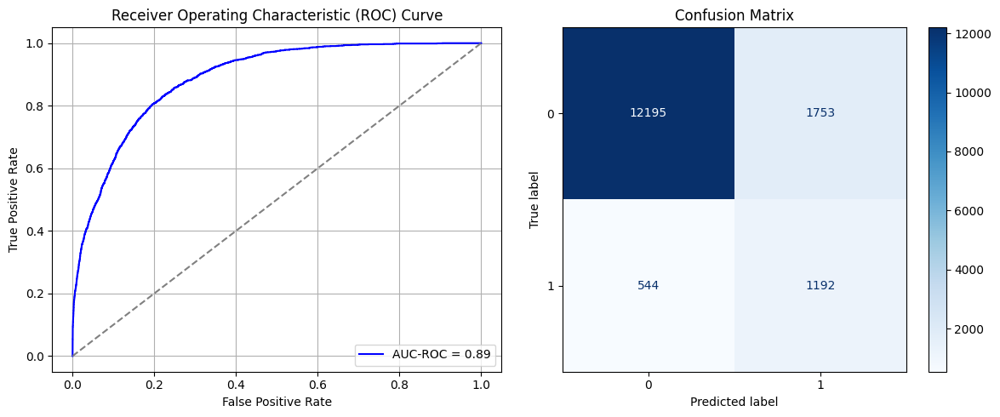

Best threshold based on F1-score: 0.5341132879257202
False Negative Rate: 0.31336405529953915
Time elapsed (performance): 1.8830174089998764
(np.float64(0.1256811012331517), np.float64(0.8743188987668483))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7291 - loss: 0.6098 - val_AUC: 0.8623 - val_loss: 0.4677
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8687 - loss: 0.4541 - val_AUC: 0.8701 - val_loss: 0.4491
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8699 - loss: 0.4467 - val_AUC: 0.8681 - val_loss: 0.4491
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8782 - loss: 0.4318 - val_AUC: 0.8719 - val_loss: 0.4413
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8802 - loss: 0.4299 - val_AUC: 0.8703 - val_loss: 0.4545
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8722 - loss: 0.4404 - val_AUC: 0.8719 - val_loss: 0.4600
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4331 - val_AUC: 0.8733 - val_loss: 0.4381
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8782 - loss: 0.4330 - val_AUC: 0.8707 - val_loss: 0.4500
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 -

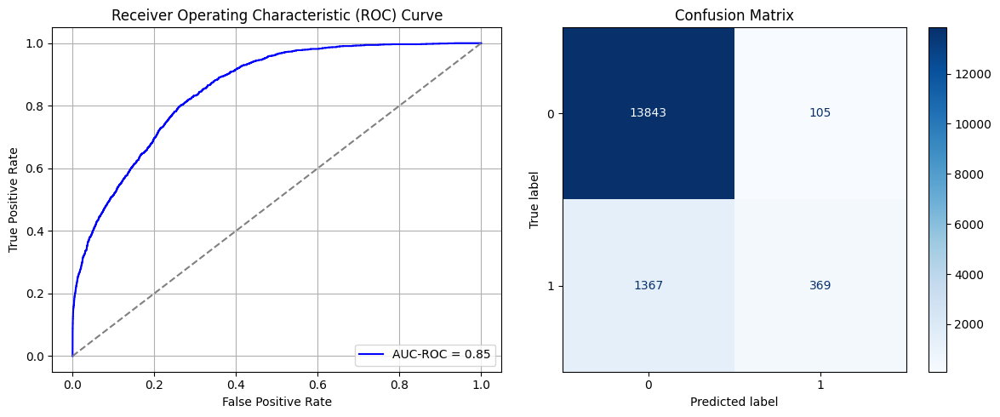

Best threshold based on F1-score: 0.22905659675598145
False Negative Rate: 0.7874423963133641
Time elapsed (performance): 1.7164522530001705
(np.float64(0.007527960997992544), np.float64(0.9924720390020074))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7288 - loss: 0.6183 - val_AUC: 0.8446 - val_loss: 0.4846
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8535 - loss: 0.4745 - val_AUC: 0.8614 - val_loss: 0.4564
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8701 - loss: 0.4469 - val_AUC: 0.8668 - val_loss: 0.4616
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8784 - loss: 0.4327 - val_AUC: 0.8686 - val_loss: 0.4447
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8789 - loss: 0.4311 - val_AUC: 0.8701 - val_loss: 0.4428
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 - loss: 0.4322 - val_AUC: 0.8702 - val_loss: 0.4651
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8740 - loss: 0.4377 - val_AUC: 0.8720 - val_loss: 0.4449
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8757 - loss: 0.4362 - val_AUC: 0.8708 - val_loss: 0.4612
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 -

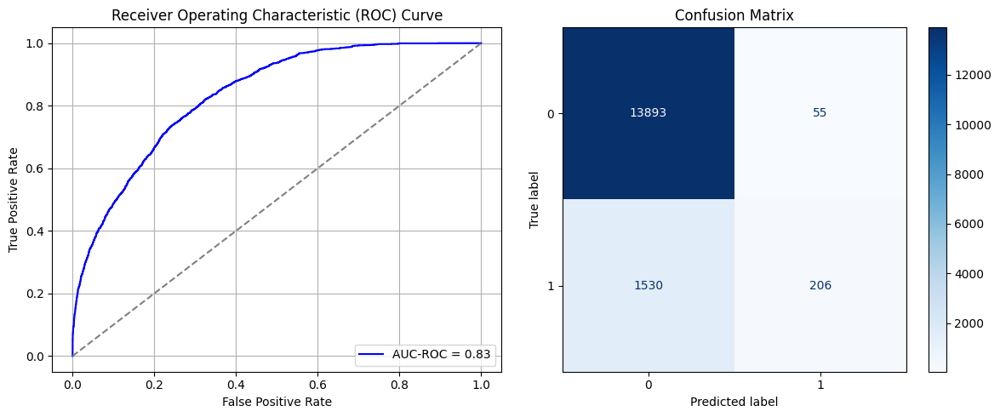

Best threshold based on F1-score: 0.07421864569187164
False Negative Rate: 0.881336405529954
Time elapsed (performance): 1.683246878999853
(np.float64(0.003943217665615142), np.float64(0.9960567823343849))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7505 - loss: 0.6117 - val_AUC: 0.8702 - val_loss: 0.4593
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8649 - loss: 0.4579 - val_AUC: 0.8796 - val_loss: 0.4318
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8673 - loss: 0.4475 - val_AUC: 0.8776 - val_loss: 0.4363
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8755 - loss: 0.4356 - val_AUC: 0.8800 - val_loss: 0.4537
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8734 - loss: 0.4399 - val_AUC: 0.8799 - val_loss: 0.4296
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4365 - val_AUC: 0.8786 - val_loss: 0.4308
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8707 - loss: 0.4436 - val_AUC: 0.8797 - val_loss: 0.4312
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8809 - loss: 0.4273 - val_AUC: 0.8817 - val_loss: 0.4252
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 -

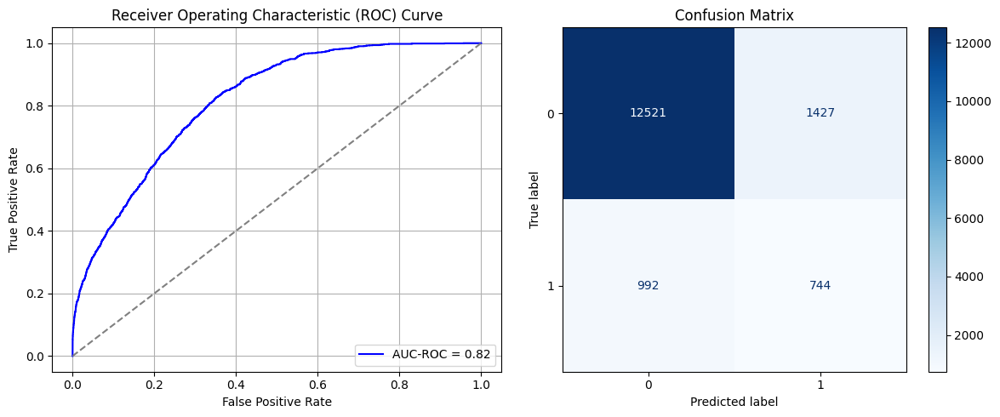

Best threshold based on F1-score: 0.5348058938980103
False Negative Rate: 0.5714285714285714
Time elapsed (performance): 1.6735668279998208
(np.float64(0.10230857470605105), np.float64(0.897691425293949))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7506 - loss: 0.6061 - val_AUC: 0.8520 - val_loss: 0.4822
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8658 - loss: 0.4567 - val_AUC: 0.8655 - val_loss: 0.4697
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8640 - loss: 0.4555 - val_AUC: 0.8700 - val_loss: 0.4446
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8726 - loss: 0.4417 - val_AUC: 0.8710 - val_loss: 0.4486
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4307 - val_AUC: 0.8712 - val_loss: 0.4456
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8714 - val_loss: 0.4438
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8803 - loss: 0.4271 - val_AUC: 0.8725 - val_loss: 0.4395
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4321 - val_AUC: 0.8735 - val_loss: 0.4377
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8810 -

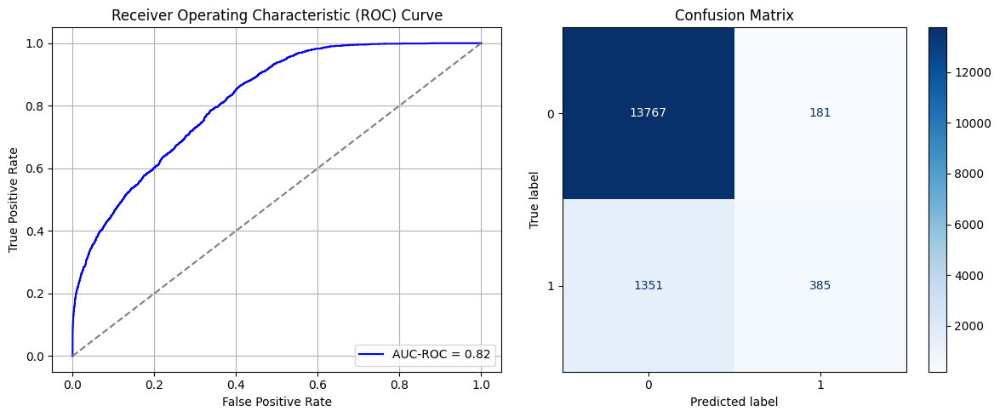

Best threshold based on F1-score: 0.22185871005058289
False Negative Rate: 0.7782258064516129
Time elapsed (performance): 1.6629630269999325
(np.float64(0.012976770863206194), np.float64(0.9870232291367939))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7068 - loss: 0.6258 - val_AUC: 0.8545 - val_loss: 0.4960
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8645 - loss: 0.4595 - val_AUC: 0.8687 - val_loss: 0.4576
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4427 - val_AUC: 0.8706 - val_loss: 0.4447
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.4341 - val_AUC: 0.8728 - val_loss: 0.4480
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4377 - val_AUC: 0.8738 - val_loss: 0.4382
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8716 - loss: 0.4408 - val_AUC: 0.8730 - val_loss: 0.4434
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8812 - loss: 0.4265 - val_AUC: 0.8731 - val_loss: 0.4437
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8802 - loss: 0.4276 - val_AUC: 0.8720 - val_loss: 0.4473
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 -

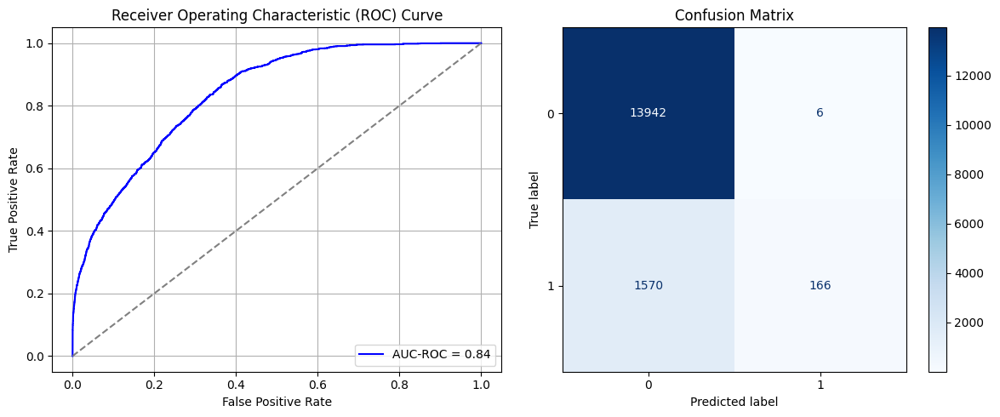

Best threshold based on F1-score: 0.04564264044165611
False Negative Rate: 0.9043778801843319
Time elapsed (performance): 1.6892448680009693
(np.float64(0.0004301691998852882), np.float64(0.9995698308001147))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7668 - loss: 0.6079 - val_AUC: 0.8561 - val_loss: 0.4755
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8617 - loss: 0.4626 - val_AUC: 0.8681 - val_loss: 0.4536
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8747 - loss: 0.4377 - val_AUC: 0.8693 - val_loss: 0.4443
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8704 - loss: 0.4451 - val_AUC: 0.8714 - val_loss: 0.4443
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8757 - loss: 0.4362 - val_AUC: 0.8730 - val_loss: 0.4395
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4277 - val_AUC: 0.8724 - val_loss: 0.4396
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4323 - val_AUC: 0.8725 - val_loss: 0.4388
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4312 - val_AUC: 0.8737 - val_loss: 0.4382
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 -

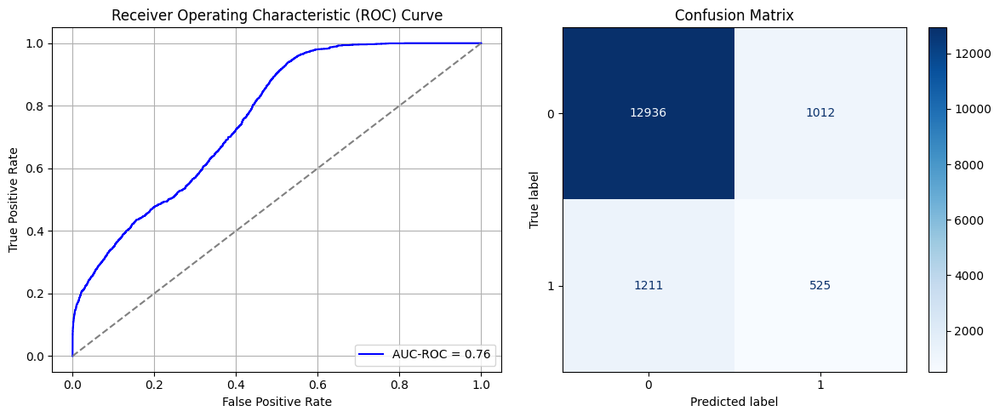

Best threshold based on F1-score: 0.38034918904304504
False Negative Rate: 0.6975806451612904
Time elapsed (performance): 1.4411190940008964
(np.float64(0.07255520504731862), np.float64(0.9274447949526814))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7302 - loss: 0.6160 - val_AUC: 0.8569 - val_loss: 0.4743
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8503 - loss: 0.4780 - val_AUC: 0.8766 - val_loss: 0.4388
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8691 - loss: 0.4477 - val_AUC: 0.8794 - val_loss: 0.4372
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4435 - val_AUC: 0.8789 - val_loss: 0.4316
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8759 - loss: 0.4371 - val_AUC: 0.8790 - val_loss: 0.4311
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4389 - val_AUC: 0.8789 - val_loss: 0.4424
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8715 - loss: 0.4440 - val_AUC: 0.8795 - val_loss: 0.4414
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8782 - loss: 0.4326 - val_AUC: 0.8784 - val_loss: 0.4339
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 -

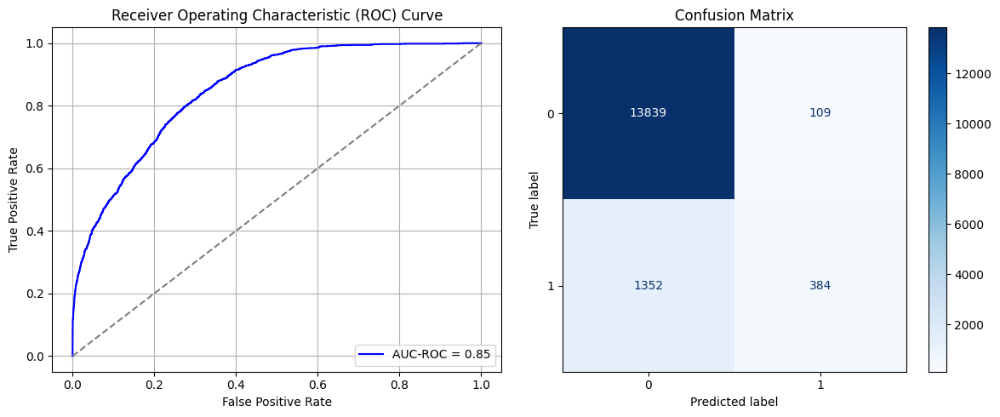

Best threshold based on F1-score: 0.19394069910049438
False Negative Rate: 0.7788018433179723
Time elapsed (performance): 1.463245442000698
(np.float64(0.007814740464582736), np.float64(0.9921852595354173))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7375 - loss: 0.6166 - val_AUC: 0.8587 - val_loss: 0.4746
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8520 - loss: 0.4765 - val_AUC: 0.8765 - val_loss: 0.4406
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4420 - val_AUC: 0.8774 - val_loss: 0.4354
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4399 - val_AUC: 0.8788 - val_loss: 0.4378
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8726 - loss: 0.4420 - val_AUC: 0.8787 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8741 - loss: 0.4395 - val_AUC: 0.8789 - val_loss: 0.4324
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 - loss: 0.4271 - val_AUC: 0.8790 - val_loss: 0.4308
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4331 - val_AUC: 0.8786 - val_loss: 0.4304
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8819 -

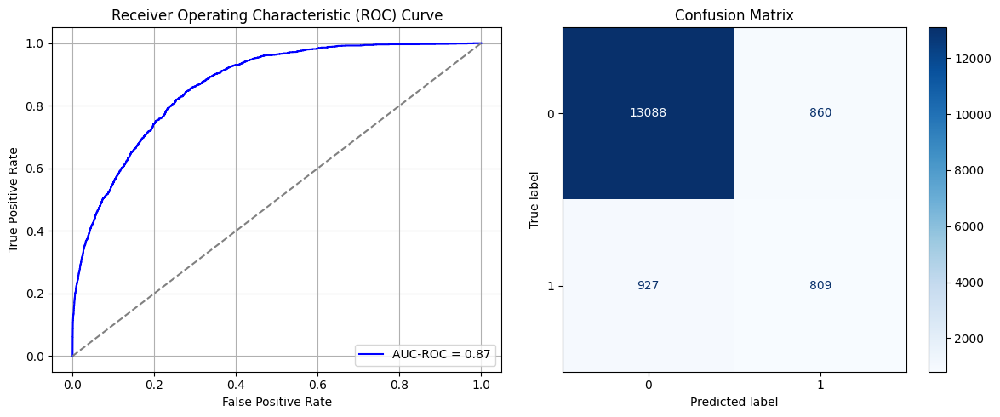

Best threshold based on F1-score: 0.46152186393737793
False Negative Rate: 0.5339861751152074
Time elapsed (performance): 1.4579782479995629
(np.float64(0.06165758531689131), np.float64(0.9383424146831086))
    Source time       FPR       TNR       FNR       TPR  Target time
0     17.672478  0.071910  0.928090  0.383641  0.616359     1.132478
1     16.676453  0.014482  0.985518  0.751152  0.248848     1.170054
2     14.218497  0.001219  0.998781  0.911290  0.088710     1.826110
3     15.735478  0.003872  0.996128  0.853111  0.146889     1.180531
4     15.604301  0.293877  0.706123  0.226959  0.773041     1.668409
5     16.852791  0.070691  0.929309  0.521889  0.478111     1.213780
6     18.226328  0.009966  0.990034  0.784562  0.215438     1.211382
7     16.639699  0.010826  0.989174  0.735023  0.264977     1.230208
8     19.288835  0.354890  0.645110  0.101382  0.898618     1.408767
9     19.093640  0.024376  0.975624  0.713710  0.286290     1.673129
10    16.455886  0.000789  0.99921

In [95]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [96]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     17.672478  0.071910  0.928090  0.383641  0.616359     1.132478
1     16.676453  0.014482  0.985518  0.751152  0.248848     1.170054
2     14.218497  0.001219  0.998781  0.911290  0.088710     1.826110
3     15.735478  0.003872  0.996128  0.853111  0.146889     1.180531
4     15.604301  0.293877  0.706123  0.226959  0.773041     1.668409
5     16.852791  0.070691  0.929309  0.521889  0.478111     1.213780
6     18.226328  0.009966  0.990034  0.784562  0.215438     1.211382
7     16.639699  0.010826  0.989174  0.735023  0.264977     1.230208
8     19.288835  0.354890  0.645110  0.101382  0.898618     1.408767
9     19.093640  0.024376  0.975624  0.713710  0.286290     1.673129
10    16.455886  0.000789  0.999211  0.903226  0.096774     1.909751
11    16.021430  0.008102  0.991898  0.736751  0.263249     1.217875
12    17.572029  0.008173  0.991827  0.802419  0.197581     1.846871
13    22.771931  0.020075  0.97992

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

22.5721570627231
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7072 - loss: 0.6241 - val_AUC: 0.8628 - val_loss: 0.4719
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8547 - loss: 0.4728 - val_AUC: 0.8785 - val_loss: 0.4433
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8606 - loss: 0.4601 - val_AUC: 0.8804 - val_loss: 0.4395
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8672 - loss: 0.4480 - val_AUC: 0.8821 - val_loss: 0.4356
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4321 - val_AUC: 0.8827 - val_loss: 0.4312
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8724 - loss: 0.4416 - val_AUC: 0.8835 - val_loss: 0.4281
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4374 - val_AUC: 0.8835 - val_loss: 0.4277
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4381 - val_AUC: 0.8847 - val_loss: 0.4256
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8705 -

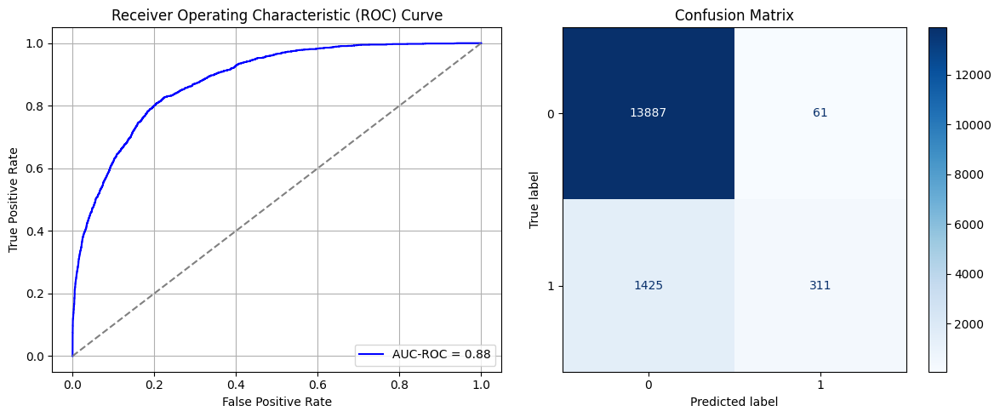

Best threshold based on F1-score: 0.08675670623779297
False Negative Rate: 0.820852534562212
Time elapsed (performance): 1.1621524679994764
(np.float64(0.00437338686550043), np.float64(0.9956266131344995))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7173 - loss: 0.6171 - val_AUC: 0.8699 - val_loss: 0.4661
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8577 - loss: 0.4673 - val_AUC: 0.8814 - val_loss: 0.4336
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 - loss: 0.4462 - val_AUC: 0.8828 - val_loss: 0.4313
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8673 - loss: 0.4496 - val_AUC: 0.8829 - val_loss: 0.4284
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4393 - val_AUC: 0.8842 - val_loss: 0.4307
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8660 - loss: 0.4493 - val_AUC: 0.8838 - val_loss: 0.4359
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8738 - loss: 0.4396 - val_AUC: 0.8843 - val_loss: 0.4247
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8704 - loss: 0.4448 - val_AUC: 0.8848 - val_loss: 0.4237
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 -

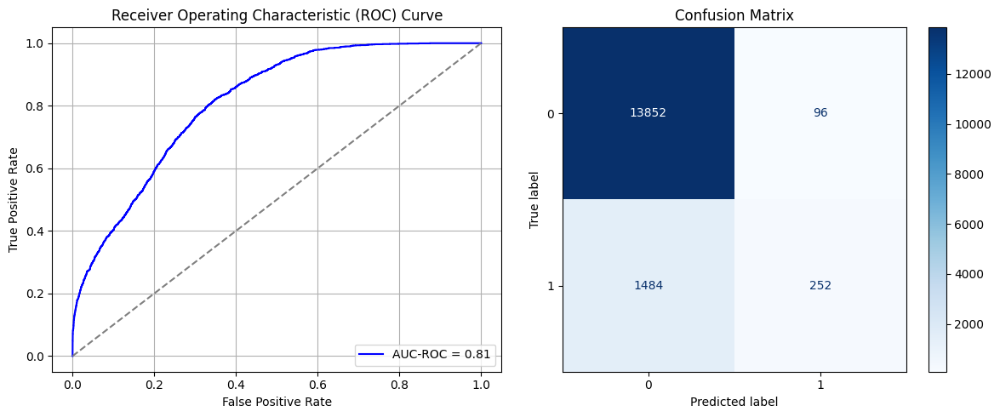

Best threshold based on F1-score: 0.050390809774398804
False Negative Rate: 0.8548387096774194
Time elapsed (performance): 1.8124563780002063
(np.float64(0.0068827071981646115), np.float64(0.9931172928018354))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7322 - loss: 0.6146 - val_AUC: 0.8599 - val_loss: 0.4764
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8635 - loss: 0.4623 - val_AUC: 0.8713 - val_loss: 0.4463
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4462 - val_AUC: 0.8732 - val_loss: 0.4478
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8785 - loss: 0.4315 - val_AUC: 0.8750 - val_loss: 0.4450
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8800 - loss: 0.4304 - val_AUC: 0.8746 - val_loss: 0.4401
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4375 - val_AUC: 0.8755 - val_loss: 0.4407
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8728 - loss: 0.4408 - val_AUC: 0.8747 - val_loss: 0.4491
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8781 - loss: 0.4321 - val_AUC: 0.8763 - val_loss: 0.4392
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8829 -

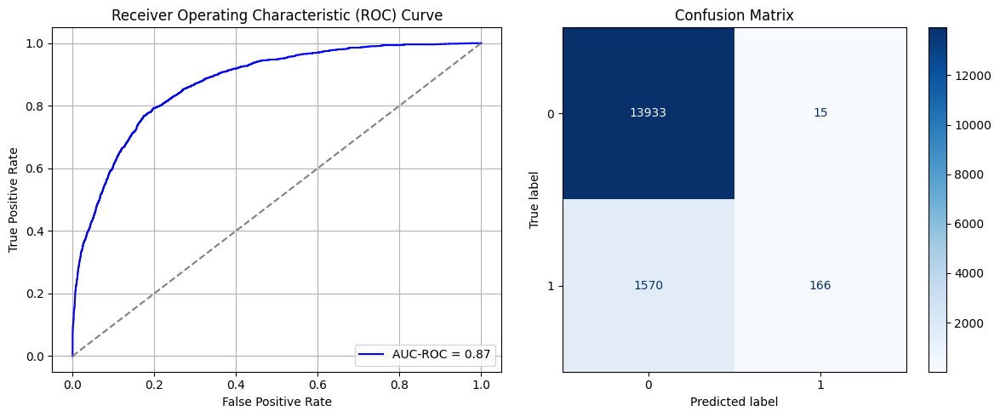

Best threshold based on F1-score: 0.06077270954847336
False Negative Rate: 0.9043778801843319
Time elapsed (performance): 1.2998814250004216
(np.float64(0.0010754229997132205), np.float64(0.9989245770002868))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7383 - loss: 0.6075 - val_AUC: 0.8656 - val_loss: 0.4657
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8578 - loss: 0.4661 - val_AUC: 0.8802 - val_loss: 0.4362
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8692 - loss: 0.4467 - val_AUC: 0.8814 - val_loss: 0.4342
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8689 - loss: 0.4465 - val_AUC: 0.8837 - val_loss: 0.4312
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4367 - val_AUC: 0.8840 - val_loss: 0.4271
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4306 - val_AUC: 0.8855 - val_loss: 0.4313
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8754 - loss: 0.4357 - val_AUC: 0.8853 - val_loss: 0.4319
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4367 - val_AUC: 0.8856 - val_loss: 0.4264
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 -

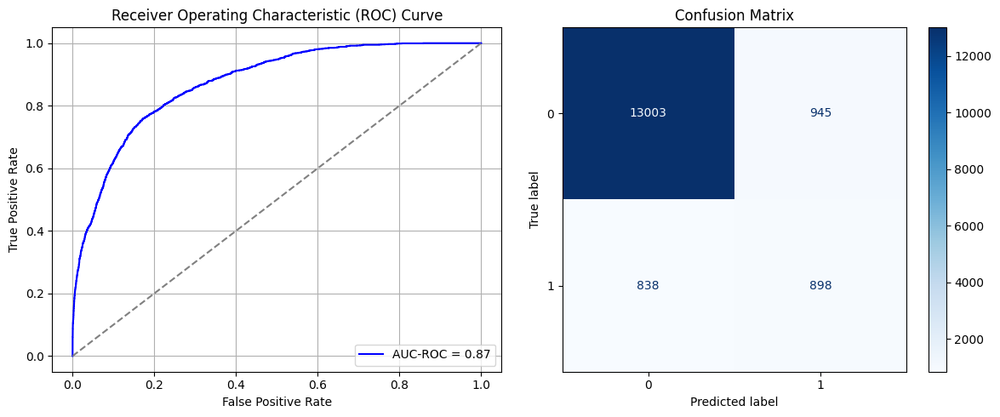

Best threshold based on F1-score: 0.45686519145965576
False Negative Rate: 0.4827188940092166
Time elapsed (performance): 1.7809645679990354
(np.float64(0.0677516489819329), np.float64(0.9322483510180671))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7225 - loss: 0.6122 - val_AUC: 0.8576 - val_loss: 0.4792
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8576 - loss: 0.4685 - val_AUC: 0.8729 - val_loss: 0.4545
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8722 - loss: 0.4422 - val_AUC: 0.8760 - val_loss: 0.4468
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4401 - val_AUC: 0.8768 - val_loss: 0.4439
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4378 - val_AUC: 0.8768 - val_loss: 0.4376
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4335 - val_AUC: 0.8770 - val_loss: 0.4413
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4337 - val_AUC: 0.8766 - val_loss: 0.4374
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8785 - loss: 0.4315 - val_AUC: 0.8762 - val_loss: 0.4404
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 -

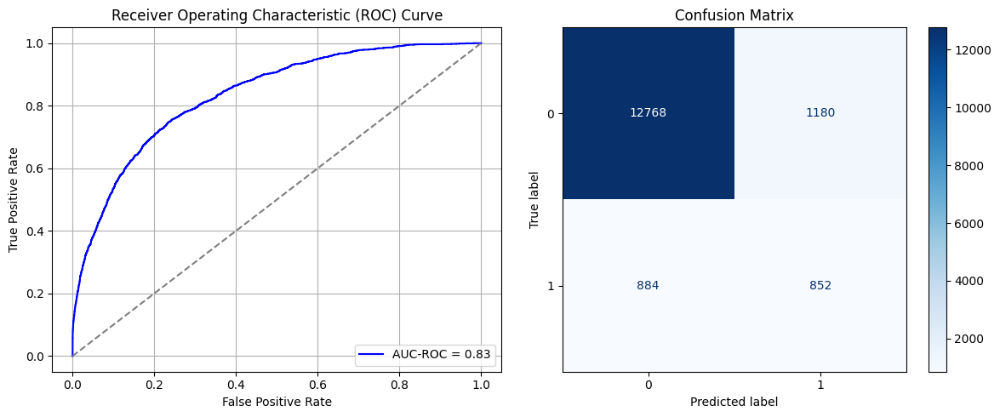

Best threshold based on F1-score: 0.4540904760360718
False Negative Rate: 0.5092165898617511
Time elapsed (performance): 1.1967779060014436
(np.float64(0.08459994264410668), np.float64(0.9154000573558934))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7459 - loss: 0.6094 - val_AUC: 0.8625 - val_loss: 0.4673
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8543 - loss: 0.4709 - val_AUC: 0.8760 - val_loss: 0.4378
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4429 - val_AUC: 0.8761 - val_loss: 0.4753
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 - loss: 0.4400 - val_AUC: 0.8775 - val_loss: 0.4426
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4359 - val_AUC: 0.8788 - val_loss: 0.4347
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4308 - val_AUC: 0.8787 - val_loss: 0.4320
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4293 - val_AUC: 0.8777 - val_loss: 0.4398
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4329 - val_AUC: 0.8788 - val_loss: 0.4366
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 -

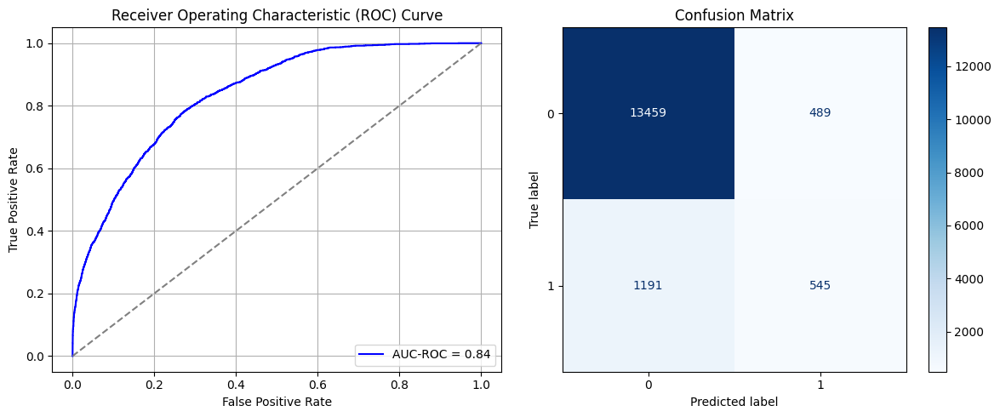

Best threshold based on F1-score: 0.2309642881155014
False Negative Rate: 0.6860599078341014
Time elapsed (performance): 1.1889806409999437
(np.float64(0.03505878979065099), np.float64(0.964941210209349))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7612 - loss: 0.6059 - val_AUC: 0.8645 - val_loss: 0.4668
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8620 - loss: 0.4619 - val_AUC: 0.8768 - val_loss: 0.4438
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8671 - loss: 0.4511 - val_AUC: 0.8785 - val_loss: 0.4345
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4358 - val_AUC: 0.8795 - val_loss: 0.4322
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4407 - val_AUC: 0.8802 - val_loss: 0.4356
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4338 - val_AUC: 0.8812 - val_loss: 0.4487
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8720 - loss: 0.4385 - val_AUC: 0.8806 - val_loss: 0.4286
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4482 - val_AUC: 0.8821 - val_loss: 0.4276
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 -

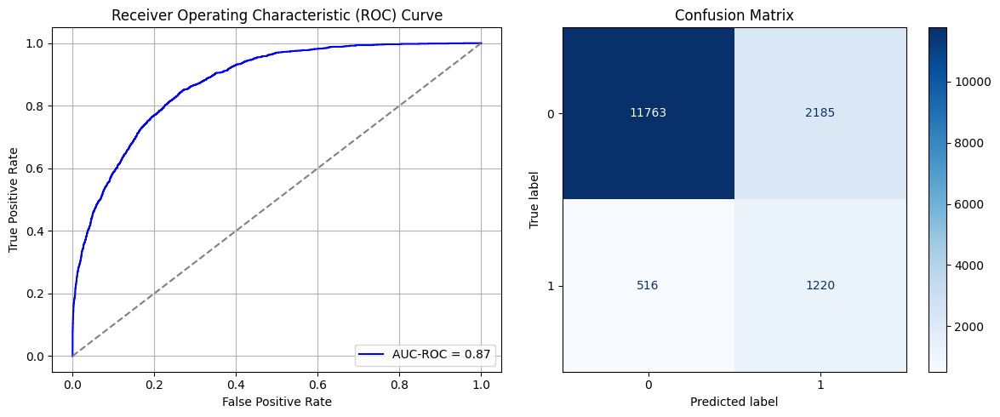

Best threshold based on F1-score: 0.6836878061294556
False Negative Rate: 0.29723502304147464
Time elapsed (performance): 4.681395175000944
(np.float64(0.15665328362489245), np.float64(0.8433467163751076))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7424 - loss: 0.6092 - val_AUC: 0.8619 - val_loss: 0.4928
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8557 - loss: 0.4752 - val_AUC: 0.8736 - val_loss: 0.4621
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8707 - loss: 0.4447 - val_AUC: 0.8746 - val_loss: 0.4442
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4417 - val_AUC: 0.8781 - val_loss: 0.4371
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4381 - val_AUC: 0.8774 - val_loss: 0.4360
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4347 - val_AUC: 0.8770 - val_loss: 0.4395
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8751 - loss: 0.4362 - val_AUC: 0.8785 - val_loss: 0.4370
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8727 - loss: 0.4388 - val_AUC: 0.8769 - val_loss: 0.4518
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 -

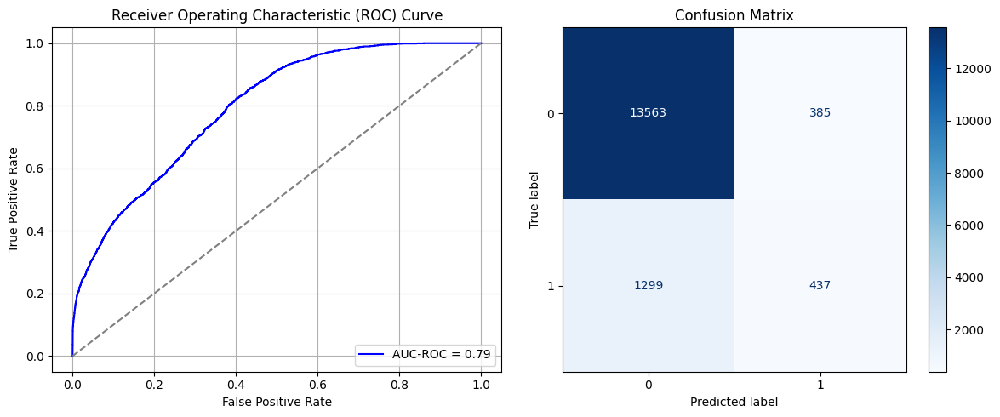

Best threshold based on F1-score: 0.3035608232021332
False Negative Rate: 0.7482718894009217
Time elapsed (performance): 1.2663964559997112
(np.float64(0.027602523659305992), np.float64(0.972397476340694))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6886 - loss: 0.6281 - val_AUC: 0.8490 - val_loss: 0.4840
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8442 - loss: 0.4848 - val_AUC: 0.8729 - val_loss: 0.4440
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8615 - loss: 0.4570 - val_AUC: 0.8761 - val_loss: 0.4384
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4406 - val_AUC: 0.8774 - val_loss: 0.4398
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8687 - loss: 0.4460 - val_AUC: 0.8780 - val_loss: 0.4368
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4406 - val_AUC: 0.8798 - val_loss: 0.4457
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8807 - loss: 0.4266 - val_AUC: 0.8800 - val_loss: 0.4327
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4361 - val_AUC: 0.8815 - val_loss: 0.4288
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 -

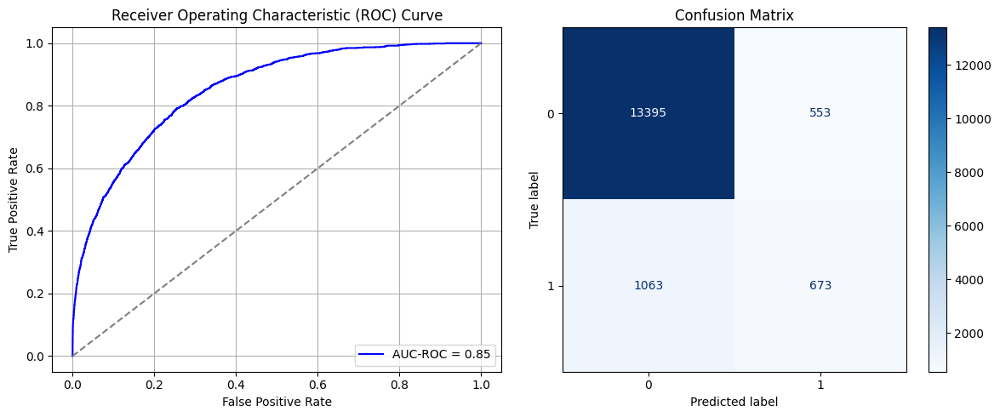

Best threshold based on F1-score: 0.40381503105163574
False Negative Rate: 0.6123271889400922
Time elapsed (performance): 1.8885373519988207
(np.float64(0.039647261256094066), np.float64(0.9603527387439059))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7150 - loss: 0.6253 - val_AUC: 0.8468 - val_loss: 0.4892
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8487 - loss: 0.4817 - val_AUC: 0.8758 - val_loss: 0.4432
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8697 - loss: 0.4459 - val_AUC: 0.8787 - val_loss: 0.4349
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4354 - val_AUC: 0.8788 - val_loss: 0.4394
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8741 - loss: 0.4389 - val_AUC: 0.8796 - val_loss: 0.4338
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8709 - loss: 0.4430 - val_AUC: 0.8784 - val_loss: 0.4374
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8769 - loss: 0.4317 - val_AUC: 0.8782 - val_loss: 0.4339
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8754 - loss: 0.4355 - val_AUC: 0.8814 - val_loss: 0.4287
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8726 -

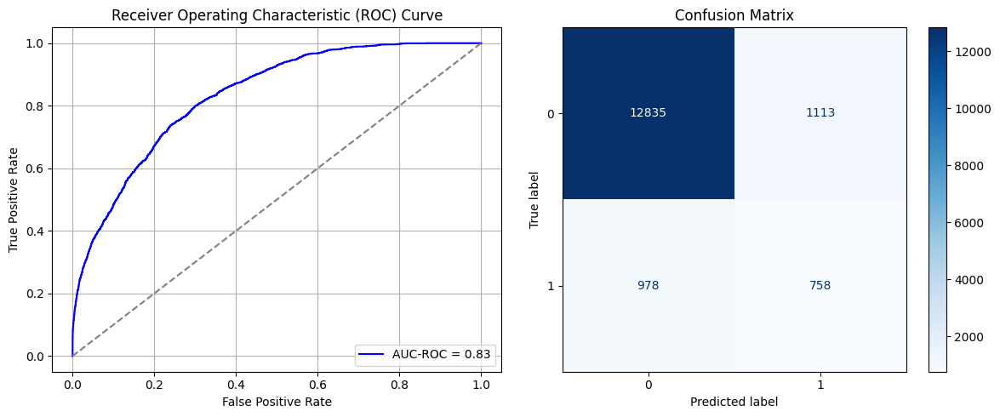

Best threshold based on F1-score: 0.3777324855327606
False Negative Rate: 0.5633640552995391
Time elapsed (performance): 1.2678369450004539
(np.float64(0.07979638657872096), np.float64(0.920203613421279))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7332 - loss: 0.6159 - val_AUC: 0.8550 - val_loss: 0.4822
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8571 - loss: 0.4721 - val_AUC: 0.8714 - val_loss: 0.4457
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8702 - loss: 0.4469 - val_AUC: 0.8729 - val_loss: 0.4437
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8736 - loss: 0.4400 - val_AUC: 0.8730 - val_loss: 0.4424
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4433 - val_AUC: 0.8752 - val_loss: 0.4402
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8671 - loss: 0.4503 - val_AUC: 0.8759 - val_loss: 0.4425
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4342 - val_AUC: 0.8756 - val_loss: 0.4630
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8668 - loss: 0.4497 - val_AUC: 0.8768 - val_loss: 0.4367
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8745 -

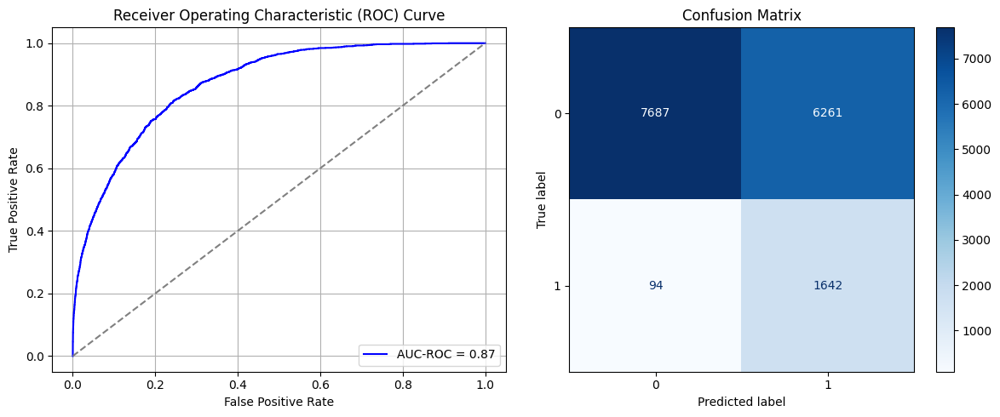

Best threshold based on F1-score: 0.8538873195648193
False Negative Rate: 0.05414746543778802
Time elapsed (performance): 1.7080820410010347
(np.float64(0.4488815600802982), np.float64(0.5511184399197018))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7449 - loss: 0.6106 - val_AUC: 0.8557 - val_loss: 0.5010
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8519 - loss: 0.4757 - val_AUC: 0.8706 - val_loss: 0.4473
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.4440 - val_AUC: 0.8731 - val_loss: 0.4466
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8688 - loss: 0.4442 - val_AUC: 0.8742 - val_loss: 0.4401
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8696 - loss: 0.4448 - val_AUC: 0.8732 - val_loss: 0.4440
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8703 - loss: 0.4419 - val_AUC: 0.8747 - val_loss: 0.4401
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4321 - val_AUC: 0.8756 - val_loss: 0.4380
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4360 - val_AUC: 0.8737 - val_loss: 0.4411
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8679 -

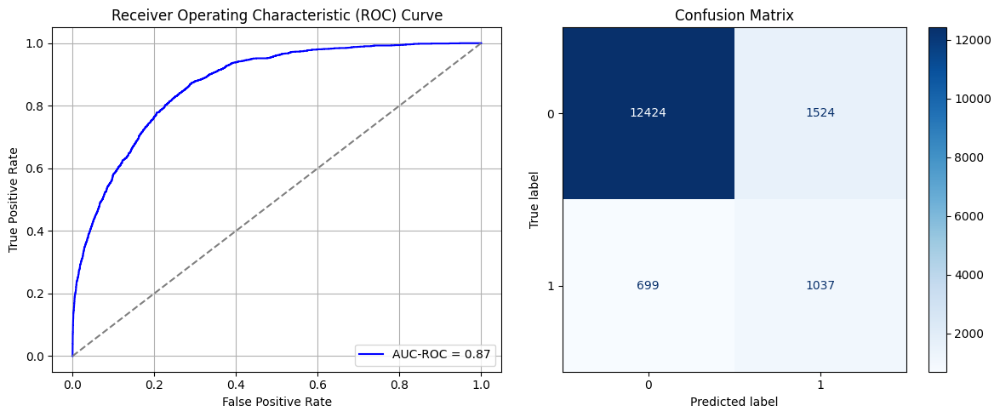

Best threshold based on F1-score: 0.517631471157074
False Negative Rate: 0.40264976958525345
Time elapsed (performance): 1.6821302799999103
(np.float64(0.1092629767708632), np.float64(0.8907370232291368))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7421 - loss: 0.6136 - val_AUC: 0.8691 - val_loss: 0.4553
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8627 - loss: 0.4587 - val_AUC: 0.8744 - val_loss: 0.4642
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4346 - val_AUC: 0.8775 - val_loss: 0.4485
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8772 - loss: 0.4339 - val_AUC: 0.8774 - val_loss: 0.4480
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8690 - loss: 0.4449 - val_AUC: 0.8796 - val_loss: 0.4311
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8782 - loss: 0.4323 - val_AUC: 0.8800 - val_loss: 0.4309
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4356 - val_AUC: 0.8811 - val_loss: 0.4287
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8833 - loss: 0.4241 - val_AUC: 0.8808 - val_loss: 0.4300
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 -

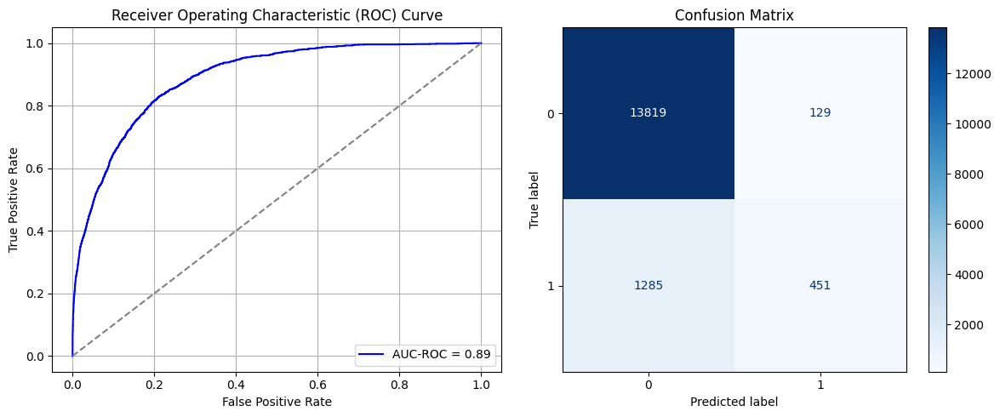

Best threshold based on F1-score: 0.1821342259645462
False Negative Rate: 0.7402073732718893
Time elapsed (performance): 1.2866503179993742
(np.float64(0.009248637797533696), np.float64(0.9907513622024663))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7320 - loss: 0.6080 - val_AUC: 0.8598 - val_loss: 0.4752
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8550 - loss: 0.4716 - val_AUC: 0.8804 - val_loss: 0.4364
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8644 - loss: 0.4537 - val_AUC: 0.8843 - val_loss: 0.4324
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8650 - loss: 0.4507 - val_AUC: 0.8845 - val_loss: 0.4271
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4432 - val_AUC: 0.8850 - val_loss: 0.4248
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4393 - val_AUC: 0.8855 - val_loss: 0.4237
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4361 - val_AUC: 0.8852 - val_loss: 0.4255
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4397 - val_AUC: 0.8855 - val_loss: 0.4250
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 -

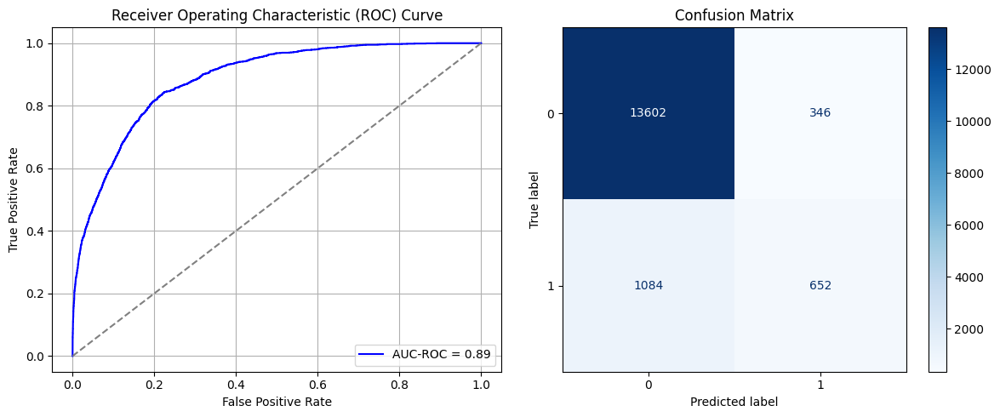

Best threshold based on F1-score: 0.27093738317489624
False Negative Rate: 0.6244239631336406
Time elapsed (performance): 1.5786269500003982
(np.float64(0.02480642386005162), np.float64(0.9751935761399484))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7625 - loss: 0.6028 - val_AUC: 0.8632 - val_loss: 0.4753
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8608 - loss: 0.4638 - val_AUC: 0.8720 - val_loss: 0.4502
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8671 - loss: 0.4496 - val_AUC: 0.8727 - val_loss: 0.4594
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8688 - loss: 0.4465 - val_AUC: 0.8756 - val_loss: 0.4395
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8662 - loss: 0.4491 - val_AUC: 0.8760 - val_loss: 0.4400
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8717 - loss: 0.4417 - val_AUC: 0.8767 - val_loss: 0.4374
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8813 - loss: 0.4276 - val_AUC: 0.8768 - val_loss: 0.4396
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4376 - val_AUC: 0.8774 - val_loss: 0.4371
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8755 -

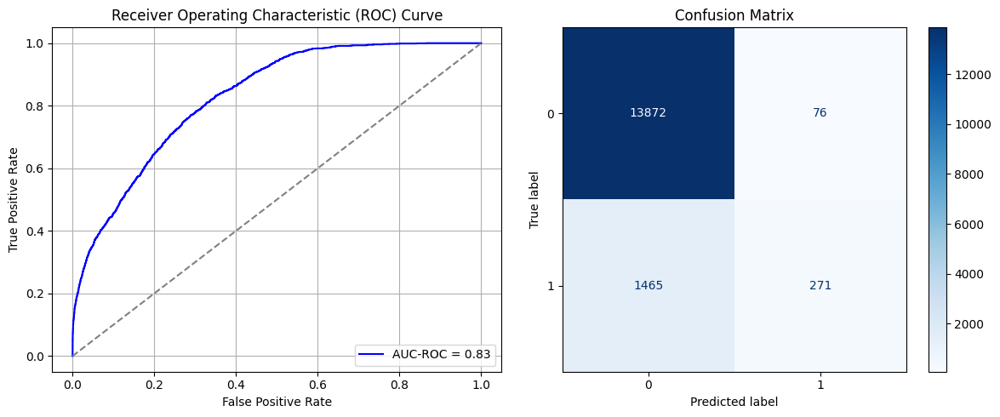

Best threshold based on F1-score: 0.1779891550540924
False Negative Rate: 0.8438940092165899
Time elapsed (performance): 1.6875672260011925
(np.float64(0.0054488098652136505), np.float64(0.9945511901347863))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7290 - loss: 0.6142 - val_AUC: 0.8591 - val_loss: 0.4910
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8568 - loss: 0.4664 - val_AUC: 0.8772 - val_loss: 0.4418
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8689 - loss: 0.4470 - val_AUC: 0.8790 - val_loss: 0.4324
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4400 - val_AUC: 0.8796 - val_loss: 0.4353
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8732 - loss: 0.4386 - val_AUC: 0.8800 - val_loss: 0.4318
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8749 - loss: 0.4363 - val_AUC: 0.8795 - val_loss: 0.4442
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8763 - loss: 0.4344 - val_AUC: 0.8819 - val_loss: 0.4317
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8713 - loss: 0.4399 - val_AUC: 0.8814 - val_loss: 0.4345
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8803 -

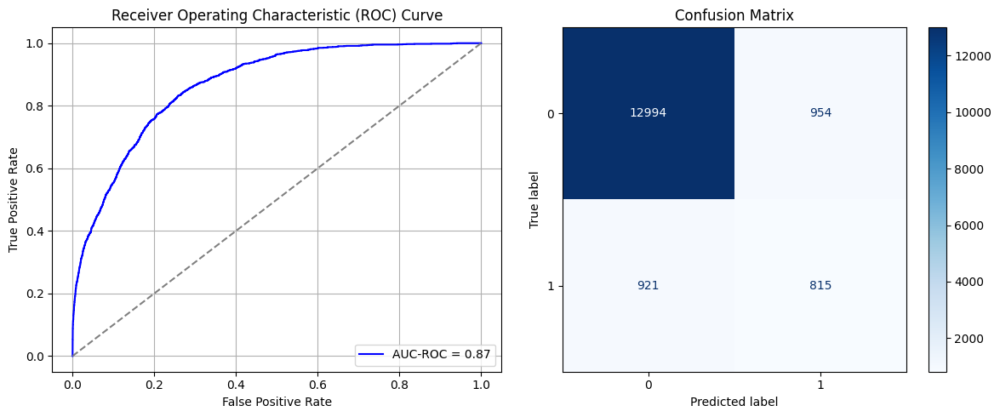

Best threshold based on F1-score: 0.4036271870136261
False Negative Rate: 0.5305299539170507
Time elapsed (performance): 1.6926367249998293
(np.float64(0.06839690278176083), np.float64(0.9316030972182392))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7392 - loss: 0.6126 - val_AUC: 0.8579 - val_loss: 0.4768
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8634 - loss: 0.4616 - val_AUC: 0.8720 - val_loss: 0.4542
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8688 - loss: 0.4465 - val_AUC: 0.8753 - val_loss: 0.4394
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4364 - val_AUC: 0.8750 - val_loss: 0.4525
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8783 - loss: 0.4314 - val_AUC: 0.8776 - val_loss: 0.4351
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8746 - loss: 0.4364 - val_AUC: 0.8760 - val_loss: 0.4376
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4281 - val_AUC: 0.8776 - val_loss: 0.4353
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8819 - loss: 0.4252 - val_AUC: 0.8782 - val_loss: 0.4335
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8834 -

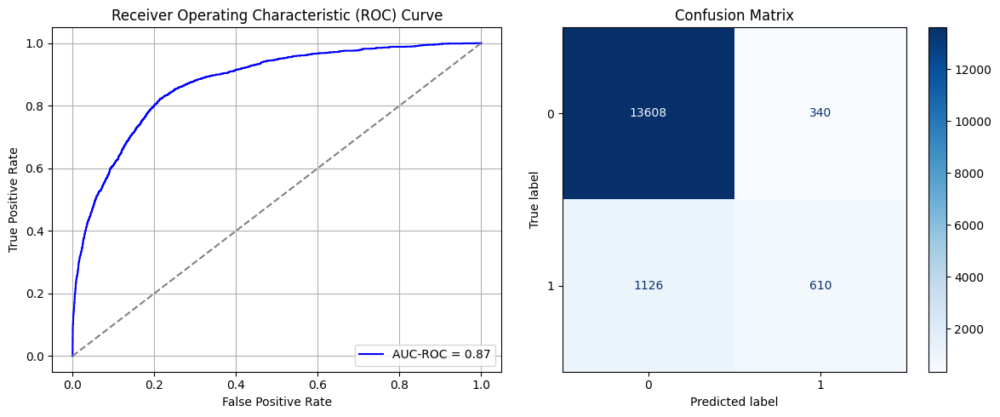

Best threshold based on F1-score: 0.3346324563026428
False Negative Rate: 0.6486175115207373
Time elapsed (performance): 1.2617911260003893
(np.float64(0.02437625466016633), np.float64(0.9756237453398336))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7252 - loss: 0.6244 - val_AUC: 0.8470 - val_loss: 0.4931
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8452 - loss: 0.4876 - val_AUC: 0.8782 - val_loss: 0.4530
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8674 - loss: 0.4504 - val_AUC: 0.8810 - val_loss: 0.4335
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8676 - loss: 0.4470 - val_AUC: 0.8820 - val_loss: 0.4381
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8698 - loss: 0.4437 - val_AUC: 0.8823 - val_loss: 0.4481
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8709 - loss: 0.4431 - val_AUC: 0.8840 - val_loss: 0.4242
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8696 - loss: 0.4417 - val_AUC: 0.8839 - val_loss: 0.4324
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8758 - loss: 0.4344 - val_AUC: 0.8849 - val_loss: 0.4250
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 -

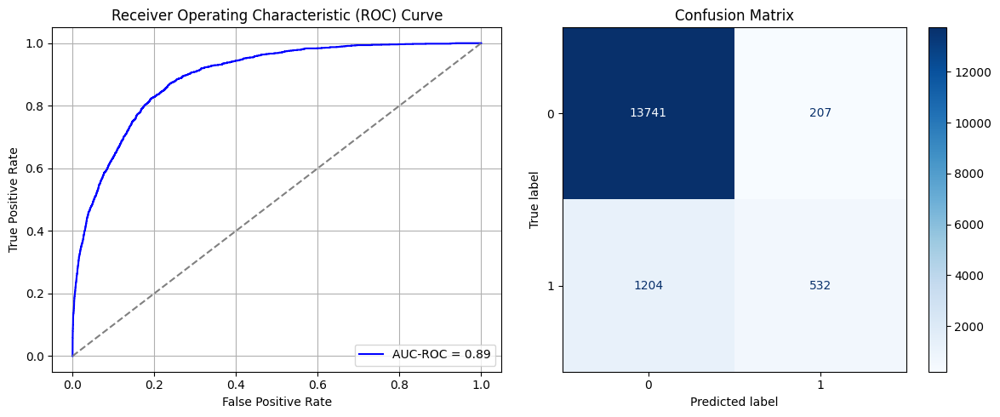

Best threshold based on F1-score: 0.23776228725910187
False Negative Rate: 0.6935483870967742
Time elapsed (performance): 1.2797443159997783
(np.float64(0.014840837396042443), np.float64(0.9851591626039575))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7041 - loss: 0.6244 - val_AUC: 0.8576 - val_loss: 0.4816
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8578 - loss: 0.4676 - val_AUC: 0.8742 - val_loss: 0.4469
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8668 - loss: 0.4503 - val_AUC: 0.8759 - val_loss: 0.4449
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4327 - val_AUC: 0.8763 - val_loss: 0.4408
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4301 - val_AUC: 0.8783 - val_loss: 0.4598
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8752 - loss: 0.4369 - val_AUC: 0.8787 - val_loss: 0.4322
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4387 - val_AUC: 0.8792 - val_loss: 0.4384
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4323 - val_AUC: 0.8793 - val_loss: 0.4438
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 -

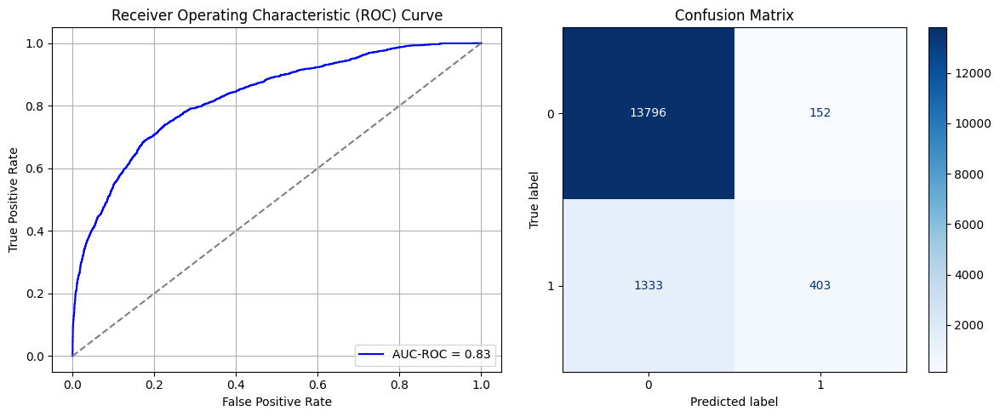

Best threshold based on F1-score: 0.19125215709209442
False Negative Rate: 0.7678571428571429
Time elapsed (performance): 1.2975805860005494
(np.float64(0.010897619730427301), np.float64(0.9891023802695726))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7219 - loss: 0.6124 - val_AUC: 0.8598 - val_loss: 0.4726
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8626 - loss: 0.4627 - val_AUC: 0.8740 - val_loss: 0.4436
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8679 - loss: 0.4506 - val_AUC: 0.8764 - val_loss: 0.4415
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8702 - loss: 0.4471 - val_AUC: 0.8773 - val_loss: 0.4476
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8744 - loss: 0.4399 - val_AUC: 0.8775 - val_loss: 0.4353
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 - loss: 0.4317 - val_AUC: 0.8780 - val_loss: 0.4474
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4380 - val_AUC: 0.8780 - val_loss: 0.4341
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4318 - val_AUC: 0.8788 - val_loss: 0.4405
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 -

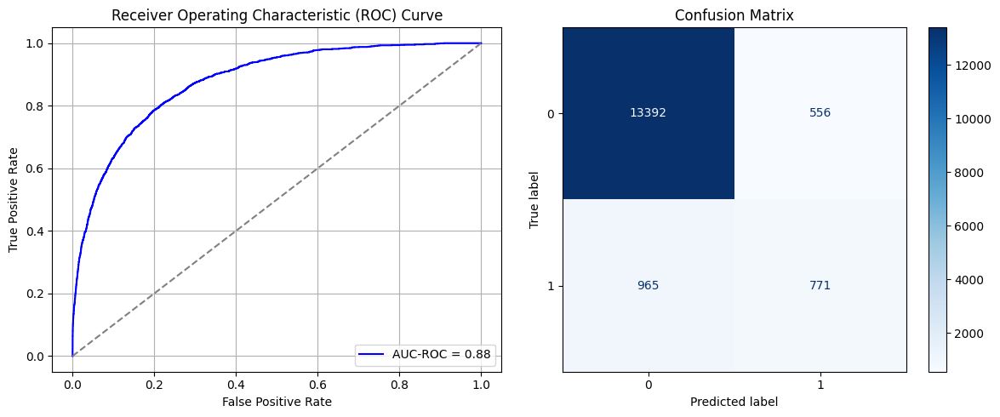

Best threshold based on F1-score: 0.41801562905311584
False Negative Rate: 0.5558755760368663
Time elapsed (performance): 1.7708437829987815
(np.float64(0.03986234585603671), np.float64(0.9601376541439632))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7215 - loss: 0.6280 - val_AUC: 0.8496 - val_loss: 0.4924
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8547 - loss: 0.4717 - val_AUC: 0.8663 - val_loss: 0.4515
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4330 - val_AUC: 0.8684 - val_loss: 0.4580
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4292 - val_AUC: 0.8704 - val_loss: 0.4505
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4399 - val_AUC: 0.8695 - val_loss: 0.4473
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4337 - val_AUC: 0.8707 - val_loss: 0.4448
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 - loss: 0.4304 - val_AUC: 0.8706 - val_loss: 0.4451
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.4390 - val_AUC: 0.8718 - val_loss: 0.4431
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 -

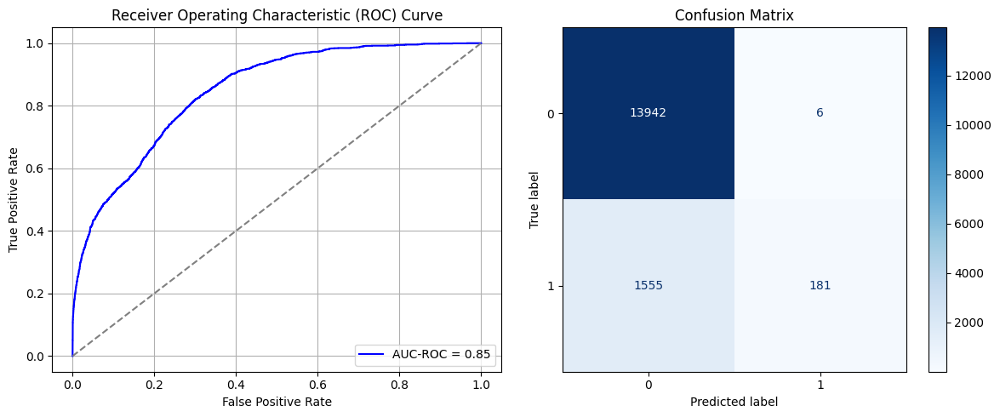

Best threshold based on F1-score: 0.04745238274335861
False Negative Rate: 0.8957373271889401
Time elapsed (performance): 1.3066129090002505
(np.float64(0.0004301691998852882), np.float64(0.9995698308001147))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7579 - loss: 0.6168 - val_AUC: 0.8635 - val_loss: 0.4755
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8567 - loss: 0.4703 - val_AUC: 0.8724 - val_loss: 0.4608
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8758 - loss: 0.4382 - val_AUC: 0.8752 - val_loss: 0.4517
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8727 - loss: 0.4409 - val_AUC: 0.8771 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8717 - loss: 0.4432 - val_AUC: 0.8773 - val_loss: 0.4380
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 - loss: 0.4252 - val_AUC: 0.8777 - val_loss: 0.4398
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4398 - val_AUC: 0.8780 - val_loss: 0.4375
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4333 - val_AUC: 0.8783 - val_loss: 0.4342
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 -

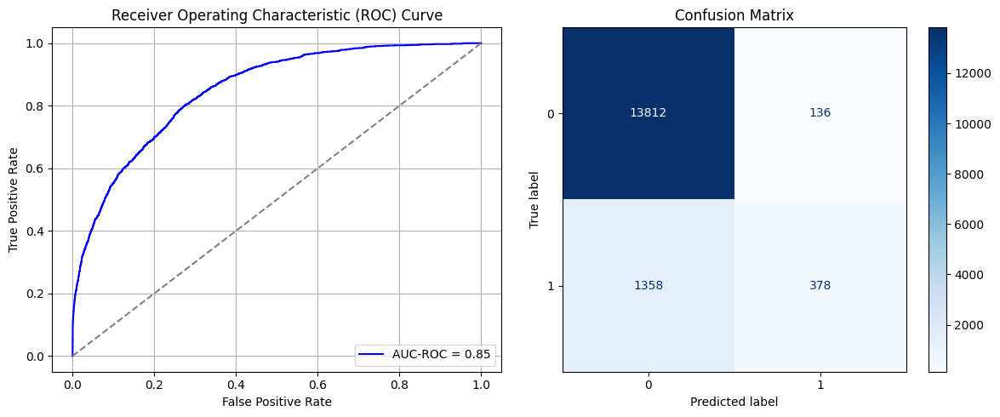

Best threshold based on F1-score: 0.18246808648109436
False Negative Rate: 0.782258064516129
Time elapsed (performance): 1.6802872759999445
(np.float64(0.009750501864066534), np.float64(0.9902494981359334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7400 - loss: 0.6167 - val_AUC: 0.8465 - val_loss: 0.4867
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8556 - loss: 0.4709 - val_AUC: 0.8715 - val_loss: 0.4467
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4383 - val_AUC: 0.8733 - val_loss: 0.4517
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4391 - val_AUC: 0.8733 - val_loss: 0.4432
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4390 - val_AUC: 0.8740 - val_loss: 0.4411
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4430 - val_AUC: 0.8755 - val_loss: 0.4416
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4360 - val_AUC: 0.8752 - val_loss: 0.4396
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8828 - loss: 0.4249 - val_AUC: 0.8761 - val_loss: 0.4377
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 -

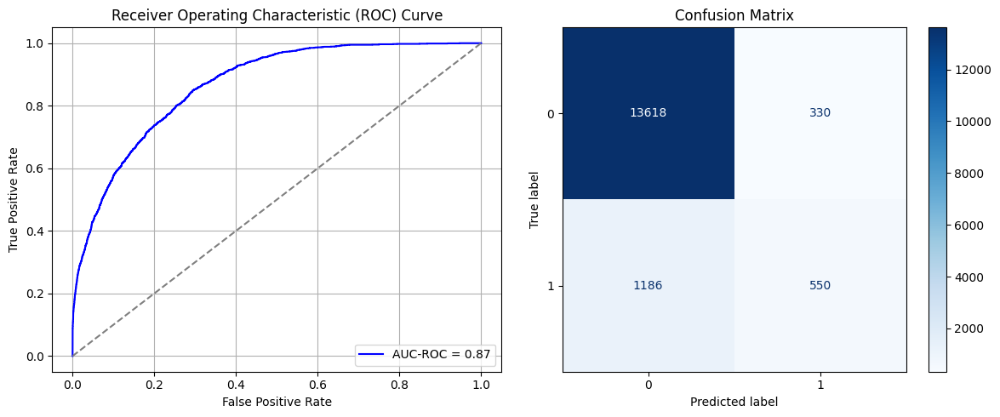

Best threshold based on F1-score: 0.2595411539077759
False Negative Rate: 0.6831797235023042
Time elapsed (performance): 1.2842060870007117
(np.float64(0.02365930599369085), np.float64(0.9763406940063092))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7482 - loss: 0.6054 - val_AUC: 0.8617 - val_loss: 0.4818
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8597 - loss: 0.4622 - val_AUC: 0.8730 - val_loss: 0.4504
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8681 - loss: 0.4471 - val_AUC: 0.8762 - val_loss: 0.4392
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 - loss: 0.4362 - val_AUC: 0.8774 - val_loss: 0.4408
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8841 - loss: 0.4222 - val_AUC: 0.8774 - val_loss: 0.4376
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 - loss: 0.4306 - val_AUC: 0.8803 - val_loss: 0.4322
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8807 - loss: 0.4275 - val_AUC: 0.8801 - val_loss: 0.4330
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4321 - val_AUC: 0.8811 - val_loss: 0.4304
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8827 -

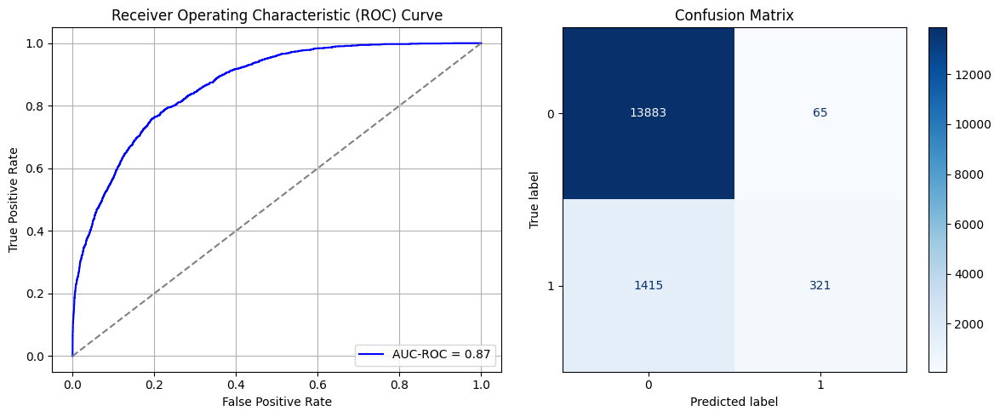

Best threshold based on F1-score: 0.1001463532447815
False Negative Rate: 0.8150921658986175
Time elapsed (performance): 1.695479116999195
(np.float64(0.004660166332090623), np.float64(0.9953398336679093))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7373 - loss: 0.6158 - val_AUC: 0.8622 - val_loss: 0.4811
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8576 - loss: 0.4689 - val_AUC: 0.8713 - val_loss: 0.4513
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4390 - val_AUC: 0.8722 - val_loss: 0.4456
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4388 - val_AUC: 0.8723 - val_loss: 0.4442
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8681 - loss: 0.4460 - val_AUC: 0.8725 - val_loss: 0.4447
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4398 - val_AUC: 0.8733 - val_loss: 0.4564
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8808 - loss: 0.4282 - val_AUC: 0.8735 - val_loss: 0.4408
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 - loss: 0.4349 - val_AUC: 0.8741 - val_loss: 0.4511
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 -

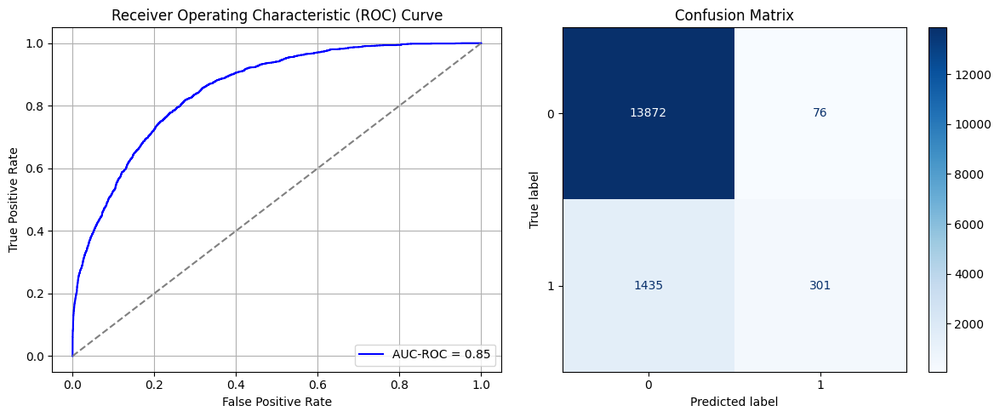

Best threshold based on F1-score: 0.11810656636953354
False Negative Rate: 0.8266129032258065
Time elapsed (performance): 1.2895779860009497
(np.float64(0.0054488098652136505), np.float64(0.9945511901347863))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7281 - loss: 0.6174 - val_AUC: 0.8732 - val_loss: 0.4596
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8571 - loss: 0.4694 - val_AUC: 0.8812 - val_loss: 0.4335
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8679 - loss: 0.4491 - val_AUC: 0.8819 - val_loss: 0.4300
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4412 - val_AUC: 0.8815 - val_loss: 0.4315
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4386 - val_AUC: 0.8836 - val_loss: 0.4262
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8662 - loss: 0.4491 - val_AUC: 0.8823 - val_loss: 0.4285
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4283 - val_AUC: 0.8840 - val_loss: 0.4293
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4356 - val_AUC: 0.8840 - val_loss: 0.4256
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 -

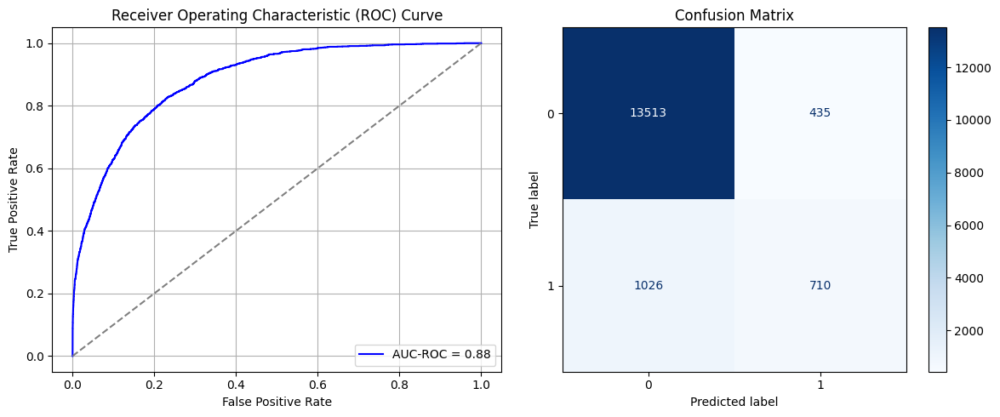

Best threshold based on F1-score: 0.34154489636421204
False Negative Rate: 0.5910138248847926
Time elapsed (performance): 1.3211018559995864
(np.float64(0.031187266991683397), np.float64(0.9688127330083166))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7381 - loss: 0.6151 - val_AUC: 0.8542 - val_loss: 0.4803
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8624 - loss: 0.4623 - val_AUC: 0.8684 - val_loss: 0.4529
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8704 - loss: 0.4438 - val_AUC: 0.8720 - val_loss: 0.4434
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4404 - val_AUC: 0.8727 - val_loss: 0.4412
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4375 - val_AUC: 0.8732 - val_loss: 0.4407
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4338 - val_AUC: 0.8735 - val_loss: 0.4426
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8786 - loss: 0.4303 - val_AUC: 0.8730 - val_loss: 0.4403
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8790 - loss: 0.4301 - val_AUC: 0.8730 - val_loss: 0.4439
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 -

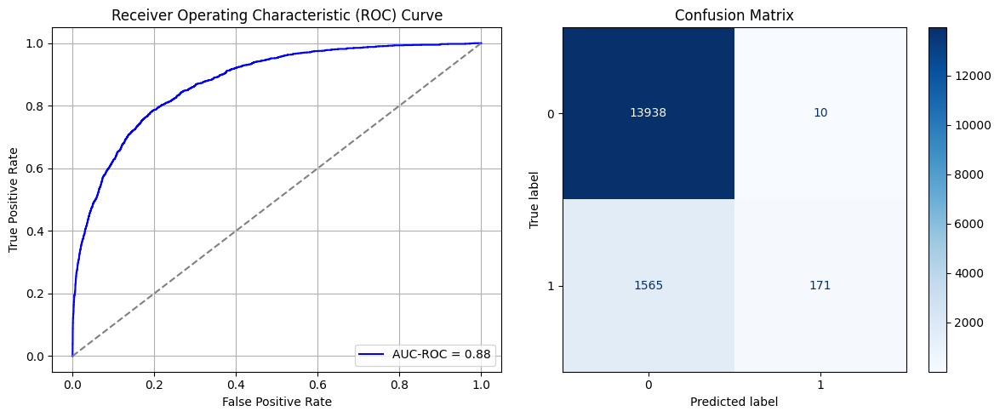

Best threshold based on F1-score: 0.06465260684490204
False Negative Rate: 0.9014976958525346
Time elapsed (performance): 1.274865781000699
(np.float64(0.0007169486664754804), np.float64(0.9992830513335246))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7112 - loss: 0.6184 - val_AUC: 0.8560 - val_loss: 0.4912
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8541 - loss: 0.4740 - val_AUC: 0.8714 - val_loss: 0.4529
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 - loss: 0.4451 - val_AUC: 0.8724 - val_loss: 0.4538
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8730 - loss: 0.4397 - val_AUC: 0.8751 - val_loss: 0.4468
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4380 - val_AUC: 0.8754 - val_loss: 0.4381
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8702 - loss: 0.4450 - val_AUC: 0.8757 - val_loss: 0.4400
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4360 - val_AUC: 0.8754 - val_loss: 0.4388
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4330 - val_AUC: 0.8757 - val_loss: 0.4367
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 -

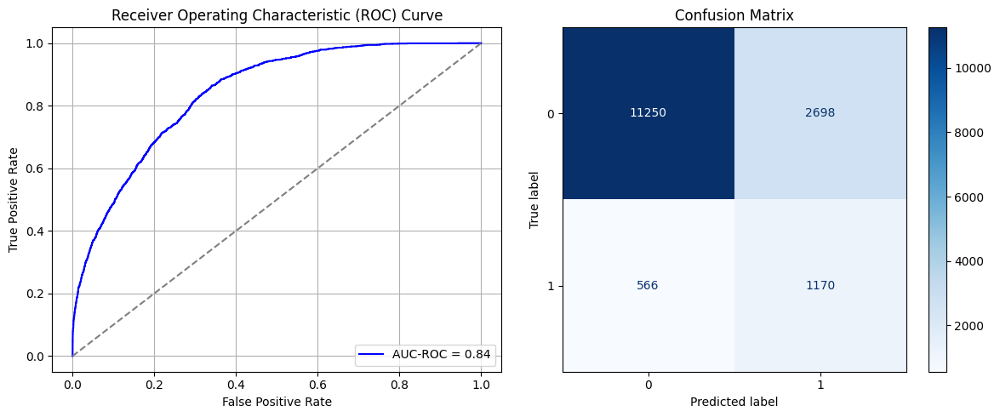

Best threshold based on F1-score: 0.6628132462501526
False Negative Rate: 0.326036866359447
Time elapsed (performance): 1.9257405549997202
(np.float64(0.1934327502150846), np.float64(0.8065672497849155))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7120 - loss: 0.6226 - val_AUC: 0.8600 - val_loss: 0.4826
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8635 - loss: 0.4624 - val_AUC: 0.8743 - val_loss: 0.4592
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8683 - loss: 0.4486 - val_AUC: 0.8796 - val_loss: 0.4408
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8738 - loss: 0.4389 - val_AUC: 0.8811 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8703 - loss: 0.4448 - val_AUC: 0.8825 - val_loss: 0.4381
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8711 - loss: 0.4448 - val_AUC: 0.8811 - val_loss: 0.4307
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4430 - val_AUC: 0.8822 - val_loss: 0.4302
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4311 - val_AUC: 0.8814 - val_loss: 0.4504
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 -

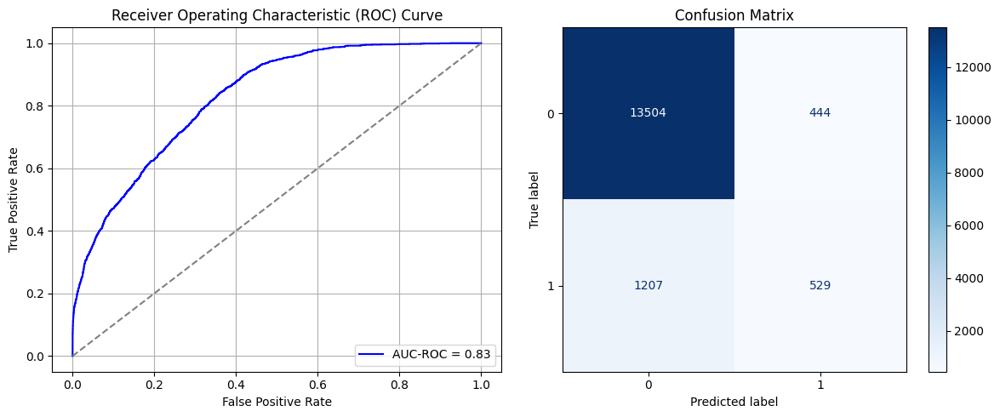

Best threshold based on F1-score: 0.33285173773765564
False Negative Rate: 0.6952764976958525
Time elapsed (performance): 1.8512776719999238
(np.float64(0.031832520791511325), np.float64(0.9681674792084887))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7229 - loss: 0.6125 - val_AUC: 0.8694 - val_loss: 0.4675
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8616 - loss: 0.4626 - val_AUC: 0.8793 - val_loss: 0.4385
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8717 - loss: 0.4403 - val_AUC: 0.8823 - val_loss: 0.4303
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4324 - val_AUC: 0.8841 - val_loss: 0.4412
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8689 - loss: 0.4453 - val_AUC: 0.8845 - val_loss: 0.4251
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4413 - val_AUC: 0.8849 - val_loss: 0.4276
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8771 - loss: 0.4319 - val_AUC: 0.8851 - val_loss: 0.4234
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8738 - loss: 0.4382 - val_AUC: 0.8851 - val_loss: 0.4239
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 -

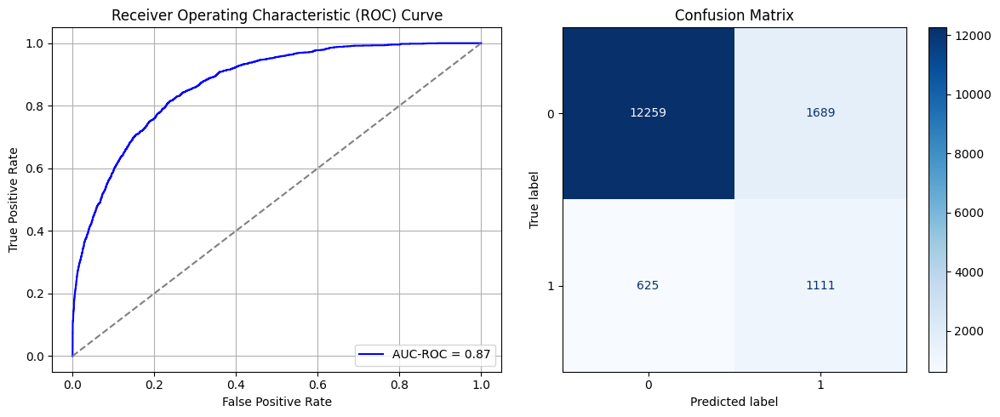

Best threshold based on F1-score: 0.5360748171806335
False Negative Rate: 0.36002304147465436
Time elapsed (performance): 1.3354439470003854
(np.float64(0.12109262976770863), np.float64(0.8789073702322914))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7406 - loss: 0.6167 - val_AUC: 0.8534 - val_loss: 0.4892
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8483 - loss: 0.4834 - val_AUC: 0.8731 - val_loss: 0.4473
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8670 - loss: 0.4512 - val_AUC: 0.8725 - val_loss: 0.4434
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8705 - loss: 0.4462 - val_AUC: 0.8770 - val_loss: 0.4464
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.4366 - val_AUC: 0.8773 - val_loss: 0.4366
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 - loss: 0.4302 - val_AUC: 0.8776 - val_loss: 0.4442
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8701 - loss: 0.4461 - val_AUC: 0.8789 - val_loss: 0.4339
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4341 - val_AUC: 0.8783 - val_loss: 0.4358
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 -

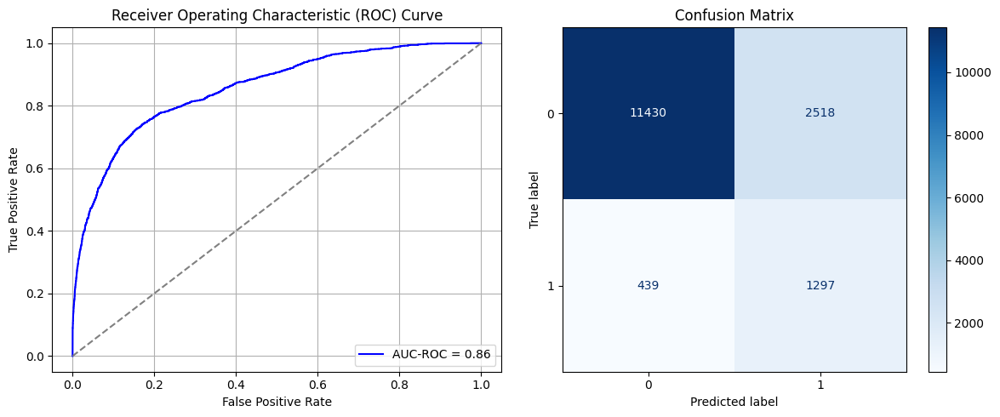

Best threshold based on F1-score: 0.7219613790512085
False Negative Rate: 0.2528801843317972
Time elapsed (performance): 1.401302759999453
(np.float64(0.18052767421852595), np.float64(0.819472325781474))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7253 - loss: 0.6138 - val_AUC: 0.8517 - val_loss: 0.4843
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8611 - loss: 0.4652 - val_AUC: 0.8697 - val_loss: 0.4673
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4420 - val_AUC: 0.8723 - val_loss: 0.4460
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4357 - val_AUC: 0.8732 - val_loss: 0.4419
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8743 - loss: 0.4380 - val_AUC: 0.8745 - val_loss: 0.4625
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.4371 - val_AUC: 0.8744 - val_loss: 0.4406
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 - loss: 0.4251 - val_AUC: 0.8751 - val_loss: 0.4423
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4333 - val_AUC: 0.8758 - val_loss: 0.4376
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8808 -

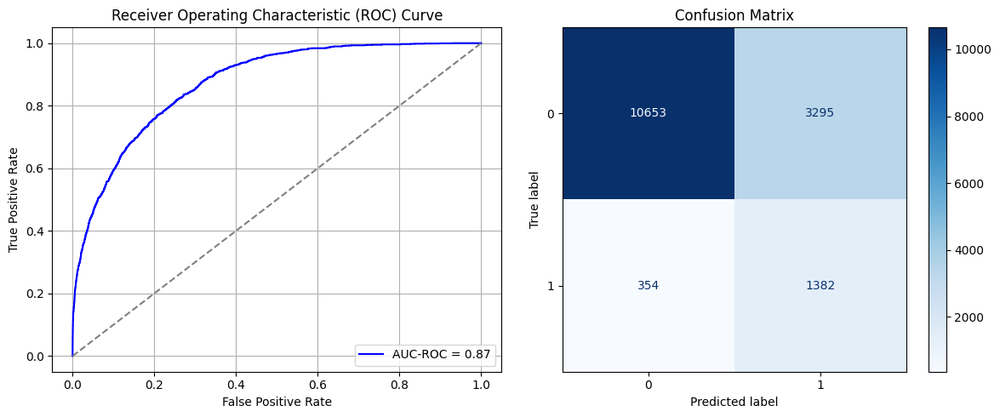

Best threshold based on F1-score: 0.7191845178604126
False Negative Rate: 0.20391705069124424
Time elapsed (performance): 1.6989753220004786
(np.float64(0.23623458560367078), np.float64(0.7637654143963293))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7363 - loss: 0.6134 - val_AUC: 0.8646 - val_loss: 0.4642
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8623 - loss: 0.4618 - val_AUC: 0.8805 - val_loss: 0.4342
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8680 - loss: 0.4485 - val_AUC: 0.8815 - val_loss: 0.4387
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8735 - loss: 0.4404 - val_AUC: 0.8828 - val_loss: 0.4328
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.4361 - val_AUC: 0.8840 - val_loss: 0.4535
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4412 - val_AUC: 0.8827 - val_loss: 0.4318
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8725 - loss: 0.4411 - val_AUC: 0.8839 - val_loss: 0.4271
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.4339 - val_AUC: 0.8857 - val_loss: 0.4242
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 -

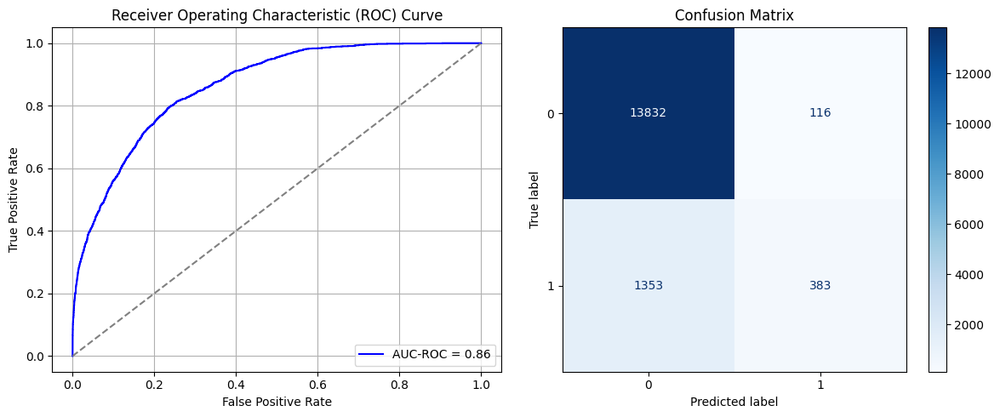

Best threshold based on F1-score: 0.12263172119855881
False Negative Rate: 0.7793778801843319
Time elapsed (performance): 1.4151290669997252
(np.float64(0.008316604531115572), np.float64(0.9916833954688844))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7271 - loss: 0.6201 - val_AUC: 0.8568 - val_loss: 0.4734
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8551 - loss: 0.4693 - val_AUC: 0.8707 - val_loss: 0.4746
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8650 - loss: 0.4567 - val_AUC: 0.8718 - val_loss: 0.4503
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8642 - loss: 0.4517 - val_AUC: 0.8725 - val_loss: 0.4476
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8718 - loss: 0.4429 - val_AUC: 0.8724 - val_loss: 0.4471
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4331 - val_AUC: 0.8731 - val_loss: 0.4430
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8706 - loss: 0.4432 - val_AUC: 0.8732 - val_loss: 0.4490
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8773 - loss: 0.4331 - val_AUC: 0.8736 - val_loss: 0.4392
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8795 -

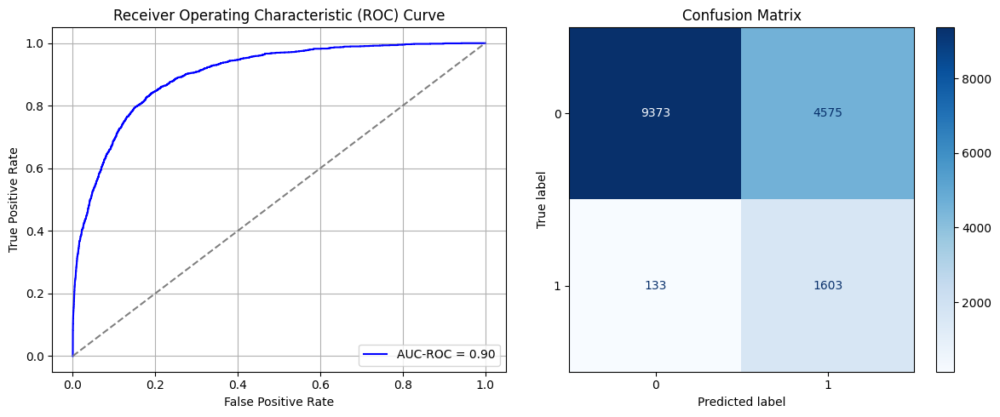

Best threshold based on F1-score: 0.7913662791252136
False Negative Rate: 0.07661290322580645
Time elapsed (performance): 1.666790397001023
(np.float64(0.3280040149125323), np.float64(0.6719959850874677))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6938 - loss: 0.6247 - val_AUC: 0.8490 - val_loss: 0.4858
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8513 - loss: 0.4782 - val_AUC: 0.8702 - val_loss: 0.4483
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8710 - loss: 0.4437 - val_AUC: 0.8717 - val_loss: 0.4473
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8688 - loss: 0.4466 - val_AUC: 0.8727 - val_loss: 0.4439
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8664 - loss: 0.4515 - val_AUC: 0.8720 - val_loss: 0.4428
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8687 - loss: 0.4450 - val_AUC: 0.8742 - val_loss: 0.4521
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8748 - loss: 0.4363 - val_AUC: 0.8727 - val_loss: 0.4437
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4399 - val_AUC: 0.8742 - val_loss: 0.4420
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 -

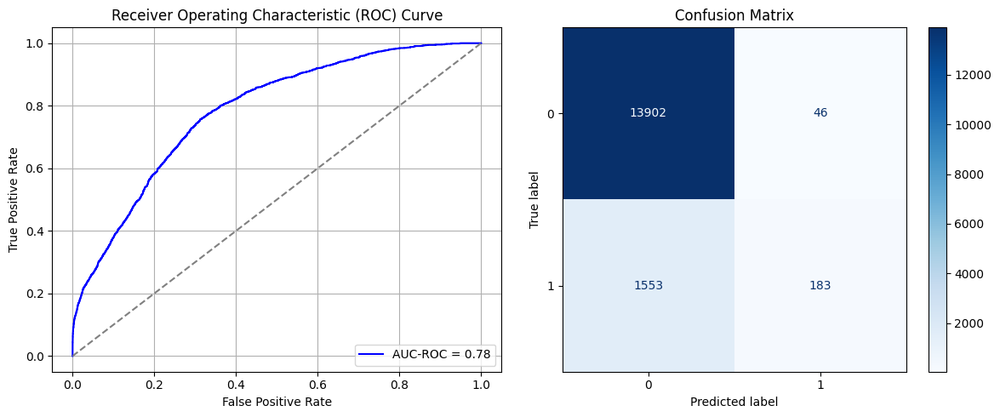

Best threshold based on F1-score: 0.029552927240729332
False Negative Rate: 0.8945852534562212
Time elapsed (performance): 1.6931839469998522
(np.float64(0.00329796386578721), np.float64(0.9967020361342128))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7419 - loss: 0.6094 - val_AUC: 0.8686 - val_loss: 0.4631
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8672 - loss: 0.4550 - val_AUC: 0.8791 - val_loss: 0.4339
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4415 - val_AUC: 0.8801 - val_loss: 0.4306
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4354 - val_AUC: 0.8812 - val_loss: 0.4382
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8760 - loss: 0.4352 - val_AUC: 0.8814 - val_loss: 0.4286
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4408 - val_AUC: 0.8825 - val_loss: 0.4305
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4340 - val_AUC: 0.8807 - val_loss: 0.4454
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.4344 - val_AUC: 0.8822 - val_loss: 0.4265
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 -

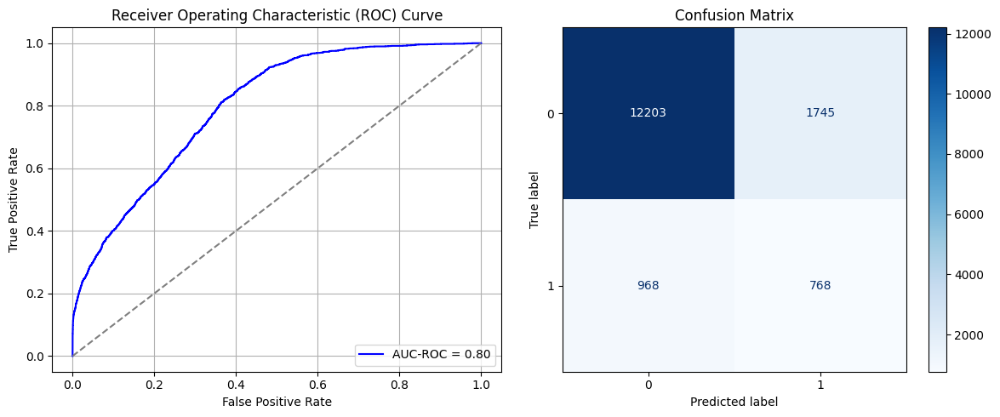

Best threshold based on F1-score: 0.5863158702850342
False Negative Rate: 0.5576036866359447
Time elapsed (performance): 1.4161052259987628
(np.float64(0.1251075422999713), np.float64(0.8748924577000287))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7047 - loss: 0.6319 - val_AUC: 0.8610 - val_loss: 0.4676
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8620 - loss: 0.4601 - val_AUC: 0.8769 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8699 - loss: 0.4437 - val_AUC: 0.8808 - val_loss: 0.4370
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8697 - loss: 0.4445 - val_AUC: 0.8818 - val_loss: 0.4297
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8701 - loss: 0.4428 - val_AUC: 0.8817 - val_loss: 0.4402
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 - loss: 0.4365 - val_AUC: 0.8827 - val_loss: 0.4342
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4396 - val_AUC: 0.8830 - val_loss: 0.4266
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 - loss: 0.4345 - val_AUC: 0.8795 - val_loss: 0.4326
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8699 -

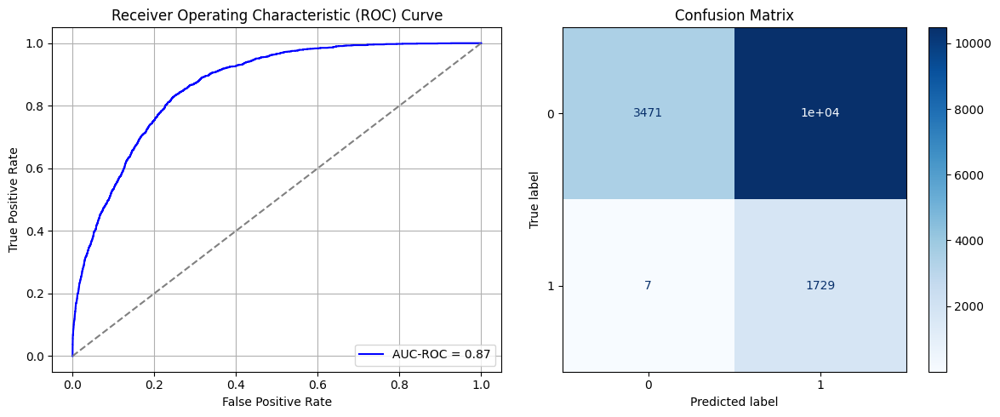

Best threshold based on F1-score: 0.9533963203430176
False Negative Rate: 0.004032258064516129
Time elapsed (performance): 5.228776096000729
(np.float64(0.7511471178663608), np.float64(0.2488528821336392))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7352 - loss: 0.6142 - val_AUC: 0.8591 - val_loss: 0.4699
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8562 - loss: 0.4686 - val_AUC: 0.8715 - val_loss: 0.4593
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8642 - loss: 0.4552 - val_AUC: 0.8755 - val_loss: 0.4400
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8700 - loss: 0.4443 - val_AUC: 0.8771 - val_loss: 0.4390
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8723 - loss: 0.4409 - val_AUC: 0.8763 - val_loss: 0.4408
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4383 - val_AUC: 0.8777 - val_loss: 0.4387
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8705 - loss: 0.4406 - val_AUC: 0.8777 - val_loss: 0.4368
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8710 - loss: 0.4438 - val_AUC: 0.8784 - val_loss: 0.4465
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8748 -

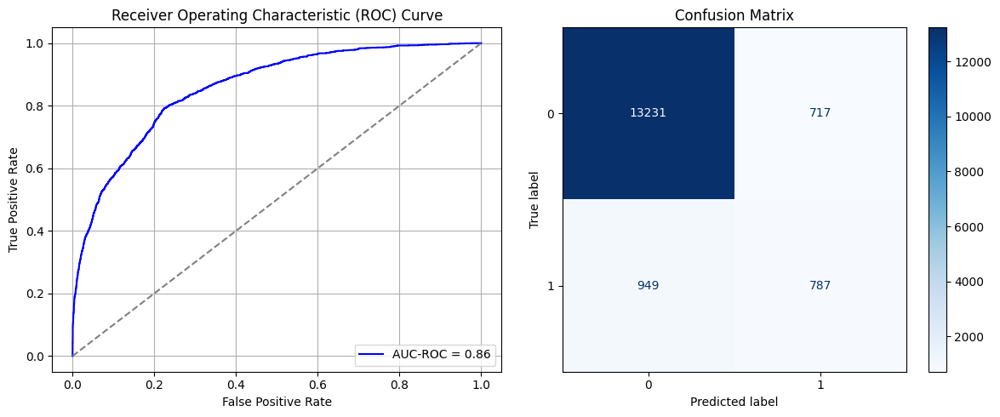

Best threshold based on F1-score: 0.44542360305786133
False Negative Rate: 0.5466589861751152
Time elapsed (performance): 1.5427679790009279
(np.float64(0.051405219386291945), np.float64(0.948594780613708))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7244 - loss: 0.6155 - val_AUC: 0.8594 - val_loss: 0.4855
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8547 - loss: 0.4736 - val_AUC: 0.8747 - val_loss: 0.4613
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8706 - loss: 0.4441 - val_AUC: 0.8792 - val_loss: 0.4358
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8715 - loss: 0.4416 - val_AUC: 0.8799 - val_loss: 0.4473
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4392 - val_AUC: 0.8806 - val_loss: 0.4318
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8649 - loss: 0.4516 - val_AUC: 0.8815 - val_loss: 0.4289
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4356 - val_AUC: 0.8818 - val_loss: 0.4284
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8721 - loss: 0.4392 - val_AUC: 0.8806 - val_loss: 0.4341
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8753 -

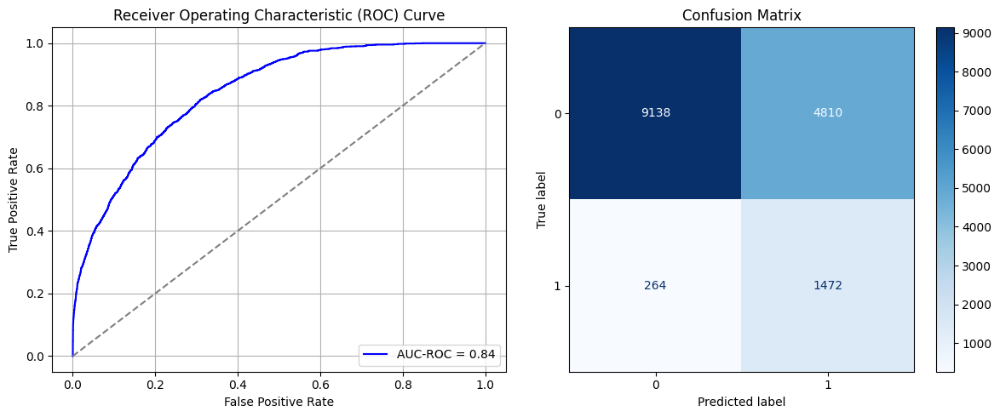

Best threshold based on F1-score: 0.8117738962173462
False Negative Rate: 0.15207373271889402
Time elapsed (performance): 1.4154212699995696
(np.float64(0.34485230857470606), np.float64(0.6551476914252939))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7089 - loss: 0.6256 - val_AUC: 0.8684 - val_loss: 0.4676
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8519 - loss: 0.4768 - val_AUC: 0.8833 - val_loss: 0.4330
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8702 - loss: 0.4456 - val_AUC: 0.8875 - val_loss: 0.4208
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4445 - val_AUC: 0.8868 - val_loss: 0.4213
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8683 - loss: 0.4458 - val_AUC: 0.8886 - val_loss: 0.4180
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4388 - val_AUC: 0.8885 - val_loss: 0.4176
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8741 - loss: 0.4371 - val_AUC: 0.8881 - val_loss: 0.4235
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8746 - loss: 0.4352 - val_AUC: 0.8894 - val_loss: 0.4180
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 -

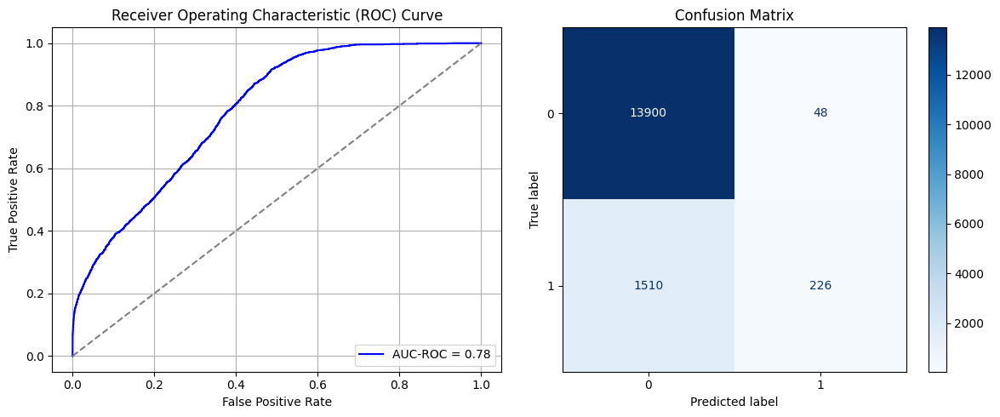

Best threshold based on F1-score: 0.09690577536821365
False Negative Rate: 0.869815668202765
Time elapsed (performance): 1.7374574060013401
(np.float64(0.0034413535990823058), np.float64(0.9965586464009177))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7185 - loss: 0.6177 - val_AUC: 0.8573 - val_loss: 0.4803
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8393 - loss: 0.4915 - val_AUC: 0.8851 - val_loss: 0.4329
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8626 - loss: 0.4539 - val_AUC: 0.8881 - val_loss: 0.4223
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4371 - val_AUC: 0.8897 - val_loss: 0.4215
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8725 - loss: 0.4385 - val_AUC: 0.8902 - val_loss: 0.4162
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8722 - loss: 0.4369 - val_AUC: 0.8896 - val_loss: 0.4166
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8789 - loss: 0.4279 - val_AUC: 0.8895 - val_loss: 0.4188
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8752 - loss: 0.4329 - val_AUC: 0.8918 - val_loss: 0.4124
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 -

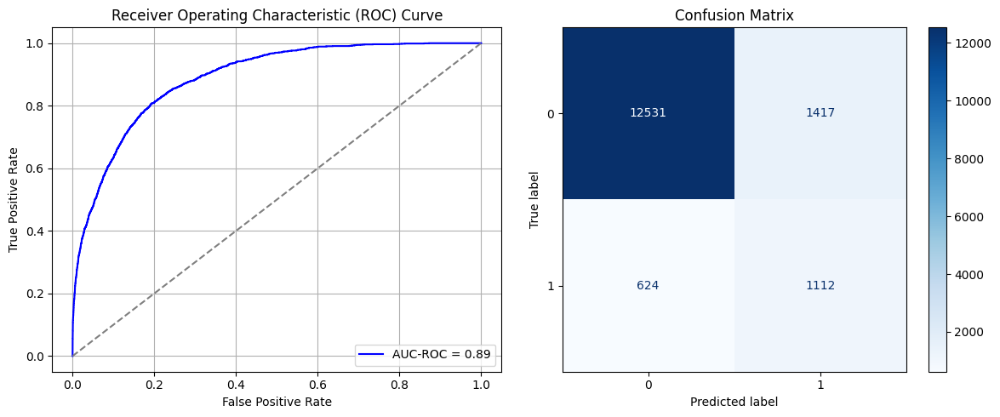

Best threshold based on F1-score: 0.5317652821540833
False Negative Rate: 0.35944700460829493
Time elapsed (performance): 1.8187335020011233
(np.float64(0.10159162603957557), np.float64(0.8984083739604244))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7183 - loss: 0.6280 - val_AUC: 0.8530 - val_loss: 0.4801
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8552 - loss: 0.4718 - val_AUC: 0.8682 - val_loss: 0.4602
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8682 - loss: 0.4480 - val_AUC: 0.8719 - val_loss: 0.4450
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8671 - loss: 0.4493 - val_AUC: 0.8728 - val_loss: 0.4440
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 - loss: 0.4310 - val_AUC: 0.8735 - val_loss: 0.4474
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4433 - val_AUC: 0.8753 - val_loss: 0.4441
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 - loss: 0.4292 - val_AUC: 0.8758 - val_loss: 0.4407
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8740 - loss: 0.4390 - val_AUC: 0.8765 - val_loss: 0.4467
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 -

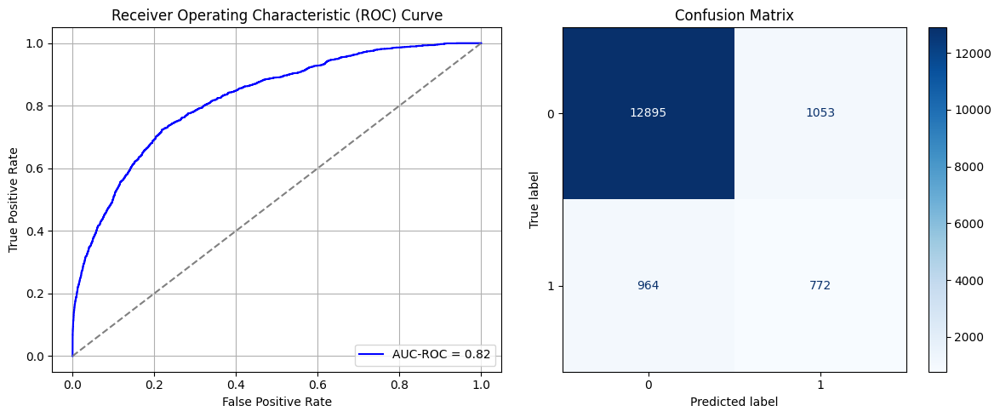

Best threshold based on F1-score: 0.39762306213378906
False Negative Rate: 0.5552995391705069
Time elapsed (performance): 1.5520104120005271
(np.float64(0.07549469457986809), np.float64(0.9245053054201319))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7159 - loss: 0.6215 - val_AUC: 0.8523 - val_loss: 0.4890
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8553 - loss: 0.4732 - val_AUC: 0.8699 - val_loss: 0.4514
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8649 - loss: 0.4515 - val_AUC: 0.8723 - val_loss: 0.4483
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8740 - loss: 0.4384 - val_AUC: 0.8735 - val_loss: 0.4413
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8718 - loss: 0.4421 - val_AUC: 0.8735 - val_loss: 0.4444
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8711 - loss: 0.4426 - val_AUC: 0.8733 - val_loss: 0.4456
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8795 - loss: 0.4281 - val_AUC: 0.8748 - val_loss: 0.4544
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4411 - val_AUC: 0.8748 - val_loss: 0.4451
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 -

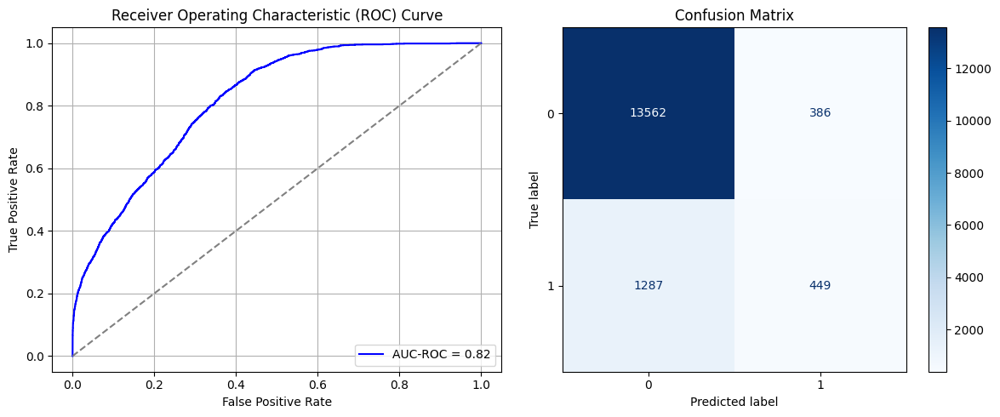

Best threshold based on F1-score: 0.31474414467811584
False Negative Rate: 0.7413594470046083
Time elapsed (performance): 1.7043211990003329
(np.float64(0.02767421852595354), np.float64(0.9723257814740465))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7364 - loss: 0.6211 - val_AUC: 0.8662 - val_loss: 0.4722
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8549 - loss: 0.4733 - val_AUC: 0.8810 - val_loss: 0.4338
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8712 - loss: 0.4435 - val_AUC: 0.8832 - val_loss: 0.4290
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8731 - loss: 0.4417 - val_AUC: 0.8823 - val_loss: 0.4392
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8712 - loss: 0.4434 - val_AUC: 0.8853 - val_loss: 0.4246
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8814 - loss: 0.4274 - val_AUC: 0.8855 - val_loss: 0.4300
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8775 - loss: 0.4329 - val_AUC: 0.8850 - val_loss: 0.4344
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8733 - loss: 0.4395 - val_AUC: 0.8851 - val_loss: 0.4475
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 -

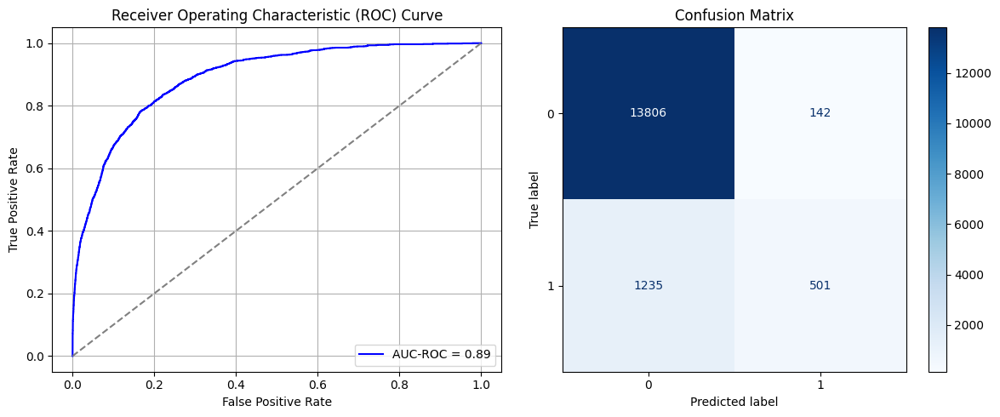

Best threshold based on F1-score: 0.17096903920173645
False Negative Rate: 0.711405529953917
Time elapsed (performance): 1.6551415200010524
(np.float64(0.010180671063951822), np.float64(0.9898193289360482))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7210 - loss: 0.6181 - val_AUC: 0.8532 - val_loss: 0.4821
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8565 - loss: 0.4690 - val_AUC: 0.8702 - val_loss: 0.4498
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8687 - loss: 0.4470 - val_AUC: 0.8722 - val_loss: 0.4446
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8722 - loss: 0.4421 - val_AUC: 0.8738 - val_loss: 0.4508
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8765 - loss: 0.4325 - val_AUC: 0.8731 - val_loss: 0.4433
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8754 - loss: 0.4358 - val_AUC: 0.8750 - val_loss: 0.4403
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4328 - val_AUC: 0.8752 - val_loss: 0.4416
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8719 - loss: 0.4390 - val_AUC: 0.8761 - val_loss: 0.4383
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 -

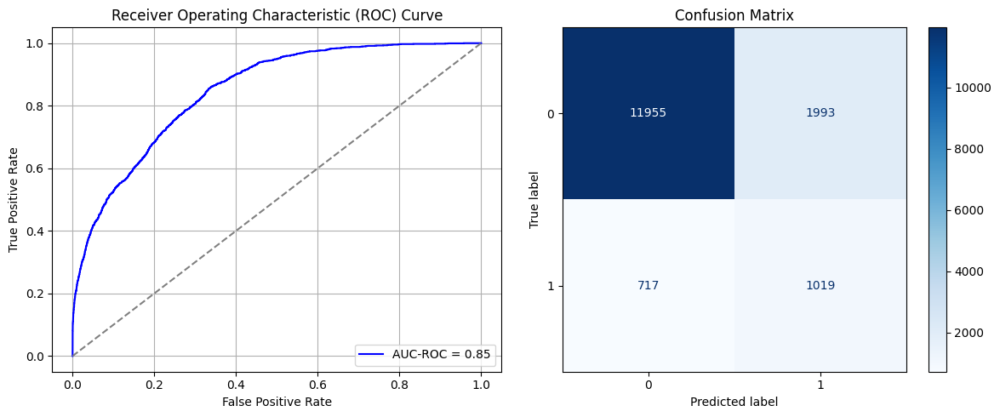

Best threshold based on F1-score: 0.616486668586731
False Negative Rate: 0.4130184331797235
Time elapsed (performance): 1.4365480609994847
(np.float64(0.14288786922856322), np.float64(0.8571121307714368))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7523 - loss: 0.6126 - val_AUC: 0.8651 - val_loss: 0.4660
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8558 - loss: 0.4679 - val_AUC: 0.8775 - val_loss: 0.4393
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8684 - loss: 0.4465 - val_AUC: 0.8799 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8715 - loss: 0.4429 - val_AUC: 0.8795 - val_loss: 0.4330
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.4372 - val_AUC: 0.8802 - val_loss: 0.4313
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8691 - loss: 0.4475 - val_AUC: 0.8820 - val_loss: 0.4282
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8727 - loss: 0.4398 - val_AUC: 0.8824 - val_loss: 0.4274
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8733 - loss: 0.4377 - val_AUC: 0.8810 - val_loss: 0.4322
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8778 -

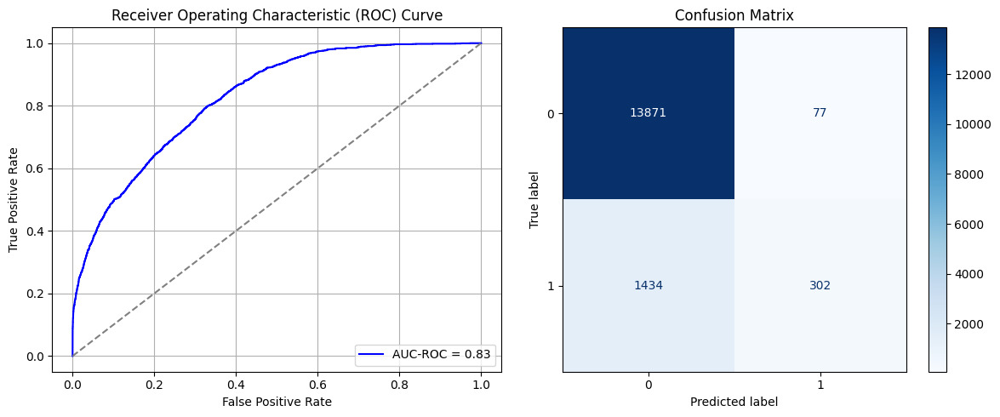

Best threshold based on F1-score: 0.12601587176322937
False Negative Rate: 0.826036866359447
Time elapsed (performance): 1.4467381300000852
(np.float64(0.005520504731861199), np.float64(0.9944794952681388))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7306 - loss: 0.6129 - val_AUC: 0.8487 - val_loss: 0.4818
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8586 - loss: 0.4671 - val_AUC: 0.8640 - val_loss: 0.4551
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8722 - loss: 0.4425 - val_AUC: 0.8668 - val_loss: 0.4520
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4424 - val_AUC: 0.8681 - val_loss: 0.4505
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 - loss: 0.4421 - val_AUC: 0.8686 - val_loss: 0.4713
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4407 - val_AUC: 0.8699 - val_loss: 0.4464
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4325 - val_AUC: 0.8711 - val_loss: 0.4627
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4288 - val_AUC: 0.8715 - val_loss: 0.4727
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8747 -

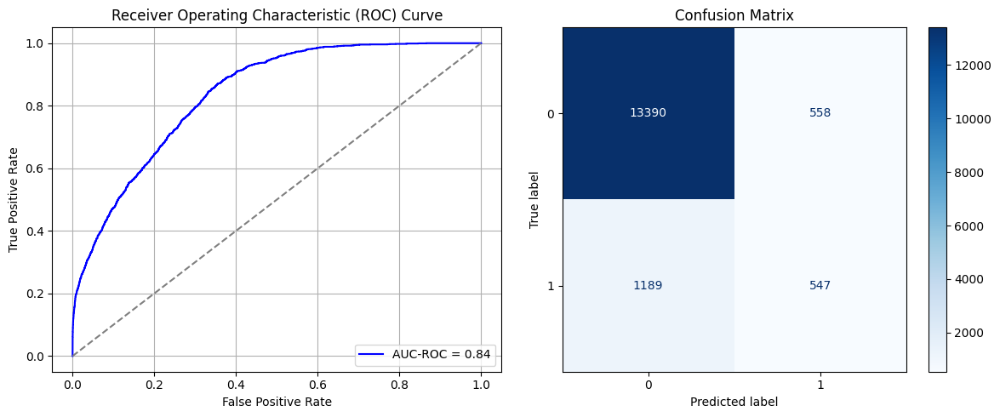

Best threshold based on F1-score: 0.3485202193260193
False Negative Rate: 0.6849078341013825
Time elapsed (performance): 1.4999153259996092
(np.float64(0.040005735589331806), np.float64(0.9599942644106682))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7223 - loss: 0.6280 - val_AUC: 0.8709 - val_loss: 0.4654
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8573 - loss: 0.4722 - val_AUC: 0.8852 - val_loss: 0.4307
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8688 - loss: 0.4478 - val_AUC: 0.8841 - val_loss: 0.4254
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8758 - loss: 0.4354 - val_AUC: 0.8859 - val_loss: 0.4214
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4426 - val_AUC: 0.8862 - val_loss: 0.4215
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8745 - loss: 0.4360 - val_AUC: 0.8864 - val_loss: 0.4234
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8760 - loss: 0.4333 - val_AUC: 0.8874 - val_loss: 0.4187
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4389 - val_AUC: 0.8866 - val_loss: 0.4247
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8733 -

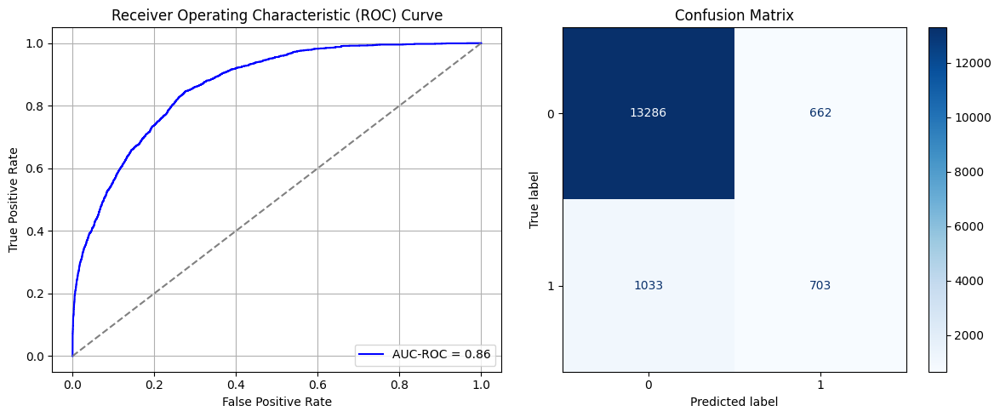

Best threshold based on F1-score: 0.40047580003738403
False Negative Rate: 0.5950460829493087
Time elapsed (performance): 1.7139078729996982
(np.float64(0.0474620017206768), np.float64(0.9525379982793232))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6968 - loss: 0.6257 - val_AUC: 0.8587 - val_loss: 0.4784
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8581 - loss: 0.4646 - val_AUC: 0.8750 - val_loss: 0.4426
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8722 - loss: 0.4423 - val_AUC: 0.8778 - val_loss: 0.4348
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8721 - loss: 0.4400 - val_AUC: 0.8793 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8792 - loss: 0.4298 - val_AUC: 0.8803 - val_loss: 0.4324
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8791 - loss: 0.4302 - val_AUC: 0.8806 - val_loss: 0.4290
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4287 - val_AUC: 0.8815 - val_loss: 0.4375
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8725 - loss: 0.4382 - val_AUC: 0.8808 - val_loss: 0.4280
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8820 -

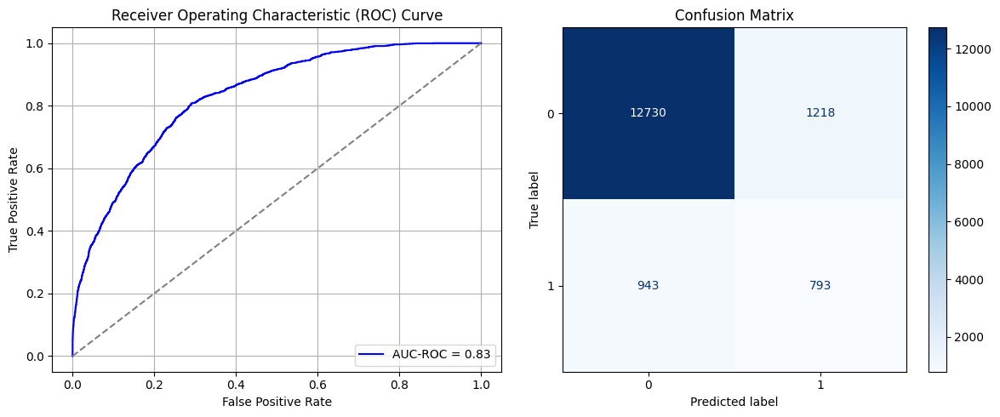

Best threshold based on F1-score: 0.464135080575943
False Negative Rate: 0.5432027649769585
Time elapsed (performance): 1.4768275759997778
(np.float64(0.0873243475767135), np.float64(0.9126756524232865))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7464 - loss: 0.6085 - val_AUC: 0.8607 - val_loss: 0.4691
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8570 - loss: 0.4685 - val_AUC: 0.8773 - val_loss: 0.4395
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8716 - loss: 0.4432 - val_AUC: 0.8793 - val_loss: 0.4343
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4330 - val_AUC: 0.8809 - val_loss: 0.4345
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8715 - loss: 0.4420 - val_AUC: 0.8813 - val_loss: 0.4419
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8712 - loss: 0.4434 - val_AUC: 0.8817 - val_loss: 0.4302
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4411 - val_AUC: 0.8808 - val_loss: 0.4341
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8813 - loss: 0.4275 - val_AUC: 0.8795 - val_loss: 0.4497
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8784 -

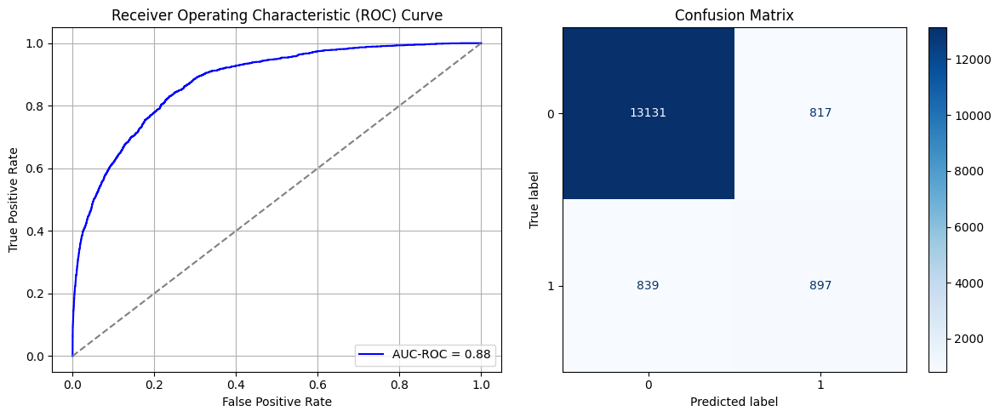

Best threshold based on F1-score: 0.47490382194519043
False Negative Rate: 0.483294930875576
Time elapsed (performance): 1.7029454499988788
(np.float64(0.05857470605104675), np.float64(0.9414252939489532))
    Source time       FPR       TNR       FNR       TPR  Target time
0     15.716550  0.004373  0.995627  0.820853  0.179147     1.162152
1     16.782630  0.006883  0.993117  0.854839  0.145161     1.812456
2     17.794265  0.001075  0.998925  0.904378  0.095622     1.299881
3     15.260581  0.067752  0.932248  0.482719  0.517281     1.780965
4     17.468869  0.084600  0.915400  0.509217  0.490783     1.196778
5     16.248527  0.035059  0.964941  0.686060  0.313940     1.188981
6     17.170788  0.156653  0.843347  0.297235  0.702765     4.681395
7     19.379553  0.027603  0.972397  0.748272  0.251728     1.266396
8     19.884429  0.039647  0.960353  0.612327  0.387673     1.888537
9     20.083858  0.079796  0.920204  0.563364  0.436636     1.267837
10    19.632821  0.448882  0.551118

In [97]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [98]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     15.716550  0.004373  0.995627  0.820853  0.179147     1.162152
1     16.782630  0.006883  0.993117  0.854839  0.145161     1.812456
2     17.794265  0.001075  0.998925  0.904378  0.095622     1.299881
3     15.260581  0.067752  0.932248  0.482719  0.517281     1.780965
4     17.468869  0.084600  0.915400  0.509217  0.490783     1.196778
5     16.248527  0.035059  0.964941  0.686060  0.313940     1.188981
6     17.170788  0.156653  0.843347  0.297235  0.702765     4.681395
7     19.379553  0.027603  0.972397  0.748272  0.251728     1.266396
8     19.884429  0.039647  0.960353  0.612327  0.387673     1.888537
9     20.083858  0.079796  0.920204  0.563364  0.436636     1.267837
10    19.632821  0.448882  0.551118  0.054147  0.945853     1.708082
11    16.964708  0.109263  0.890737  0.402650  0.597350     1.682130
12    18.760993  0.009249  0.990751  0.740207  0.259793     1.286650
13    18.618143  0.024806  0.97519

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [99]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7882 - loss: 0.5610 - val_AUC: 0.8710 - val_loss: 0.4446
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4414 - val_AUC: 0.8736 - val_loss: 0.4406
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.4349 - val_AUC: 0.8747 - val_loss: 0.4523
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8798 - loss: 0.4297 - val_AUC: 0.8757 - val_loss: 0.4496
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8755 - loss: 0.4349 - val_AUC: 0.8756 - val_loss: 0.4394
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8760 - loss: 0.4336 - val_AUC: 0.8772 - val_loss: 0.4337
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8814 - loss: 0.4267 - val_AUC: 0.8768 - val_loss: 0.4385
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8779 - loss: 0.4313 - val_AUC: 0.8776 - val_loss: 0.4326
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 -

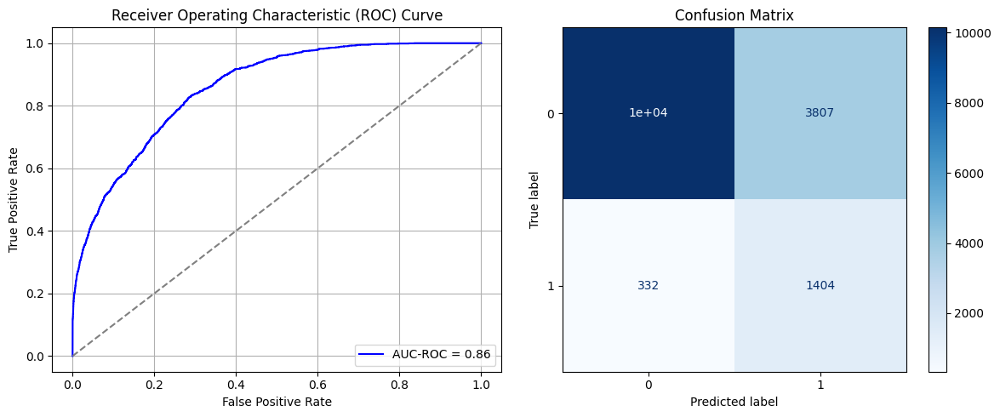

Best threshold based on F1-score: 0.7434198260307312
False Negative Rate: 0.1912442396313364
Time elapsed (performance): 1.1500053149993619
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7834 - loss: 0.5597 - val_AUC: 0.8697 - val_loss: 0.4465
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8737 - loss: 0.4384 - val_AUC: 0.8727 - val_loss: 0.4416
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8723 - loss: 0.4396 - val_AUC: 0.8744 - val_loss: 0.4386
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8770 - loss: 0.4326 - val_AUC: 0.8751 - val_loss: 0.4367
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8759 - loss: 0.4332 - val_AUC: 0.8759 - val_loss: 0.4461
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8791 - loss: 0.4290 - val_AUC: 0.8755 - val_loss: 0.4454
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8821 - loss: 0.4249 - val_AUC: 0.8772 - val_loss: 0.4345
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8788 - loss: 0.4292 - val_AUC: 0.8773 - val_loss: 0.4350
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8813 -

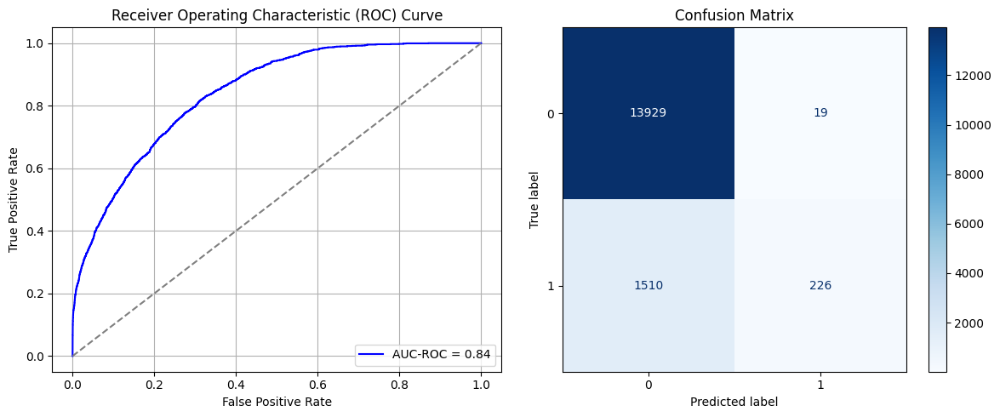

Best threshold based on F1-score: 0.0787726566195488
False Negative Rate: 0.869815668202765
Time elapsed (performance): 1.1480607260000397
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7895 - loss: 0.5592 - val_AUC: 0.8772 - val_loss: 0.4363
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8720 - loss: 0.4417 - val_AUC: 0.8785 - val_loss: 0.4481
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8739 - loss: 0.4376 - val_AUC: 0.8801 - val_loss: 0.4286
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.4337 - val_AUC: 0.8802 - val_loss: 0.4286
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4342 - val_AUC: 0.8813 - val_loss: 0.4334
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8776 - loss: 0.4318 - val_AUC: 0.8813 - val_loss: 0.4264
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8800 - loss: 0.4270 - val_AUC: 0.8813 - val_loss: 0.4256
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4277 - val_AUC: 0.8815 - val_loss: 0.4263
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 -

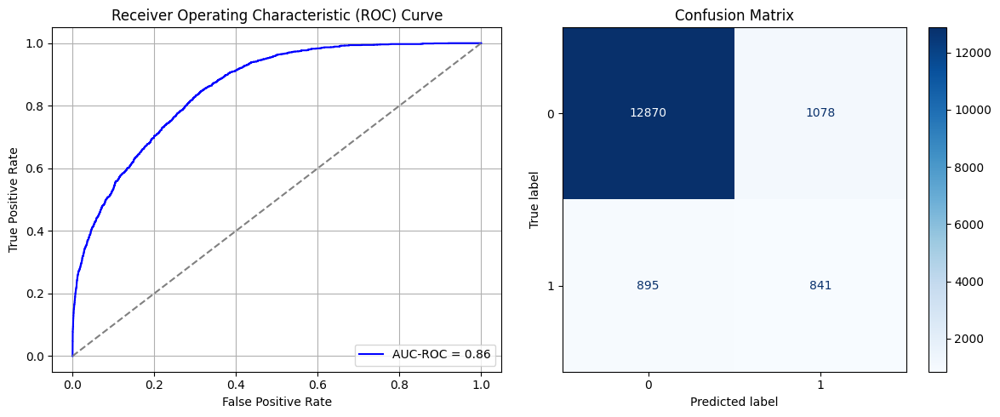

Best threshold based on F1-score: 0.5111427307128906
False Negative Rate: 0.5155529953917051
Time elapsed (performance): 1.7051491109996277
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7658 - loss: 0.5721 - val_AUC: 0.8708 - val_loss: 0.4438
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8717 - loss: 0.4432 - val_AUC: 0.8746 - val_loss: 0.4389
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8742 - loss: 0.4362 - val_AUC: 0.8746 - val_loss: 0.4390
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.4375 - val_AUC: 0.8761 - val_loss: 0.4353
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8755 - loss: 0.4354 - val_AUC: 0.8770 - val_loss: 0.4321
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.4325 - val_AUC: 0.8777 - val_loss: 0.4311
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8768 - loss: 0.4327 - val_AUC: 0.8785 - val_loss: 0.4301
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8818 - loss: 0.4252 - val_AUC: 0.8783 - val_loss: 0.4334
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8763 -

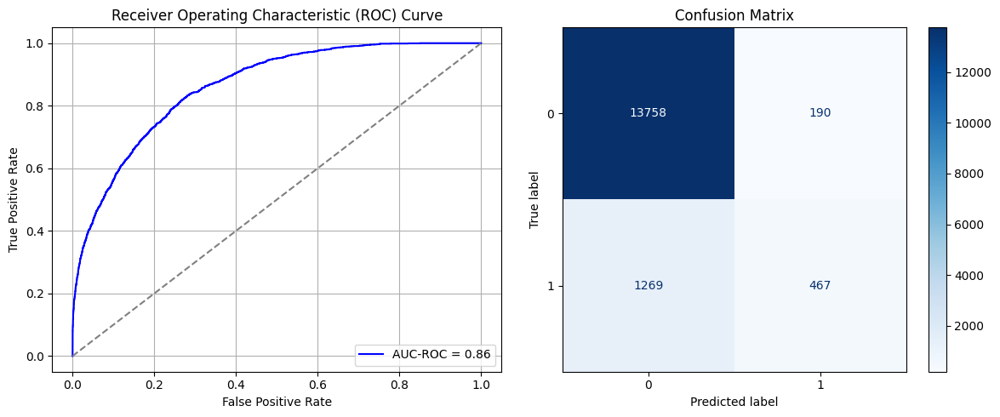

Best threshold based on F1-score: 0.20564457774162292
False Negative Rate: 0.7309907834101382
Time elapsed (performance): 1.6726735049996933
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7935 - loss: 0.5557 - val_AUC: 0.8742 - val_loss: 0.4418
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.4353 - val_AUC: 0.8773 - val_loss: 0.4323
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8736 - loss: 0.4385 - val_AUC: 0.8792 - val_loss: 0.4323
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8788 - loss: 0.4310 - val_AUC: 0.8794 - val_loss: 0.4483
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.4335 - val_AUC: 0.8800 - val_loss: 0.4612
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8799 - loss: 0.4281 - val_AUC: 0.8808 - val_loss: 0.4322
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8764 - loss: 0.4338 - val_AUC: 0.8802 - val_loss: 0.4340
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8811 - loss: 0.4267 - val_AUC: 0.8811 - val_loss: 0.4289
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8804 -

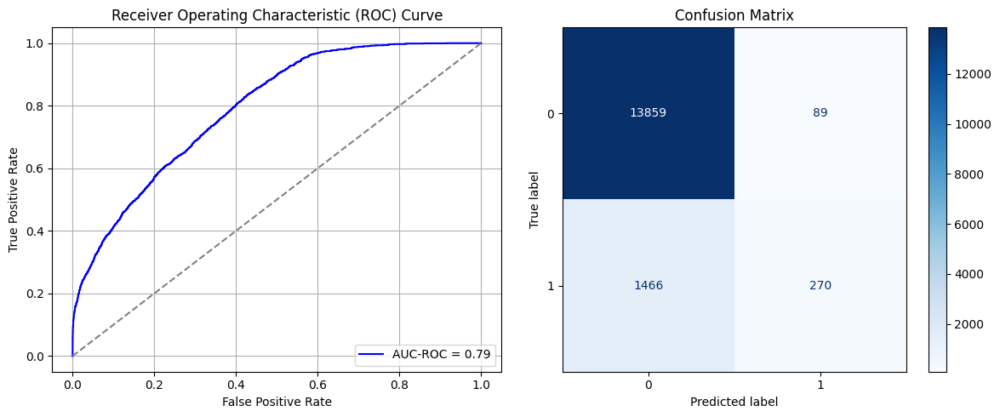

Best threshold based on F1-score: 0.12344977259635925
False Negative Rate: 0.8444700460829493
Time elapsed (performance): 1.3702407290002157
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7840 - loss: 0.5547 - val_AUC: 0.8725 - val_loss: 0.4652
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8731 - loss: 0.4402 - val_AUC: 0.8772 - val_loss: 0.4382
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.4345 - val_AUC: 0.8785 - val_loss: 0.4318
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8755 - loss: 0.4349 - val_AUC: 0.8789 - val_loss: 0.4310
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 - loss: 0.4262 - val_AUC: 0.8795 - val_loss: 0.4344
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8780 - loss: 0.4314 - val_AUC: 0.8802 - val_loss: 0.4287
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8803 - loss: 0.4278 - val_AUC: 0.8809 - val_loss: 0.4280
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8817 - loss: 0.4244 - val_AUC: 0.8813 - val_loss: 0.4264
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8818 -

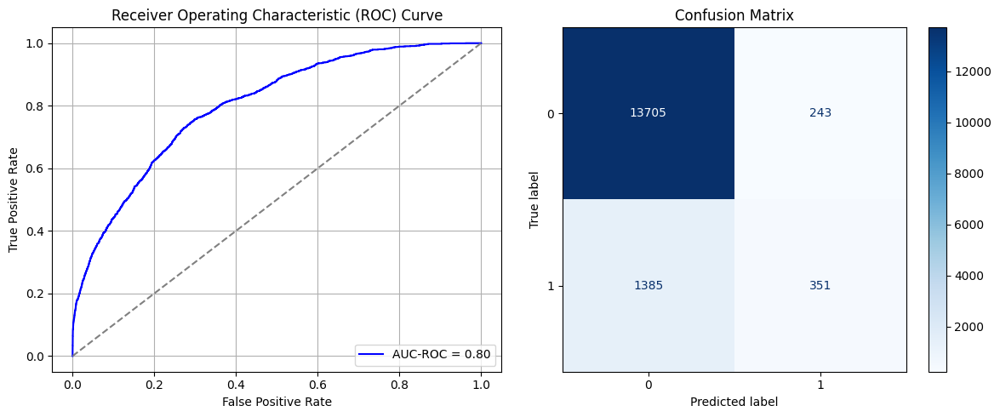

Best threshold based on F1-score: 0.2371877133846283
False Negative Rate: 0.7978110599078341
Time elapsed (performance): 1.4672890570000163
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7830 - loss: 0.5654 - val_AUC: 0.8707 - val_loss: 0.4475
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8704 - loss: 0.4451 - val_AUC: 0.8741 - val_loss: 0.4481
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8742 - loss: 0.4392 - val_AUC: 0.8756 - val_loss: 0.4386
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8741 - loss: 0.4387 - val_AUC: 0.8761 - val_loss: 0.4473
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4337 - val_AUC: 0.8776 - val_loss: 0.4337
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.8772 - loss: 0.4338 - val_AUC: 0.8779 - val_loss: 0.4469
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4297 - val_AUC: 0.8780 - val_loss: 0.4335
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8789 - loss: 0.4302 - val_AUC: 0.8784 - val_loss: 0.4318
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8812 -

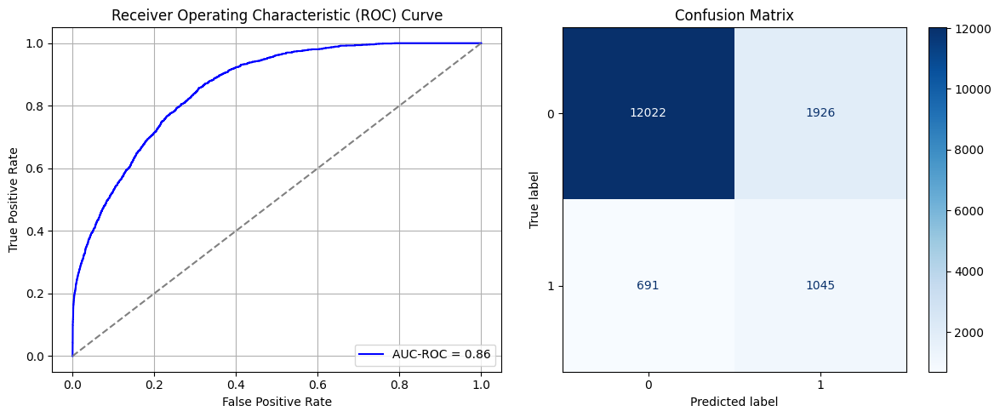

Best threshold based on F1-score: 0.5979421734809875
False Negative Rate: 0.3980414746543779
Time elapsed (performance): 1.1773092269995686
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7628 - loss: 0.5716 - val_AUC: 0.8715 - val_loss: 0.4438
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8733 - loss: 0.4414 - val_AUC: 0.8755 - val_loss: 0.4374
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8723 - loss: 0.4421 - val_AUC: 0.8756 - val_loss: 0.4364
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4361 - val_AUC: 0.8769 - val_loss: 0.4391
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.4323 - val_AUC: 0.8773 - val_loss: 0.4331
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8758 - loss: 0.4348 - val_AUC: 0.8779 - val_loss: 0.4312
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8777 - loss: 0.4319 - val_AUC: 0.8781 - val_loss: 0.4310
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4324 - val_AUC: 0.8773 - val_loss: 0.4324
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8825 -

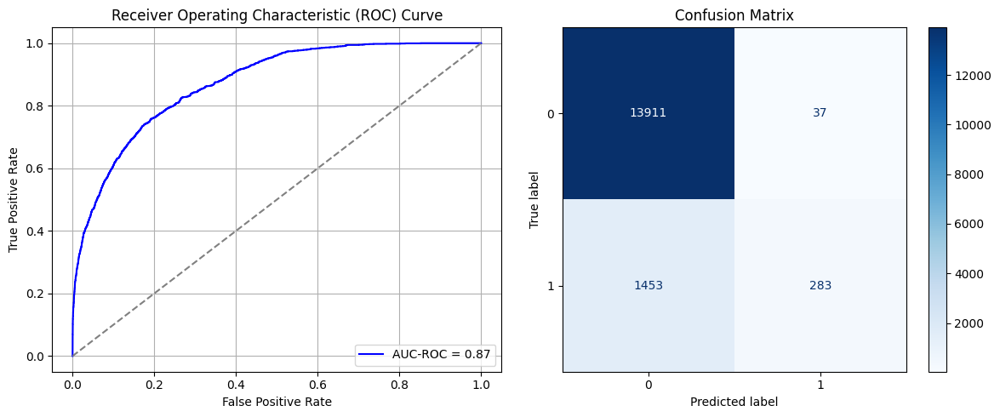

Best threshold based on F1-score: 0.05734501779079437
False Negative Rate: 0.8369815668202765
Time elapsed (performance): 1.6726742789996933
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7747 - loss: 0.5684 - val_AUC: 0.8668 - val_loss: 0.4487
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8764 - loss: 0.4343 - val_AUC: 0.8696 - val_loss: 0.4441
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8769 - loss: 0.4326 - val_AUC: 0.8702 - val_loss: 0.4458
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8764 - loss: 0.4337 - val_AUC: 0.8715 - val_loss: 0.4402
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8747 - loss: 0.4357 - val_AUC: 0.8712 - val_loss: 0.4444
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8781 - loss: 0.4303 - val_AUC: 0.8723 - val_loss: 0.4400
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8767 - loss: 0.4320 - val_AUC: 0.8729 - val_loss: 0.4414
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8807 - loss: 0.4259 - val_AUC: 0.8723 - val_loss: 0.4432
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8806 -

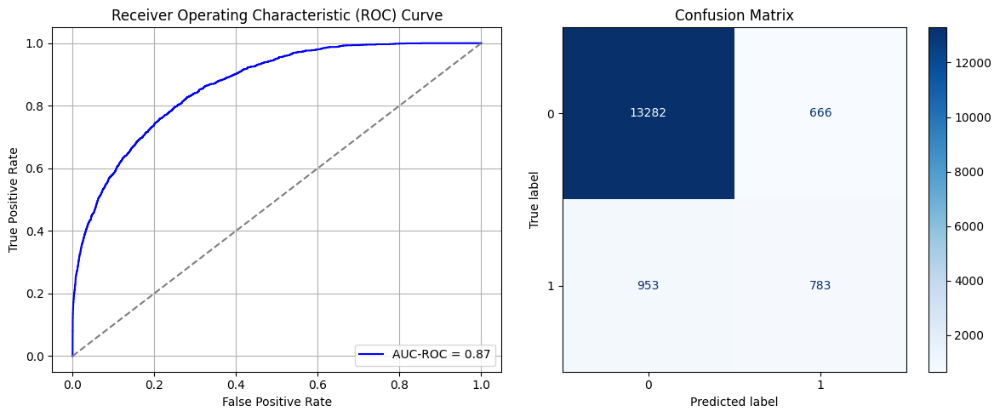

Best threshold based on F1-score: 0.4618472754955292
False Negative Rate: 0.548963133640553
Time elapsed (performance): 1.815356019000319
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7788 - loss: 0.5632 - val_AUC: 0.8740 - val_loss: 0.4401
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8711 - loss: 0.4456 - val_AUC: 0.8772 - val_loss: 0.4336
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8735 - loss: 0.4398 - val_AUC: 0.8782 - val_loss: 0.4335
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8764 - loss: 0.4349 - val_AUC: 0.8797 - val_loss: 0.4335
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8768 - loss: 0.4346 - val_AUC: 0.8793 - val_loss: 0.4310
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8760 - loss: 0.4348 - val_AUC: 0.8807 - val_loss: 0.4284
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4319 - val_AUC: 0.8808 - val_loss: 0.4328
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8804 - loss: 0.4266 - val_AUC: 0.8811 - val_loss: 0.4258
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8786 -

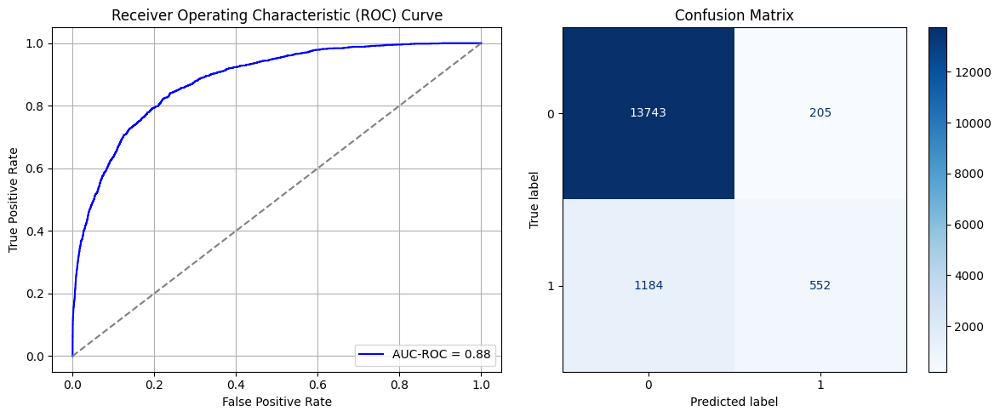

Best threshold based on F1-score: 0.23772190511226654
False Negative Rate: 0.6820276497695853
Time elapsed (performance): 1.2091551499997877
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7865 - loss: 0.5574 - val_AUC: 0.8695 - val_loss: 0.4484
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 - loss: 0.4400 - val_AUC: 0.8727 - val_loss: 0.4494
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.4394 - val_AUC: 0.8742 - val_loss: 0.4382
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8775 - loss: 0.4315 - val_AUC: 0.8749 - val_loss: 0.4370
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4268 - val_AUC: 0.8768 - val_loss: 0.4441
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8794 - loss: 0.4292 - val_AUC: 0.8769 - val_loss: 0.4338
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8822 - loss: 0.4239 - val_AUC: 0.8775 - val_loss: 0.4326
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8805 - loss: 0.4267 - val_AUC: 0.8787 - val_loss: 0.4320
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8765 -

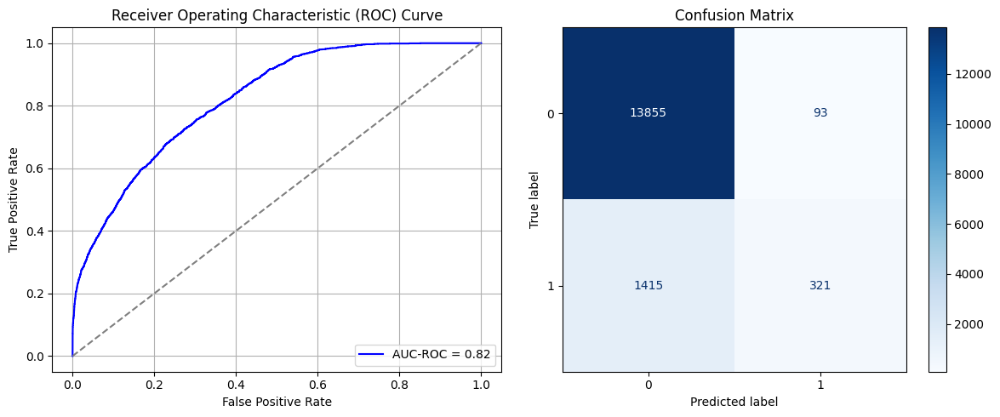

Best threshold based on F1-score: 0.09905882924795151
False Negative Rate: 0.8150921658986175
Time elapsed (performance): 1.2171679629991559
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7692 - loss: 0.5717 - val_AUC: 0.8726 - val_loss: 0.4469
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8696 - loss: 0.4447 - val_AUC: 0.8755 - val_loss: 0.4369
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8729 - loss: 0.4399 - val_AUC: 0.8764 - val_loss: 0.4351
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8747 - loss: 0.4371 - val_AUC: 0.8772 - val_loss: 0.4323
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8734 - loss: 0.4382 - val_AUC: 0.8775 - val_loss: 0.4321
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8772 - loss: 0.4326 - val_AUC: 0.8781 - val_loss: 0.4360
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4287 - val_AUC: 0.8780 - val_loss: 0.4306
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.4315 - val_AUC: 0.8782 - val_loss: 0.4304
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8783 -

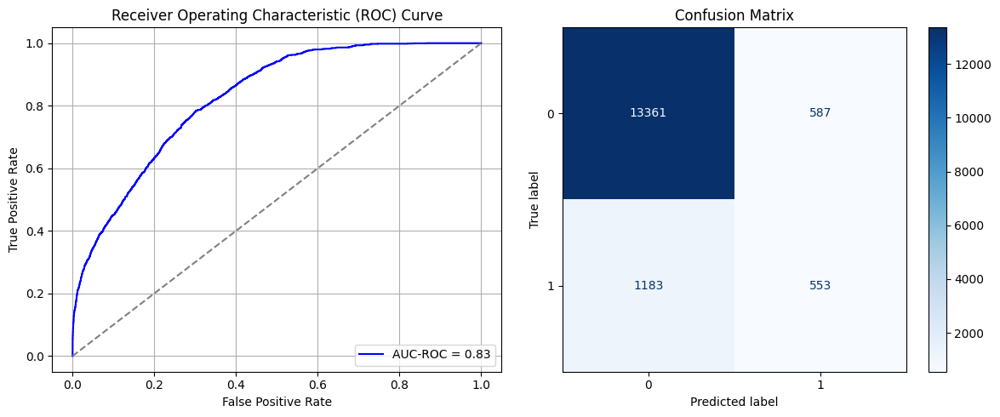

Best threshold based on F1-score: 0.4030533730983734
False Negative Rate: 0.6814516129032258
Time elapsed (performance): 1.677409058000194
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7621 - loss: 0.5718 - val_AUC: 0.8753 - val_loss: 0.4448
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8736 - loss: 0.4378 - val_AUC: 0.8780 - val_loss: 0.4325
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8764 - loss: 0.4321 - val_AUC: 0.8783 - val_loss: 0.4322
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8740 - loss: 0.4361 - val_AUC: 0.8790 - val_loss: 0.4306
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8737 - loss: 0.4373 - val_AUC: 0.8807 - val_loss: 0.4276
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8759 - loss: 0.4339 - val_AUC: 0.8807 - val_loss: 0.4317
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8788 - loss: 0.4279 - val_AUC: 0.8811 - val_loss: 0.4264
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8816 - loss: 0.4246 - val_AUC: 0.8809 - val_loss: 0.4363
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 -

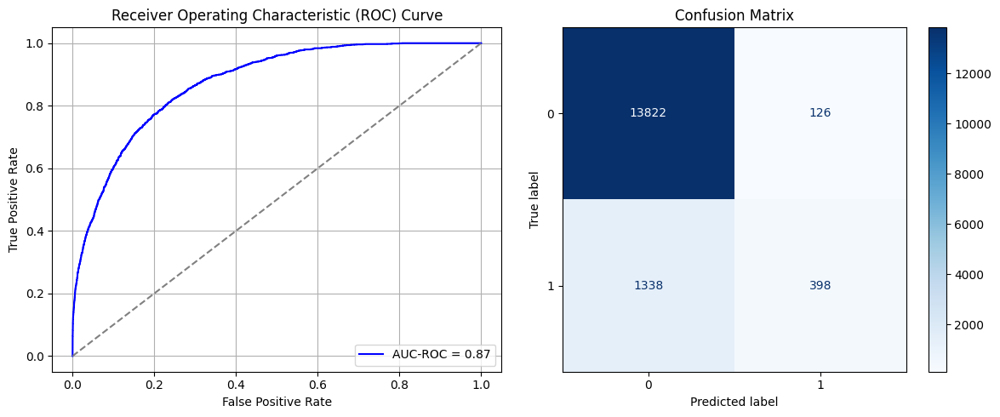

Best threshold based on F1-score: 0.17099420726299286
False Negative Rate: 0.7707373271889401
Time elapsed (performance): 1.7148214789995109
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7836 - loss: 0.5636 - val_AUC: 0.8691 - val_loss: 0.4601
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8717 - loss: 0.4424 - val_AUC: 0.8715 - val_loss: 0.4423
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8745 - loss: 0.4372 - val_AUC: 0.8724 - val_loss: 0.4402
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8771 - loss: 0.4325 - val_AUC: 0.8729 - val_loss: 0.4392
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.4363 - val_AUC: 0.8732 - val_loss: 0.4394
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8768 - loss: 0.4329 - val_AUC: 0.8735 - val_loss: 0.4381
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8786 - loss: 0.4301 - val_AUC: 0.8738 - val_loss: 0.4375
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8803 - loss: 0.4269 - val_AUC: 0.8736 - val_loss: 0.4379
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8789 -

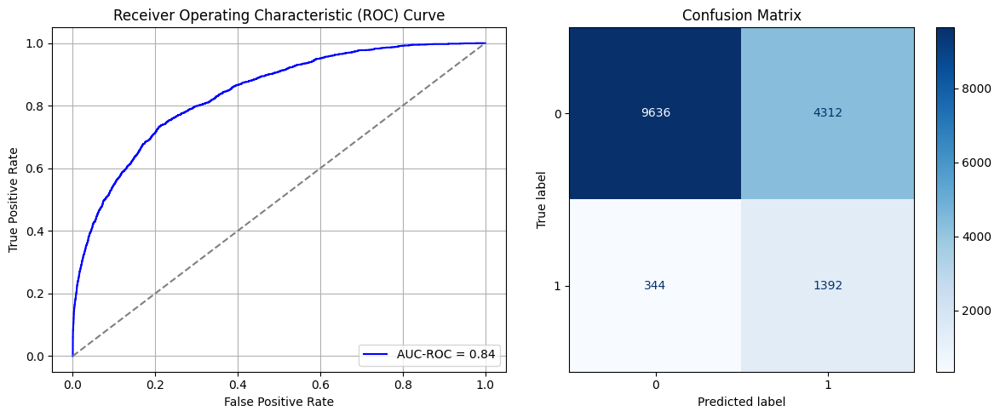

Best threshold based on F1-score: 0.8205944299697876
False Negative Rate: 0.19815668202764977
Time elapsed (performance): 1.8223476339990157
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7839 - loss: 0.5642 - val_AUC: 0.8715 - val_loss: 0.4435
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8741 - loss: 0.4371 - val_AUC: 0.8765 - val_loss: 0.4343
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8774 - loss: 0.4320 - val_AUC: 0.8766 - val_loss: 0.4501
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8777 - loss: 0.4312 - val_AUC: 0.8786 - val_loss: 0.4309
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8775 - loss: 0.4309 - val_AUC: 0.8784 - val_loss: 0.4359
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 - loss: 0.4295 - val_AUC: 0.8786 - val_loss: 0.4349
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 - loss: 0.4287 - val_AUC: 0.8789 - val_loss: 0.4369
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8836 - loss: 0.4216 - val_AUC: 0.8785 - val_loss: 0.4309
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8785 -

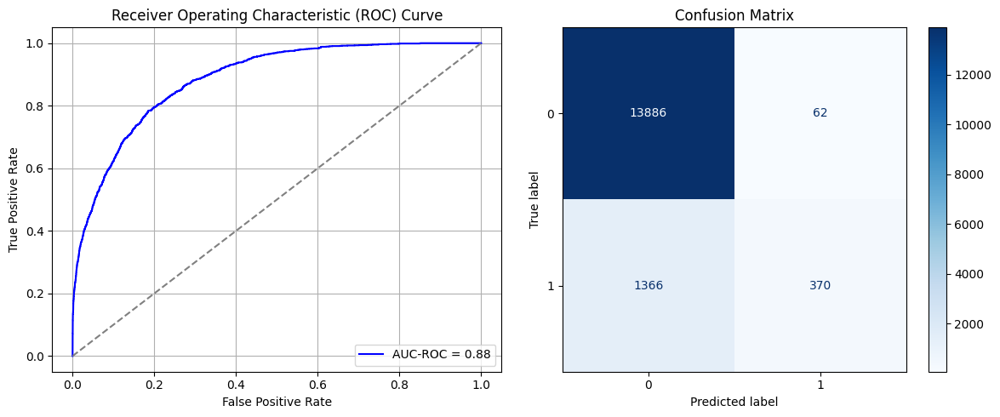

Best threshold based on F1-score: 0.14012229442596436
False Negative Rate: 0.7868663594470046
Time elapsed (performance): 1.2537273049983924
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7730 - loss: 0.5656 - val_AUC: 0.8701 - val_loss: 0.4514
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8672 - loss: 0.4481 - val_AUC: 0.8734 - val_loss: 0.4383
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8742 - loss: 0.4362 - val_AUC: 0.8754 - val_loss: 0.4339
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8764 - loss: 0.4338 - val_AUC: 0.8764 - val_loss: 0.4382
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8731 - loss: 0.4374 - val_AUC: 0.8768 - val_loss: 0.4532
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.4326 - val_AUC: 0.8774 - val_loss: 0.4296
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8798 - loss: 0.4277 - val_AUC: 0.8786 - val_loss: 0.4378
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8781 - loss: 0.4302 - val_AUC: 0.8782 - val_loss: 0.4302
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8780 -

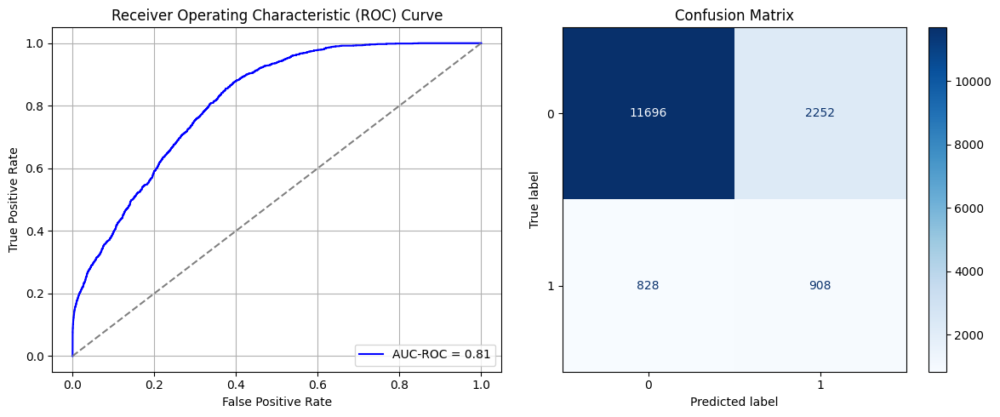

Best threshold based on F1-score: 0.537987232208252
False Negative Rate: 0.4769585253456221
Time elapsed (performance): 1.734090597001341
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7793 - loss: 0.5578 - val_AUC: 0.8735 - val_loss: 0.4403
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8725 - loss: 0.4408 - val_AUC: 0.8740 - val_loss: 0.4623
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8767 - loss: 0.4340 - val_AUC: 0.8757 - val_loss: 0.4366
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8803 - loss: 0.4285 - val_AUC: 0.8759 - val_loss: 0.4353
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 - loss: 0.4299 - val_AUC: 0.8758 - val_loss: 0.4432
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8781 - loss: 0.4315 - val_AUC: 0.8768 - val_loss: 0.4344
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8802 - loss: 0.4267 - val_AUC: 0.8773 - val_loss: 0.4341
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8831 - loss: 0.4235 - val_AUC: 0.8787 - val_loss: 0.4304
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8784 -

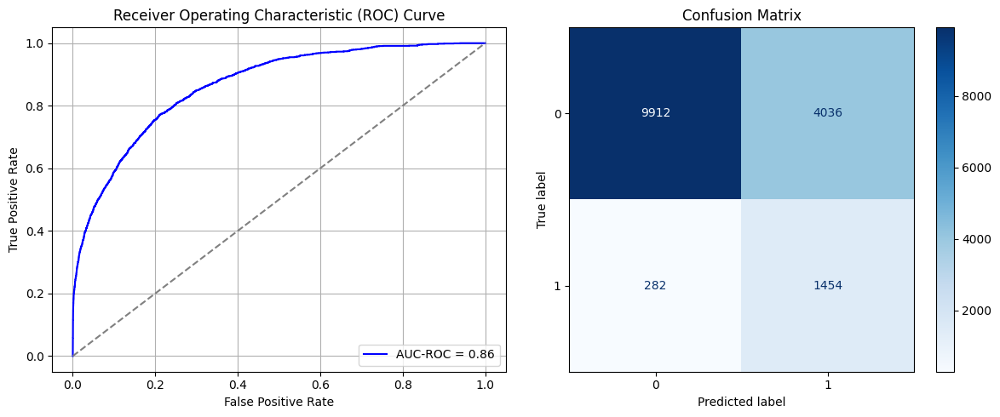

Best threshold based on F1-score: 0.780933141708374
False Negative Rate: 0.16244239631336405
Time elapsed (performance): 1.2392945820010937
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - AUC: 0.7970 - loss: 0.5540 - val_AUC: 0.8770 - val_loss: 0.4348
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4383 - val_AUC: 0.8794 - val_loss: 0.4345
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8759 - loss: 0.4343 - val_AUC: 0.8805 - val_loss: 0.4290
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8783 - loss: 0.4304 - val_AUC: 0.8810 - val_loss: 0.4259
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8779 - loss: 0.4304 - val_AUC: 0.8816 - val_loss: 0.4293
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8791 - loss: 0.4281 - val_AUC: 0.8827 - val_loss: 0.4250
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8797 - loss: 0.4278 - val_AUC: 0.8828 - val_loss: 0.4267
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8811 - loss: 0.4257 - val_AUC: 0.8830 - val_loss: 0.4250
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 -

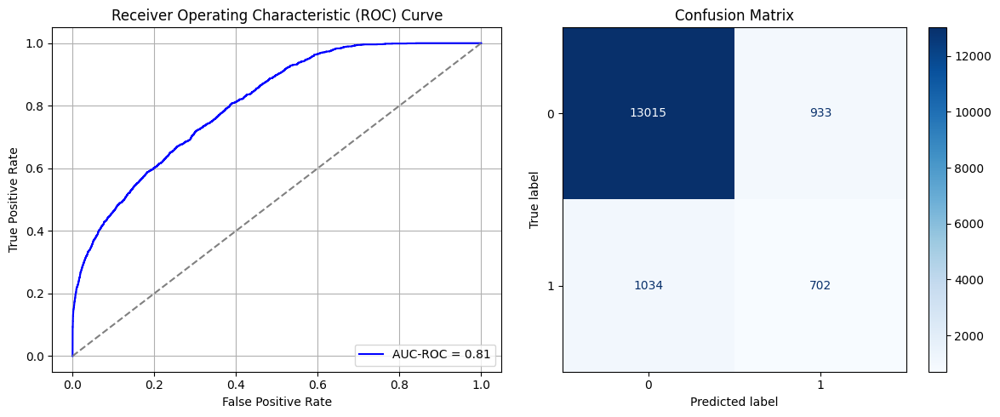

Best threshold based on F1-score: 0.5060991048812866
False Negative Rate: 0.5956221198156681
Time elapsed (performance): 1.3081115299992234
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7793 - loss: 0.5687 - val_AUC: 0.8724 - val_loss: 0.4451
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8718 - loss: 0.4418 - val_AUC: 0.8762 - val_loss: 0.4363
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8718 - loss: 0.4408 - val_AUC: 0.8772 - val_loss: 0.4355
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8752 - loss: 0.4359 - val_AUC: 0.8778 - val_loss: 0.4550
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8738 - loss: 0.4382 - val_AUC: 0.8792 - val_loss: 0.4300
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8779 - loss: 0.4297 - val_AUC: 0.8792 - val_loss: 0.4326
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8809 - loss: 0.4251 - val_AUC: 0.8791 - val_loss: 0.4322
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8770 - loss: 0.4316 - val_AUC: 0.8800 - val_loss: 0.4346
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 -

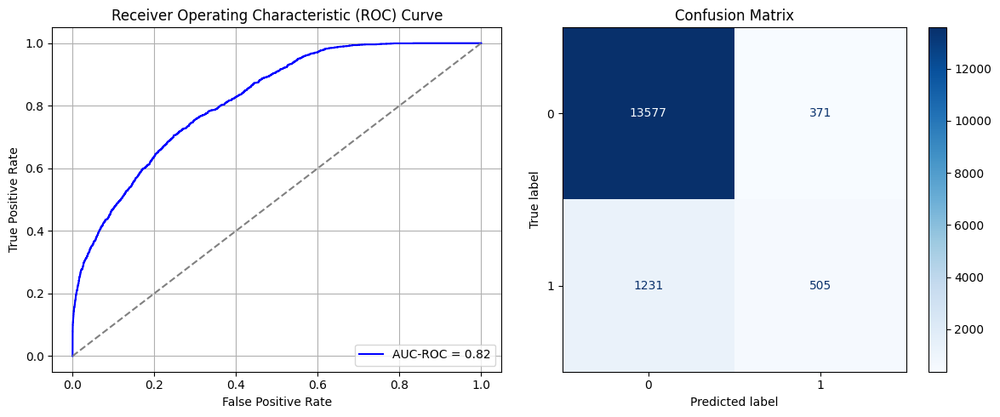

Best threshold based on F1-score: 0.3000037968158722
False Negative Rate: 0.7091013824884793
Time elapsed (performance): 1.7195643210015987
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7761 - loss: 0.5625 - val_AUC: 0.8741 - val_loss: 0.4403
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8749 - loss: 0.4366 - val_AUC: 0.8768 - val_loss: 0.4359
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8736 - loss: 0.4383 - val_AUC: 0.8774 - val_loss: 0.4329
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.4336 - val_AUC: 0.8783 - val_loss: 0.4316
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4286 - val_AUC: 0.8780 - val_loss: 0.4318
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8802 - loss: 0.4277 - val_AUC: 0.8788 - val_loss: 0.4303
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8774 - loss: 0.4314 - val_AUC: 0.8794 - val_loss: 0.4282
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8793 - loss: 0.4286 - val_AUC: 0.8797 - val_loss: 0.4280
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8773 -

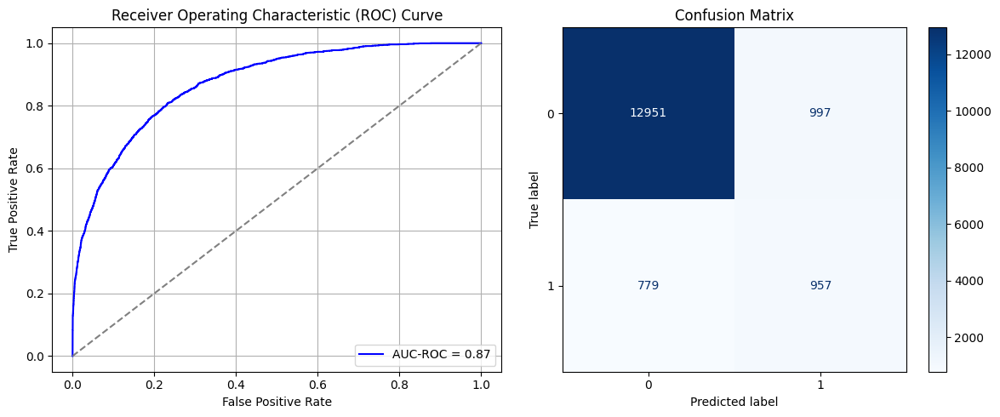

Best threshold based on F1-score: 0.5225826501846313
False Negative Rate: 0.44873271889400923
Time elapsed (performance): 1.332466387999375
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7653 - loss: 0.5725 - val_AUC: 0.8705 - val_loss: 0.4436
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8677 - loss: 0.4483 - val_AUC: 0.8729 - val_loss: 0.4401
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8727 - loss: 0.4407 - val_AUC: 0.8747 - val_loss: 0.4368
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8760 - loss: 0.4342 - val_AUC: 0.8754 - val_loss: 0.4354
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8744 - loss: 0.4375 - val_AUC: 0.8757 - val_loss: 0.4362
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8769 - loss: 0.4330 - val_AUC: 0.8763 - val_loss: 0.4358
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8819 - loss: 0.4252 - val_AUC: 0.8767 - val_loss: 0.4332
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.4310 - val_AUC: 0.8772 - val_loss: 0.4313
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8806 -

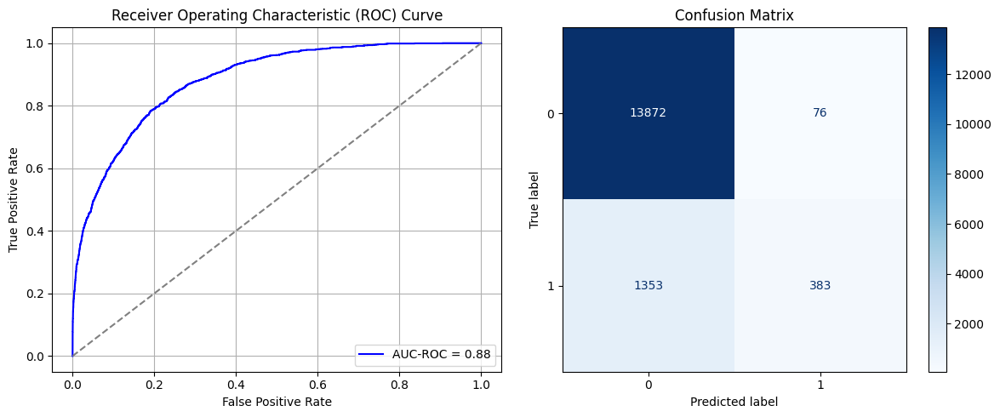

Best threshold based on F1-score: 0.14509859681129456
False Negative Rate: 0.7793778801843319
Time elapsed (performance): 1.709284893999211
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7850 - loss: 0.5621 - val_AUC: 0.8723 - val_loss: 0.4594
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8741 - loss: 0.4385 - val_AUC: 0.8752 - val_loss: 0.4358
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.4343 - val_AUC: 0.8769 - val_loss: 0.4337
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8796 - loss: 0.4273 - val_AUC: 0.8776 - val_loss: 0.4320
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8819 - loss: 0.4239 - val_AUC: 0.8784 - val_loss: 0.4321
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.4300 - val_AUC: 0.8788 - val_loss: 0.4296
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8781 - loss: 0.4304 - val_AUC: 0.8794 - val_loss: 0.4286
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8862 - loss: 0.4172 - val_AUC: 0.8791 - val_loss: 0.4319
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8839 -

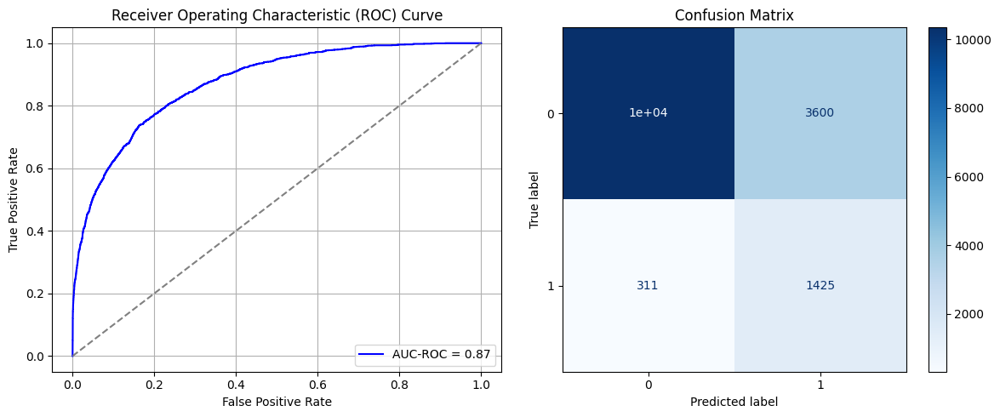

Best threshold based on F1-score: 0.7174630761146545
False Negative Rate: 0.179147465437788
Time elapsed (performance): 1.7402601090016105
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7868 - loss: 0.5557 - val_AUC: 0.8704 - val_loss: 0.4441
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8772 - loss: 0.4336 - val_AUC: 0.8741 - val_loss: 0.4431
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8756 - loss: 0.4350 - val_AUC: 0.8752 - val_loss: 0.4354
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8768 - loss: 0.4327 - val_AUC: 0.8762 - val_loss: 0.4367
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8800 - loss: 0.4274 - val_AUC: 0.8752 - val_loss: 0.4360
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8801 - loss: 0.4275 - val_AUC: 0.8773 - val_loss: 0.4350
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8801 - loss: 0.4276 - val_AUC: 0.8772 - val_loss: 0.4394
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8825 - loss: 0.4245 - val_AUC: 0.8777 - val_loss: 0.4375
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8776 -

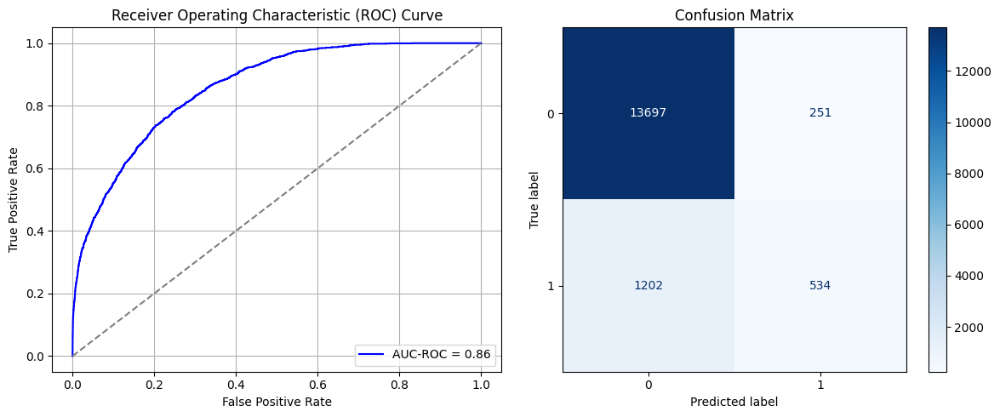

Best threshold based on F1-score: 0.23403967916965485
False Negative Rate: 0.6923963133640553
Time elapsed (performance): 1.7004506590001256
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7791 - loss: 0.5661 - val_AUC: 0.8686 - val_loss: 0.4482
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8681 - loss: 0.4477 - val_AUC: 0.8717 - val_loss: 0.4420
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8704 - loss: 0.4441 - val_AUC: 0.8733 - val_loss: 0.4401
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8729 - loss: 0.4399 - val_AUC: 0.8739 - val_loss: 0.4370
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8767 - loss: 0.4345 - val_AUC: 0.8733 - val_loss: 0.4381
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8830 - loss: 0.4241 - val_AUC: 0.8745 - val_loss: 0.4424
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8755 - loss: 0.4344 - val_AUC: 0.8756 - val_loss: 0.4340
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8768 - loss: 0.4332 - val_AUC: 0.8761 - val_loss: 0.4585
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8806 -

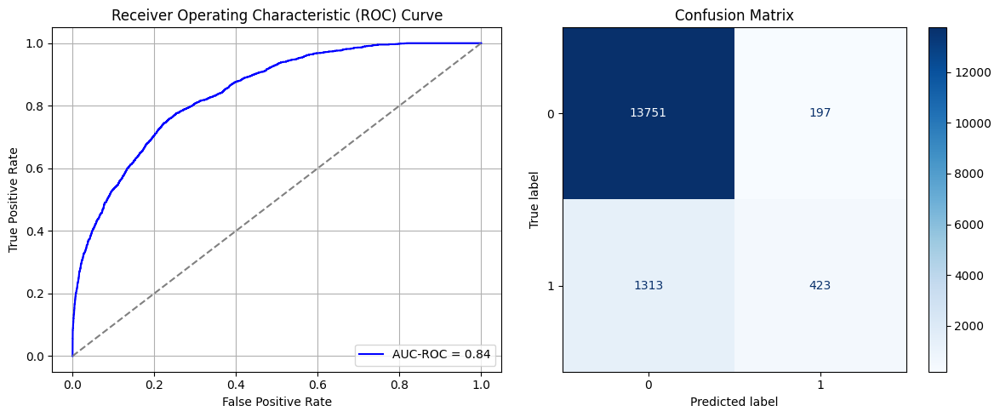

Best threshold based on F1-score: 0.2190776765346527
False Negative Rate: 0.756336405529954
Time elapsed (performance): 1.6811765839993313
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7701 - loss: 0.5680 - val_AUC: 0.8740 - val_loss: 0.4395
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8747 - loss: 0.4382 - val_AUC: 0.8768 - val_loss: 0.4381
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8754 - loss: 0.4347 - val_AUC: 0.8779 - val_loss: 0.4310
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8738 - loss: 0.4374 - val_AUC: 0.8787 - val_loss: 0.4296
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8789 - loss: 0.4302 - val_AUC: 0.8796 - val_loss: 0.4287
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8795 - loss: 0.4285 - val_AUC: 0.8802 - val_loss: 0.4276
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - AUC: 0.8824 - loss: 0.4234 - val_AUC: 0.8803 - val_loss: 0.4271
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4285 - val_AUC: 0.8798 - val_loss: 0.4287
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8794 -

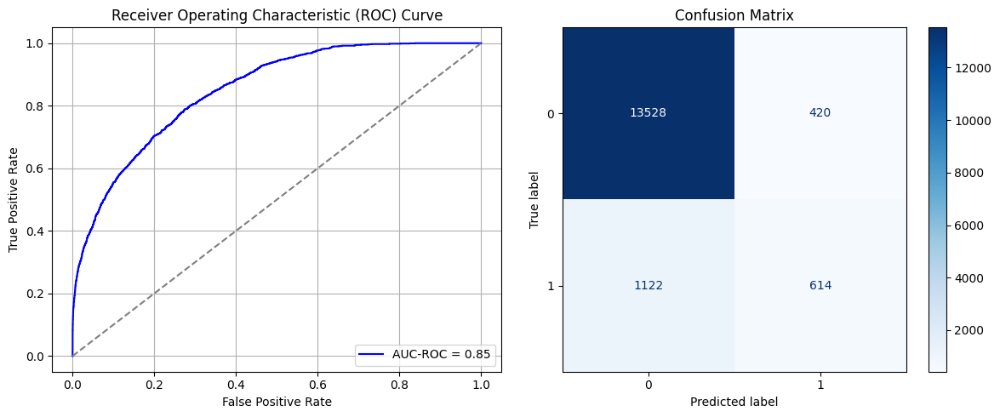

Best threshold based on F1-score: 0.34280499815940857
False Negative Rate: 0.6463133640552995
Time elapsed (performance): 1.9015094520000275
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7846 - loss: 0.5629 - val_AUC: 0.8731 - val_loss: 0.4425
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8723 - loss: 0.4411 - val_AUC: 0.8760 - val_loss: 0.4413
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8731 - loss: 0.4388 - val_AUC: 0.8780 - val_loss: 0.4598
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8759 - loss: 0.4350 - val_AUC: 0.8777 - val_loss: 0.4327
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8746 - loss: 0.4363 - val_AUC: 0.8788 - val_loss: 0.4314
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8755 - loss: 0.4357 - val_AUC: 0.8792 - val_loss: 0.4298
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 - loss: 0.4248 - val_AUC: 0.8790 - val_loss: 0.4303
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8816 - loss: 0.4258 - val_AUC: 0.8792 - val_loss: 0.4307
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8779 -

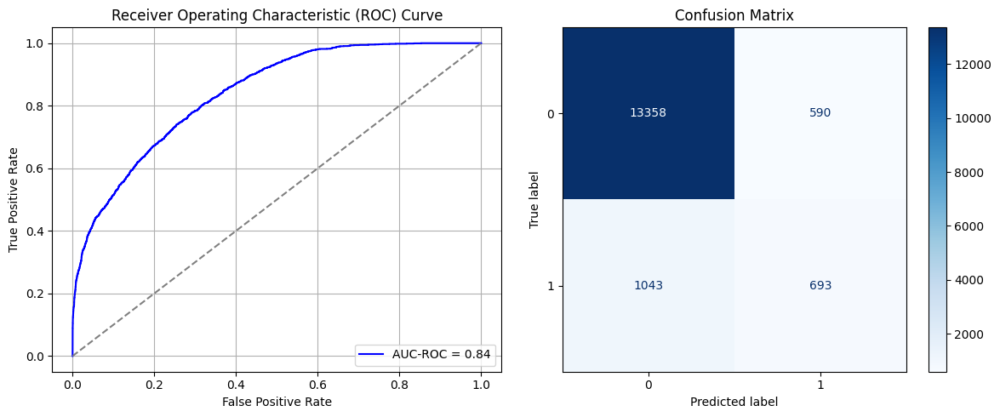

Best threshold based on F1-score: 0.45488208532333374
False Negative Rate: 0.6008064516129032
Time elapsed (performance): 1.7082017639986589
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7787 - loss: 0.5674 - val_AUC: 0.8699 - val_loss: 0.4482
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8716 - loss: 0.4423 - val_AUC: 0.8730 - val_loss: 0.4398
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8778 - loss: 0.4323 - val_AUC: 0.8739 - val_loss: 0.4417
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8758 - loss: 0.4342 - val_AUC: 0.8751 - val_loss: 0.4384
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8809 - loss: 0.4265 - val_AUC: 0.8762 - val_loss: 0.4370
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4333 - val_AUC: 0.8755 - val_loss: 0.4367
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8798 - loss: 0.4288 - val_AUC: 0.8763 - val_loss: 0.4350
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.4307 - val_AUC: 0.8770 - val_loss: 0.4370
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8822 -

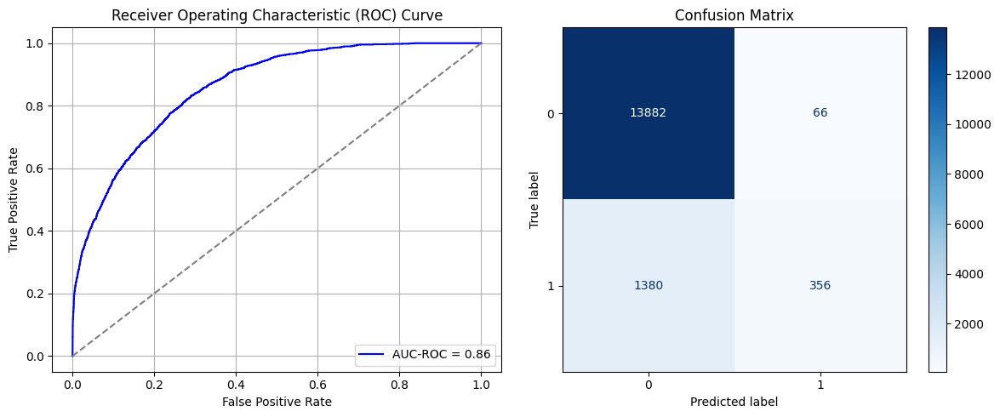

Best threshold based on F1-score: 0.10111823678016663
False Negative Rate: 0.7949308755760369
Time elapsed (performance): 1.3527179570010048
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7693 - loss: 0.5735 - val_AUC: 0.8724 - val_loss: 0.4459
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8727 - loss: 0.4408 - val_AUC: 0.8755 - val_loss: 0.4356
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8712 - loss: 0.4409 - val_AUC: 0.8768 - val_loss: 0.4336
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4311 - val_AUC: 0.8769 - val_loss: 0.4422
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.4329 - val_AUC: 0.8778 - val_loss: 0.4391
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8767 - loss: 0.4342 - val_AUC: 0.8796 - val_loss: 0.4365
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8785 - loss: 0.4292 - val_AUC: 0.8793 - val_loss: 0.4309
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 - loss: 0.4293 - val_AUC: 0.8788 - val_loss: 0.4298
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8784 -

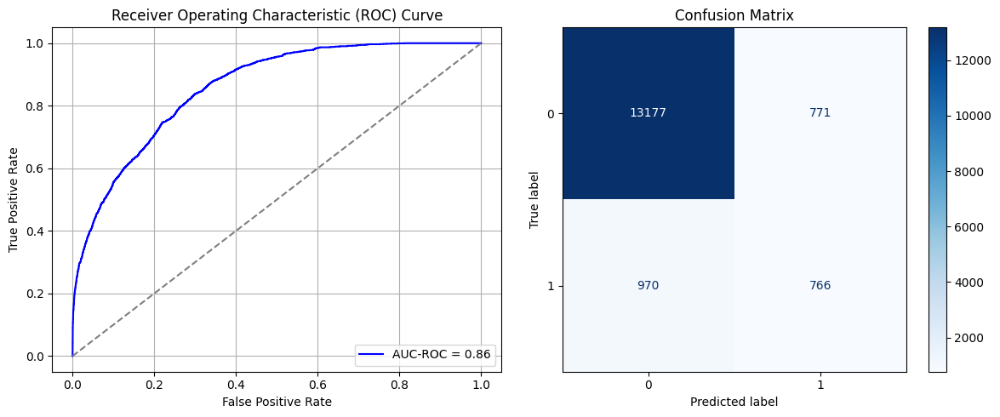

Best threshold based on F1-score: 0.45294976234436035
False Negative Rate: 0.5587557603686636
Time elapsed (performance): 1.7265671969998948
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7801 - loss: 0.5572 - val_AUC: 0.8722 - val_loss: 0.4447
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8713 - loss: 0.4432 - val_AUC: 0.8747 - val_loss: 0.4426
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8722 - loss: 0.4402 - val_AUC: 0.8760 - val_loss: 0.4375
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8771 - loss: 0.4324 - val_AUC: 0.8780 - val_loss: 0.4349
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 - loss: 0.4305 - val_AUC: 0.8791 - val_loss: 0.4315
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8778 - loss: 0.4307 - val_AUC: 0.8798 - val_loss: 0.4296
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8808 - loss: 0.4248 - val_AUC: 0.8802 - val_loss: 0.4271
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8786 - loss: 0.4294 - val_AUC: 0.8805 - val_loss: 0.4265
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8821 -

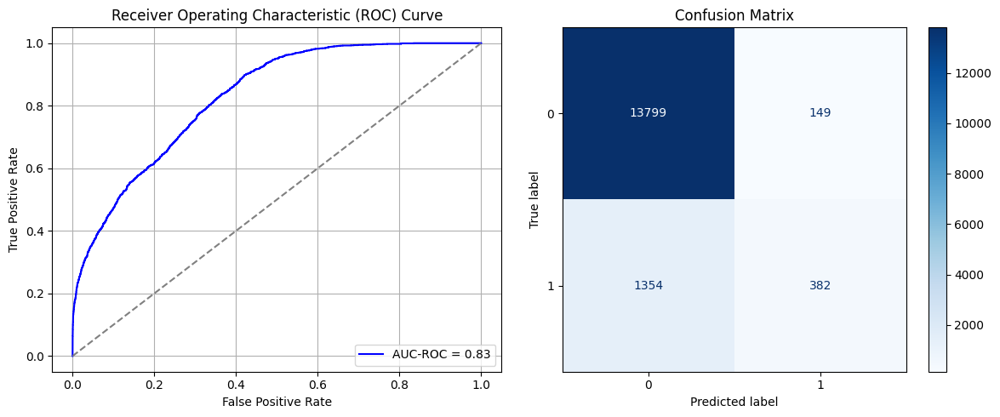

Best threshold based on F1-score: 0.1473543643951416
False Negative Rate: 0.7799539170506913
Time elapsed (performance): 3.013623605000248
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7817 - loss: 0.5647 - val_AUC: 0.8735 - val_loss: 0.4399
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8713 - loss: 0.4416 - val_AUC: 0.8763 - val_loss: 0.4362
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8781 - loss: 0.4318 - val_AUC: 0.8777 - val_loss: 0.4317
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8766 - loss: 0.4335 - val_AUC: 0.8762 - val_loss: 0.4340
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4313 - val_AUC: 0.8785 - val_loss: 0.4305
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8781 - loss: 0.4298 - val_AUC: 0.8781 - val_loss: 0.4340
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 - loss: 0.4283 - val_AUC: 0.8784 - val_loss: 0.4393
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8754 - loss: 0.4324 - val_AUC: 0.8785 - val_loss: 0.4306
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 -

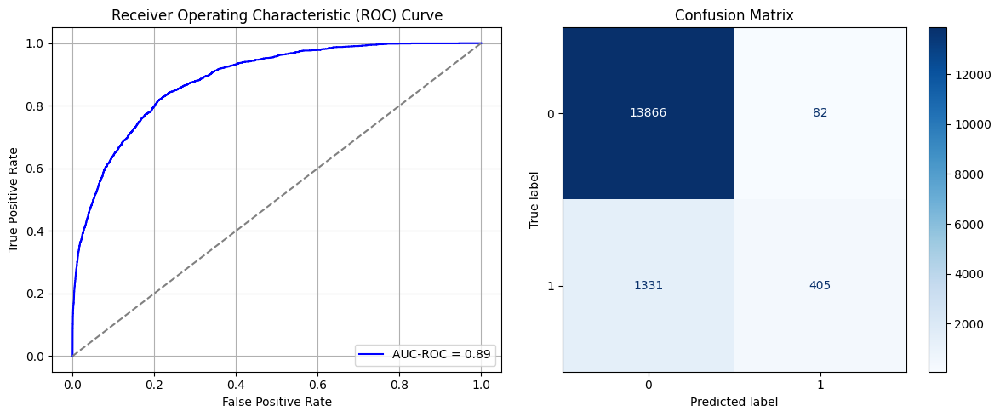

Best threshold based on F1-score: 0.1284976452589035
False Negative Rate: 0.7667050691244239
Time elapsed (performance): 1.720287169000585
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7746 - loss: 0.5630 - val_AUC: 0.8703 - val_loss: 0.4441
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8722 - loss: 0.4412 - val_AUC: 0.8739 - val_loss: 0.4454
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4348 - val_AUC: 0.8751 - val_loss: 0.4349
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8773 - loss: 0.4326 - val_AUC: 0.8753 - val_loss: 0.4350
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4326 - val_AUC: 0.8767 - val_loss: 0.4322
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8785 - loss: 0.4302 - val_AUC: 0.8769 - val_loss: 0.4334
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4346 - val_AUC: 0.8773 - val_loss: 0.4312
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8779 - loss: 0.4304 - val_AUC: 0.8767 - val_loss: 0.4352
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 -

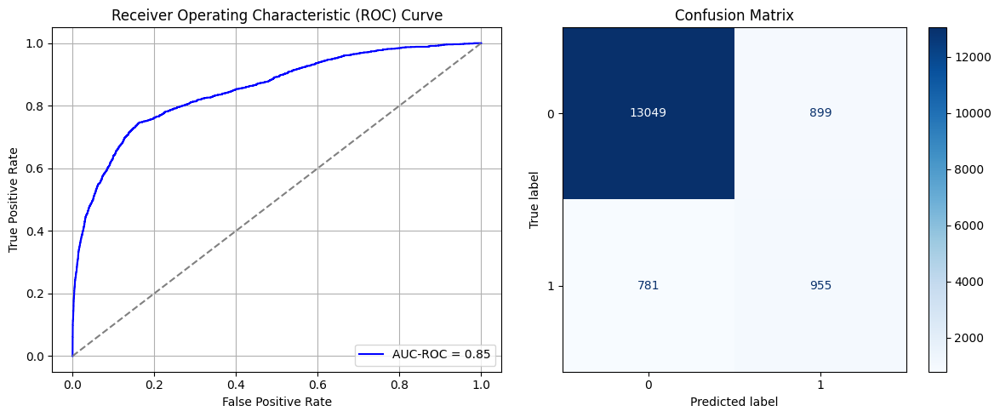

Best threshold based on F1-score: 0.5044108629226685
False Negative Rate: 0.4498847926267281
Time elapsed (performance): 1.9583830930005206
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7822 - loss: 0.5584 - val_AUC: 0.8720 - val_loss: 0.4422
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8761 - loss: 0.4356 - val_AUC: 0.8740 - val_loss: 0.4378
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8758 - loss: 0.4352 - val_AUC: 0.8726 - val_loss: 0.4442
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8775 - loss: 0.4340 - val_AUC: 0.8746 - val_loss: 0.4430
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8770 - loss: 0.4336 - val_AUC: 0.8747 - val_loss: 0.4363
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8773 - loss: 0.4323 - val_AUC: 0.8748 - val_loss: 0.4407
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 - loss: 0.4302 - val_AUC: 0.8757 - val_loss: 0.4338
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 - loss: 0.4320 - val_AUC: 0.8764 - val_loss: 0.4323
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8827 -

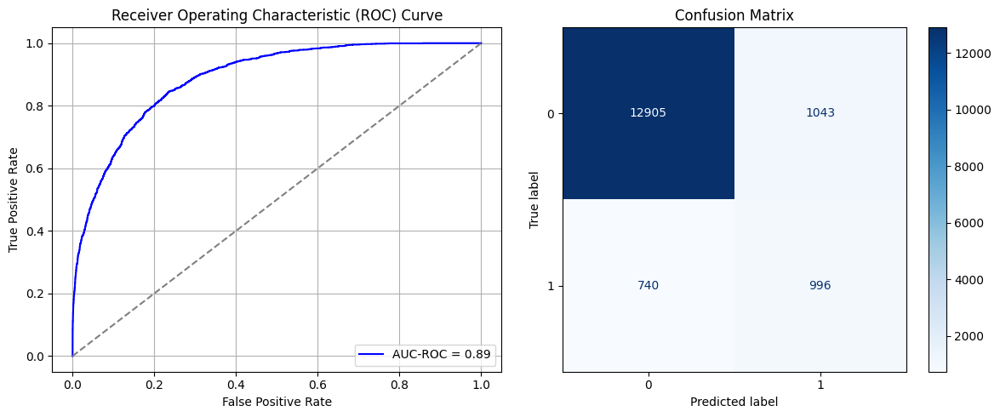

Best threshold based on F1-score: 0.48925456404685974
False Negative Rate: 0.42626728110599077
Time elapsed (performance): 1.4066002729996399
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7762 - loss: 0.5666 - val_AUC: 0.8737 - val_loss: 0.4538
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8718 - loss: 0.4432 - val_AUC: 0.8758 - val_loss: 0.4353
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8734 - loss: 0.4389 - val_AUC: 0.8771 - val_loss: 0.4340
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8710 - loss: 0.4424 - val_AUC: 0.8774 - val_loss: 0.4389
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8750 - loss: 0.4361 - val_AUC: 0.8772 - val_loss: 0.4404
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8783 - loss: 0.4297 - val_AUC: 0.8785 - val_loss: 0.4312
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4406 - val_AUC: 0.8790 - val_loss: 0.4286
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8742 - loss: 0.4375 - val_AUC: 0.8775 - val_loss: 0.4481
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8737 -

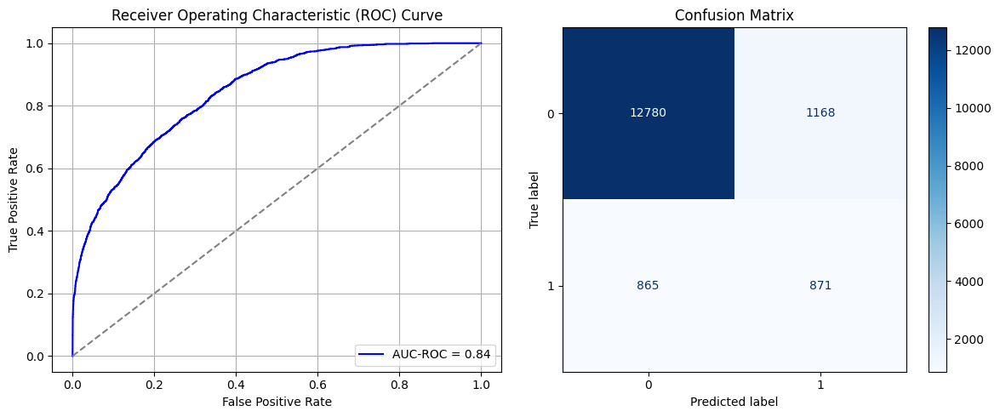

Best threshold based on F1-score: 0.5416091084480286
False Negative Rate: 0.49827188940092165
Time elapsed (performance): 1.362258142000428
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7818 - loss: 0.5629 - val_AUC: 0.8707 - val_loss: 0.4444
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8713 - loss: 0.4442 - val_AUC: 0.8739 - val_loss: 0.4410
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.4330 - val_AUC: 0.8758 - val_loss: 0.4375
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4325 - val_AUC: 0.8763 - val_loss: 0.4497
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.4333 - val_AUC: 0.8772 - val_loss: 0.4360
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8811 - loss: 0.4256 - val_AUC: 0.8778 - val_loss: 0.4323
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8776 - loss: 0.4319 - val_AUC: 0.8771 - val_loss: 0.4327
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8771 - loss: 0.4305 - val_AUC: 0.8776 - val_loss: 0.4317
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8815 -

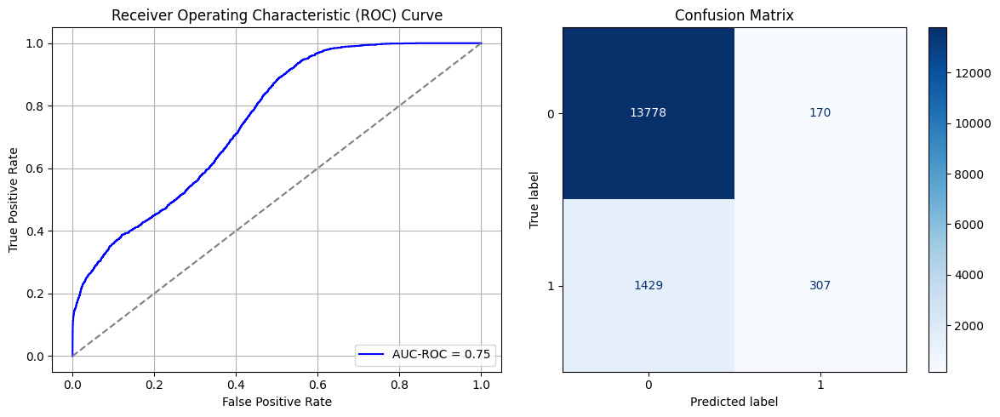

Best threshold based on F1-score: 0.22246263921260834
False Negative Rate: 0.8231566820276498
Time elapsed (performance): 1.455284715999369
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7768 - loss: 0.5630 - val_AUC: 0.8738 - val_loss: 0.4423
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8744 - loss: 0.4384 - val_AUC: 0.8768 - val_loss: 0.4362
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8754 - loss: 0.4357 - val_AUC: 0.8769 - val_loss: 0.4380
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4346 - val_AUC: 0.8772 - val_loss: 0.4342
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8806 - loss: 0.4264 - val_AUC: 0.8783 - val_loss: 0.4412
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8756 - loss: 0.4345 - val_AUC: 0.8785 - val_loss: 0.4324
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8787 - loss: 0.4304 - val_AUC: 0.8787 - val_loss: 0.4362
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8790 - loss: 0.4290 - val_AUC: 0.8787 - val_loss: 0.4305
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8821 -

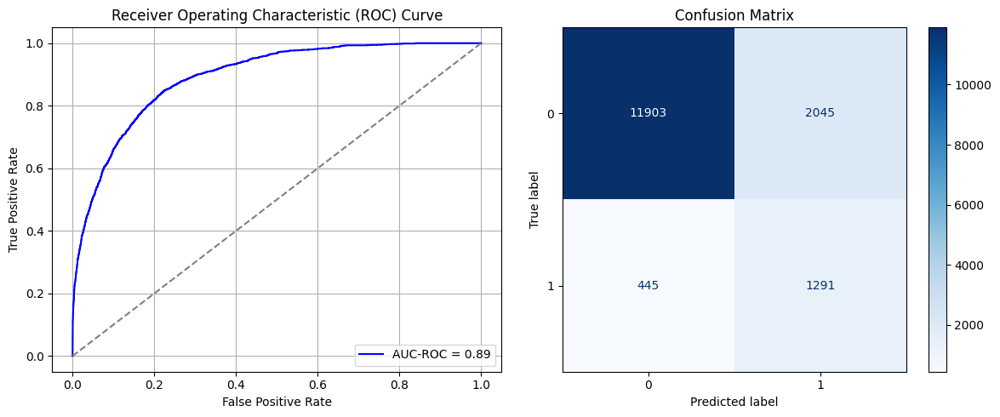

Best threshold based on F1-score: 0.6266537308692932
False Negative Rate: 0.2563364055299539
Time elapsed (performance): 1.3893861800006562
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7868 - loss: 0.5644 - val_AUC: 0.8699 - val_loss: 0.4508
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8720 - loss: 0.4409 - val_AUC: 0.8725 - val_loss: 0.4431
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8766 - loss: 0.4340 - val_AUC: 0.8733 - val_loss: 0.4420
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4334 - val_AUC: 0.8743 - val_loss: 0.4578
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 - loss: 0.4319 - val_AUC: 0.8754 - val_loss: 0.4377
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8800 - loss: 0.4284 - val_AUC: 0.8752 - val_loss: 0.4545
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8830 - loss: 0.4221 - val_AUC: 0.8756 - val_loss: 0.4385
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8782 - loss: 0.4298 - val_AUC: 0.8755 - val_loss: 0.4379
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8785 -

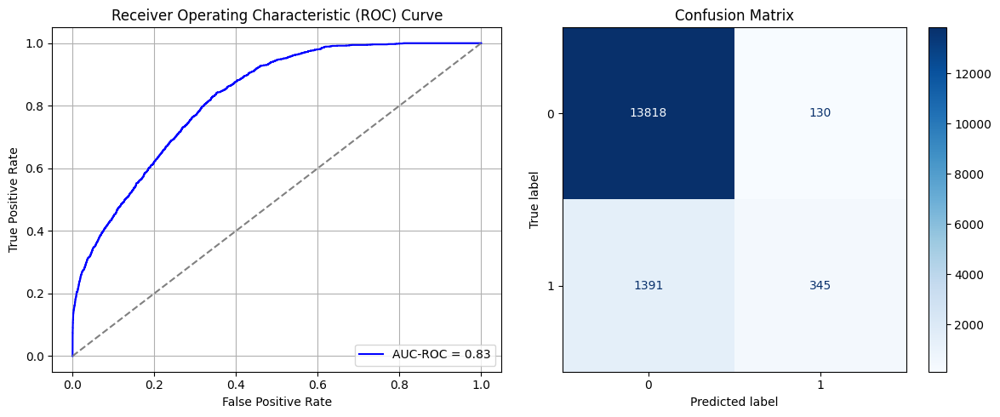

Best threshold based on F1-score: 0.24849891662597656
False Negative Rate: 0.8012672811059908
Time elapsed (performance): 1.3651673730000766
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7814 - loss: 0.5632 - val_AUC: 0.8722 - val_loss: 0.4451
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8710 - loss: 0.4429 - val_AUC: 0.8749 - val_loss: 0.4391
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8769 - loss: 0.4327 - val_AUC: 0.8756 - val_loss: 0.4387
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8787 - loss: 0.4303 - val_AUC: 0.8764 - val_loss: 0.4362
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8747 - loss: 0.4370 - val_AUC: 0.8771 - val_loss: 0.4360
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 - loss: 0.4291 - val_AUC: 0.8774 - val_loss: 0.4338
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.4298 - val_AUC: 0.8779 - val_loss: 0.4339
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8799 - loss: 0.4273 - val_AUC: 0.8783 - val_loss: 0.4321
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8809 -

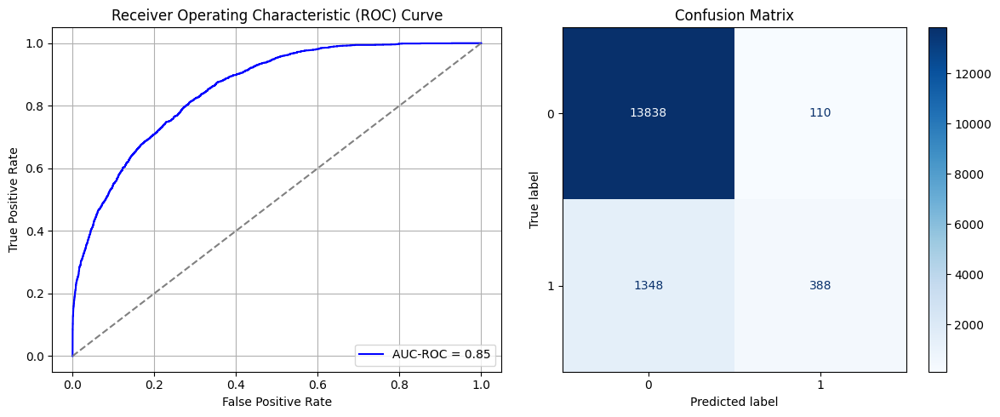

Best threshold based on F1-score: 0.18552076816558838
False Negative Rate: 0.7764976958525346
Time elapsed (performance): 1.3593944249987544
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7849 - loss: 0.5634 - val_AUC: 0.8731 - val_loss: 0.4479
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4382 - val_AUC: 0.8758 - val_loss: 0.4352
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8769 - loss: 0.4332 - val_AUC: 0.8771 - val_loss: 0.4368
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4345 - val_AUC: 0.8771 - val_loss: 0.4345
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4325 - val_AUC: 0.8777 - val_loss: 0.4324
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8801 - loss: 0.4279 - val_AUC: 0.8778 - val_loss: 0.4385
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8802 - loss: 0.4260 - val_AUC: 0.8785 - val_loss: 0.4338
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8834 - loss: 0.4216 - val_AUC: 0.8783 - val_loss: 0.4327
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8796 -

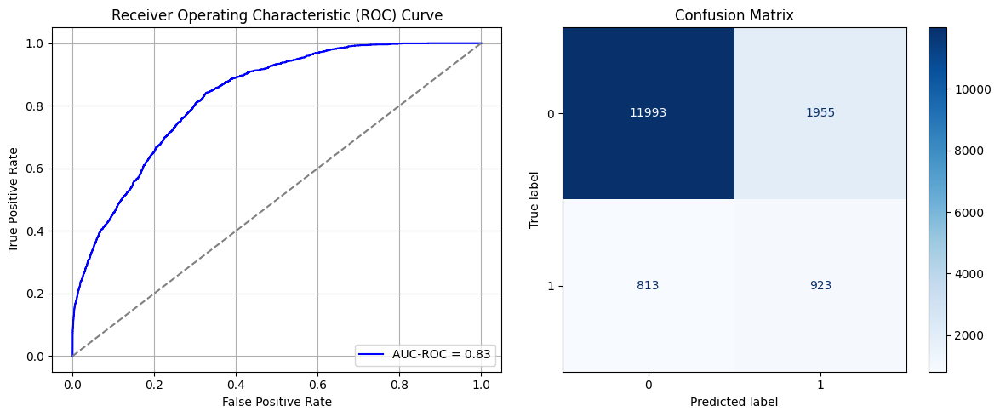

Best threshold based on F1-score: 0.6704546213150024
False Negative Rate: 0.4683179723502304
Time elapsed (performance): 1.696108567999545
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7778 - loss: 0.5644 - val_AUC: 0.8725 - val_loss: 0.4456
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8716 - loss: 0.4416 - val_AUC: 0.8745 - val_loss: 0.4361
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8754 - loss: 0.4363 - val_AUC: 0.8759 - val_loss: 0.4356
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4330 - val_AUC: 0.8762 - val_loss: 0.4353
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8745 - loss: 0.4365 - val_AUC: 0.8772 - val_loss: 0.4319
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8787 - loss: 0.4301 - val_AUC: 0.8778 - val_loss: 0.4316
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8771 - loss: 0.4330 - val_AUC: 0.8781 - val_loss: 0.4470
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.4318 - val_AUC: 0.8779 - val_loss: 0.4377
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8805 -

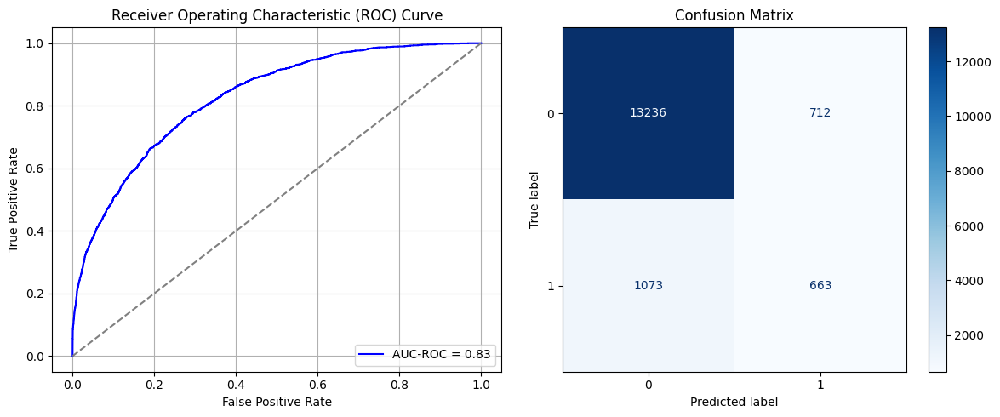

Best threshold based on F1-score: 0.40044477581977844
False Negative Rate: 0.6180875576036866
Time elapsed (performance): 1.954755672999454
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7864 - loss: 0.5621 - val_AUC: 0.8734 - val_loss: 0.4395
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8711 - loss: 0.4428 - val_AUC: 0.8754 - val_loss: 0.4370
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8797 - loss: 0.4284 - val_AUC: 0.8755 - val_loss: 0.4345
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8778 - loss: 0.4313 - val_AUC: 0.8766 - val_loss: 0.4450
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8797 - loss: 0.4288 - val_AUC: 0.8773 - val_loss: 0.4442
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8775 - loss: 0.4309 - val_AUC: 0.8790 - val_loss: 0.4311
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8795 - loss: 0.4275 - val_AUC: 0.8792 - val_loss: 0.4288
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8798 - loss: 0.4269 - val_AUC: 0.8788 - val_loss: 0.4322
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8777 -

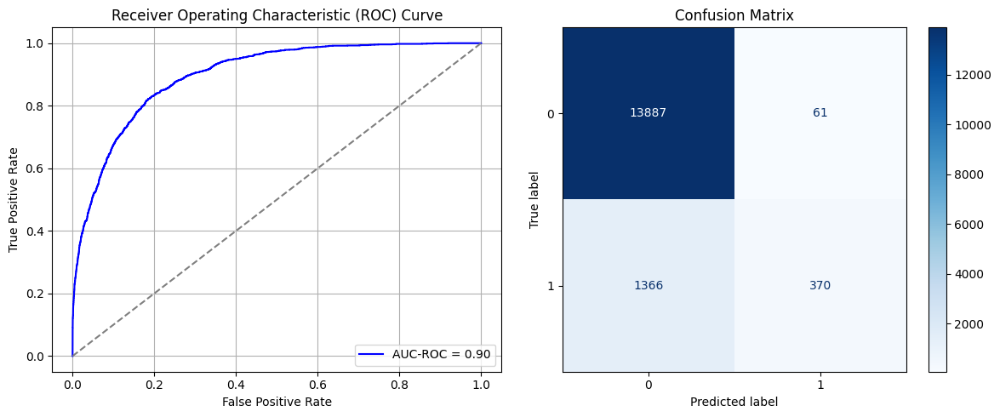

Best threshold based on F1-score: 0.10200127214193344
False Negative Rate: 0.7868663594470046
Time elapsed (performance): 1.6873871010011499
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7914 - loss: 0.5620 - val_AUC: 0.8737 - val_loss: 0.4419
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8754 - loss: 0.4354 - val_AUC: 0.8773 - val_loss: 0.4377
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8761 - loss: 0.4345 - val_AUC: 0.8791 - val_loss: 0.4332
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.4331 - val_AUC: 0.8799 - val_loss: 0.4289
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4294 - val_AUC: 0.8811 - val_loss: 0.4289
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8822 - loss: 0.4248 - val_AUC: 0.8809 - val_loss: 0.4265
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8809 - loss: 0.4258 - val_AUC: 0.8810 - val_loss: 0.4270
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8823 - loss: 0.4242 - val_AUC: 0.8823 - val_loss: 0.4250
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 -

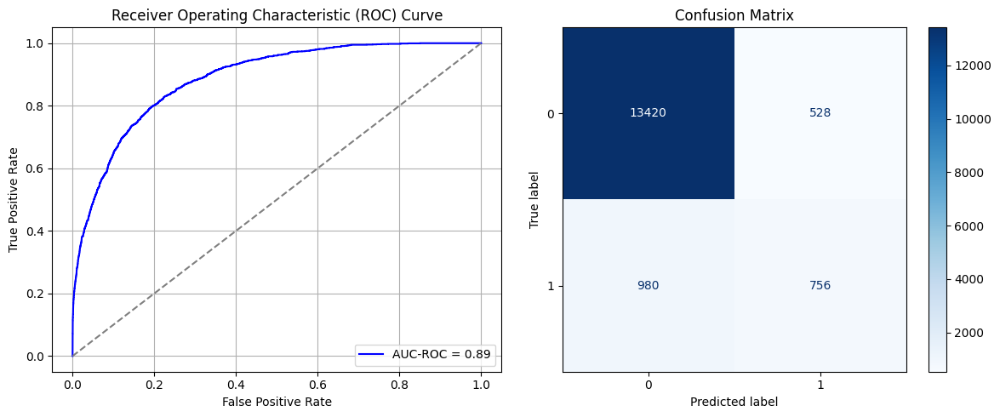

Best threshold based on F1-score: 0.3250318467617035
False Negative Rate: 0.5645161290322581
Time elapsed (performance): 1.579994921999969
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7995 - loss: 0.5589 - val_AUC: 0.8722 - val_loss: 0.4419
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8713 - loss: 0.4431 - val_AUC: 0.8742 - val_loss: 0.4376
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8743 - loss: 0.4386 - val_AUC: 0.8758 - val_loss: 0.4449
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4364 - val_AUC: 0.8767 - val_loss: 0.4374
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8788 - loss: 0.4305 - val_AUC: 0.8771 - val_loss: 0.4321
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8794 - loss: 0.4287 - val_AUC: 0.8782 - val_loss: 0.4319
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 - loss: 0.4261 - val_AUC: 0.8788 - val_loss: 0.4300
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8818 - loss: 0.4255 - val_AUC: 0.8789 - val_loss: 0.4319
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8796 -

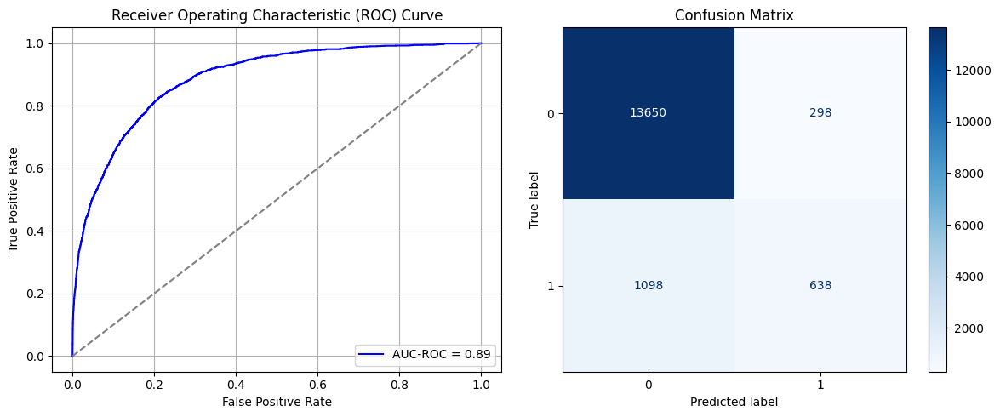

Best threshold based on F1-score: 0.3317197561264038
False Negative Rate: 0.6324884792626728
Time elapsed (performance): 1.424369045000276
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7797 - loss: 0.5658 - val_AUC: 0.8762 - val_loss: 0.4363
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8725 - loss: 0.4393 - val_AUC: 0.8778 - val_loss: 0.4310
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4315 - val_AUC: 0.8791 - val_loss: 0.4305
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 - loss: 0.4305 - val_AUC: 0.8798 - val_loss: 0.4319
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8821 - loss: 0.4237 - val_AUC: 0.8803 - val_loss: 0.4274
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8839 - loss: 0.4207 - val_AUC: 0.8811 - val_loss: 0.4253
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8807 - loss: 0.4263 - val_AUC: 0.8809 - val_loss: 0.4370
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 - loss: 0.4228 - val_AUC: 0.8812 - val_loss: 0.4294
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8798 -

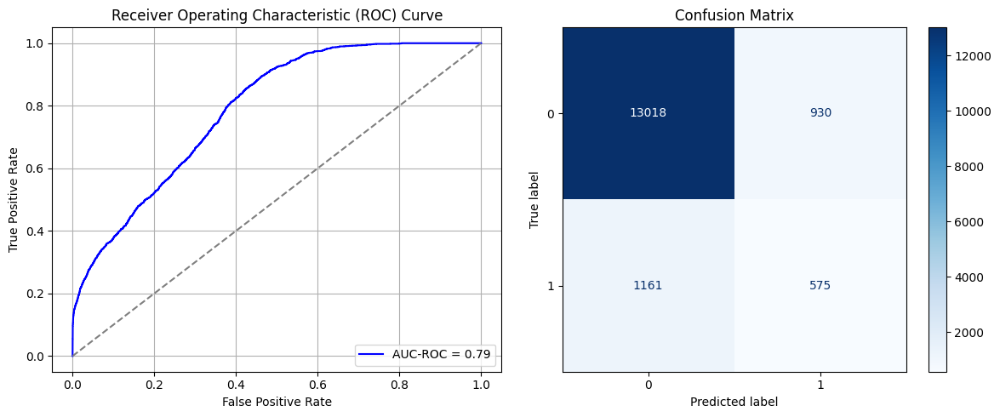

Best threshold based on F1-score: 0.4986804723739624
False Negative Rate: 0.668778801843318
Time elapsed (performance): 1.433340727000541
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7932 - loss: 0.5556 - val_AUC: 0.8722 - val_loss: 0.4432
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8703 - loss: 0.4436 - val_AUC: 0.8764 - val_loss: 0.4343
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8714 - loss: 0.4414 - val_AUC: 0.8773 - val_loss: 0.4634
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8716 - loss: 0.4411 - val_AUC: 0.8783 - val_loss: 0.4315
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4309 - val_AUC: 0.8785 - val_loss: 0.4445
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8765 - loss: 0.4326 - val_AUC: 0.8795 - val_loss: 0.4317
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.4305 - val_AUC: 0.8799 - val_loss: 0.4296
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8824 - loss: 0.4239 - val_AUC: 0.8802 - val_loss: 0.4275
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8830 -

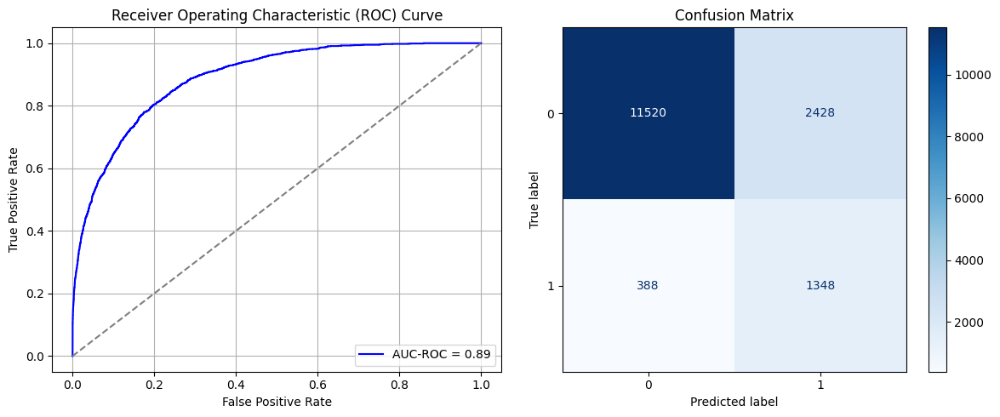

Best threshold based on F1-score: 0.7024797201156616
False Negative Rate: 0.22350230414746544
Time elapsed (performance): 2.0155689969997184
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7810 - loss: 0.5626 - val_AUC: 0.8708 - val_loss: 0.4471
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8710 - loss: 0.4436 - val_AUC: 0.8741 - val_loss: 0.4444
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4332 - val_AUC: 0.8757 - val_loss: 0.4372
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8748 - loss: 0.4365 - val_AUC: 0.8764 - val_loss: 0.4367
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8806 - loss: 0.4260 - val_AUC: 0.8757 - val_loss: 0.4357
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8820 - loss: 0.4242 - val_AUC: 0.8768 - val_loss: 0.4383
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4310 - val_AUC: 0.8777 - val_loss: 0.4326
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8831 - loss: 0.4223 - val_AUC: 0.8780 - val_loss: 0.4357
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8821 -

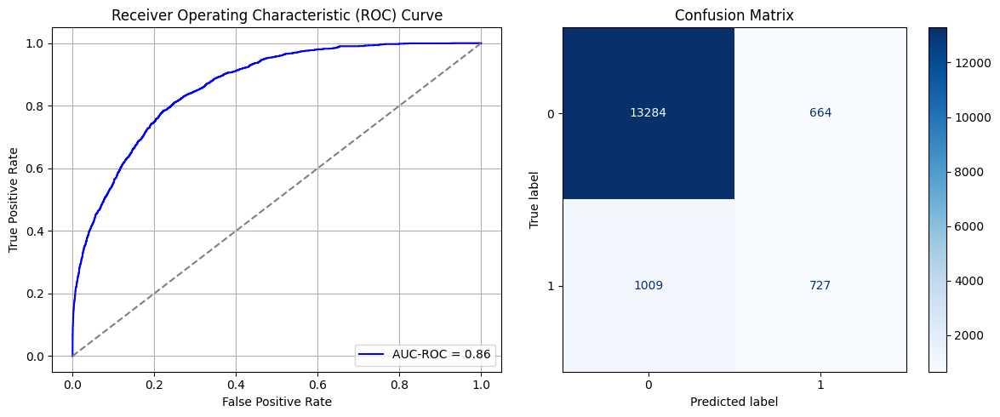

Best threshold based on F1-score: 0.465472549200058
False Negative Rate: 0.581221198156682
Time elapsed (performance): 1.8718931269995664
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7852 - loss: 0.5606 - val_AUC: 0.8709 - val_loss: 0.4483
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4388 - val_AUC: 0.8743 - val_loss: 0.4406
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8794 - loss: 0.4297 - val_AUC: 0.8758 - val_loss: 0.4407
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.4337 - val_AUC: 0.8764 - val_loss: 0.4378
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8811 - loss: 0.4257 - val_AUC: 0.8769 - val_loss: 0.4338
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.4330 - val_AUC: 0.8774 - val_loss: 0.4349
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8828 - loss: 0.4240 - val_AUC: 0.8775 - val_loss: 0.4366
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8804 - loss: 0.4276 - val_AUC: 0.8776 - val_loss: 0.4340
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8809 -

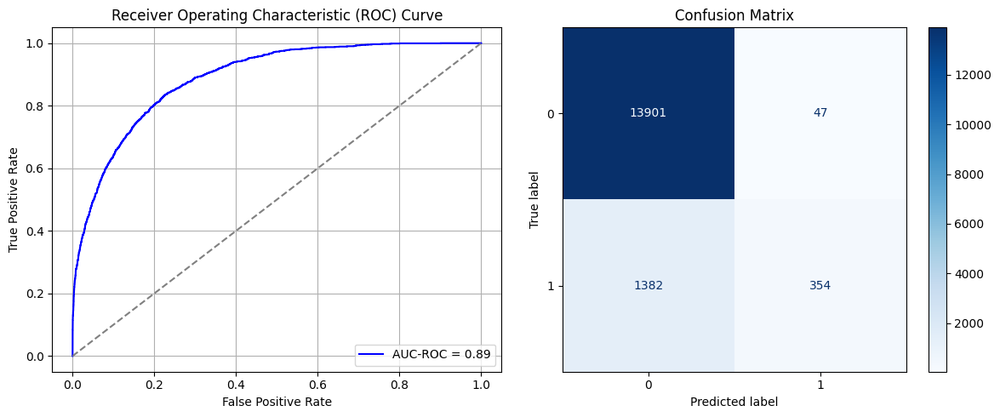

Best threshold based on F1-score: 0.10812020301818848
False Negative Rate: 0.7960829493087558
Time elapsed (performance): 1.6875406639992434
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7787 - loss: 0.5641 - val_AUC: 0.8714 - val_loss: 0.4506
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8720 - loss: 0.4425 - val_AUC: 0.8743 - val_loss: 0.4404
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8733 - loss: 0.4391 - val_AUC: 0.8760 - val_loss: 0.4381
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8739 - loss: 0.4379 - val_AUC: 0.8762 - val_loss: 0.4345
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8794 - loss: 0.4294 - val_AUC: 0.8761 - val_loss: 0.4356
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8814 - loss: 0.4252 - val_AUC: 0.8752 - val_loss: 0.4605
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8828 - loss: 0.4240 - val_AUC: 0.8772 - val_loss: 0.4332
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4294 - val_AUC: 0.8770 - val_loss: 0.4490
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8784 -

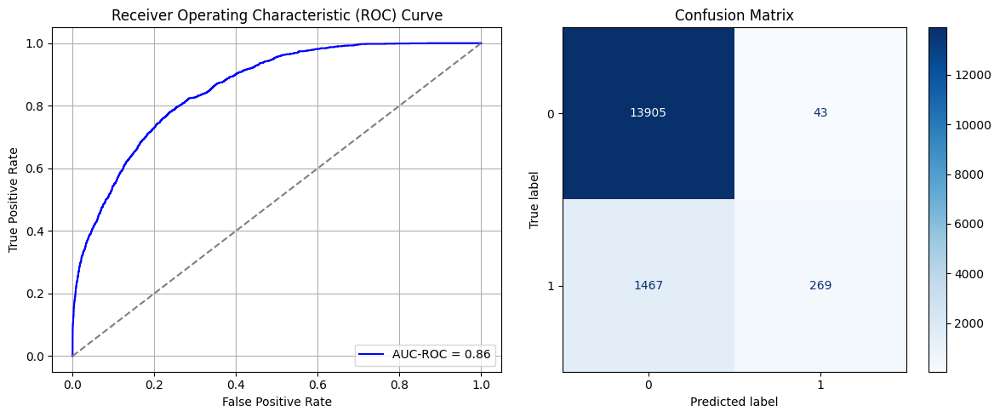

Best threshold based on F1-score: 0.09991830587387085
False Negative Rate: 0.8450460829493087
Time elapsed (performance): 1.4412925050000922
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7651 - loss: 0.5681 - val_AUC: 0.8718 - val_loss: 0.4483
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8722 - loss: 0.4417 - val_AUC: 0.8725 - val_loss: 0.4473
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8728 - loss: 0.4396 - val_AUC: 0.8759 - val_loss: 0.4369
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8761 - loss: 0.4336 - val_AUC: 0.8751 - val_loss: 0.4377
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8761 - loss: 0.4335 - val_AUC: 0.8757 - val_loss: 0.4363
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4304 - val_AUC: 0.8763 - val_loss: 0.4362
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8771 - loss: 0.4321 - val_AUC: 0.8771 - val_loss: 0.4336
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 - loss: 0.4294 - val_AUC: 0.8763 - val_loss: 0.4419
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8802 -

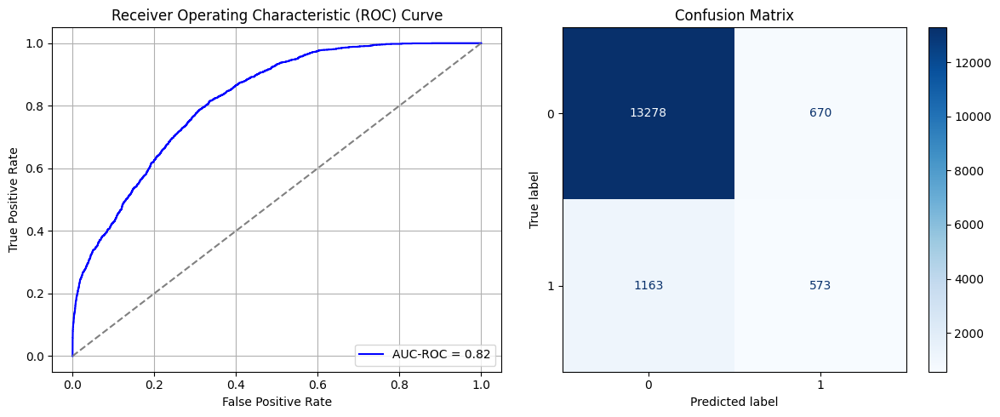

Best threshold based on F1-score: 0.2999885678291321
False Negative Rate: 0.6699308755760369
Time elapsed (performance): 1.685439287999543
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7874 - loss: 0.5593 - val_AUC: 0.8682 - val_loss: 0.4485
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8737 - loss: 0.4385 - val_AUC: 0.8710 - val_loss: 0.4470
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8762 - loss: 0.4331 - val_AUC: 0.8722 - val_loss: 0.4448
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 - loss: 0.4327 - val_AUC: 0.8728 - val_loss: 0.4397
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8770 - loss: 0.4322 - val_AUC: 0.8738 - val_loss: 0.4412
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8805 - loss: 0.4268 - val_AUC: 0.8748 - val_loss: 0.4475
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8803 - loss: 0.4280 - val_AUC: 0.8759 - val_loss: 0.4351
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8807 - loss: 0.4273 - val_AUC: 0.8755 - val_loss: 0.4542
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 -

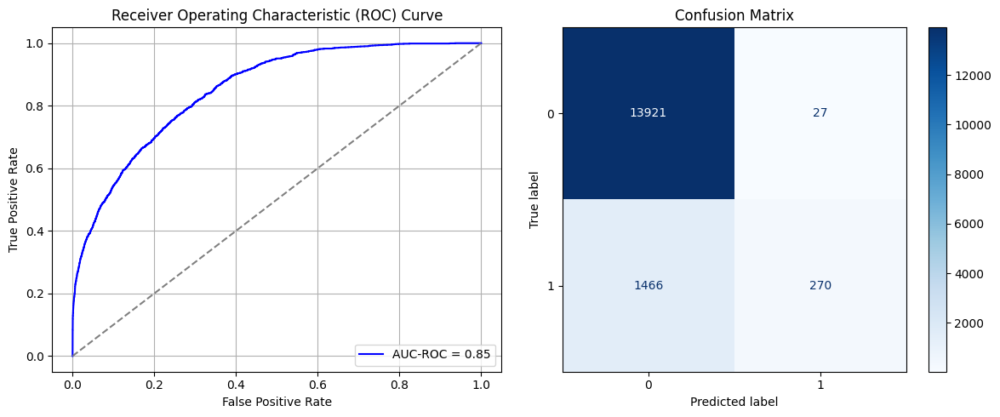

Best threshold based on F1-score: 0.0768757313489914
False Negative Rate: 0.8444700460829493
Time elapsed (performance): 2.0711165409993555
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7714 - loss: 0.5672 - val_AUC: 0.8692 - val_loss: 0.4485
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8704 - loss: 0.4443 - val_AUC: 0.8755 - val_loss: 0.4397
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8735 - loss: 0.4391 - val_AUC: 0.8766 - val_loss: 0.4418
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8773 - loss: 0.4338 - val_AUC: 0.8774 - val_loss: 0.4327
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4328 - val_AUC: 0.8780 - val_loss: 0.4320
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8813 - loss: 0.4255 - val_AUC: 0.8785 - val_loss: 0.4356
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.4300 - val_AUC: 0.8798 - val_loss: 0.4398
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8814 - loss: 0.4257 - val_AUC: 0.8801 - val_loss: 0.4293
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8793 -

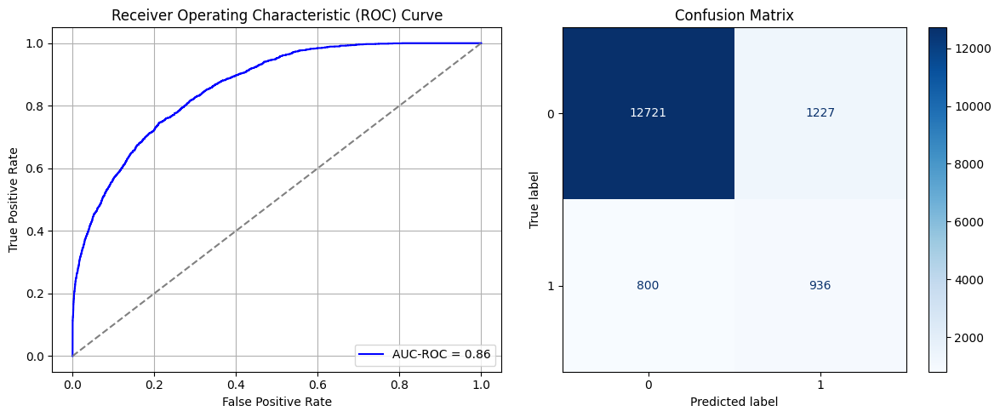

Best threshold based on F1-score: 0.5969758033752441
False Negative Rate: 0.4608294930875576
Time elapsed (performance): 1.4708649269996386


In [101]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [102]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     35.905611  0.272942  0.727058  0.191244  0.808756     1.150005
1     38.175787  0.001362  0.998638  0.869816  0.130184     1.148061
2     33.481807  0.077287  0.922713  0.515553  0.484447     1.705149
3     35.318498  0.013622  0.986378  0.730991  0.269009     1.672674
4     28.161099  0.006381  0.993619  0.844470  0.155530     1.370241
5     36.006584  0.017422  0.982578  0.797811  0.202189     1.467289
6     31.140904  0.138084  0.861916  0.398041  0.601959     1.177309
7     35.517952  0.002653  0.997347  0.836982  0.163018     1.672674
8     42.419335  0.047749  0.952251  0.548963  0.451037     1.815356
9     41.571428  0.014697  0.985303  0.682028  0.317972     1.209155
10    40.735464  0.006668  0.993332  0.815092  0.184908     1.217168
11    41.236304  0.042085  0.957915  0.681452  0.318548     1.677409
12    44.380655  0.009034  0.990966  0.770737  0.229263     1.714821
13    41.380617  0.309148  0.69085

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, taking $k=10$ yields a number of samples of $k*\frac{N_0-N_1}{N_1}= 11.05 \approx 11$, so we take $k=10$.

In [103]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7840 - loss: 0.5649 - val_AUC: 0.8685 - val_loss: 0.4473
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8729 - loss: 0.4402 - val_AUC: 0.8714 - val_loss: 0.4436
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8763 - loss: 0.4344 - val_AUC: 0.8725 - val_loss: 0.4445
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8792 - loss: 0.4290 - val_AUC: 0.8732 - val_loss: 0.4388
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8784 - loss: 0.4298 - val_AUC: 0.8743 - val_loss: 0.4398
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8785 - loss: 0.4297 - val_AUC: 0.8745 - val_loss: 0.4447
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8812 - loss: 0.4257 - val_AUC: 0.8752 - val_loss: 0.4348
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8788 - loss: 0.4290 - val_AUC: 0.8759 - val_loss: 0.4434
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8801 -

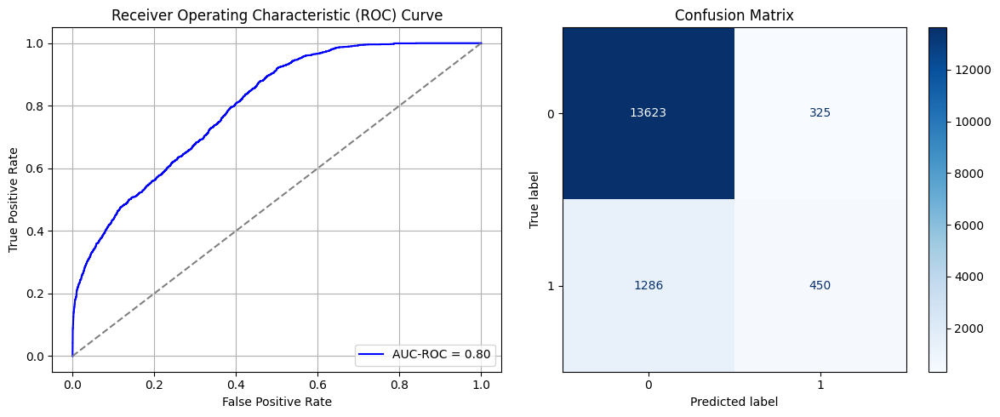

Best threshold based on F1-score: 0.2470199316740036
False Negative Rate: 0.7407834101382489
Time elapsed (performance): 1.6719116120002582
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7834 - loss: 0.5668 - val_AUC: 0.8690 - val_loss: 0.4478
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8702 - loss: 0.4439 - val_AUC: 0.8711 - val_loss: 0.4467
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8740 - loss: 0.4388 - val_AUC: 0.8716 - val_loss: 0.4433
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4363 - val_AUC: 0.8733 - val_loss: 0.4404
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8771 - loss: 0.4335 - val_AUC: 0.8747 - val_loss: 0.4383
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8804 - loss: 0.4270 - val_AUC: 0.8735 - val_loss: 0.4520
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8777 - loss: 0.4316 - val_AUC: 0.8742 - val_loss: 0.4391
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8829 - loss: 0.4243 - val_AUC: 0.8746 - val_loss: 0.4397
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8777 -

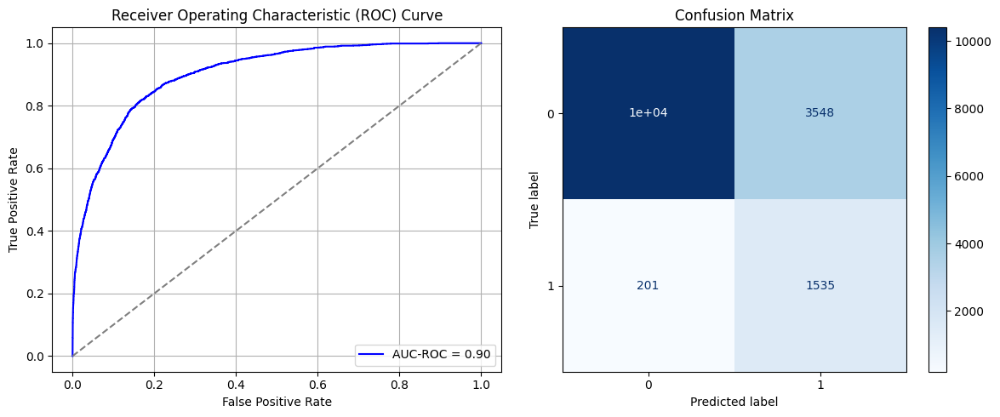

Best threshold based on F1-score: 0.7605873346328735
False Negative Rate: 0.11578341013824885
Time elapsed (performance): 1.1617861860013363
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.7858 - loss: 0.5600 - val_AUC: 0.8703 - val_loss: 0.4451
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4380 - val_AUC: 0.8730 - val_loss: 0.4389
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8820 - loss: 0.4257 - val_AUC: 0.8757 - val_loss: 0.4354
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8786 - loss: 0.4303 - val_AUC: 0.8751 - val_loss: 0.4390
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8784 - loss: 0.4305 - val_AUC: 0.8761 - val_loss: 0.4367
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8762 - loss: 0.4345 - val_AUC: 0.8751 - val_loss: 0.4400
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8762 - loss: 0.4353 - val_AUC: 0.8769 - val_loss: 0.4325
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8800 - loss: 0.4277 - val_AUC: 0.8773 - val_loss: 0.4311
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8816 

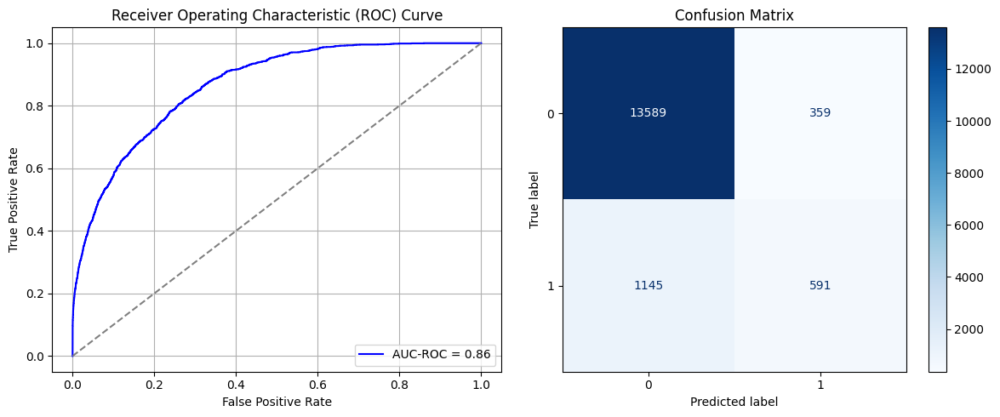

Best threshold based on F1-score: 0.33442434668540955
False Negative Rate: 0.6595622119815668
Time elapsed (performance): 1.2372853659999237
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7749 - loss: 0.5685 - val_AUC: 0.8721 - val_loss: 0.4568
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8708 - loss: 0.4437 - val_AUC: 0.8747 - val_loss: 0.4435
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8733 - loss: 0.4403 - val_AUC: 0.8759 - val_loss: 0.4476
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8749 - loss: 0.4374 - val_AUC: 0.8773 - val_loss: 0.4339
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8777 - loss: 0.4305 - val_AUC: 0.8771 - val_loss: 0.4370
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4312 - val_AUC: 0.8779 - val_loss: 0.4326
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8820 - loss: 0.4244 - val_AUC: 0.8782 - val_loss: 0.4330
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8800 - loss: 0.4264 - val_AUC: 0.8784 - val_loss: 0.4329
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8827 -

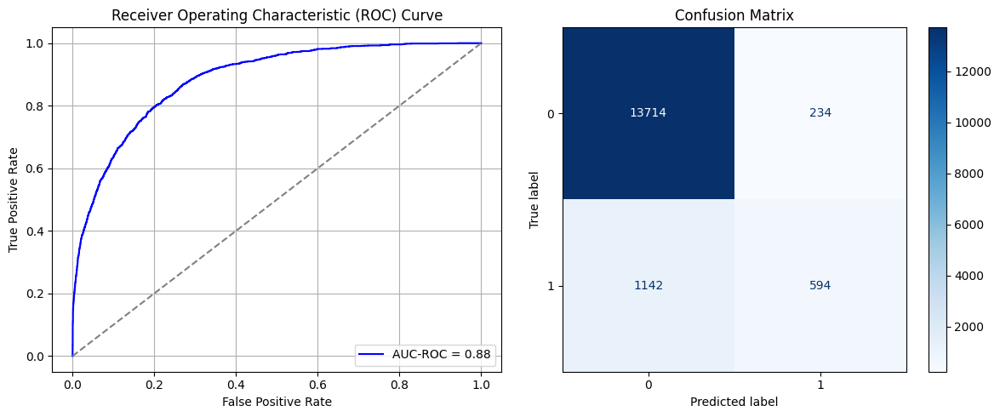

Best threshold based on F1-score: 0.29565516114234924
False Negative Rate: 0.6578341013824884
Time elapsed (performance): 1.2286376259999088
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7937 - loss: 0.5535 - val_AUC: 0.8740 - val_loss: 0.4395
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4379 - val_AUC: 0.8761 - val_loss: 0.4431
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8774 - loss: 0.4332 - val_AUC: 0.8774 - val_loss: 0.4336
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8778 - loss: 0.4316 - val_AUC: 0.8784 - val_loss: 0.4315
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8833 - loss: 0.4223 - val_AUC: 0.8794 - val_loss: 0.4310
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8796 - loss: 0.4285 - val_AUC: 0.8794 - val_loss: 0.4311
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8828 - loss: 0.4234 - val_AUC: 0.8795 - val_loss: 0.4302
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8828 - loss: 0.4236 - val_AUC: 0.8802 - val_loss: 0.4288
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8820 -

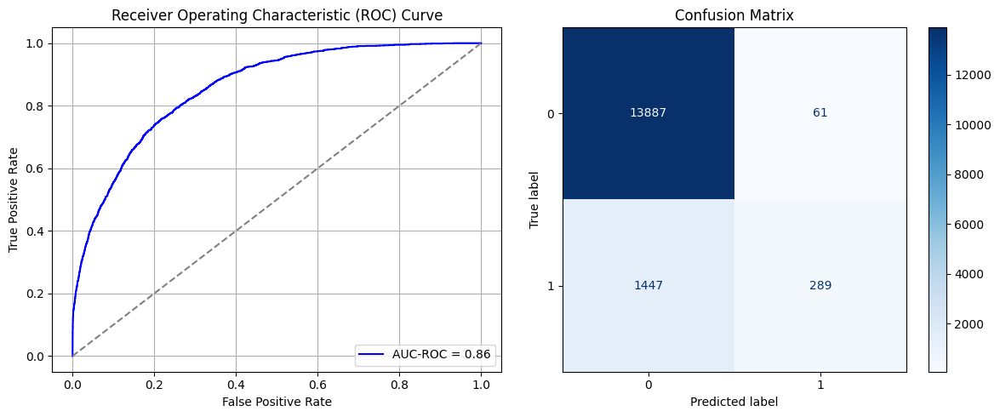

Best threshold based on F1-score: 0.12453584372997284
False Negative Rate: 0.8335253456221198
Time elapsed (performance): 1.2475402599993686
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7736 - loss: 0.5653 - val_AUC: 0.8721 - val_loss: 0.4447
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8703 - loss: 0.4441 - val_AUC: 0.8747 - val_loss: 0.4386
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8756 - loss: 0.4352 - val_AUC: 0.8757 - val_loss: 0.4366
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4324 - val_AUC: 0.8758 - val_loss: 0.4417
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8796 - loss: 0.4293 - val_AUC: 0.8745 - val_loss: 0.4371
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8768 - loss: 0.4328 - val_AUC: 0.8759 - val_loss: 0.4369
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8806 - loss: 0.4274 - val_AUC: 0.8771 - val_loss: 0.4336
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8782 - loss: 0.4295 - val_AUC: 0.8778 - val_loss: 0.4327
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8818 -

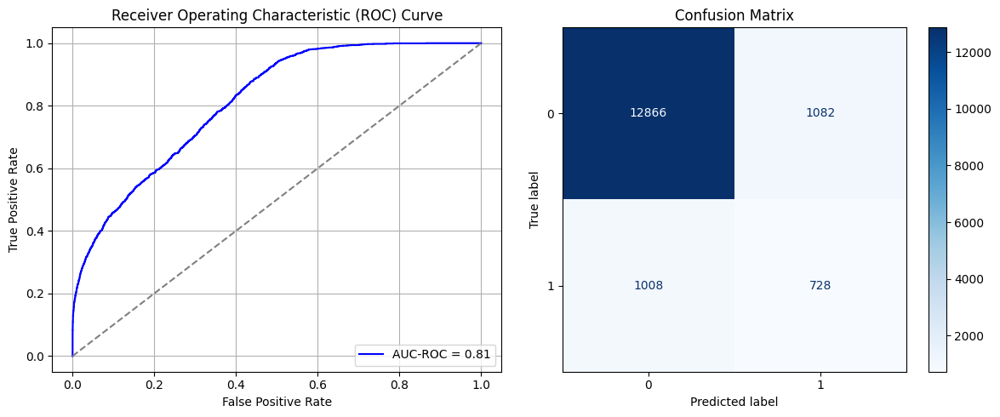

Best threshold based on F1-score: 0.4747737944126129
False Negative Rate: 0.5806451612903226
Time elapsed (performance): 1.245740267999281
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7778 - loss: 0.5656 - val_AUC: 0.8701 - val_loss: 0.4483
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8690 - loss: 0.4473 - val_AUC: 0.8726 - val_loss: 0.4448
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8762 - loss: 0.4339 - val_AUC: 0.8745 - val_loss: 0.4396
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8797 - loss: 0.4298 - val_AUC: 0.8747 - val_loss: 0.4386
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 - loss: 0.4303 - val_AUC: 0.8758 - val_loss: 0.4357
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8843 - loss: 0.4219 - val_AUC: 0.8758 - val_loss: 0.4364
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8793 - loss: 0.4300 - val_AUC: 0.8768 - val_loss: 0.4438
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8799 - loss: 0.4276 - val_AUC: 0.8762 - val_loss: 0.4351
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8822 -

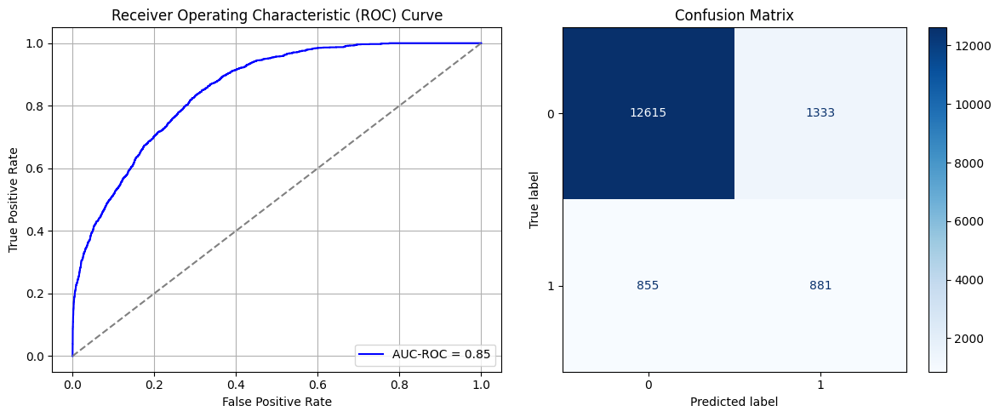

Best threshold based on F1-score: 0.5826834440231323
False Negative Rate: 0.4925115207373272
Time elapsed (performance): 1.680118117999882
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7731 - loss: 0.5680 - val_AUC: 0.8685 - val_loss: 0.4545
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8742 - loss: 0.4386 - val_AUC: 0.8726 - val_loss: 0.4463
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.4368 - val_AUC: 0.8738 - val_loss: 0.4426
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8765 - loss: 0.4344 - val_AUC: 0.8742 - val_loss: 0.4432
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8765 - loss: 0.4347 - val_AUC: 0.8752 - val_loss: 0.4418
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8802 - loss: 0.4276 - val_AUC: 0.8754 - val_loss: 0.4385
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8790 - loss: 0.4309 - val_AUC: 0.8750 - val_loss: 0.4365
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8781 - loss: 0.4311 - val_AUC: 0.8767 - val_loss: 0.4347
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 -

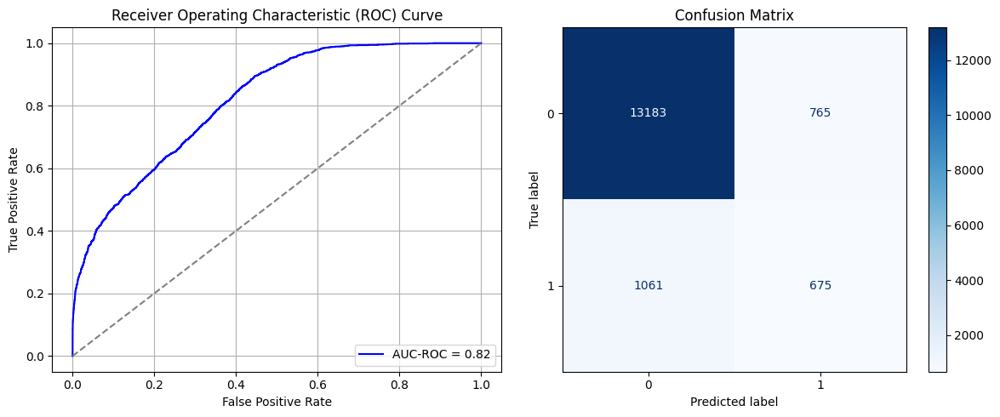

Best threshold based on F1-score: 0.4843987822532654
False Negative Rate: 0.6111751152073732
Time elapsed (performance): 1.250068901999839
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7723 - loss: 0.5697 - val_AUC: 0.8742 - val_loss: 0.4406
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8755 - loss: 0.4374 - val_AUC: 0.8774 - val_loss: 0.4338
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8770 - loss: 0.4340 - val_AUC: 0.8780 - val_loss: 0.4506
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8761 - loss: 0.4354 - val_AUC: 0.8785 - val_loss: 0.4325
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8800 - loss: 0.4270 - val_AUC: 0.8795 - val_loss: 0.4292
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8823 - loss: 0.4238 - val_AUC: 0.8799 - val_loss: 0.4287
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8795 - loss: 0.4292 - val_AUC: 0.8805 - val_loss: 0.4287
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8793 - loss: 0.4288 - val_AUC: 0.8787 - val_loss: 0.4454
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8821 -

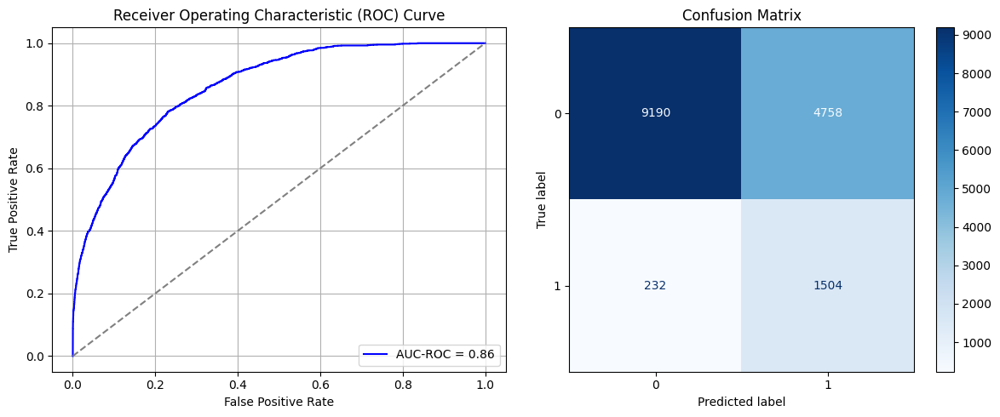

Best threshold based on F1-score: 0.8201289772987366
False Negative Rate: 0.1336405529953917
Time elapsed (performance): 1.72016735500074
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7877 - loss: 0.5643 - val_AUC: 0.8711 - val_loss: 0.4422
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8756 - loss: 0.4362 - val_AUC: 0.8729 - val_loss: 0.4574
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8755 - loss: 0.4352 - val_AUC: 0.8758 - val_loss: 0.4362
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8780 - loss: 0.4300 - val_AUC: 0.8765 - val_loss: 0.4313
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4284 - val_AUC: 0.8772 - val_loss: 0.4317
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8807 - loss: 0.4257 - val_AUC: 0.8778 - val_loss: 0.4314
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8837 - loss: 0.4221 - val_AUC: 0.8778 - val_loss: 0.4331
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8831 - loss: 0.4240 - val_AUC: 0.8769 - val_loss: 0.4310
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8833 -

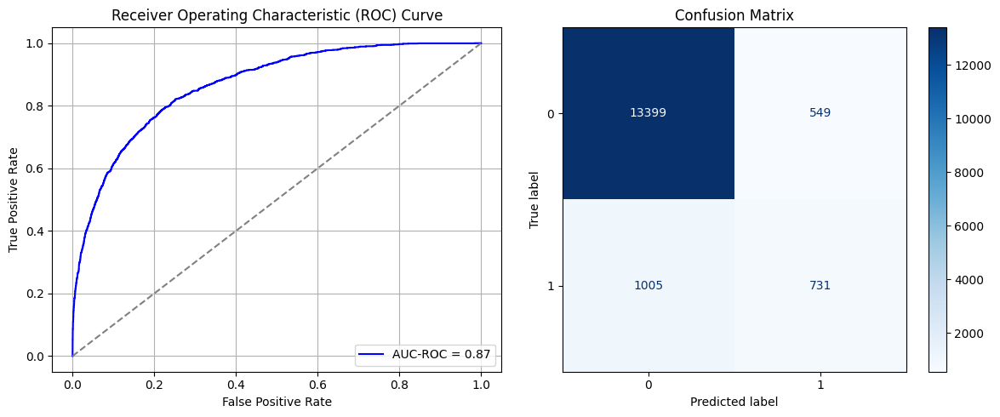

Best threshold based on F1-score: 0.3714791536331177
False Negative Rate: 0.5789170506912442
Time elapsed (performance): 1.590261114999521
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7977 - loss: 0.5593 - val_AUC: 0.8706 - val_loss: 0.4473
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8714 - loss: 0.4420 - val_AUC: 0.8737 - val_loss: 0.4367
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.4354 - val_AUC: 0.8750 - val_loss: 0.4446
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8810 - loss: 0.4279 - val_AUC: 0.8761 - val_loss: 0.4334
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8794 - loss: 0.4281 - val_AUC: 0.8762 - val_loss: 0.4337
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8819 - loss: 0.4249 - val_AUC: 0.8766 - val_loss: 0.4330
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8797 - loss: 0.4288 - val_AUC: 0.8770 - val_loss: 0.4333
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8802 - loss: 0.4274 - val_AUC: 0.8782 - val_loss: 0.4293
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8814 -

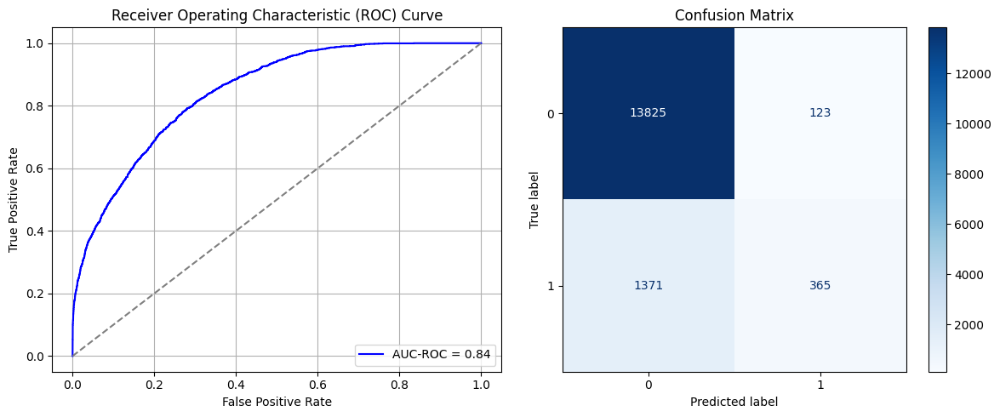

Best threshold based on F1-score: 0.15268422663211823
False Negative Rate: 0.7897465437788018
Time elapsed (performance): 1.2488362269996287
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7550 - loss: 0.5771 - val_AUC: 0.8698 - val_loss: 0.4487
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8752 - loss: 0.4379 - val_AUC: 0.8709 - val_loss: 0.4453
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8725 - loss: 0.4412 - val_AUC: 0.8714 - val_loss: 0.4444
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8736 - loss: 0.4398 - val_AUC: 0.8719 - val_loss: 0.4532
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8744 - loss: 0.4362 - val_AUC: 0.8738 - val_loss: 0.4410
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8785 - loss: 0.4301 - val_AUC: 0.8745 - val_loss: 0.4388
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8786 - loss: 0.4303 - val_AUC: 0.8742 - val_loss: 0.4469
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 - loss: 0.4295 - val_AUC: 0.8756 - val_loss: 0.4398
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8820 -

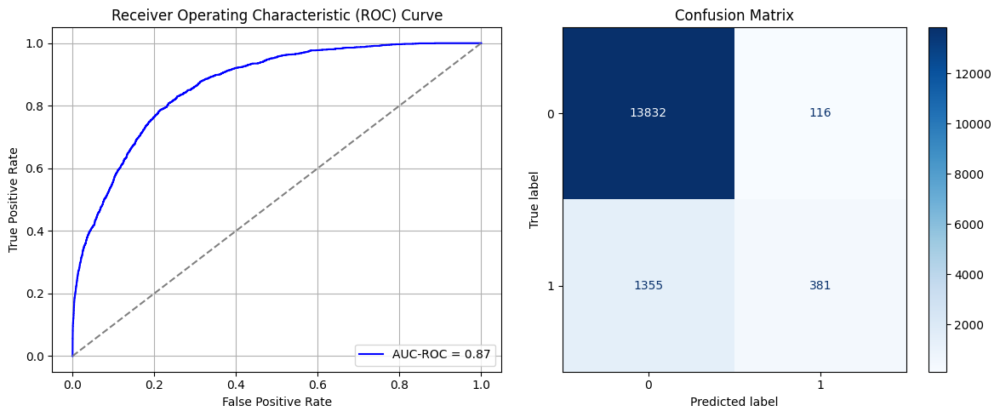

Best threshold based on F1-score: 0.12005077302455902
False Negative Rate: 0.7805299539170507
Time elapsed (performance): 1.7030332220001583
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7874 - loss: 0.5594 - val_AUC: 0.8698 - val_loss: 0.4491
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8745 - loss: 0.4384 - val_AUC: 0.8731 - val_loss: 0.4439
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8753 - loss: 0.4364 - val_AUC: 0.8738 - val_loss: 0.4399
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4337 - val_AUC: 0.8751 - val_loss: 0.4391
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8747 - loss: 0.4359 - val_AUC: 0.8753 - val_loss: 0.4382
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 - loss: 0.4299 - val_AUC: 0.8756 - val_loss: 0.4402
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4283 - val_AUC: 0.8753 - val_loss: 0.4387
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8779 - loss: 0.4321 - val_AUC: 0.8753 - val_loss: 0.4397
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8765 -

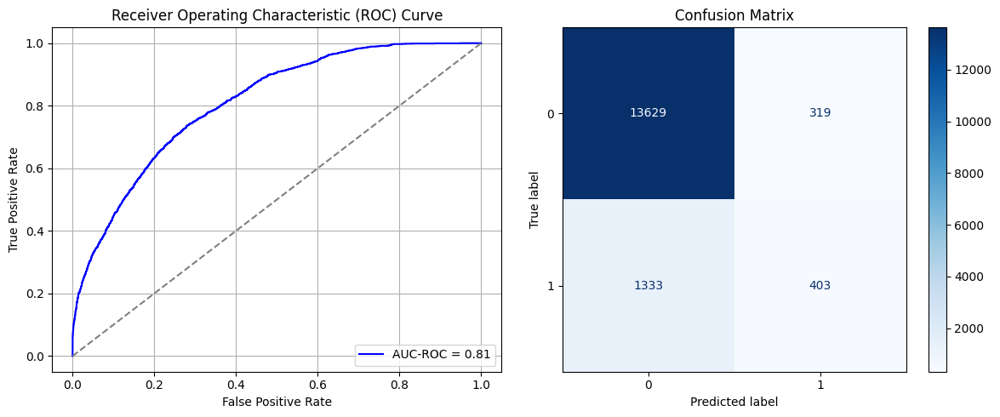

Best threshold based on F1-score: 0.21543240547180176
False Negative Rate: 0.7678571428571429
Time elapsed (performance): 1.677116675000434
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7868 - loss: 0.5585 - val_AUC: 0.8735 - val_loss: 0.4430
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8722 - loss: 0.4399 - val_AUC: 0.8754 - val_loss: 0.4396
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8770 - loss: 0.4328 - val_AUC: 0.8766 - val_loss: 0.4398
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8790 - loss: 0.4292 - val_AUC: 0.8776 - val_loss: 0.4317
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8795 - loss: 0.4296 - val_AUC: 0.8783 - val_loss: 0.4336
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8795 - loss: 0.4293 - val_AUC: 0.8784 - val_loss: 0.4305
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8855 - loss: 0.4195 - val_AUC: 0.8789 - val_loss: 0.4296
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8839 - loss: 0.4217 - val_AUC: 0.8787 - val_loss: 0.4311
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8836 -

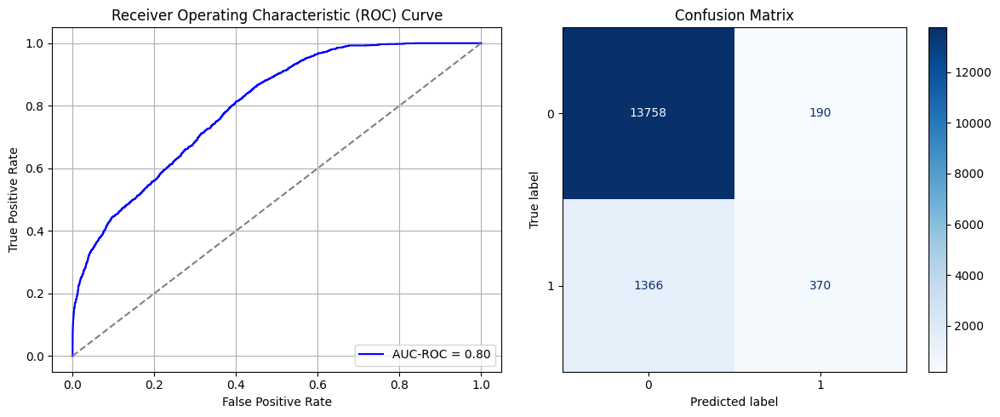

Best threshold based on F1-score: 0.16857177019119263
False Negative Rate: 0.7868663594470046
Time elapsed (performance): 1.7440213120007684
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7826 - loss: 0.5633 - val_AUC: 0.8708 - val_loss: 0.4442
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8663 - loss: 0.4499 - val_AUC: 0.8724 - val_loss: 0.4445
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8757 - loss: 0.4352 - val_AUC: 0.8749 - val_loss: 0.4413
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8746 - loss: 0.4374 - val_AUC: 0.8772 - val_loss: 0.4337
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.4378 - val_AUC: 0.8760 - val_loss: 0.4445
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8775 - loss: 0.4317 - val_AUC: 0.8774 - val_loss: 0.4341
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8745 - loss: 0.4358 - val_AUC: 0.8769 - val_loss: 0.4340
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8789 - loss: 0.4297 - val_AUC: 0.8782 - val_loss: 0.4366
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8735 -

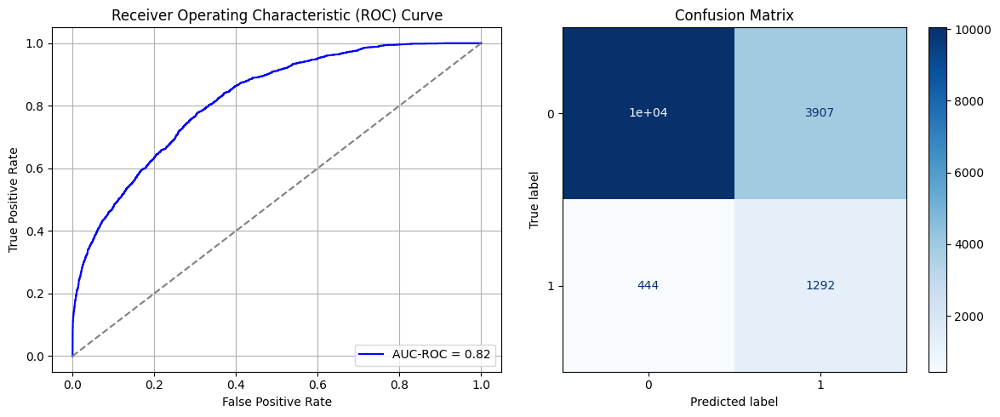

Best threshold based on F1-score: 0.735133945941925
False Negative Rate: 0.2557603686635945
Time elapsed (performance): 1.714472534999004
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7679 - loss: 0.5761 - val_AUC: 0.8685 - val_loss: 0.4474
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8740 - loss: 0.4393 - val_AUC: 0.8724 - val_loss: 0.4423
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8741 - loss: 0.4383 - val_AUC: 0.8747 - val_loss: 0.4383
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8765 - loss: 0.4355 - val_AUC: 0.8745 - val_loss: 0.4411
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8808 - loss: 0.4262 - val_AUC: 0.8765 - val_loss: 0.4406
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8797 - loss: 0.4280 - val_AUC: 0.8768 - val_loss: 0.4476
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8837 - loss: 0.4216 - val_AUC: 0.8774 - val_loss: 0.4381
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8827 - loss: 0.4230 - val_AUC: 0.8768 - val_loss: 0.4448
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8813 -

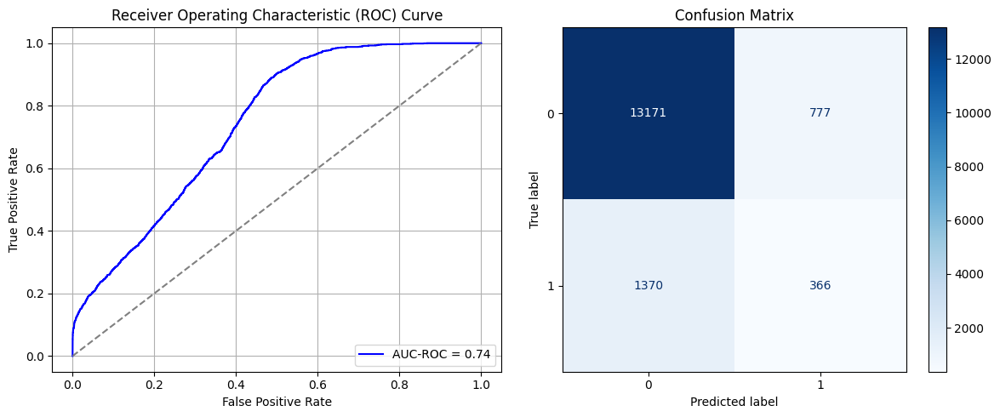

Best threshold based on F1-score: 0.010637839324772358
False Negative Rate: 0.7891705069124424
Time elapsed (performance): 1.7090039389986487
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7884 - loss: 0.5627 - val_AUC: 0.8713 - val_loss: 0.4498
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8694 - loss: 0.4457 - val_AUC: 0.8741 - val_loss: 0.4393
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8763 - loss: 0.4354 - val_AUC: 0.8750 - val_loss: 0.4445
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8742 - loss: 0.4369 - val_AUC: 0.8756 - val_loss: 0.4372
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.4344 - val_AUC: 0.8764 - val_loss: 0.4351
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8851 - loss: 0.4202 - val_AUC: 0.8772 - val_loss: 0.4323
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8791 - loss: 0.4294 - val_AUC: 0.8776 - val_loss: 0.4330
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8788 - loss: 0.4300 - val_AUC: 0.8776 - val_loss: 0.4356
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8772 -

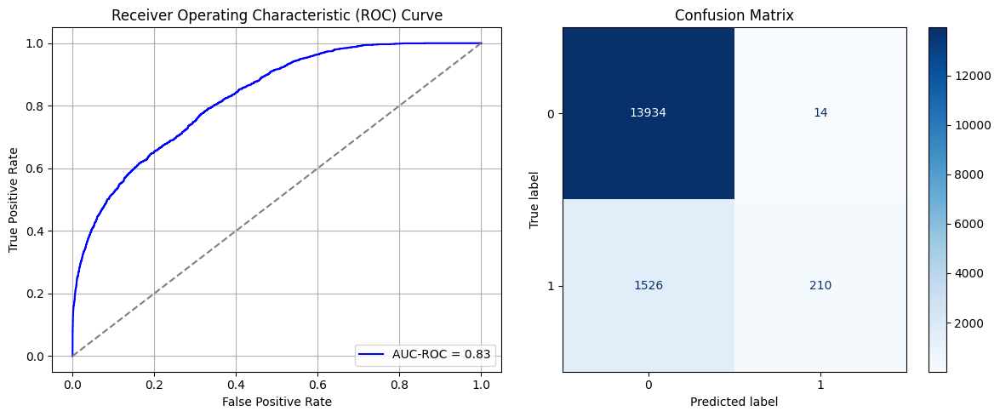

Best threshold based on F1-score: 0.07278663665056229
False Negative Rate: 0.8790322580645161
Time elapsed (performance): 1.2736767620008322
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7708 - loss: 0.5701 - val_AUC: 0.8705 - val_loss: 0.4449
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8732 - loss: 0.4396 - val_AUC: 0.8720 - val_loss: 0.4472
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8774 - loss: 0.4323 - val_AUC: 0.8733 - val_loss: 0.4625
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4288 - val_AUC: 0.8749 - val_loss: 0.4433
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8733 - loss: 0.4390 - val_AUC: 0.8761 - val_loss: 0.4359
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8798 - loss: 0.4274 - val_AUC: 0.8770 - val_loss: 0.4384
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8801 - loss: 0.4290 - val_AUC: 0.8767 - val_loss: 0.4356
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8817 - loss: 0.4254 - val_AUC: 0.8775 - val_loss: 0.4355
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8835 -

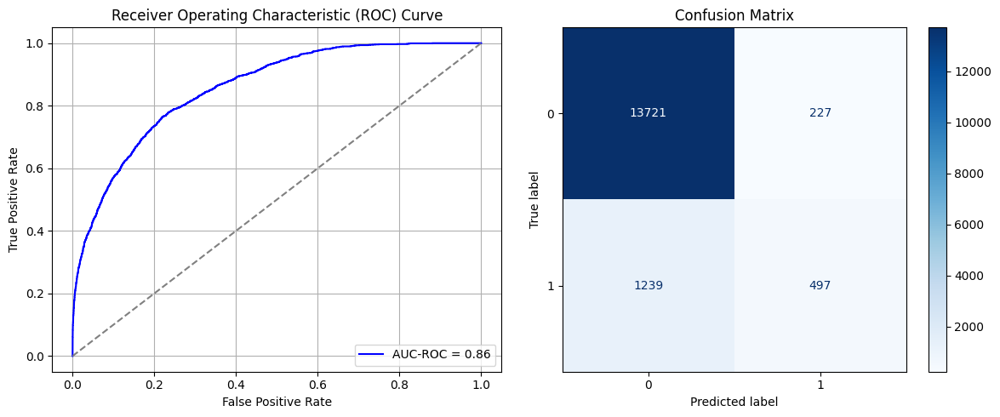

Best threshold based on F1-score: 0.1987057328224182
False Negative Rate: 0.7137096774193549
Time elapsed (performance): 1.8440858789999766
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7914 - loss: 0.5578 - val_AUC: 0.8704 - val_loss: 0.4473
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8713 - loss: 0.4432 - val_AUC: 0.8727 - val_loss: 0.4422
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8730 - loss: 0.4407 - val_AUC: 0.8737 - val_loss: 0.4434
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4326 - val_AUC: 0.8732 - val_loss: 0.4426
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8765 - loss: 0.4343 - val_AUC: 0.8739 - val_loss: 0.4397
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8787 - loss: 0.4305 - val_AUC: 0.8755 - val_loss: 0.4372
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8774 - loss: 0.4322 - val_AUC: 0.8763 - val_loss: 0.4369
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8781 - loss: 0.4305 - val_AUC: 0.8764 - val_loss: 0.4374
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8757 -

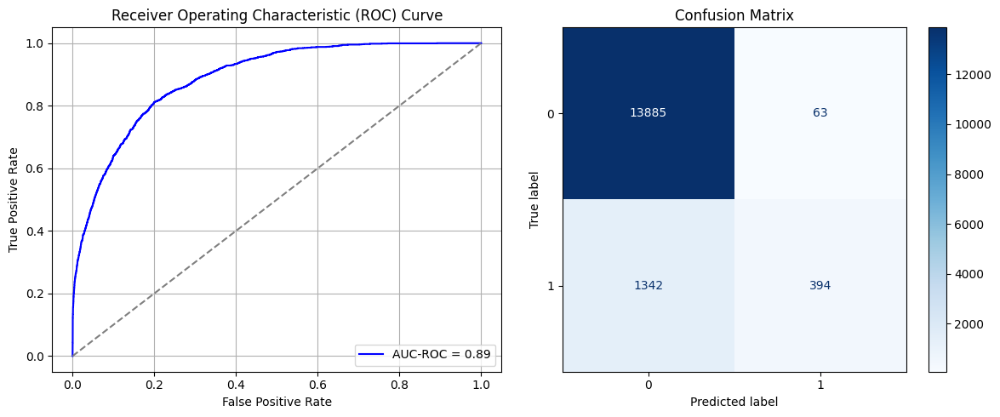

Best threshold based on F1-score: 0.14459547400474548
False Negative Rate: 0.7730414746543779
Time elapsed (performance): 1.6966539379991445
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7723 - loss: 0.5694 - val_AUC: 0.8722 - val_loss: 0.4423
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8760 - loss: 0.4372 - val_AUC: 0.8756 - val_loss: 0.4359
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8770 - loss: 0.4331 - val_AUC: 0.8761 - val_loss: 0.4374
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8785 - loss: 0.4309 - val_AUC: 0.8770 - val_loss: 0.4332
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8767 - loss: 0.4334 - val_AUC: 0.8773 - val_loss: 0.4323
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8777 - loss: 0.4309 - val_AUC: 0.8774 - val_loss: 0.4392
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8796 - loss: 0.4290 - val_AUC: 0.8772 - val_loss: 0.4446
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8800 - loss: 0.4283 - val_AUC: 0.8789 - val_loss: 0.4290
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8798 -

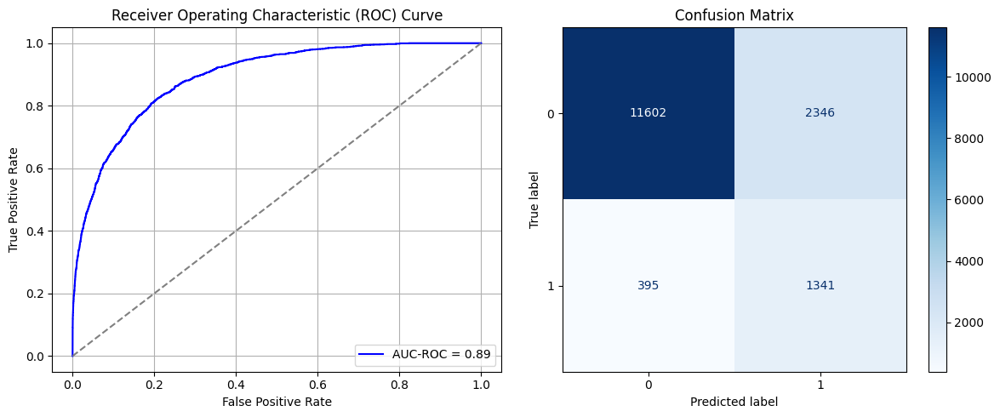

Best threshold based on F1-score: 0.6581121683120728
False Negative Rate: 0.22753456221198157
Time elapsed (performance): 1.3722849789992324
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7652 - loss: 0.5726 - val_AUC: 0.8686 - val_loss: 0.4469
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4375 - val_AUC: 0.8719 - val_loss: 0.4447
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8720 - loss: 0.4407 - val_AUC: 0.8736 - val_loss: 0.4403
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8776 - loss: 0.4319 - val_AUC: 0.8747 - val_loss: 0.4366
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8792 - loss: 0.4293 - val_AUC: 0.8758 - val_loss: 0.4345
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8783 - loss: 0.4300 - val_AUC: 0.8759 - val_loss: 0.4349
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 - loss: 0.4264 - val_AUC: 0.8769 - val_loss: 0.4348
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8820 - loss: 0.4262 - val_AUC: 0.8771 - val_loss: 0.4323
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8788 -

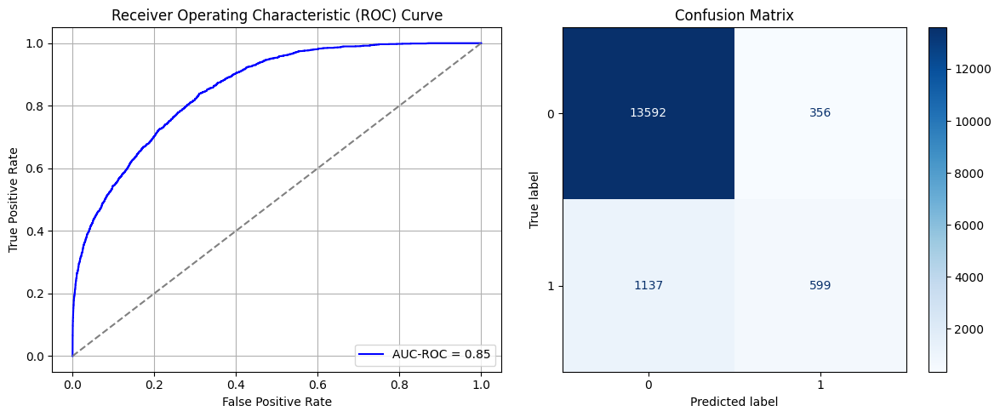

Best threshold based on F1-score: 0.40260252356529236
False Negative Rate: 0.6549539170506913
Time elapsed (performance): 1.6987214850014425
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7789 - loss: 0.5658 - val_AUC: 0.8682 - val_loss: 0.4487
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8759 - loss: 0.4371 - val_AUC: 0.8710 - val_loss: 0.4514
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8750 - loss: 0.4369 - val_AUC: 0.8730 - val_loss: 0.4424
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8793 - loss: 0.4298 - val_AUC: 0.8731 - val_loss: 0.4569
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8815 - loss: 0.4259 - val_AUC: 0.8735 - val_loss: 0.4405
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8814 - loss: 0.4256 - val_AUC: 0.8738 - val_loss: 0.4394
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8803 - loss: 0.4275 - val_AUC: 0.8745 - val_loss: 0.4407
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4284 - val_AUC: 0.8748 - val_loss: 0.4377
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8834 -

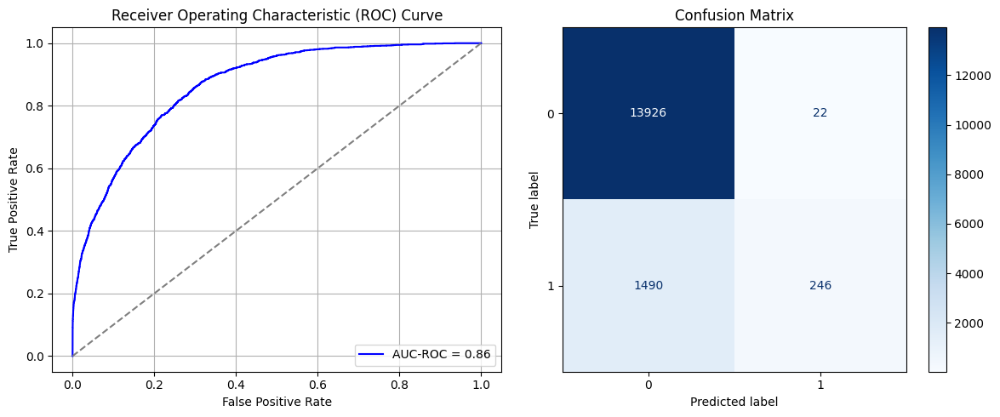

Best threshold based on F1-score: 0.09615572541952133
False Negative Rate: 0.8582949308755761
Time elapsed (performance): 1.7189536040004896
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7842 - loss: 0.5661 - val_AUC: 0.8682 - val_loss: 0.4538
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8730 - loss: 0.4405 - val_AUC: 0.8705 - val_loss: 0.4460
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8750 - loss: 0.4347 - val_AUC: 0.8729 - val_loss: 0.4411
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8773 - loss: 0.4320 - val_AUC: 0.8734 - val_loss: 0.4403
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 - loss: 0.4301 - val_AUC: 0.8743 - val_loss: 0.4431
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.4316 - val_AUC: 0.8735 - val_loss: 0.4432
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8793 - loss: 0.4277 - val_AUC: 0.8749 - val_loss: 0.4373
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8811 - loss: 0.4261 - val_AUC: 0.8738 - val_loss: 0.4430
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8826 -

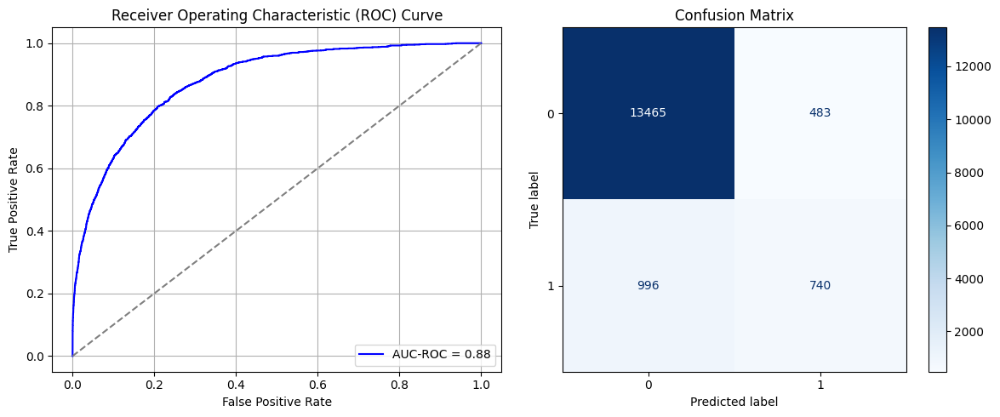

Best threshold based on F1-score: 0.35358113050460815
False Negative Rate: 0.5737327188940092
Time elapsed (performance): 1.7171039630011364
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7935 - loss: 0.5590 - val_AUC: 0.8703 - val_loss: 0.4526
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8719 - loss: 0.4419 - val_AUC: 0.8733 - val_loss: 0.4602
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8795 - loss: 0.4314 - val_AUC: 0.8740 - val_loss: 0.4385
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8774 - loss: 0.4327 - val_AUC: 0.8750 - val_loss: 0.4409
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8752 - loss: 0.4363 - val_AUC: 0.8761 - val_loss: 0.4369
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8807 - loss: 0.4271 - val_AUC: 0.8768 - val_loss: 0.4413
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8809 - loss: 0.4272 - val_AUC: 0.8777 - val_loss: 0.4355
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8823 - loss: 0.4236 - val_AUC: 0.8780 - val_loss: 0.4330
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8835 -

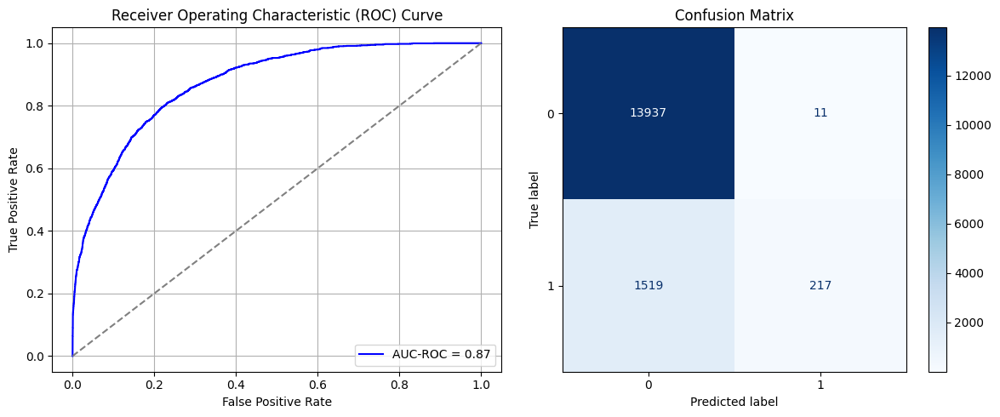

Best threshold based on F1-score: 0.049389056861400604
False Negative Rate: 0.875
Time elapsed (performance): 1.299506064000525
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7664 - loss: 0.5730 - val_AUC: 0.8723 - val_loss: 0.4688
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8734 - loss: 0.4404 - val_AUC: 0.8762 - val_loss: 0.4412
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8761 - loss: 0.4357 - val_AUC: 0.8774 - val_loss: 0.4321
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.4341 - val_AUC: 0.8772 - val_loss: 0.4334
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 - loss: 0.4315 - val_AUC: 0.8798 - val_loss: 0.4284
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4286 - val_AUC: 0.8790 - val_loss: 0.4313
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8812 - loss: 0.4263 - val_AUC: 0.8800 - val_loss: 0.4334
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8815 - loss: 0.4263 - val_AUC: 0.8791 - val_loss: 0.4452
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8861 -

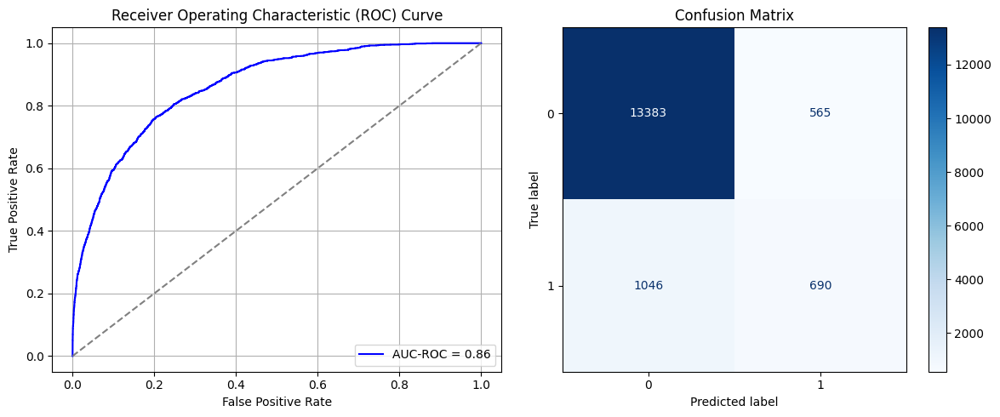

Best threshold based on F1-score: 0.33916643261909485
False Negative Rate: 0.6025345622119815
Time elapsed (performance): 1.6788427880001109
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8002 - loss: 0.5519 - val_AUC: 0.8701 - val_loss: 0.4470
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8716 - loss: 0.4412 - val_AUC: 0.8729 - val_loss: 0.4411
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4362 - val_AUC: 0.8742 - val_loss: 0.4395
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8747 - loss: 0.4348 - val_AUC: 0.8749 - val_loss: 0.4382
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8745 - loss: 0.4374 - val_AUC: 0.8761 - val_loss: 0.4361
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8774 - loss: 0.4313 - val_AUC: 0.8765 - val_loss: 0.4380
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8814 - loss: 0.4251 - val_AUC: 0.8769 - val_loss: 0.4341
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 - loss: 0.4285 - val_AUC: 0.8774 - val_loss: 0.4334
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 -

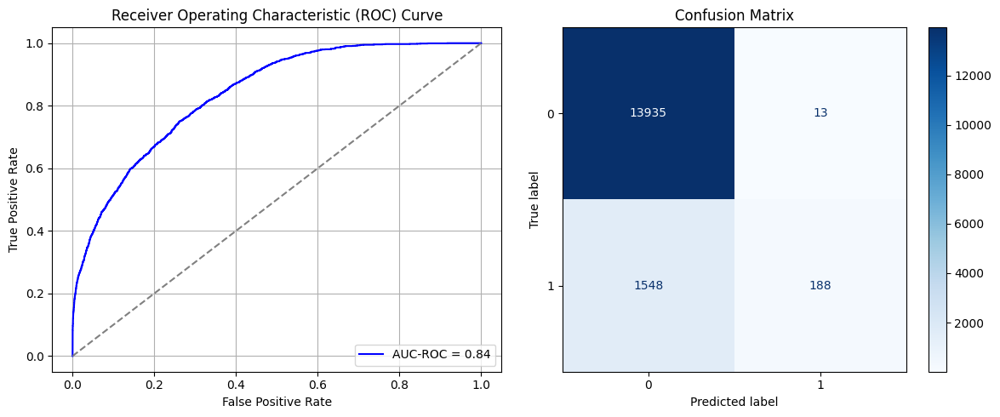

Best threshold based on F1-score: 0.051663730293512344
False Negative Rate: 0.8917050691244239
Time elapsed (performance): 1.7117783360008616
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7830 - loss: 0.5625 - val_AUC: 0.8681 - val_loss: 0.4500
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8729 - loss: 0.4408 - val_AUC: 0.8720 - val_loss: 0.4486
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8764 - loss: 0.4339 - val_AUC: 0.8731 - val_loss: 0.4472
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.4339 - val_AUC: 0.8739 - val_loss: 0.4387
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8766 - loss: 0.4341 - val_AUC: 0.8741 - val_loss: 0.4431
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8828 - loss: 0.4245 - val_AUC: 0.8754 - val_loss: 0.4408
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8802 - loss: 0.4280 - val_AUC: 0.8754 - val_loss: 0.4366
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8784 - loss: 0.4307 - val_AUC: 0.8756 - val_loss: 0.4353
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8823 -

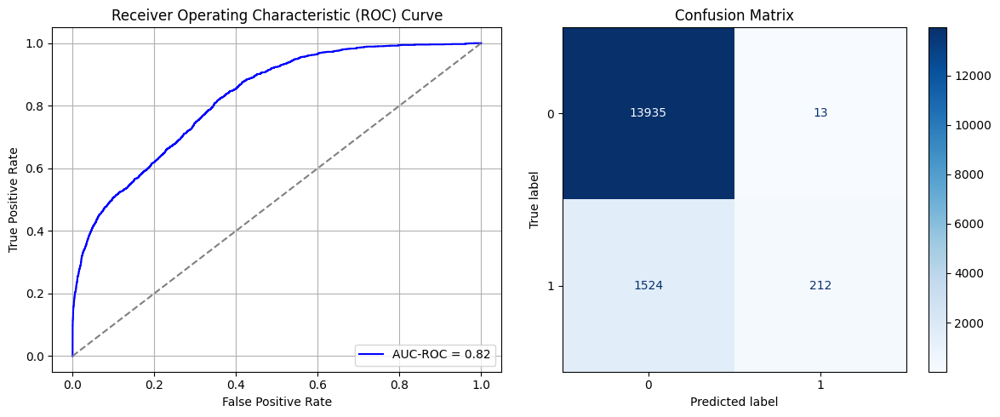

Best threshold based on F1-score: 0.09507843106985092
False Negative Rate: 0.8778801843317973
Time elapsed (performance): 1.7329266750002716
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7771 - loss: 0.5665 - val_AUC: 0.8702 - val_loss: 0.4437
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8713 - loss: 0.4415 - val_AUC: 0.8740 - val_loss: 0.4370
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8763 - loss: 0.4352 - val_AUC: 0.8752 - val_loss: 0.4350
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8792 - loss: 0.4282 - val_AUC: 0.8760 - val_loss: 0.4335
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8761 - loss: 0.4352 - val_AUC: 0.8761 - val_loss: 0.4400
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 - loss: 0.4254 - val_AUC: 0.8761 - val_loss: 0.4329
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8767 - loss: 0.4327 - val_AUC: 0.8758 - val_loss: 0.4335
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8783 - loss: 0.4303 - val_AUC: 0.8772 - val_loss: 0.4316
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 -

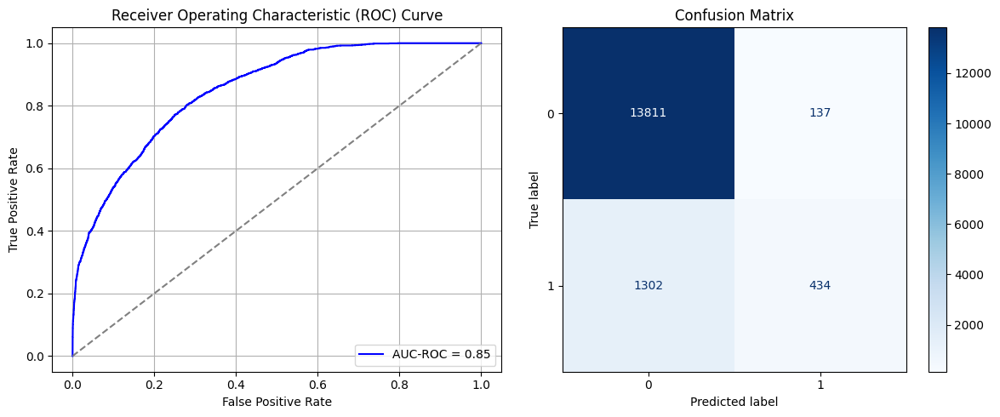

Best threshold based on F1-score: 0.20939821004867554
False Negative Rate: 0.75
Time elapsed (performance): 1.689054208000016
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7770 - loss: 0.5626 - val_AUC: 0.8668 - val_loss: 0.4649
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8722 - loss: 0.4414 - val_AUC: 0.8701 - val_loss: 0.4457
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4352 - val_AUC: 0.8711 - val_loss: 0.4463
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8758 - loss: 0.4354 - val_AUC: 0.8735 - val_loss: 0.4394
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8784 - loss: 0.4298 - val_AUC: 0.8741 - val_loss: 0.4382
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8767 - loss: 0.4325 - val_AUC: 0.8755 - val_loss: 0.4355
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8797 - loss: 0.4284 - val_AUC: 0.8749 - val_loss: 0.4368
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8824 - loss: 0.4237 - val_AUC: 0.8760 - val_loss: 0.4343
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8807 -

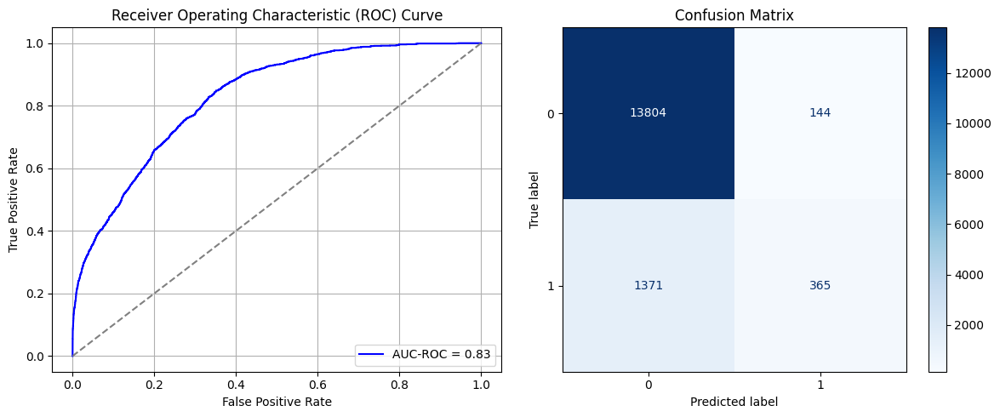

Best threshold based on F1-score: 0.23865161836147308
False Negative Rate: 0.7897465437788018
Time elapsed (performance): 1.3741458880012942
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7913 - loss: 0.5591 - val_AUC: 0.8704 - val_loss: 0.4487
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.4380 - val_AUC: 0.8736 - val_loss: 0.4407
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8752 - loss: 0.4363 - val_AUC: 0.8743 - val_loss: 0.4391
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8743 - loss: 0.4380 - val_AUC: 0.8747 - val_loss: 0.4476
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8745 - loss: 0.4365 - val_AUC: 0.8755 - val_loss: 0.4348
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8790 - loss: 0.4303 - val_AUC: 0.8767 - val_loss: 0.4329
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8803 - loss: 0.4287 - val_AUC: 0.8775 - val_loss: 0.4329
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8797 - loss: 0.4283 - val_AUC: 0.8770 - val_loss: 0.4428
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8791 -

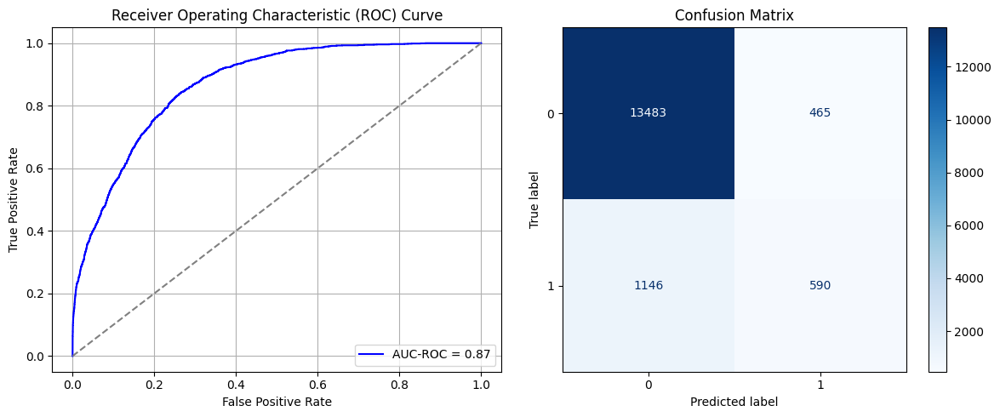

Best threshold based on F1-score: 0.3007209300994873
False Negative Rate: 0.6601382488479263
Time elapsed (performance): 1.8210625869996875
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7802 - loss: 0.5640 - val_AUC: 0.8670 - val_loss: 0.4503
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8700 - loss: 0.4447 - val_AUC: 0.8703 - val_loss: 0.4440
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.4406 - val_AUC: 0.8715 - val_loss: 0.4415
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8794 - loss: 0.4300 - val_AUC: 0.8720 - val_loss: 0.4451
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.4318 - val_AUC: 0.8717 - val_loss: 0.4417
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 - loss: 0.4309 - val_AUC: 0.8728 - val_loss: 0.4387
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8811 - loss: 0.4257 - val_AUC: 0.8720 - val_loss: 0.4400
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8820 - loss: 0.4249 - val_AUC: 0.8733 - val_loss: 0.4392
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8808 -

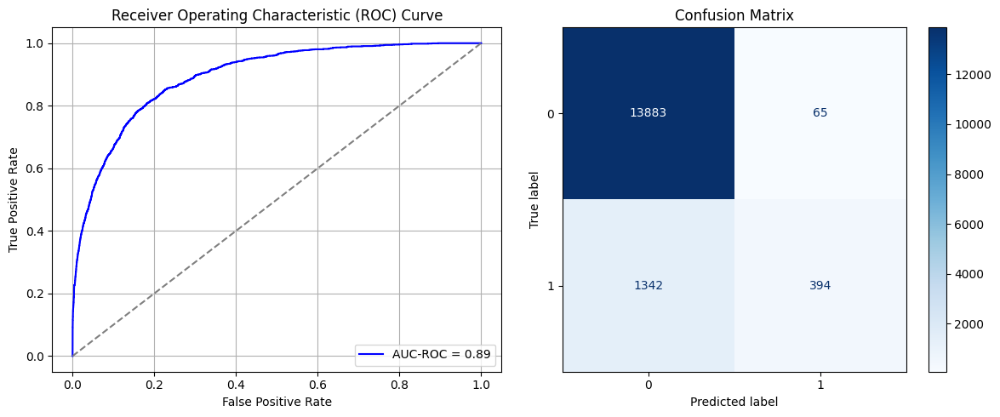

Best threshold based on F1-score: 0.19427071511745453
False Negative Rate: 0.7730414746543779
Time elapsed (performance): 1.9752051529994787
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7815 - loss: 0.5620 - val_AUC: 0.8691 - val_loss: 0.4787
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8738 - loss: 0.4393 - val_AUC: 0.8726 - val_loss: 0.4472
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8777 - loss: 0.4315 - val_AUC: 0.8738 - val_loss: 0.4391
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8785 - loss: 0.4310 - val_AUC: 0.8751 - val_loss: 0.4368
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8823 - loss: 0.4247 - val_AUC: 0.8746 - val_loss: 0.4407
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8754 - loss: 0.4354 - val_AUC: 0.8761 - val_loss: 0.4353
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8802 - loss: 0.4278 - val_AUC: 0.8757 - val_loss: 0.4376
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8809 - loss: 0.4261 - val_AUC: 0.8766 - val_loss: 0.4435
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8842 -

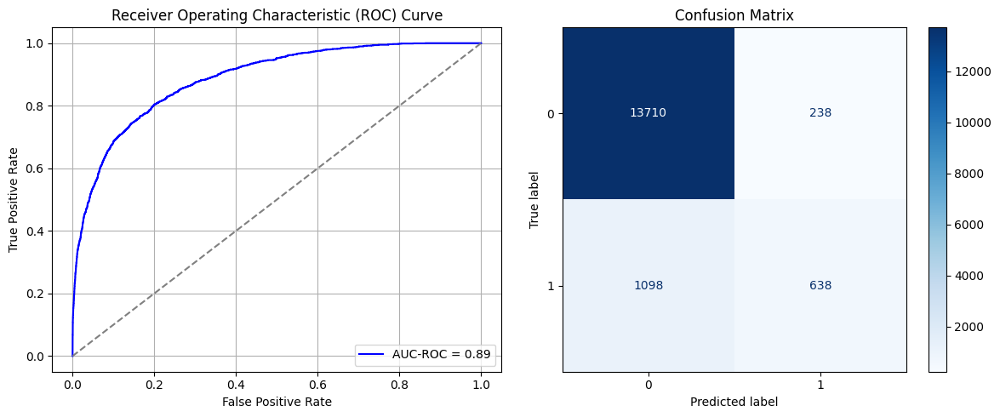

Best threshold based on F1-score: 0.2817187011241913
False Negative Rate: 0.6324884792626728
Time elapsed (performance): 1.6976674800007459
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7538 - loss: 0.5772 - val_AUC: 0.8699 - val_loss: 0.4474
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8712 - loss: 0.4434 - val_AUC: 0.8735 - val_loss: 0.4495
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.4346 - val_AUC: 0.8754 - val_loss: 0.4426
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.4332 - val_AUC: 0.8762 - val_loss: 0.4353
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8799 - loss: 0.4281 - val_AUC: 0.8774 - val_loss: 0.4454
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8792 - loss: 0.4285 - val_AUC: 0.8783 - val_loss: 0.4334
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8812 - loss: 0.4256 - val_AUC: 0.8780 - val_loss: 0.4374
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8814 - loss: 0.4253 - val_AUC: 0.8784 - val_loss: 0.4357
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 -

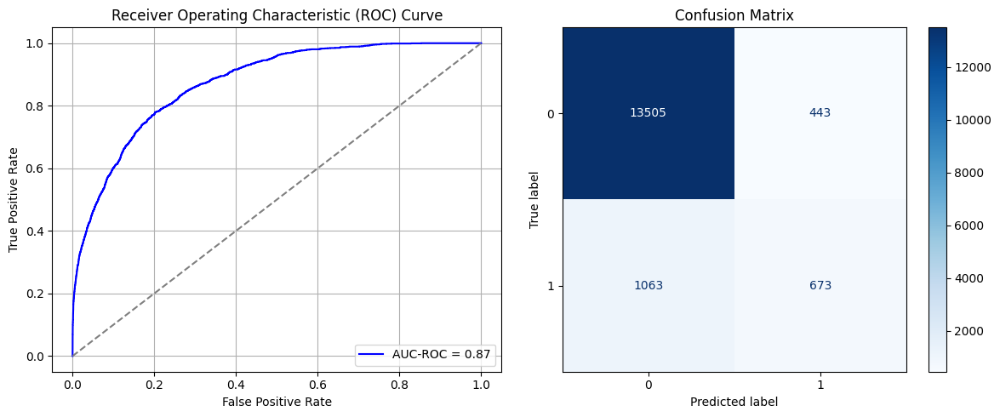

Best threshold based on F1-score: 0.3248252868652344
False Negative Rate: 0.6123271889400922
Time elapsed (performance): 1.7185811510007625
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7692 - loss: 0.5644 - val_AUC: 0.8745 - val_loss: 0.4400
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8683 - loss: 0.4462 - val_AUC: 0.8770 - val_loss: 0.4351
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8791 - loss: 0.4303 - val_AUC: 0.8776 - val_loss: 0.4333
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4311 - val_AUC: 0.8789 - val_loss: 0.4312
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8806 - loss: 0.4272 - val_AUC: 0.8792 - val_loss: 0.4298
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8783 - loss: 0.4309 - val_AUC: 0.8790 - val_loss: 0.4299
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8793 - loss: 0.4292 - val_AUC: 0.8805 - val_loss: 0.4293
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8830 - loss: 0.4231 - val_AUC: 0.8802 - val_loss: 0.4284
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8784 -

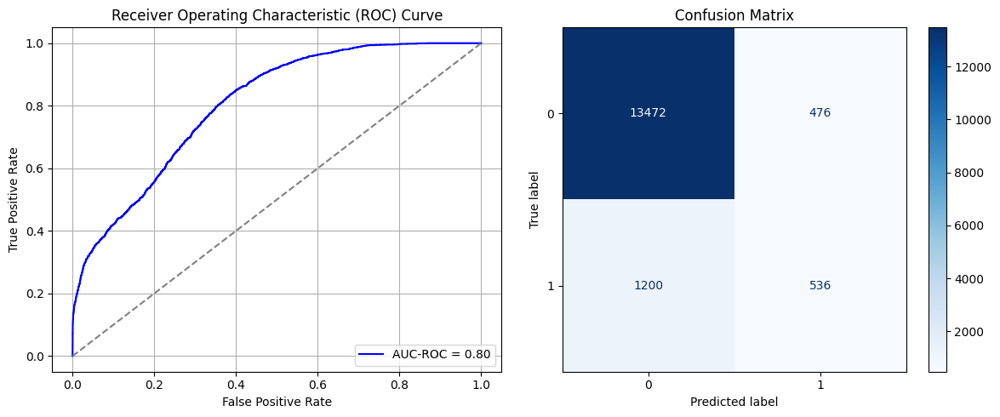

Best threshold based on F1-score: 0.4215232729911804
False Negative Rate: 0.6912442396313364
Time elapsed (performance): 1.6851294449988927
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7797 - loss: 0.5601 - val_AUC: 0.8687 - val_loss: 0.4482
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8739 - loss: 0.4392 - val_AUC: 0.8738 - val_loss: 0.4399
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8735 - loss: 0.4388 - val_AUC: 0.8744 - val_loss: 0.4391
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4296 - val_AUC: 0.8764 - val_loss: 0.4380
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8813 - loss: 0.4253 - val_AUC: 0.8765 - val_loss: 0.4420
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 - loss: 0.4245 - val_AUC: 0.8781 - val_loss: 0.4333
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8830 - loss: 0.4226 - val_AUC: 0.8776 - val_loss: 0.4326
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8846 - loss: 0.4204 - val_AUC: 0.8786 - val_loss: 0.4386
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8804 -

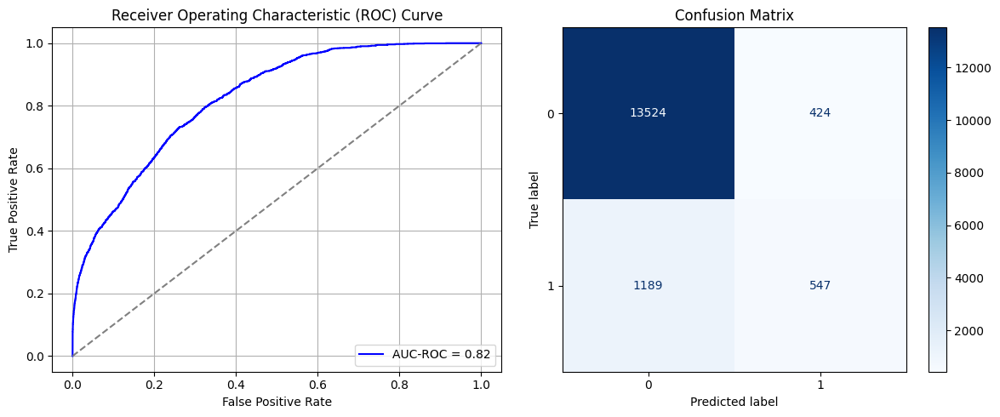

Best threshold based on F1-score: 0.37791675329208374
False Negative Rate: 0.6849078341013825
Time elapsed (performance): 1.697981629999049
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7801 - loss: 0.5672 - val_AUC: 0.8738 - val_loss: 0.4398
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4375 - val_AUC: 0.8756 - val_loss: 0.4370
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8773 - loss: 0.4326 - val_AUC: 0.8773 - val_loss: 0.4351
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8778 - loss: 0.4309 - val_AUC: 0.8784 - val_loss: 0.4347
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8769 - loss: 0.4324 - val_AUC: 0.8781 - val_loss: 0.4383
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 - loss: 0.4283 - val_AUC: 0.8782 - val_loss: 0.4318
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8821 - loss: 0.4243 - val_AUC: 0.8786 - val_loss: 0.4306
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 - loss: 0.4242 - val_AUC: 0.8794 - val_loss: 0.4293
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8864 -

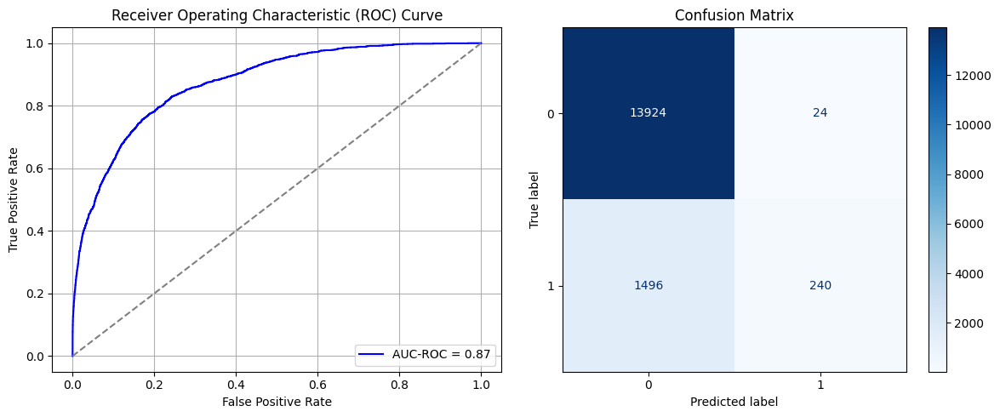

Best threshold based on F1-score: 0.09146492183208466
False Negative Rate: 0.8617511520737328
Time elapsed (performance): 1.7024472689990944
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7846 - loss: 0.5633 - val_AUC: 0.8687 - val_loss: 0.4495
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8760 - loss: 0.4366 - val_AUC: 0.8718 - val_loss: 0.4408
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8740 - loss: 0.4381 - val_AUC: 0.8722 - val_loss: 0.4404
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8748 - loss: 0.4373 - val_AUC: 0.8741 - val_loss: 0.4440
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8798 - loss: 0.4296 - val_AUC: 0.8744 - val_loss: 0.4361
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8805 - loss: 0.4283 - val_AUC: 0.8743 - val_loss: 0.4369
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8755 - loss: 0.4347 - val_AUC: 0.8747 - val_loss: 0.4395
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8743 - loss: 0.4377 - val_AUC: 0.8762 - val_loss: 0.4339
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8832 -

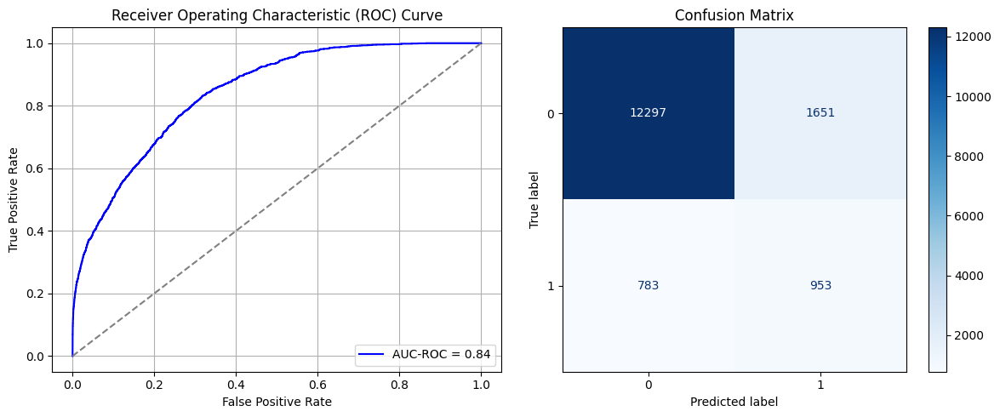

Best threshold based on F1-score: 0.5242841243743896
False Negative Rate: 0.451036866359447
Time elapsed (performance): 1.6485431130004145
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7930 - loss: 0.5520 - val_AUC: 0.8734 - val_loss: 0.4493
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4387 - val_AUC: 0.8748 - val_loss: 0.4374
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4352 - val_AUC: 0.8755 - val_loss: 0.4369
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8814 - loss: 0.4267 - val_AUC: 0.8777 - val_loss: 0.4322
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8789 - loss: 0.4301 - val_AUC: 0.8768 - val_loss: 0.4429
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 - loss: 0.4303 - val_AUC: 0.8792 - val_loss: 0.4328
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8822 - loss: 0.4256 - val_AUC: 0.8795 - val_loss: 0.4286
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8833 - loss: 0.4229 - val_AUC: 0.8799 - val_loss: 0.4318
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8770 -

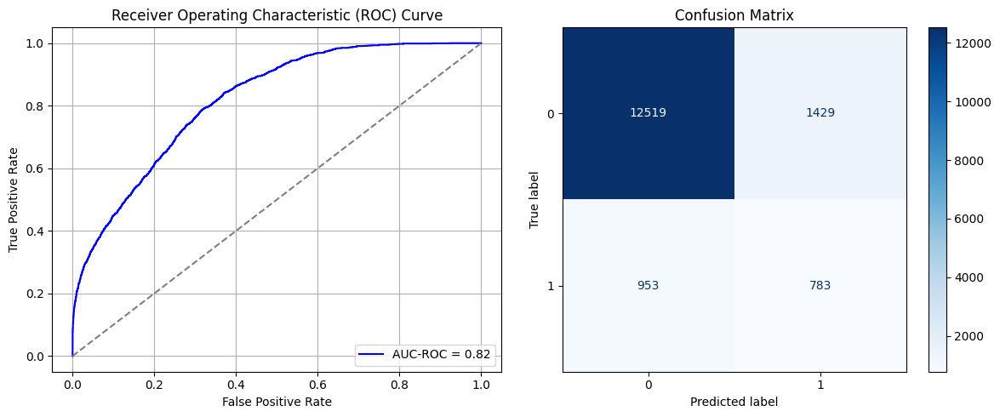

Best threshold based on F1-score: 0.552312970161438
False Negative Rate: 0.548963133640553
Time elapsed (performance): 1.7205577099994116
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7855 - loss: 0.5636 - val_AUC: 0.8701 - val_loss: 0.4523
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8735 - loss: 0.4401 - val_AUC: 0.8731 - val_loss: 0.4441
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8719 - loss: 0.4416 - val_AUC: 0.8744 - val_loss: 0.4518
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8756 - loss: 0.4363 - val_AUC: 0.8755 - val_loss: 0.4356
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 - loss: 0.4270 - val_AUC: 0.8762 - val_loss: 0.4352
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4301 - val_AUC: 0.8763 - val_loss: 0.4378
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8800 - loss: 0.4273 - val_AUC: 0.8764 - val_loss: 0.4348
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8818 - loss: 0.4253 - val_AUC: 0.8761 - val_loss: 0.4361
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8832 -

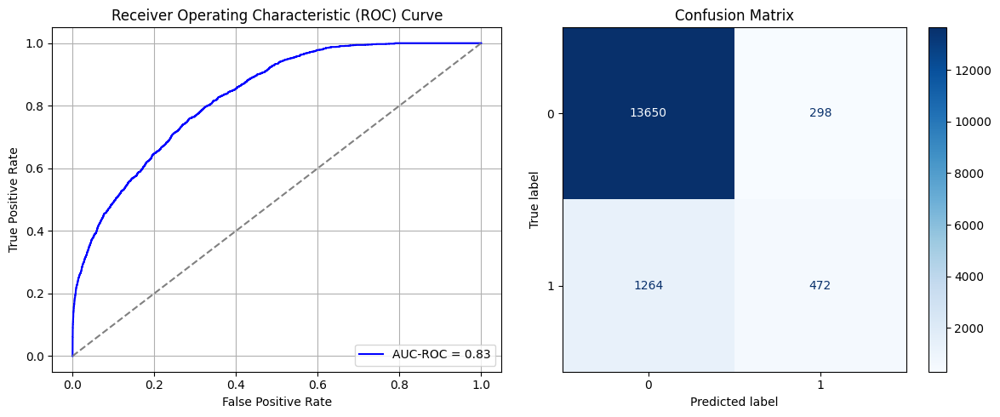

Best threshold based on F1-score: 0.29779037833213806
False Negative Rate: 0.728110599078341
Time elapsed (performance): 1.379613213999619
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7843 - loss: 0.5623 - val_AUC: 0.8667 - val_loss: 0.4516
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8698 - loss: 0.4459 - val_AUC: 0.8712 - val_loss: 0.4446
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8787 - loss: 0.4309 - val_AUC: 0.8735 - val_loss: 0.4400
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4352 - val_AUC: 0.8738 - val_loss: 0.4532
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4353 - val_AUC: 0.8737 - val_loss: 0.4442
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8760 - loss: 0.4351 - val_AUC: 0.8735 - val_loss: 0.4429
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8798 - loss: 0.4290 - val_AUC: 0.8760 - val_loss: 0.4382
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8777 - loss: 0.4310 - val_AUC: 0.8747 - val_loss: 0.4388
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8784 -

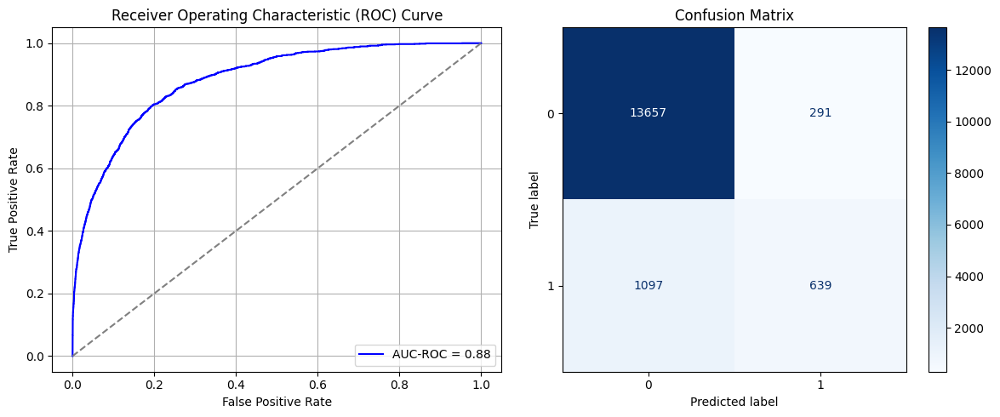

Best threshold based on F1-score: 0.3464375436306
False Negative Rate: 0.6319124423963134
Time elapsed (performance): 1.921644930000184
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7848 - loss: 0.5612 - val_AUC: 0.8719 - val_loss: 0.4429
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8785 - loss: 0.4327 - val_AUC: 0.8748 - val_loss: 0.4459
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8774 - loss: 0.4332 - val_AUC: 0.8762 - val_loss: 0.4403
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4337 - val_AUC: 0.8765 - val_loss: 0.4358
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4291 - val_AUC: 0.8774 - val_loss: 0.4483
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8796 - loss: 0.4290 - val_AUC: 0.8774 - val_loss: 0.4338
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8832 - loss: 0.4240 - val_AUC: 0.8787 - val_loss: 0.4350
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8833 - loss: 0.4234 - val_AUC: 0.8789 - val_loss: 0.4347
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8787 -

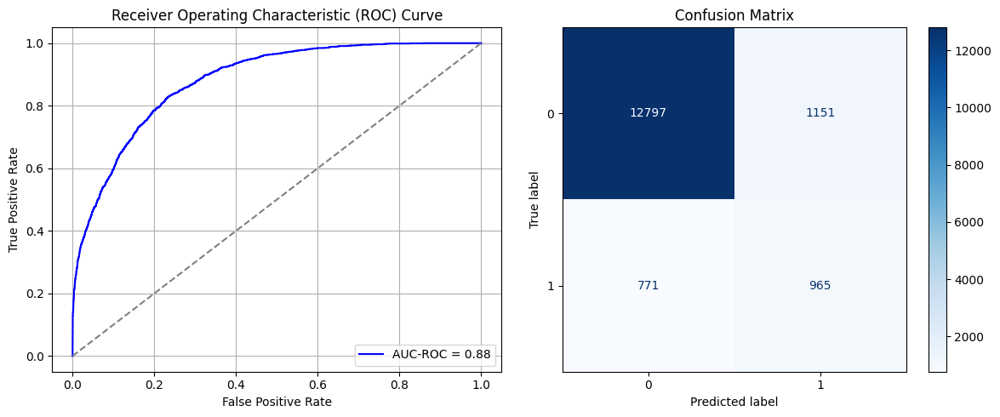

Best threshold based on F1-score: 0.5295705795288086
False Negative Rate: 0.4441244239631336
Time elapsed (performance): 1.7224455579998903
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7816 - loss: 0.5614 - val_AUC: 0.8701 - val_loss: 0.4488
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8727 - loss: 0.4406 - val_AUC: 0.8723 - val_loss: 0.4417
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8752 - loss: 0.4365 - val_AUC: 0.8730 - val_loss: 0.4489
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8787 - loss: 0.4305 - val_AUC: 0.8740 - val_loss: 0.4415
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4294 - val_AUC: 0.8752 - val_loss: 0.4379
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4289 - val_AUC: 0.8753 - val_loss: 0.4500
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8822 - loss: 0.4246 - val_AUC: 0.8755 - val_loss: 0.4357
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 - loss: 0.4278 - val_AUC: 0.8763 - val_loss: 0.4340
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8853 -

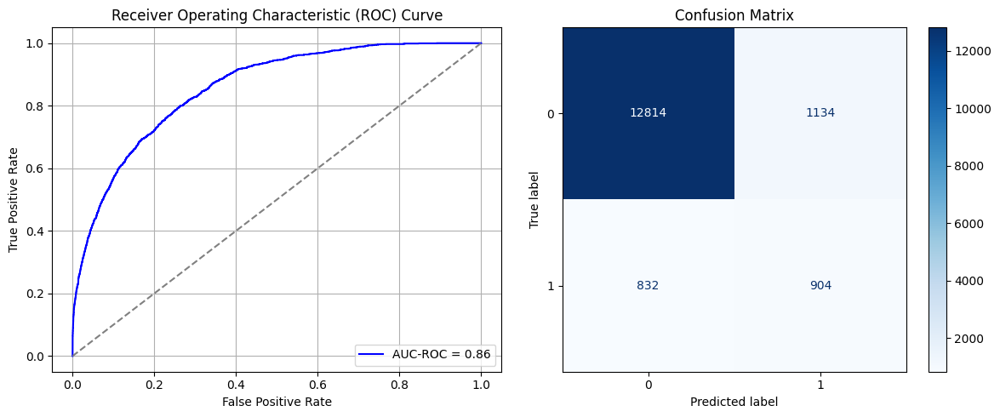

Best threshold based on F1-score: 0.4482401907444
False Negative Rate: 0.4792626728110599
Time elapsed (performance): 1.4462641669997538
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7890 - loss: 0.5568 - val_AUC: 0.8684 - val_loss: 0.4471
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4393 - val_AUC: 0.8725 - val_loss: 0.4404
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8749 - loss: 0.4364 - val_AUC: 0.8736 - val_loss: 0.4397
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8729 - loss: 0.4391 - val_AUC: 0.8746 - val_loss: 0.4384
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8804 - loss: 0.4272 - val_AUC: 0.8754 - val_loss: 0.4361
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8823 - loss: 0.4251 - val_AUC: 0.8755 - val_loss: 0.4362
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8838 - loss: 0.4222 - val_AUC: 0.8745 - val_loss: 0.4400
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8797 - loss: 0.4274 - val_AUC: 0.8745 - val_loss: 0.4421
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8830 -

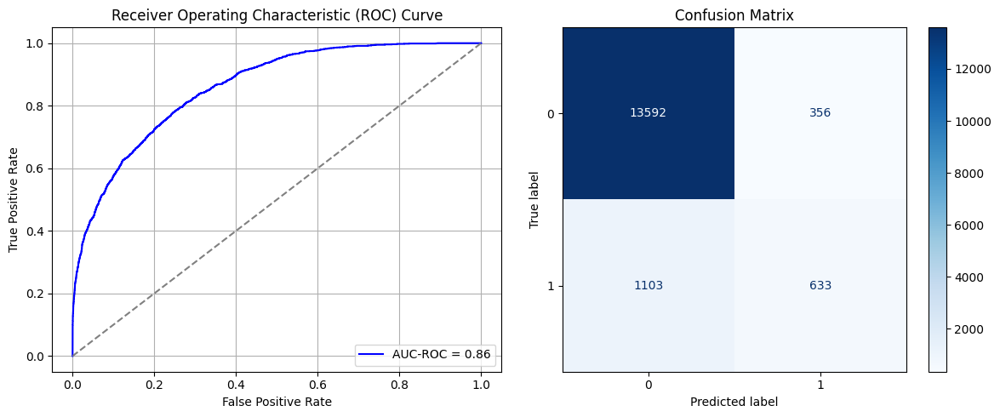

Best threshold based on F1-score: 0.3358360826969147
False Negative Rate: 0.6353686635944701
Time elapsed (performance): 6.737336779000543
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7795 - loss: 0.5670 - val_AUC: 0.8715 - val_loss: 0.4427
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8731 - loss: 0.4399 - val_AUC: 0.8727 - val_loss: 0.4406
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8750 - loss: 0.4365 - val_AUC: 0.8757 - val_loss: 0.4370
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8782 - loss: 0.4318 - val_AUC: 0.8760 - val_loss: 0.4352
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4338 - val_AUC: 0.8769 - val_loss: 0.4337
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8792 - loss: 0.4301 - val_AUC: 0.8775 - val_loss: 0.4328
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8799 - loss: 0.4273 - val_AUC: 0.8788 - val_loss: 0.4348
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8789 - loss: 0.4298 - val_AUC: 0.8785 - val_loss: 0.4311
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8790 -

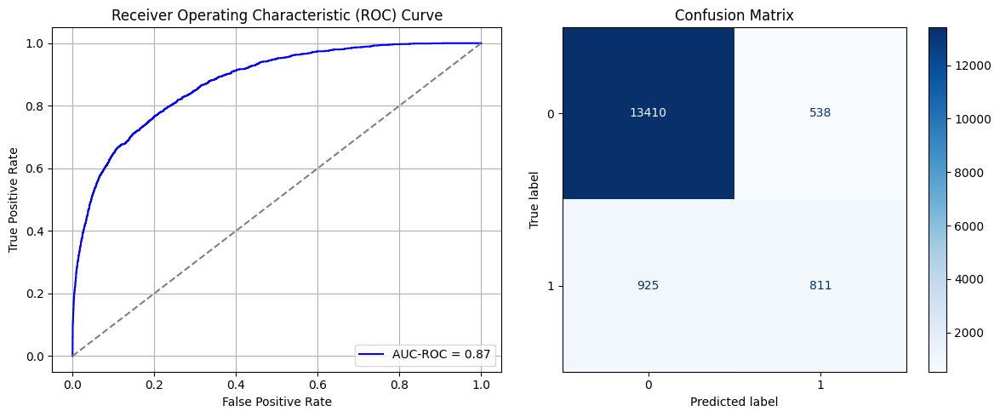

Best threshold based on F1-score: 0.4095805585384369
False Negative Rate: 0.5328341013824884
Time elapsed (performance): 1.5114534560016182
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7796 - loss: 0.5603 - val_AUC: 0.8695 - val_loss: 0.4525
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8673 - loss: 0.4490 - val_AUC: 0.8736 - val_loss: 0.4506
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4413 - val_AUC: 0.8745 - val_loss: 0.4523
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.4355 - val_AUC: 0.8742 - val_loss: 0.4401
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8775 - loss: 0.4326 - val_AUC: 0.8758 - val_loss: 0.4406
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8791 - loss: 0.4303 - val_AUC: 0.8763 - val_loss: 0.4346
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8809 - loss: 0.4270 - val_AUC: 0.8761 - val_loss: 0.4413
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 - loss: 0.4279 - val_AUC: 0.8768 - val_loss: 0.4376
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8775 -

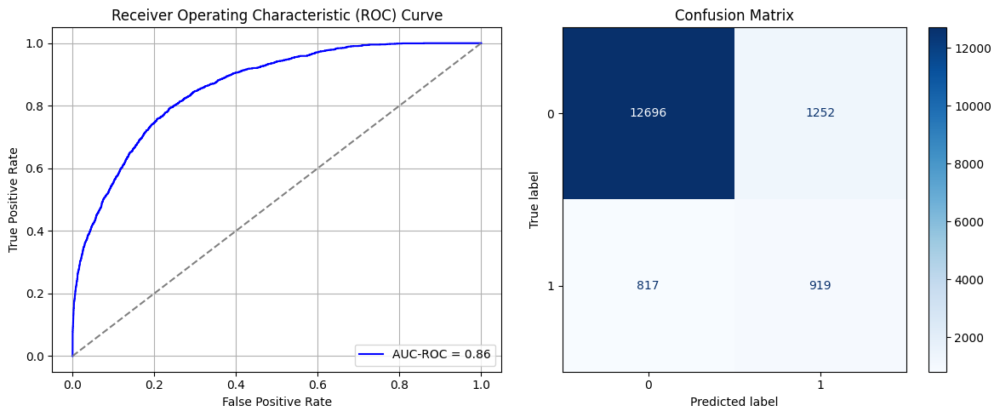

Best threshold based on F1-score: 0.534267783164978
False Negative Rate: 0.4706221198156682
Time elapsed (performance): 1.4904440980008076
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7997 - loss: 0.5559 - val_AUC: 0.8676 - val_loss: 0.4496
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8731 - loss: 0.4406 - val_AUC: 0.8716 - val_loss: 0.4436
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8765 - loss: 0.4349 - val_AUC: 0.8720 - val_loss: 0.4483
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8770 - loss: 0.4339 - val_AUC: 0.8729 - val_loss: 0.4398
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8748 - loss: 0.4365 - val_AUC: 0.8726 - val_loss: 0.4405
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8749 - loss: 0.4359 - val_AUC: 0.8742 - val_loss: 0.4418
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8789 - loss: 0.4294 - val_AUC: 0.8742 - val_loss: 0.4373
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8761 - loss: 0.4339 - val_AUC: 0.8744 - val_loss: 0.4378
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8810 -

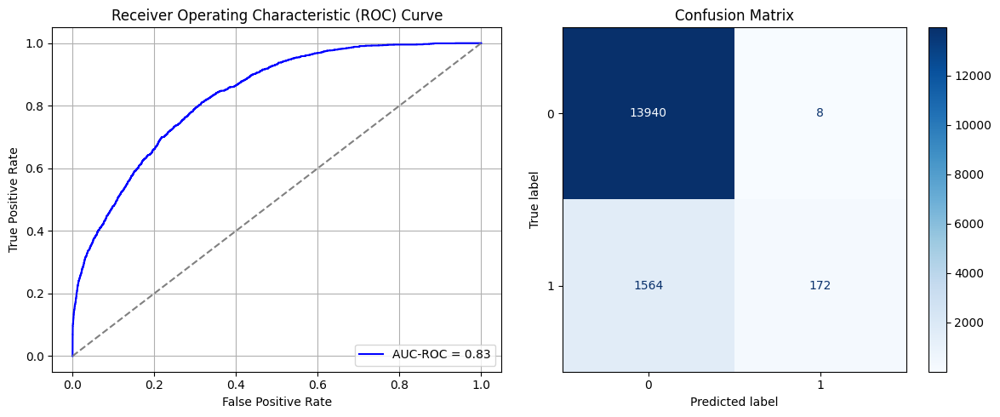

Best threshold based on F1-score: 0.04785165935754776
False Negative Rate: 0.9009216589861752
Time elapsed (performance): 1.7253364809985214
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7759 - loss: 0.5638 - val_AUC: 0.8676 - val_loss: 0.4563
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.4382 - val_AUC: 0.8721 - val_loss: 0.4429
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8758 - loss: 0.4347 - val_AUC: 0.8729 - val_loss: 0.4441
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8790 - loss: 0.4300 - val_AUC: 0.8738 - val_loss: 0.4454
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8762 - loss: 0.4334 - val_AUC: 0.8741 - val_loss: 0.4449
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8806 - loss: 0.4271 - val_AUC: 0.8747 - val_loss: 0.4393
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4274 - val_AUC: 0.8750 - val_loss: 0.4371
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8835 - loss: 0.4219 - val_AUC: 0.8760 - val_loss: 0.4349
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 -

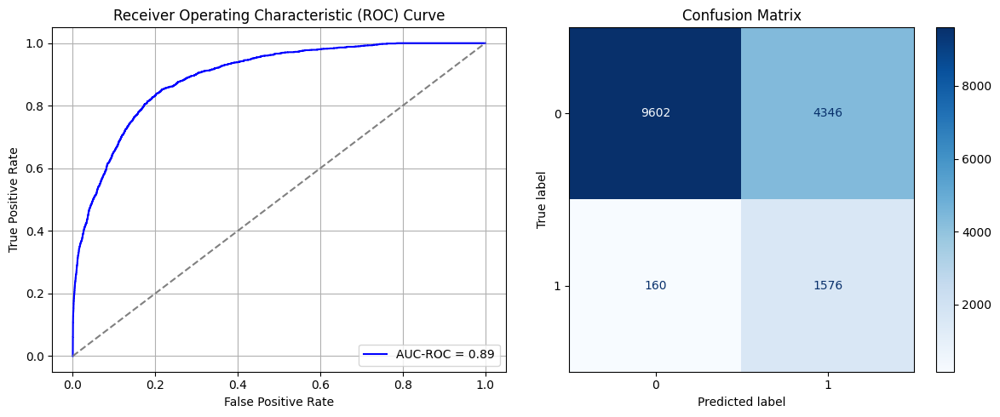

Best threshold based on F1-score: 0.7411433458328247
False Negative Rate: 0.09216589861751152
Time elapsed (performance): 1.909011374000329
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7919 - loss: 0.5555 - val_AUC: 0.8712 - val_loss: 0.4449
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8735 - loss: 0.4389 - val_AUC: 0.8723 - val_loss: 0.4415
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8755 - loss: 0.4356 - val_AUC: 0.8750 - val_loss: 0.4357
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 - loss: 0.4297 - val_AUC: 0.8753 - val_loss: 0.4424
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.4388 - val_AUC: 0.8768 - val_loss: 0.4327
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8788 - loss: 0.4301 - val_AUC: 0.8765 - val_loss: 0.4368
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8798 - loss: 0.4280 - val_AUC: 0.8763 - val_loss: 0.4352
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8824 - loss: 0.4237 - val_AUC: 0.8772 - val_loss: 0.4334
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8822 -

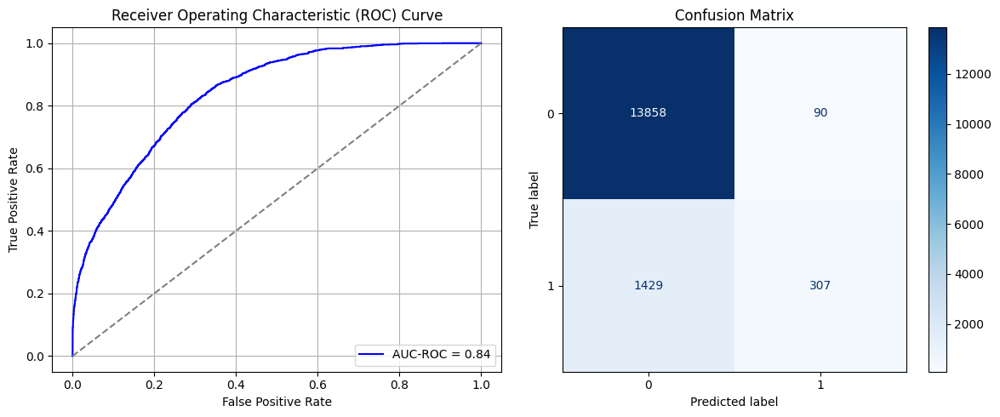

Best threshold based on F1-score: 0.14164380729198456
False Negative Rate: 0.8231566820276498
Time elapsed (performance): 1.714831461000358
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7719 - loss: 0.5681 - val_AUC: 0.8703 - val_loss: 0.4517
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8686 - loss: 0.4463 - val_AUC: 0.8736 - val_loss: 0.4422
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8756 - loss: 0.4362 - val_AUC: 0.8740 - val_loss: 0.4446
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8795 - loss: 0.4282 - val_AUC: 0.8743 - val_loss: 0.4681
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8744 - loss: 0.4370 - val_AUC: 0.8751 - val_loss: 0.4378
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.4315 - val_AUC: 0.8752 - val_loss: 0.4397
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8790 - loss: 0.4282 - val_AUC: 0.8757 - val_loss: 0.4346
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8805 - loss: 0.4260 - val_AUC: 0.8756 - val_loss: 0.4353
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 -

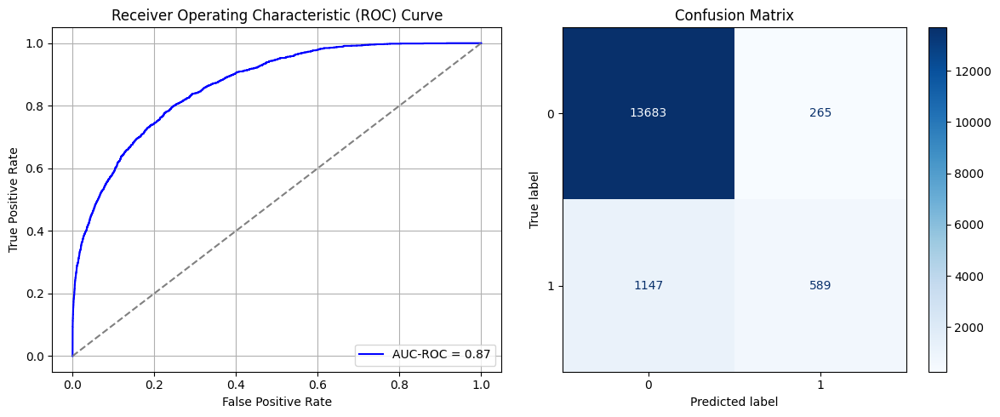

Best threshold based on F1-score: 0.30710652470588684
False Negative Rate: 0.6607142857142857
Time elapsed (performance): 1.9159117540002626
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7780 - loss: 0.5626 - val_AUC: 0.8670 - val_loss: 0.4521
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8717 - loss: 0.4425 - val_AUC: 0.8699 - val_loss: 0.4465
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8727 - loss: 0.4409 - val_AUC: 0.8715 - val_loss: 0.4440
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8789 - loss: 0.4291 - val_AUC: 0.8726 - val_loss: 0.4530
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8755 - loss: 0.4352 - val_AUC: 0.8724 - val_loss: 0.4407
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8771 - loss: 0.4327 - val_AUC: 0.8738 - val_loss: 0.4392
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8798 - loss: 0.4277 - val_AUC: 0.8740 - val_loss: 0.4378
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8790 - loss: 0.4292 - val_AUC: 0.8740 - val_loss: 0.4400
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8839 -

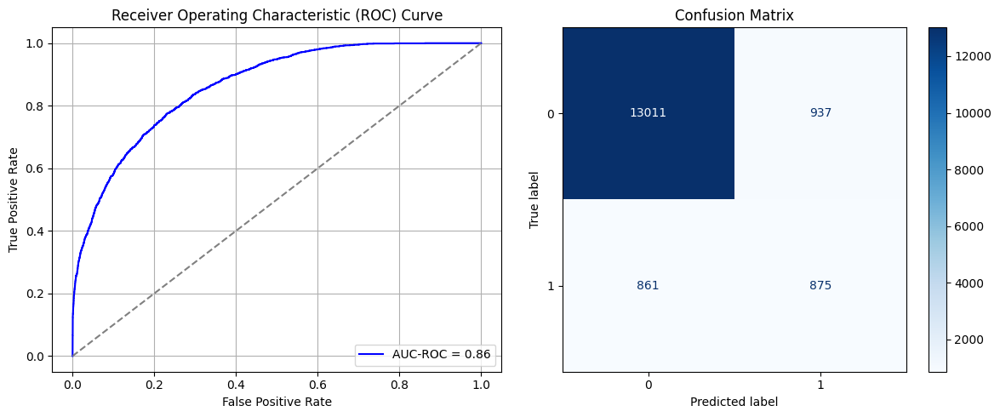

Best threshold based on F1-score: 0.45701178908348083
False Negative Rate: 0.4959677419354839
Time elapsed (performance): 1.708988672000487


In [105]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [106]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     36.675036  0.023301  0.976699  0.740783  0.259217     1.671912
1     35.367708  0.254373  0.745627  0.115783  0.884217     1.161786
2     47.703464  0.025738  0.974262  0.659562  0.340438     1.237285
3     36.282060  0.016777  0.983223  0.657834  0.342166     1.228638
4     39.698375  0.004373  0.995627  0.833525  0.166475     1.247540
5     43.878127  0.077574  0.922426  0.580645  0.419355     1.245740
6     38.376105  0.095569  0.904431  0.492512  0.507488     1.680118
7     43.881735  0.054847  0.945153  0.611175  0.388825     1.250069
8     44.255389  0.341124  0.658876  0.133641  0.866359     1.720167
9     48.597630  0.039360  0.960640  0.578917  0.421083     1.590261
10    41.576849  0.008818  0.991182  0.789747  0.210253     1.248836
11    39.364754  0.008317  0.991683  0.780530  0.219470     1.703033
12    43.995564  0.022871  0.977129  0.767857  0.232143     1.677117
13    44.772662  0.013622  0.98637